# Formula 1 2023 Season Analysis 


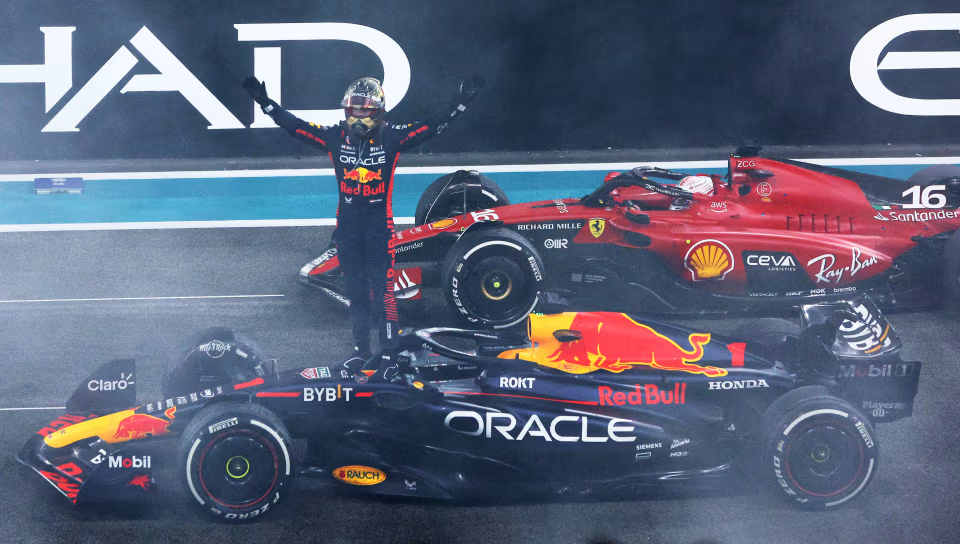



This project analyzes data from the 2023 Formula 1 World Championship season to uncover insights about team and driver performance. Using statistical analysis and data visualization techniques, we'll explore key trends, patterns, and notable events that shaped the championship.

Our analysis will cover areas such as:

- Race results and championship standings
- Qualifying performance
- Pit stop strategies
- Driver head-to-head comparisons
- Team performance across different circuits

Through this data-driven approach, we aim to gain a deeper understanding of the factors that influenced the 2023 F1 season and identify interesting storylines that emerged over the course of the championship.

Let's dive into the data and discover what made the 2023 Formula 1 season unique.


In [2]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib 
import matplotlib.pyplot as plt
import plotly.express as px 

matplotlib.rcParams['font.size']=14
matplotlib.rcParams['figure.facecolor'] = '#00000000'
matplotlib.rcParams['figure.figsize'] = (10,6)

Importing the datasets

In [3]:
calendar = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_calendar.csv')

In [4]:
calendar 

,Round,Race Date,GP Name,Country,City,Circuit Name,First GP,Number of Laps,Circuit Length(km),Race Distance(km),Lap Record,Record Owner,Record Year,Turns,DRS Zones
0,1,05/03/2023,Gulf Air Bahrain GP,Bahrain,Sakhir,Bahrain International Circuit,2004,57,5.412,308.238,1:31.447,Pedro de la Rosa,2005,15,3
1,2,19/03/2023,STC Saudi Arabian GP,Saudi Arabia,Jeddah,Jeddah Corniche Circuit,2021,50,6.174,308.450,1:30.734,Lewis Hamilton,2021,27,3
2,3,02/04/2023,Rolex Australian GP,Australia,Melbourne,Melbourne Grand Prix Circuit,1996,58,5.278,306.124,1:20.235,Sergio Perez,2023,14,4
3,4,30/04/2023,Azerbaijan GP,Azerbaijan,Baku,Baku City Circuit,2016,51,6.003,306.049,1:43.009,Charles Leclerc,2019,20,2
4,5,07/05/2023,Crypto.com Miami GP,United States,Miami,Miami International Autodrome,2022,57,5.412,308.326,1:29.708,Max Verstappen,2023,19,3
5,6,NaN,Qatar Airways Gran Premio Del Made In Italy e ...,Italy,Imola,Autodromo Enzo e Dino Ferrari,1980,63,4.909,309.049,1:15.484,Lewis Hamilton,2020,19,1
6,7,28/05/2023,Grand Prix de Monaco,Monaco,Monaco,Circuit de Monaco,1950,78,3.337,260.286,1:12.909,Lewis Hamilton,2021,19,1
7,8,04/06/2023,AWS Gran Premio de España,Spain,Catalunya,Circuit de Barcelona-Catalunya,1991,66,4.657,307.236,1:16.330,Max Verstappen,2023,14,2
8,9,18/06/2023,Pirelli Grand Prix du Canada,Canada,Montréal,Circuit Gilles-Villeneuve,1978,70,4.361,305.270,1:13.078,Valtteri Bottas,2018,14,3
9,10,02/07/2023,Rolex Grosser Preis Von Österreich,Austria,Spielberg,Red Bull Ring,1970,71,4.318,306.452,1:05.619,Carlos Sainz,2020,10,3


In [5]:
drivers = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_drivers.csv')

In [6]:
drivers.index = pd.RangeIndex(start=1, stop=len(drivers)+1, step=1)
drivers

,Driver,Abbreviation,No,Team,Country,Podiums,Points,Grands Prix Entered,World Championships,Highest Race Finish,Highest Grid Position,Date of Birth,Place of Birth
1,Max Verstappen,VER,1,Red Bull Racing,Netherlands,98,2586.5,185,3,1(x54),1,30/09/1997,"Hasselt, Belgium"
2,Sergio Perez,PER,11,Red Bull Racing,Mexico,35,1486.0,258,0,1(x6),1,26/01/1990,"Guadalajara, Mexico"
3,Lewis Hamilton,HAM,44,Mercedes,United Kingdom,197,4639.5,332,7,1(x103),1,07/01/1985,"Stevenage, England"
4,Fernando Alonso,ALO,14,Aston Martin,Spain,106,2267.0,380,2,1(x32),1,29/07/1981,"Oviedo, Spain"
5,Charles Leclerc,LEC,16,Ferrari,Monaco,30,1074.0,125,0,1(x5),1,16/10/1997,"Monte Carlo, Monaco"
6,Lando Norris,NOR,4,McLaren,United Kingdom,13,633.0,104,0,2(x7),1,13/11/1999,"Bristol, England"
7,Carlos Sainz,SAI,55,Ferrari,Sapin,18,982.5,185,0,1(x2),1,01/09/1994,"Madrid, Spain"
8,George Russell,RUS,63,Mercedes,United Kingdom,11,469.0,104,0,1(x1),1,15/02/1998,"King's Lynn, England"
9,Oscar Piastri,PIA,81,McLaren,Australia,2,97.0,22,0,2(x1),2,06/04/2001,"Melbourne, Victoria"
10,Lance Stroll,STR,18,Aston Martin,Canada,3,268.0,143,0,3(x3),1,29/10/1998,"Montreal, Canada"


In [7]:
teams = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_teams.csv')

In [8]:
teams.index = pd.RangeIndex(start=1, stop=len(teams)+1, step=1)


In [9]:
teams

,Team,Full Team Name,Base,Team Chief,Technical Chief,Chassis,Power Unit,First Team Entry,World Championships,Highest Race Finish,Pole Positions,Fastest Laps
1,Red Bull Racing,Oracle Red Bull Racing,"Milton Keynes, United Kingdom",Christain Horner,Pierre Waché,RB19,Honda RBPT,1997,6,1(x113),95,95
2,Mercedes,Mercedes-AMG Petronas F1 Team,"Brackley, United Kingdom",Toto Wolff,James Allison,W14,Mercedes,1970,8,1(x116),129,96
3,Ferrari,Scuderia Ferrari,"Maranello, Italy",Frédéric Vasseur,Enrico Cardile / Enrico Gualtieri,SF-23,Ferrari,1950,16,1(x244),249,259
4,McLaren,McLaren Formula 1 Team,"Woking, United Kingdom",Andrea Stella,Peter Prodromou / Neil Houldey,MCL60,Mercedes,1966,8,1(x183),156,165
5,Aston Martin,Aston Martin Aramco Cognizant F1 Team,"Silverstone, United Kingdom",Mike Krack,Dan Fallows,AMR23,Mercedes,2018,0,1(x1),1,1
6,Alpine,BWT Alpine F1 Team,"Enstone, United Kingdom",Bruno Famin,Matt Harman,A523,Renault,1986,2,1(x21),20,15
7,Williams,Williams Racing,"Grove, United Kingdom",James Vowles,Pat Fry,FW45,Mercedes,1978,9,1(x114),128,133
8,AlphaTauri,Scuderia AlphaTauri,"Faenza, Italy",Franz Tost,Jody Egginton,AT04,Honda RBPT,1985,0,1(x2),1,3
9,Alfa Romeo,Alfa Romeo F1 Team Stake,"Hinwil, Switzerland",Alessandro Alunni Bravi,James Key,C43,Ferrari,1993,0,1(x1),1,7
10,Haas F1 Team,MoneyGram Haas F1 Team,"Kannapolis, United States",Guenther Steiner,Simone Resta,VF-23,Ferrari,2016,0,4(x1),1,2


In [10]:
results = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_raceResults.csv')

In [11]:
pd.set_option('display.max_rows',None)

In [12]:
results

,Track,Position,No,Driver,Team,Starting Grid,Laps,Time/Retired,Points,Set Fastest Lap,Fastest Lap Time
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1,57,1:33:56.736,25,No,1:36.236
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,2,57,+11.987,18,No,1:36.344
2,Bahrain,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,5,57,+38.637,15,No,1:36.156
3,Bahrain,4,55,Carlos Sainz,Ferrari,4,57,+48.052,12,No,1:37.130
4,Bahrain,5,44,Lewis Hamilton,Mercedes,7,57,+50.977,10,No,1:36.546
5,Bahrain,6,18,Lance Stroll,Aston Martin Aramco Mercedes,8,57,+54.502,8,No,1:36.546
6,Bahrain,7,63,George Russell,Mercedes,6,57,+55.873,6,No,1:37.221
7,Bahrain,8,77,Valtteri Bottas,Alfa Romeo Ferrari,12,57,+72.647,4,No,1:37.379
8,Bahrain,9,10,Pierre Gasly,Alpine Renault,20,57,+73.753,2,No,1:35.068
9,Bahrain,10,23,Alexander Albon,Williams Mercedes,15,57,+89.774,1,No,1:37.144


In [13]:
drivers = results['Driver'].unique()

In [14]:
drivers

array(['Max Verstappen', 'Sergio Perez', 'Fernando Alonso',
       'Carlos Sainz', 'Lewis Hamilton', 'Lance Stroll', 'George Russell',
       'Valtteri Bottas', 'Pierre Gasly', 'Alexander Albon',
       'Yuki Tsunoda', 'Logan Sargeant', 'Kevin Magnussen',
       'Nyck De Vries', 'Nico Hulkenberg', 'Guanyu Zhou', 'Lando Norris',
       'Esteban Ocon', 'Charles Leclerc', 'Oscar Piastri',
       'Daniel Ricciardo', 'Liam Lawson'], dtype=object)

# Creating a points table

In [15]:
results['Points'] = pd.to_numeric(results['Points'], errors = 'coerce')

constructors_points = results.groupby('Team')['Points'].sum().reset_index()

drivers_points = results.groupby('Driver')['Points'].sum().reset_index()



In [16]:
drivers_points

,Driver,Points
0,Alexander Albon,25
1,Carlos Sainz,178
2,Charles Leclerc,185
3,Daniel Ricciardo,6
4,Esteban Ocon,56
5,Fernando Alonso,198
6,George Russell,157
7,Guanyu Zhou,6
8,Kevin Magnussen,3
9,Lance Stroll,68


In [17]:

constructors_points = constructors_points.sort_values(by='Points',ascending=False).reset_index(drop=True)

constructors_points


,Team,Points
0,Red Bull Racing Honda RBPT,790
1,Mercedes,374
2,Ferrari,363
3,Aston Martin Aramco Mercedes,266
4,McLaren Mercedes,266
5,Alpine Renault,110
6,Williams Mercedes,26
7,AlphaTauri Honda RBPT,22
8,Alfa Romeo Ferrari,16
9,Haas Ferrari,9


In [18]:
drivers_points = drivers_points.sort_values(by='Points',ascending=False).reset_index(drop=True)
drivers_points

,Driver,Points
0,Max Verstappen,530
1,Sergio Perez,260
2,Lewis Hamilton,217
3,Fernando Alonso,198
4,Charles Leclerc,185
5,Lando Norris,184
6,Carlos Sainz,178
7,George Russell,157
8,Oscar Piastri,82
9,Lance Stroll,68


In [19]:
# plt.figure(figsize=(15,10))
# plt.bar(constructors_points['Team'],constructors_points['Points'],color = 'skyblue')
# plt.title('Constructors Points for the 2023 Season')
# plt.xlabel('Team')
# plt.ylabel('Points Scored')
# plt.xticks(rotation=45, ha='right')
# plt.show()

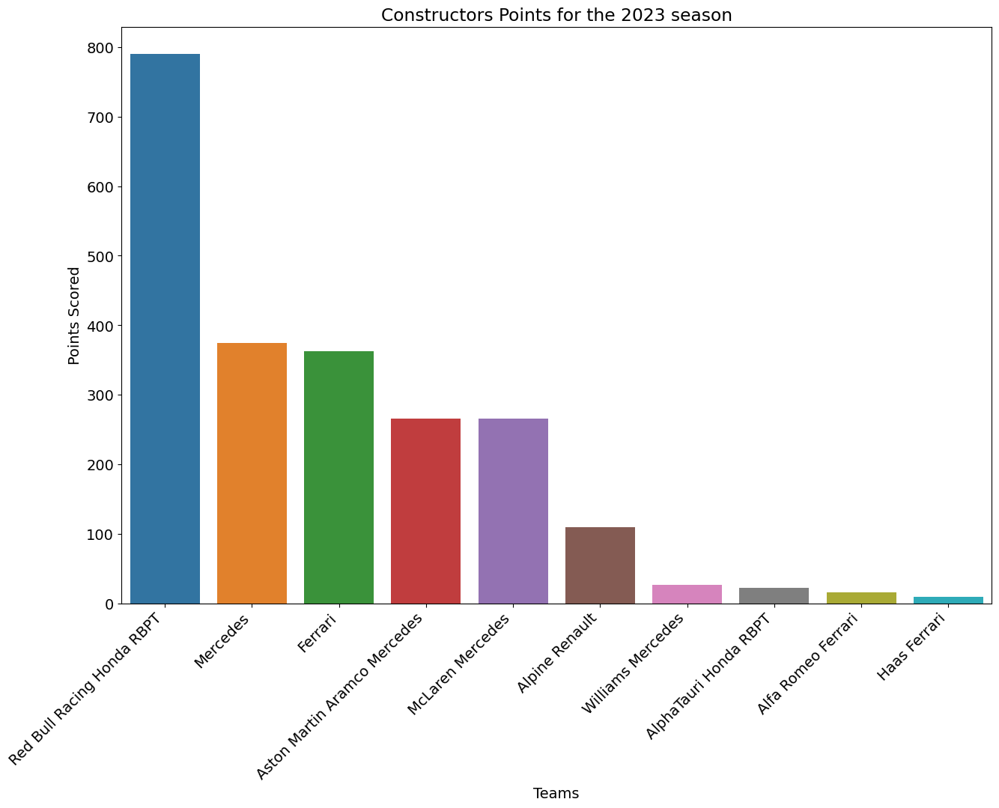

In [20]:
plt.figure(figsize=(15,10))
sns.barplot(data = constructors_points,
           x= 'Team',
           y='Points')
plt.title('Constructors Points for the 2023 season')
plt.xlabel('Teams')
plt.ylabel('Points Scored')
plt.xticks(rotation=45,ha='right')
plt.show()

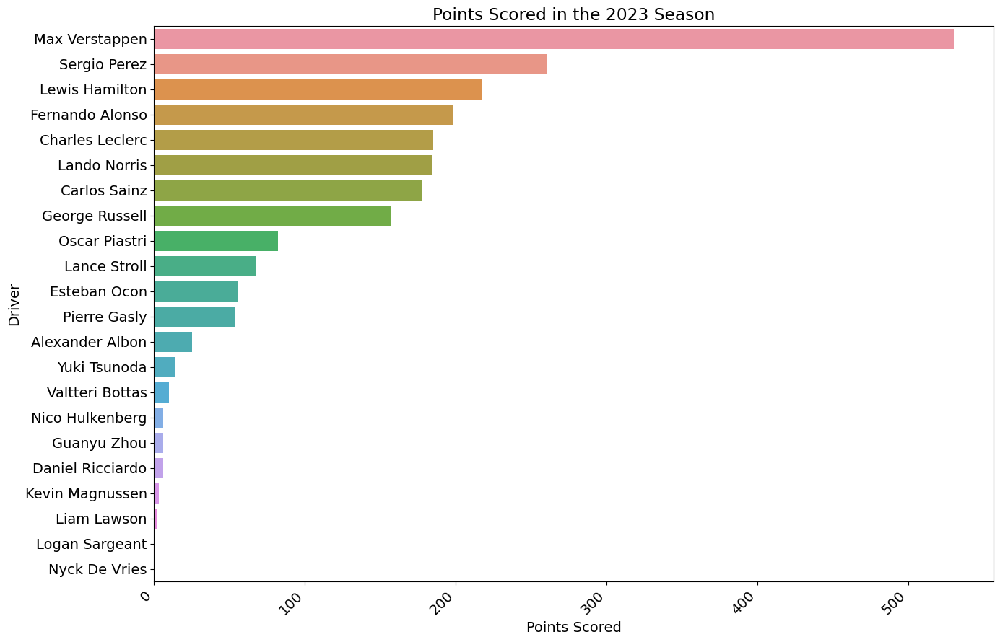

In [21]:
plt.figure(figsize=(15,10))
sns.barplot(data = drivers_points.sort_values('Points',ascending=False),
           x='Points',
           y='Driver')
plt.xlabel('Points Scored')
plt.ylabel('Driver')
plt.xticks(rotation=45,ha='right')
plt.title('Points Scored in the 2023 Season')
plt.show()


# Top 5 teams comparisions throughout the season

In [22]:
# We would need to create Dfs for each team

constructors_points.head(5)

,Team,Points
0,Red Bull Racing Honda RBPT,790
1,Mercedes,374
2,Ferrari,363
3,Aston Martin Aramco Mercedes,266
4,McLaren Mercedes,266


In [23]:
redbull = results[results['Team']=='Red Bull Racing Honda RBPT']


In [24]:
mercedes = results[results['Team']=='Mercedes']
ferrari = results[results['Team']=='Ferrari']
aston_martin = results[results['Team']=='Aston Martin Aramco Mercedes']
mclaren = results[results['Team']=='McLaren Mercedes']

for every team i need to create a results table for each and every track
(the idea is a table where each track is mentioned and the number of points gained by both drivers is added up and showed as one number)



In [25]:

redbull_total_points = redbull.groupby('Track',as_index=False,sort=False)['Points'].sum() 
merecedes_total_points = mercedes.groupby('Track',as_index=False,sort=False)['Points'].sum()
ferrari_total_points = ferrari.groupby('Track',as_index=False,sort=False)['Points'].sum()
aston_total_points = aston_martin.groupby('Track',as_index=False,sort=False)['Points'].sum()
mclaren_total_points = mclaren.groupby('Track',as_index=False,sort=False)['Points'].sum()

In [26]:
redbull_total_points

,Track,Points
0,Bahrain,43
1,Saudi Arabia,44
2,Australia,36
3,Azerbaijan,43
4,Miami,44
5,Monaco,25
6,Spain,38
7,Canada,34
8,Austria,41
9,Great Britain,34


In [27]:
teams_tracks = [redbull_total_points,merecedes_total_points,ferrari_total_points,aston_total_points,mclaren_total_points]

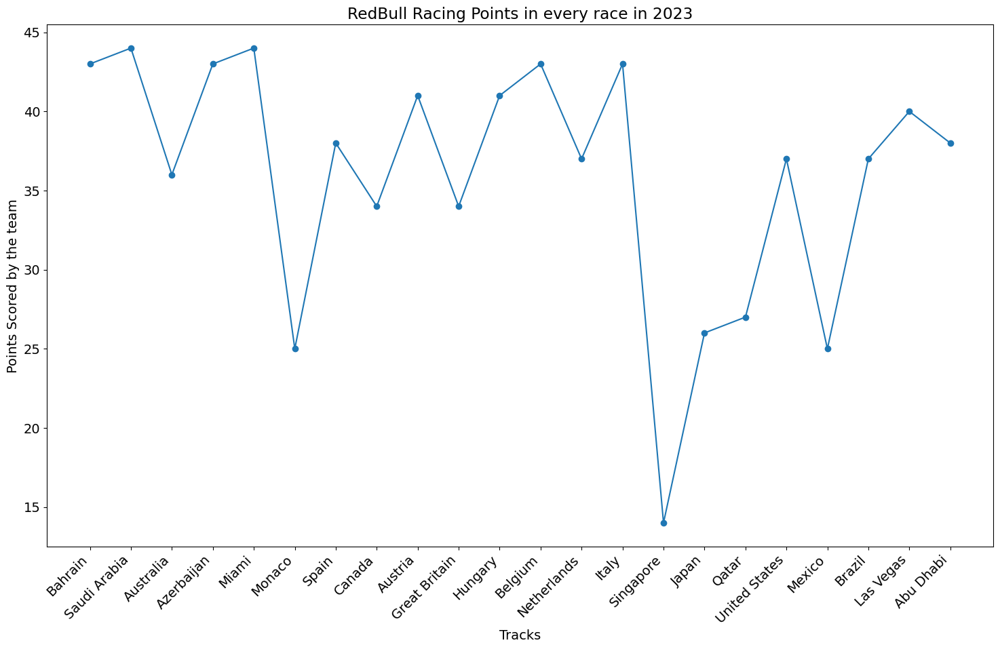

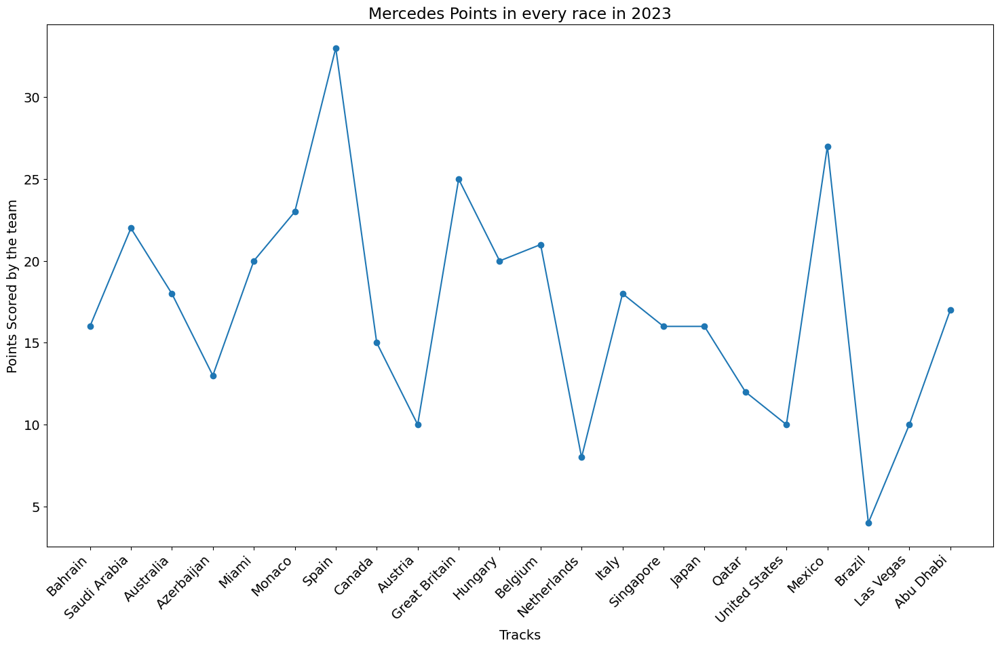

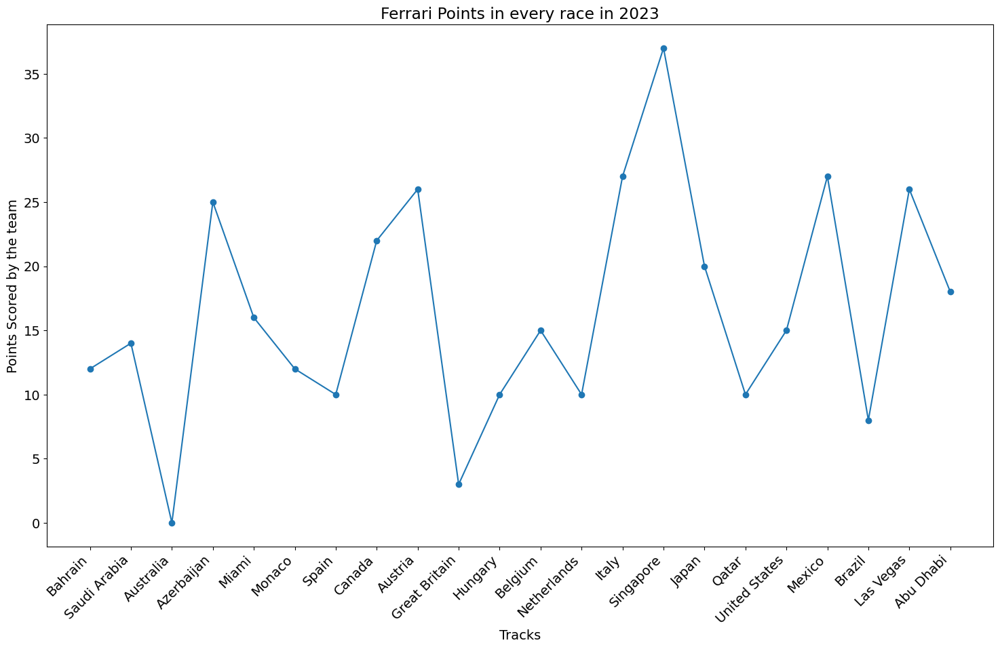

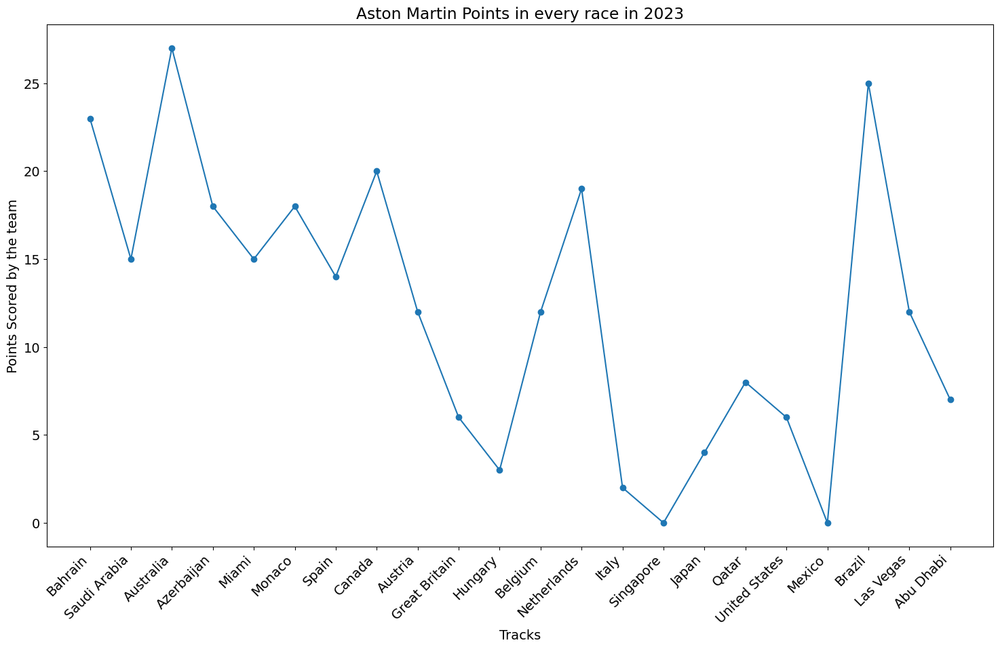

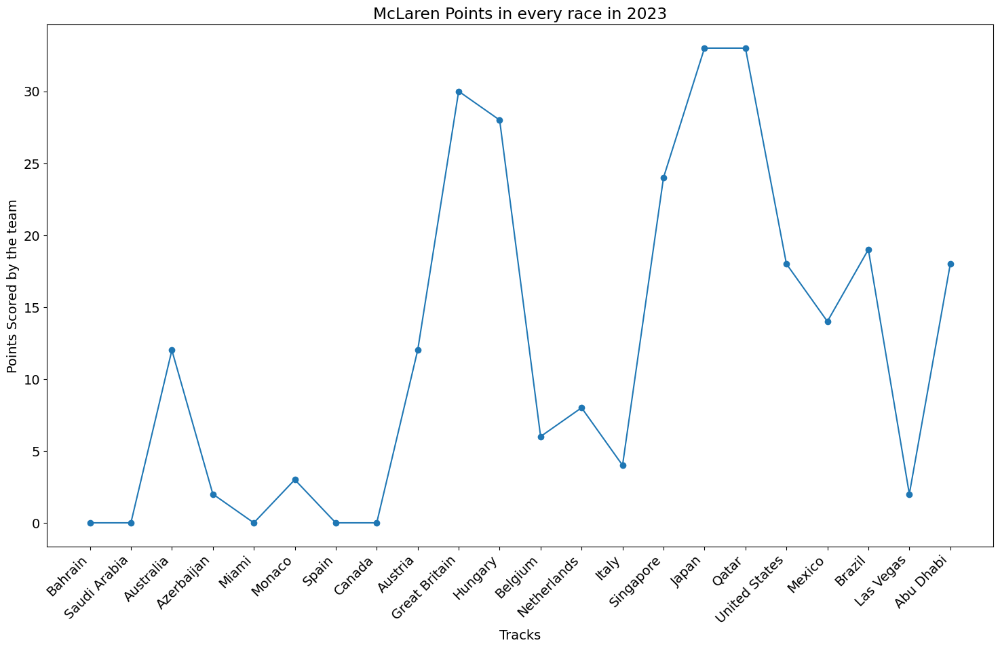

In [28]:

team_names = ['RedBull Racing', 'Mercedes', 'Ferrari', 'Aston Martin', 'McLaren']

for team, name in zip(teams_tracks, team_names):
    plt.figure(figsize=(18, 10))
    plt.plot(team['Track'], team['Points'], marker='o')  
    plt.xlabel('Tracks')
    plt.ylabel('Points Scored by the team')
    plt.xticks(rotation=45, ha='right')
    plt.title(f'{name} Points in every race in 2023')  
    plt.show()


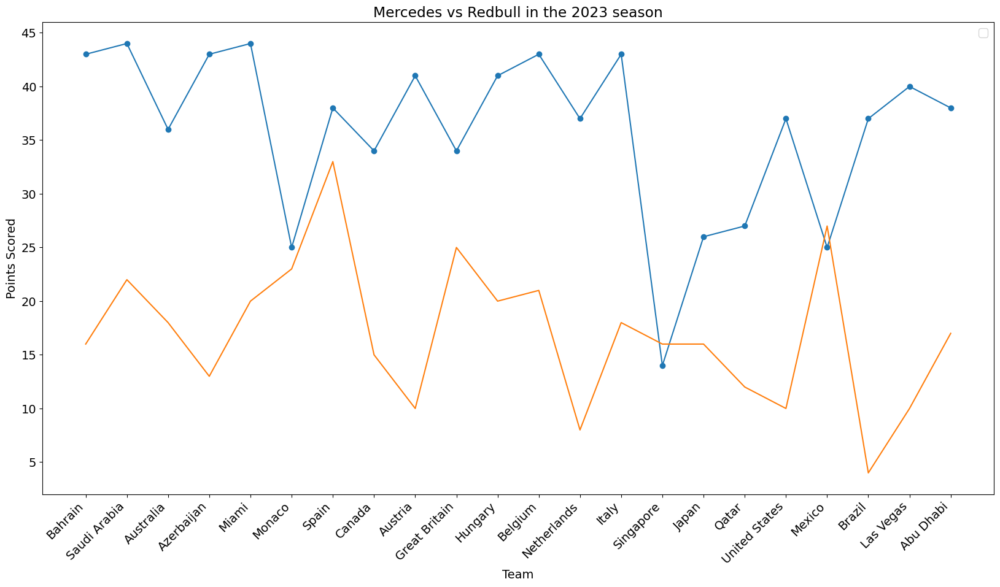

In [29]:
plt.figure(figsize = (20,10))

plt.plot(redbull_total_points['Track'],redbull_total_points['Points'],marker = 'o')
plt.plot(merecedes_total_points['Track'],merecedes_total_points['Points'])
# plt.plot(ferrari_total_points['Track'],ferrari_total_points['Points'])
# plt.plot(aston_total_points['Track'],aston_total_points['Points'])
# plt.plot(mclaren_total_points['Track'],mclaren_total_points['Points'])

plt.xlabel('Team')
plt.ylabel('Points Scored')

plt.xticks(rotation = 45, ha ='right')
plt.title('Mercedes vs Redbull in the 2023 season')
plt.legend()
plt.show()

In [30]:
quali = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_qualifyingResults.csv')

In [31]:
quali 


,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
5,Bahrain,6,63,George Russell,Mercedes,1:31.057,1:30.507,1:30.340,15
6,Bahrain,7,44,Lewis Hamilton,Mercedes,1:31.543,1:30.513,1:30.384,15
7,Bahrain,8,18,Lance Stroll,Aston Martin Aramco Mercedes,1:31.184,1:31.127,1:30.836,18
8,Bahrain,9,31,Esteban Ocon,Alpine Renault,1:31.508,1:30.914,1:30.984,15
9,Bahrain,10,27,Nico Hulkenberg,Haas Ferrari,1:31.204,1:30.809,DNF,17


In [32]:
bahrain_quali = quali[quali['Track']=='Bahrain']

In [33]:
drivers = quali['Driver'].unique().tolist()

In [34]:
bahrain_quali

,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
5,Bahrain,6,63,George Russell,Mercedes,1:31.057,1:30.507,1:30.340,15
6,Bahrain,7,44,Lewis Hamilton,Mercedes,1:31.543,1:30.513,1:30.384,15
7,Bahrain,8,18,Lance Stroll,Aston Martin Aramco Mercedes,1:31.184,1:31.127,1:30.836,18
8,Bahrain,9,31,Esteban Ocon,Alpine Renault,1:31.508,1:30.914,1:30.984,15
9,Bahrain,10,27,Nico Hulkenberg,Haas Ferrari,1:31.204,1:30.809,DNF,17


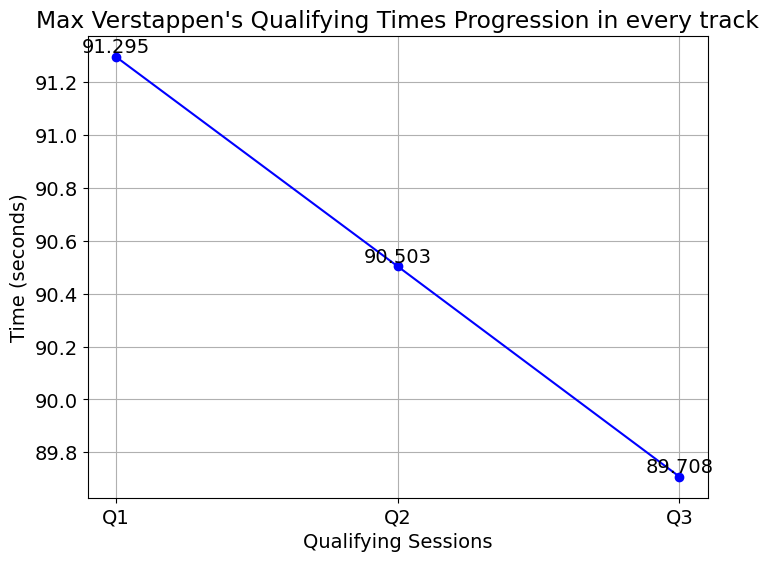

In [35]:
import matplotlib.pyplot as plt

# Custom function to convert lap time (m:ss.sss) to seconds
def time_to_seconds(lap_time):
    if pd.isna(lap_time):  # Handle NaN values
        return None
    minutes, seconds = lap_time.split(':')
    total_seconds = int(minutes) * 60 + float(seconds)
    return total_seconds

# Apply this to Max Verstappen's Q1, Q2, Q3 times
verstappen_data = bahrain_quali[bahrain_quali['Driver'] == 'Max Verstappen']


q1_time = time_to_seconds(verstappen_data['Q1'].values[0])
q2_time = time_to_seconds(verstappen_data['Q2'].values[0])
q3_time = time_to_seconds(verstappen_data['Q3'].values[0])

# Prepare data for plotting
sessions = ['Q1', 'Q2', 'Q3']
times = [q1_time, q2_time, q3_time]

# Plot a line chart for Max Verstappen's Q1, Q2, Q3 times
plt.figure(figsize=(8, 6))
plt.plot(sessions, times, marker='o', linestyle='-', color='blue')

# Adding labels and title
plt.xlabel('Qualifying Sessions')
plt.ylabel('Time (seconds)')
plt.title("Max Verstappen's Qualifying Times Progression in every track")

# Display data points
for i, time in enumerate(times):
    plt.text(sessions[i], times[i], f"{times[i]:.3f}", ha='center', va='bottom')

plt.grid(True)
plt.show()


In [36]:
# import matplotlib.pyplot as plt

# # Custom function to convert lap time (m:ss.sss) to seconds
# def time_to_seconds(lap_time):
#     # Handle NaN or non-string values
#     if pd.isna(lap_time) or not isinstance(lap_time, str):
#         return None
#     try:
#         # Split into minutes and seconds
#         minutes, seconds = lap_time.split(':')
#         total_seconds = int(minutes) * 60 + float(seconds)
#         return total_seconds
#     except ValueError:
#         # Handle cases where the split doesn't work as expected (like if the format is incorrect)
#         return None

# # Unique list of drivers
# drivers = quali['Driver'].unique().tolist()

# # Loop through each driver and plot their Q1, Q2, Q3 time progression
# for driver in drivers:
#     driver_data = bahrain_quali[bahrain_quali['Driver'] == driver]
    
#     # Get the times for Q1, Q2, Q3 and handle missing or incorrect data
#     q1_time = time_to_seconds(driver_data['Q1'].values[0])
#     q2_time = time_to_seconds(driver_data['Q2'].values[0]) if 'Q2' in driver_data else None
#     q3_time = time_to_seconds(driver_data['Q3'].values[0]) if 'Q3' in driver_data else None
    
#     # Prepare data for plotting (only include non-None times)
#     sessions = ['Q1', 'Q2', 'Q3']
#     times = [q1_time, q2_time, q3_time]

#     # Remove None values to avoid plotting empty points
#     valid_sessions = [s for s, t in zip(sessions, times) if t is not None]
#     valid_times = [t for t in times if t is not None]
    
#     # Only plot if there are valid times
#     if valid_times:
#         # Plot a line chart for each driver's Q1, Q2, Q3 times
#         plt.figure(figsize=(8, 6))
#         plt.plot(valid_sessions, valid_times, marker='o', linestyle='-', color='blue')
        
#         # Adding labels and title
#         plt.xlabel('Qualifying Sessions')
#         plt.ylabel('Time (seconds)')
#         plt.title(f"{driver}'s Bahrain Qualifying Times Progression")
        
#         # Display data points with text
#         for i, time in enumerate(valid_times):
#             if time is not None:
#                 plt.text(valid_sessions[i], valid_times[i], f"{valid_times[i]:.3f}", ha='center', va='bottom')

#         # Add grid for clarity
#         plt.grid(True)
        
#         # Show the plot for each driver
#         plt.show()


In [37]:
saudi_quali = quali[quali['Track']=='Saudi Arabia']

In [38]:
# import matplotlib.pyplot as plt

# # Custom function to convert lap time (m:ss.sss) to seconds
# def time_to_seconds(lap_time):
#     # Handle NaN or non-string values
#     if pd.isna(lap_time) or not isinstance(lap_time, str):
#         return None
#     try:
#         # Split into minutes and seconds
#         minutes, seconds = lap_time.split(':')
#         total_seconds = int(minutes) * 60 + float(seconds)
#         return total_seconds
#     except ValueError:
#         # Handle cases where the split doesn't work as expected (like if the format is incorrect)
#         return None

# # Unique list of drivers
# drivers = quali['Driver'].unique().tolist()

# # Loop through each driver and plot their Q1, Q2, Q3 time progression
# for driver in drivers:
#     driver_data = bahrain_quali[bahrain_quali['Driver'] == driver]
    
#     # Get the times for Q1, Q2, Q3 and handle missing or incorrect data
#     q1_time = time_to_seconds(driver_data['Q1'].values[0])
#     q2_time = time_to_seconds(driver_data['Q2'].values[0]) if 'Q2' in driver_data else None
#     q3_time = time_to_seconds(driver_data['Q3'].values[0]) if 'Q3' in driver_data else None
    
#     # Prepare data for plotting (only include non-None times)
#     sessions = ['Q1', 'Q2', 'Q3']
#     times = [q1_time, q2_time, q3_time]

#     # Remove Null values to avoid plotting empty points
#     valid_sessions = [s for s, t in zip(sessions, times) if t is not None]
#     valid_times = [t for t in times if t is not None]
    
#     # Only plot if there are valid times
#     if valid_times:
#         # Plotting a line chart for each driver's Q1, Q2, Q3 times
#         plt.figure(figsize=(8, 6))
#         plt.plot(valid_sessions, valid_times, marker='o', linestyle='-', color='blue')
        
#         plt.xlabel('Qualifying Sessions')
#         plt.ylabel('Time (seconds)')
#         plt.title(f"{driver}'s Bahrain Qualifying Times Progression")
        
#         for i, time in enumerate(valid_times):
#             if time is not None:
#                 plt.text(valid_sessions[i], valid_times[i], f"{valid_times[i]:.3f}", ha='center', va='bottom')


#         plt.grid(True)
        
#         plt.show()


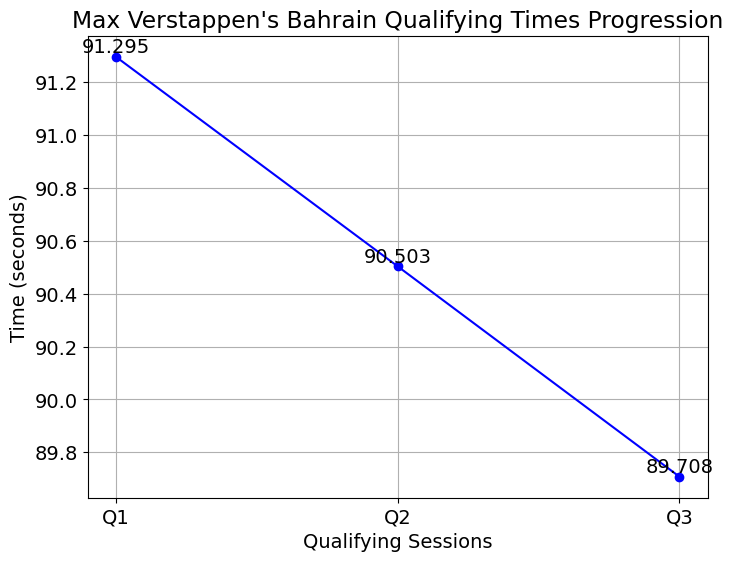

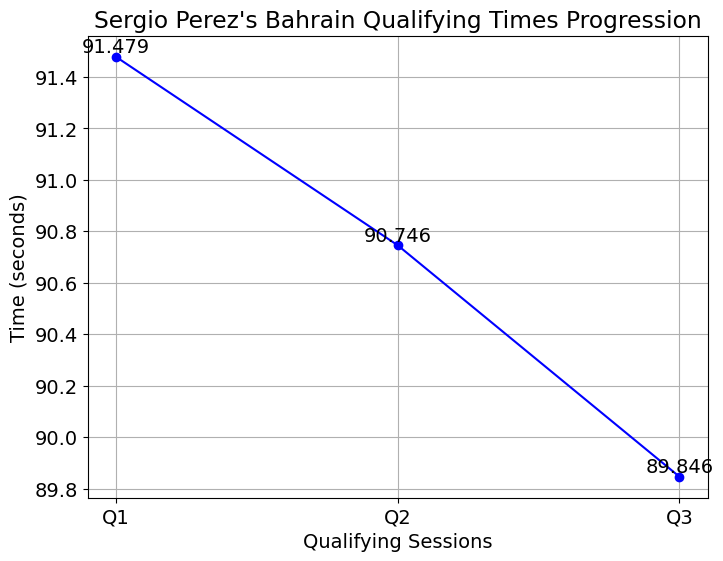

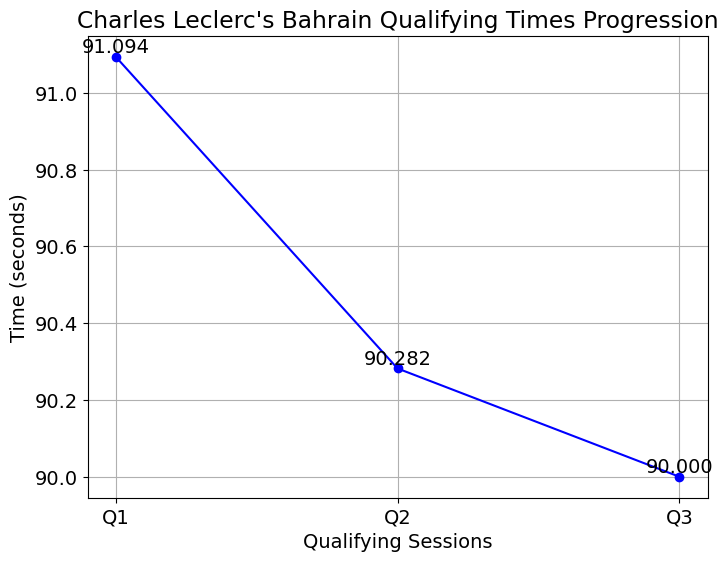

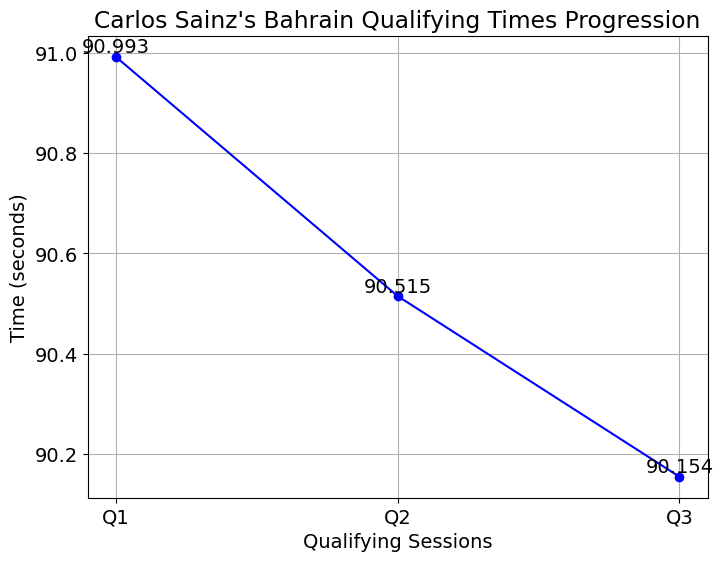

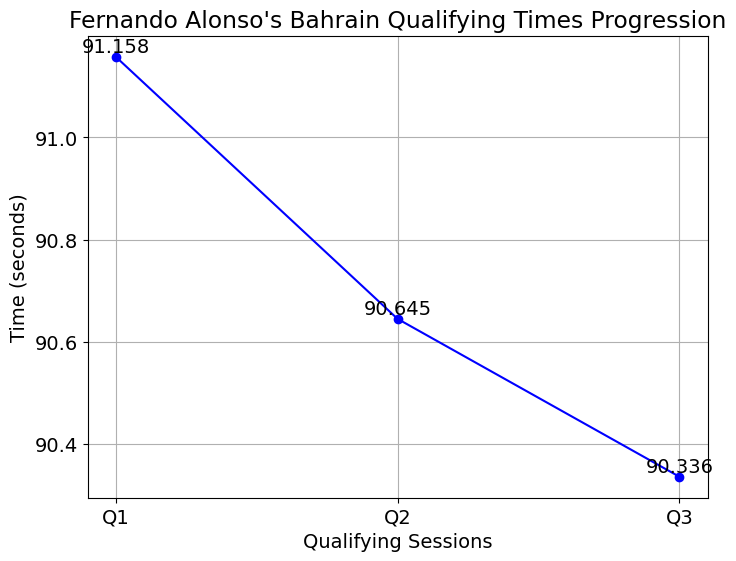

...

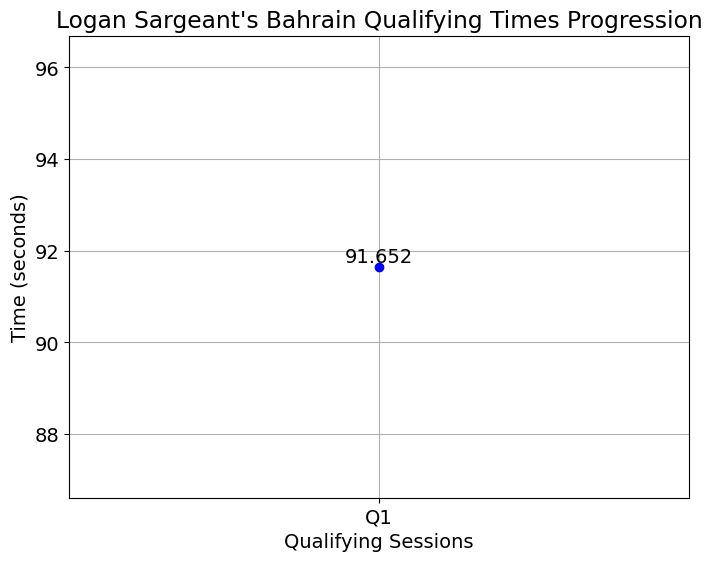

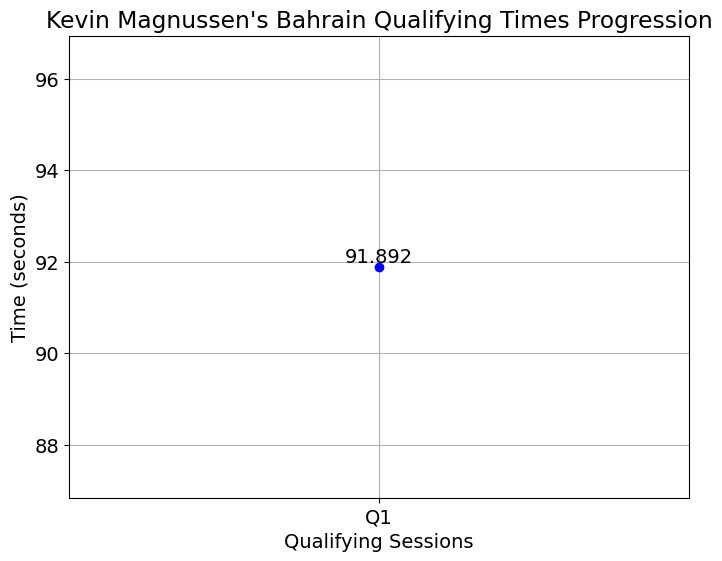

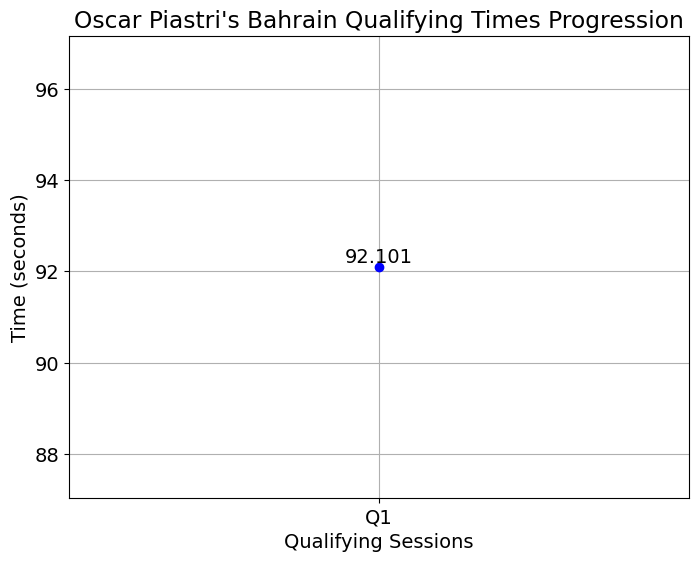

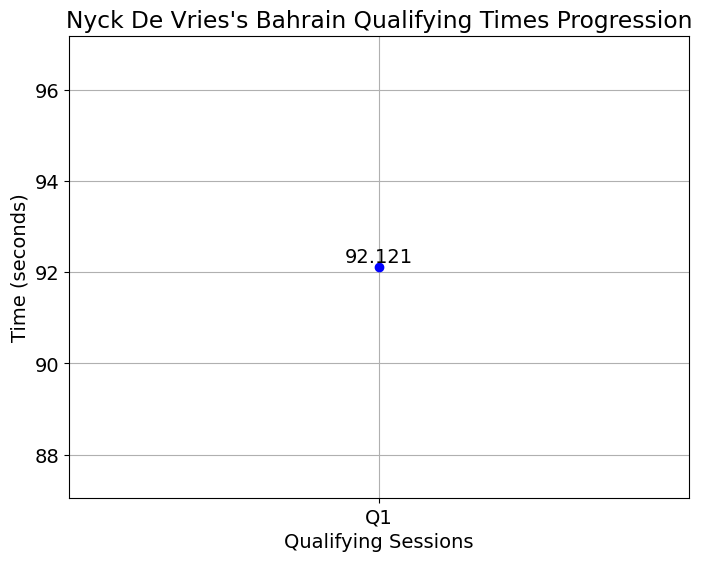

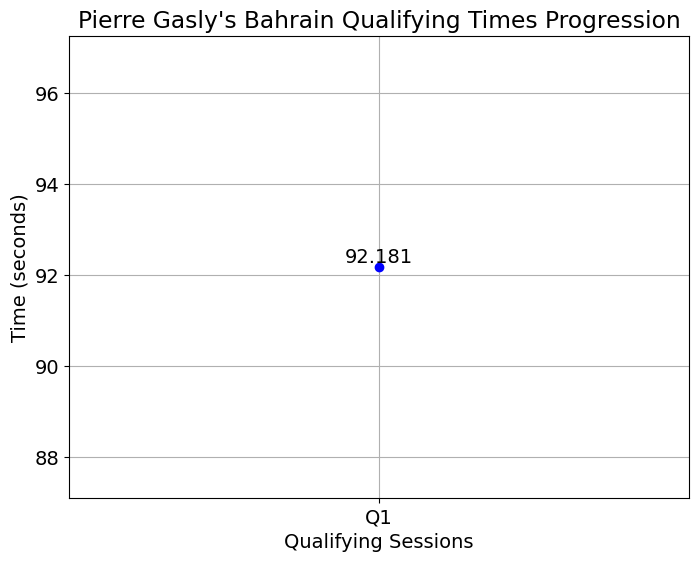

No data available for Daniel Ricciardo
No data available for Liam Lawson


In [39]:
import matplotlib.pyplot as plt
import pandas as pd

# Custom function to convert lap time (m:ss.sss) to seconds
def time_to_seconds(lap_time):
    # Handle NaN or non-string values
    if pd.isna(lap_time) or not isinstance(lap_time, str):
        return None
    try:
        # Split into minutes and seconds
        minutes, seconds = lap_time.split(':')
        total_seconds = int(minutes) * 60 + float(seconds)
        return total_seconds
    except ValueError:
        # Handle cases where the split doesn't work as expected (like if the format is incorrect)
        return None

# Unique list of drivers
drivers = quali['Driver'].unique().tolist()

# Loop through each driver and plot their Q1, Q2, Q3 time progression
for driver in drivers:
    driver_data = bahrain_quali[bahrain_quali['Driver'] == driver]
    
    # Check if driver_data is empty
    if driver_data.empty:
        print(f"No data available for {driver}")
        continue
    
    # Get the times for Q1, Q2, Q3 and handle missing or incorrect data
    q1_time = time_to_seconds(driver_data['Q1'].values[0]) if 'Q1' in driver_data else None
    q2_time = time_to_seconds(driver_data['Q2'].values[0]) if 'Q2' in driver_data else None
    q3_time = time_to_seconds(driver_data['Q3'].values[0]) if 'Q3' in driver_data else None
    
    # Prepare data for plotting (only include non-None times)
    sessions = ['Q1', 'Q2', 'Q3']
    times = [q1_time, q2_time, q3_time]

    # Remove Null values to avoid plotting empty points
    valid_sessions = [s for s, t in zip(sessions, times) if t is not None]
    valid_times = [t for t in times if t is not None]
    
    # Only plot if there are valid times
    if valid_times:
        # Plotting a line chart for each driver's Q1, Q2, Q3 times
        plt.figure(figsize=(8, 6))
        plt.plot(valid_sessions, valid_times, marker='o', linestyle='-', color='blue')
        
        plt.xlabel('Qualifying Sessions')
        plt.ylabel('Time (seconds)')
        plt.title(f"{driver}'s Bahrain Qualifying Times Progression")
        
        for i, time in enumerate(valid_times):
            if time is not None:
                plt.text(valid_sessions[i], valid_times[i], f"{valid_times[i]:.3f}", ha='center', va='bottom')

        plt.grid(True)
        plt.show()


In [40]:
bahrain_quali

,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
5,Bahrain,6,63,George Russell,Mercedes,1:31.057,1:30.507,1:30.340,15
6,Bahrain,7,44,Lewis Hamilton,Mercedes,1:31.543,1:30.513,1:30.384,15
7,Bahrain,8,18,Lance Stroll,Aston Martin Aramco Mercedes,1:31.184,1:31.127,1:30.836,18
8,Bahrain,9,31,Esteban Ocon,Alpine Renault,1:31.508,1:30.914,1:30.984,15
9,Bahrain,10,27,Nico Hulkenberg,Haas Ferrari,1:31.204,1:30.809,DNF,17


# Plotting Race Finishes for each driver

In [41]:
pd.reset_option('display.max_rows')

In [42]:
results 

,Track,Position,No,Driver,Team,Starting Grid,Laps,Time/Retired,Points,Set Fastest Lap,Fastest Lap Time
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1,57,1:33:56.736,25,No,1:36.236
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,2,57,+11.987,18,No,1:36.344
2,Bahrain,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,5,57,+38.637,15,No,1:36.156
3,Bahrain,4,55,Carlos Sainz,Ferrari,4,57,+48.052,12,No,1:37.130
4,Bahrain,5,44,Lewis Hamilton,Mercedes,7,57,+50.977,10,No,1:36.546
...,...,...,...,...,...,...,...,...,...,...,...
435,Abu Dhabi,16,2,Logan Sargeant,Williams Mercedes,20,58,+87.791,0,No,1:28.580
436,Abu Dhabi,17,24,Guanyu Zhou,Alfa Romeo Ferrari,19,58,+89.422,0,No,1:28.746
437,Abu Dhabi,18,55,Carlos Sainz,Ferrari,16,57,DNF,0,No,1:29.452
438,Abu Dhabi,19,77,Valtteri Bottas,Alfa Romeo Ferrari,18,57,+1 lap,0,No,1:29.863


In [43]:
results['Driver'].unique()

array(['Max Verstappen', 'Sergio Perez', 'Fernando Alonso',
       'Carlos Sainz', 'Lewis Hamilton', 'Lance Stroll', 'George Russell',
       'Valtteri Bottas', 'Pierre Gasly', 'Alexander Albon',
       'Yuki Tsunoda', 'Logan Sargeant', 'Kevin Magnussen',
       'Nyck De Vries', 'Nico Hulkenberg', 'Guanyu Zhou', 'Lando Norris',
       'Esteban Ocon', 'Charles Leclerc', 'Oscar Piastri',
       'Daniel Ricciardo', 'Liam Lawson'], dtype=object)

In [44]:
results['Position'].unique()

array(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', 'NC', '18', '19', '20', 'DQ'],
      dtype=object)

In [45]:
results['Position'] = results['Position'].replace(['NC','DQ'],np.nan)

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


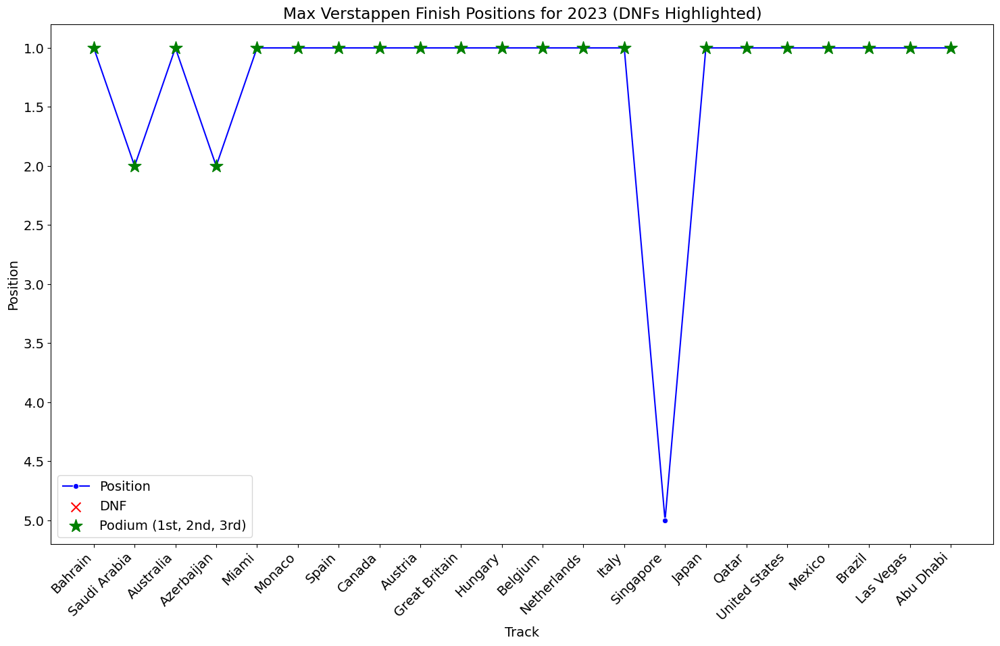

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


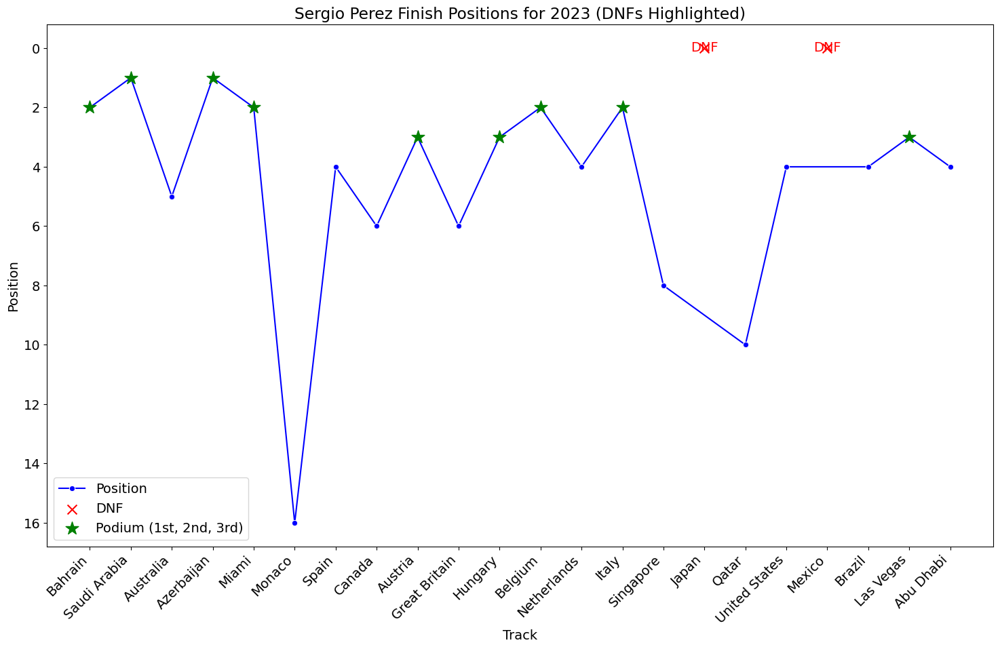

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


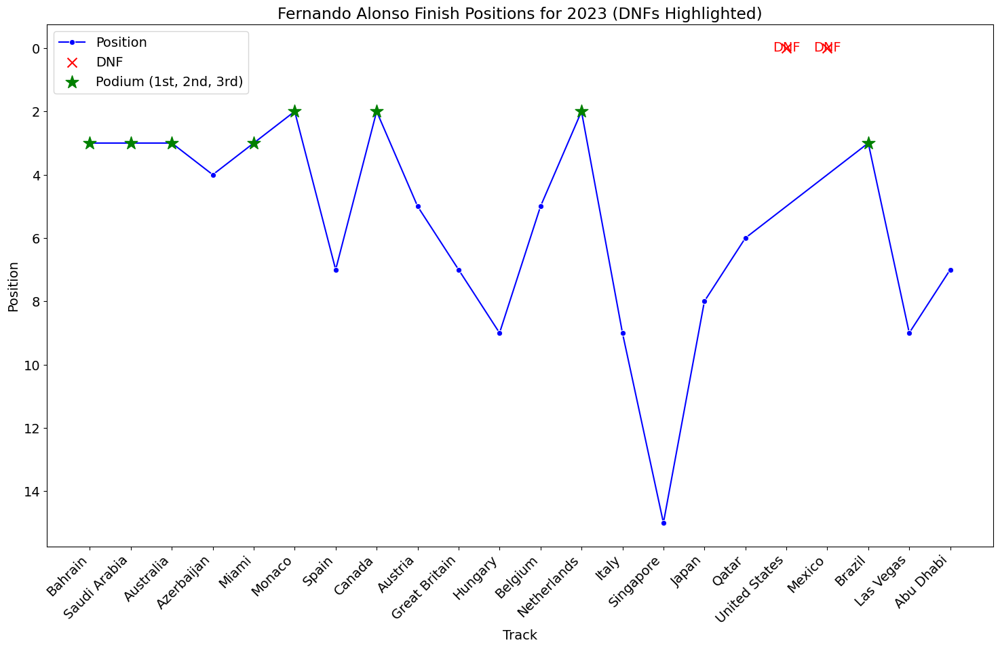

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


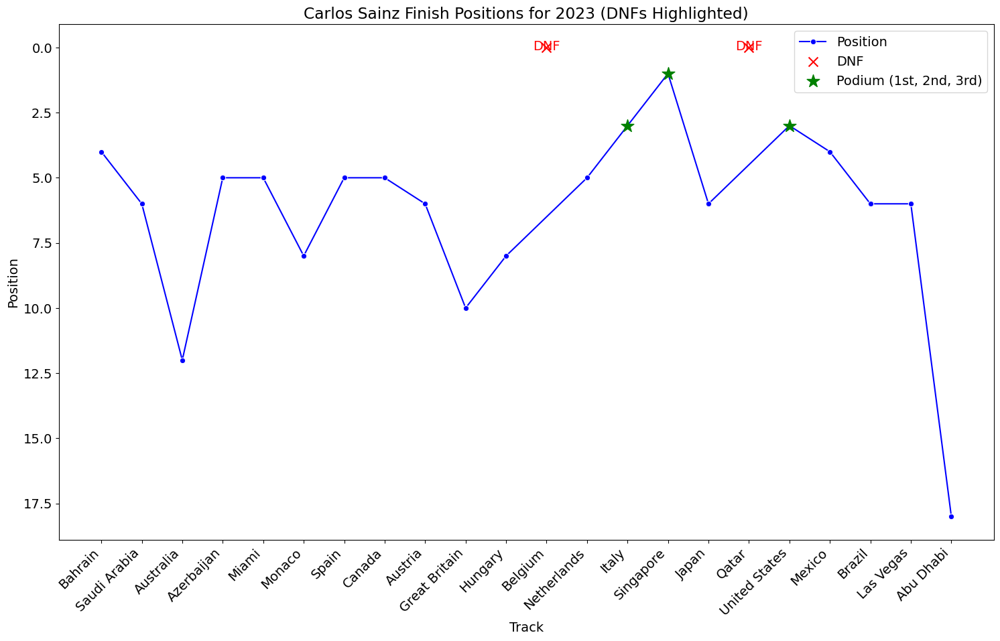

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


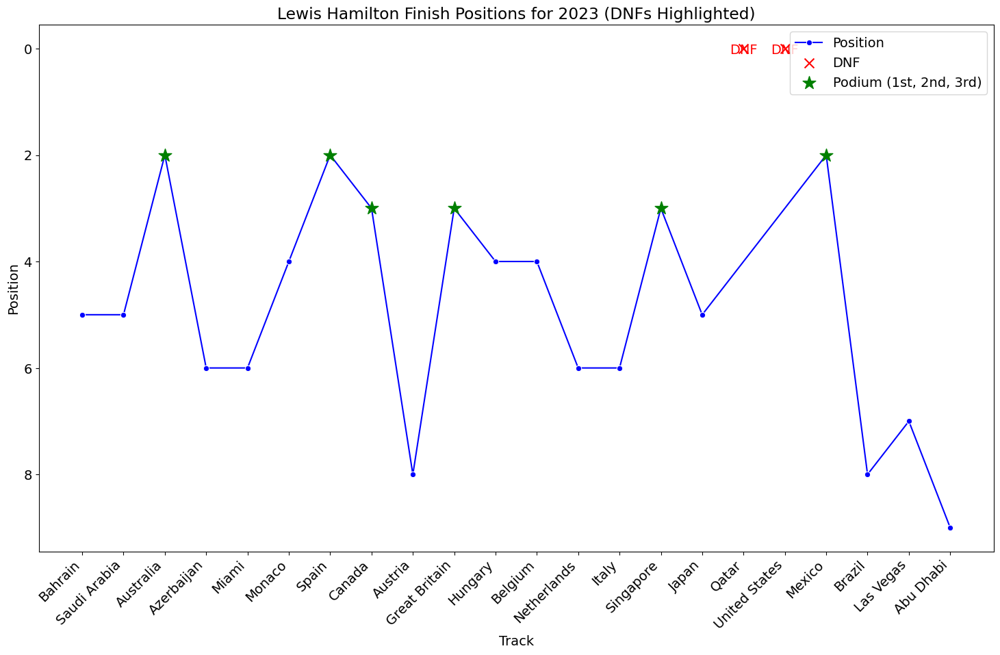

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


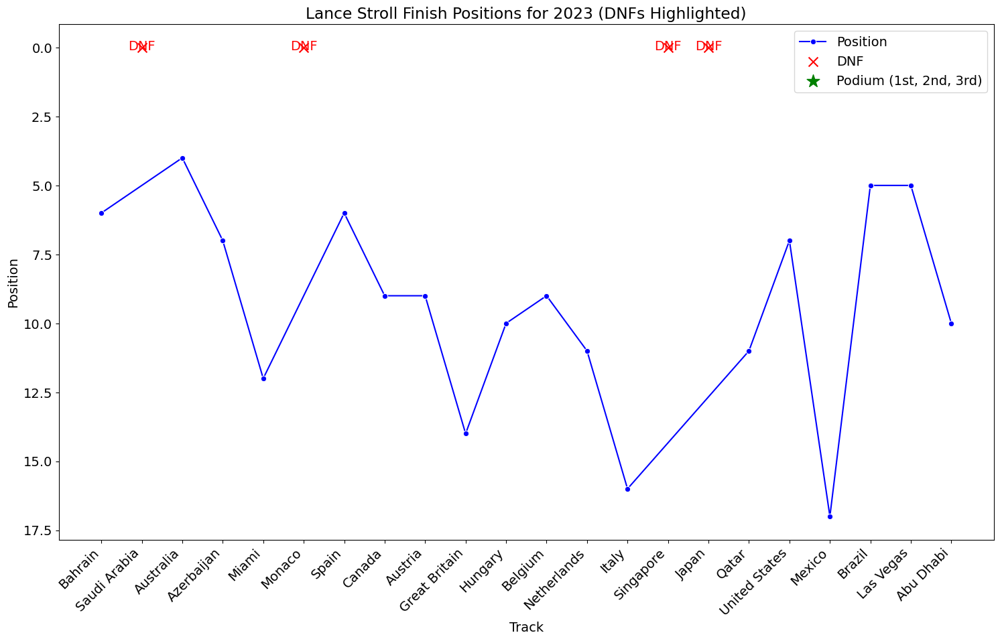

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


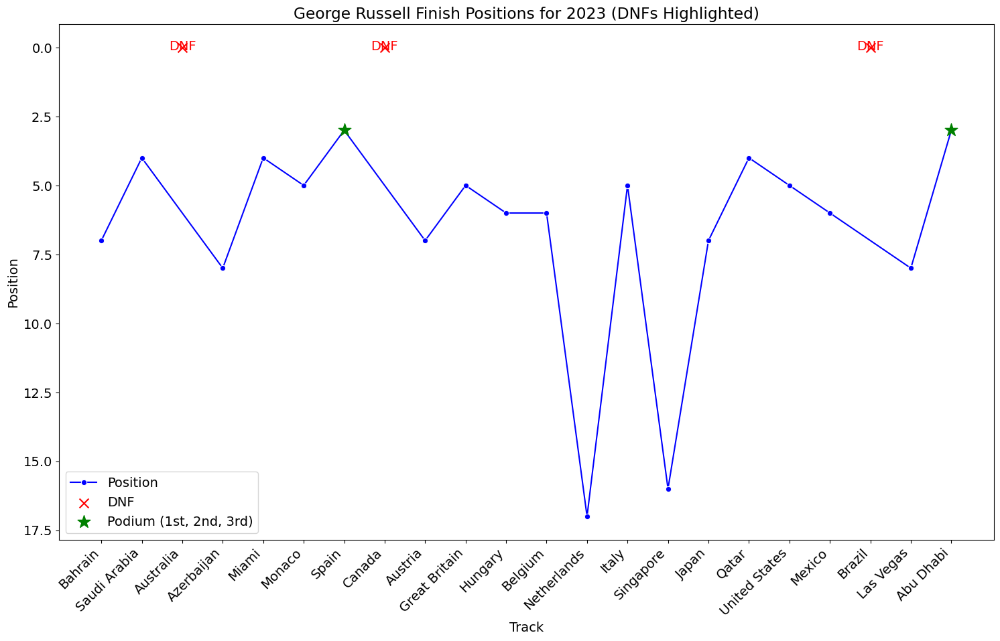

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


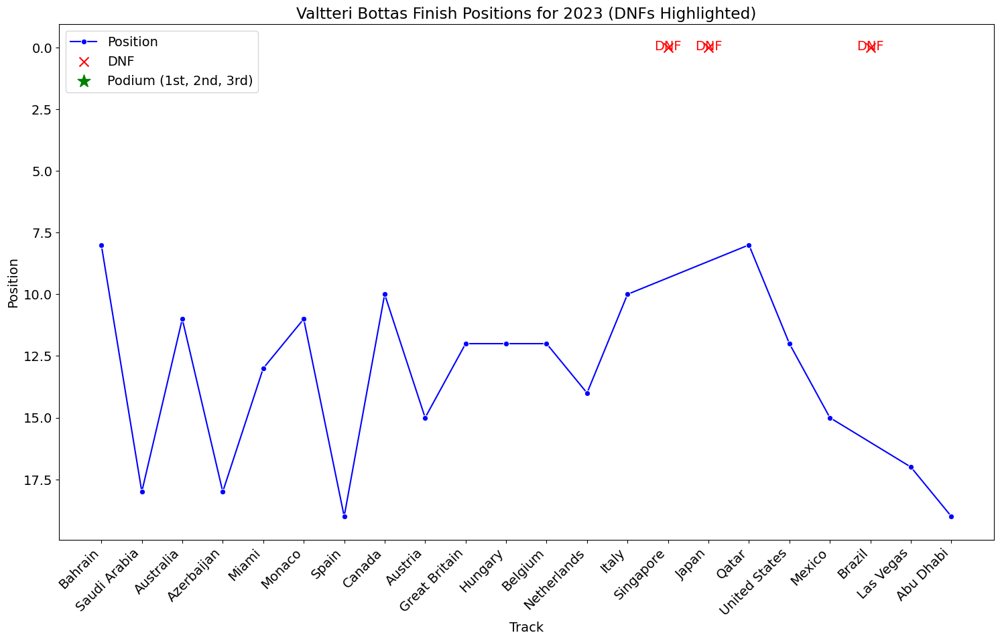

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


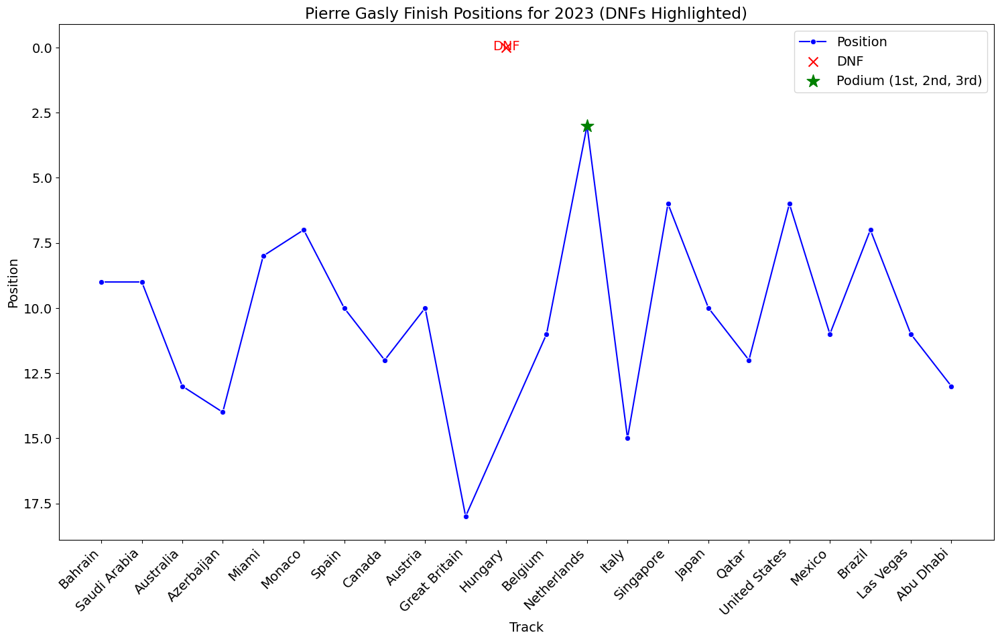

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


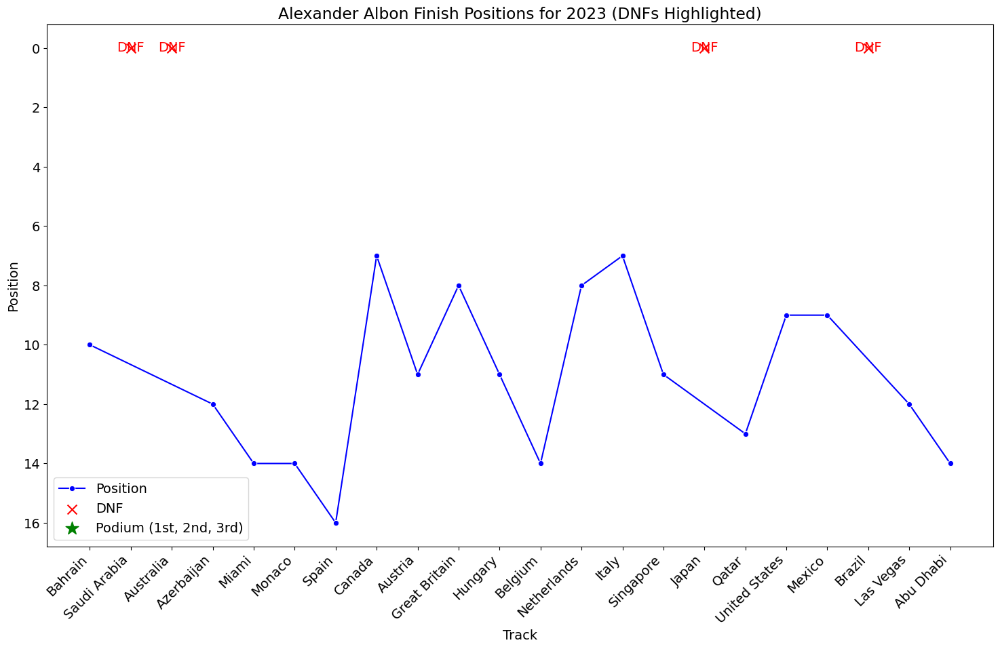

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


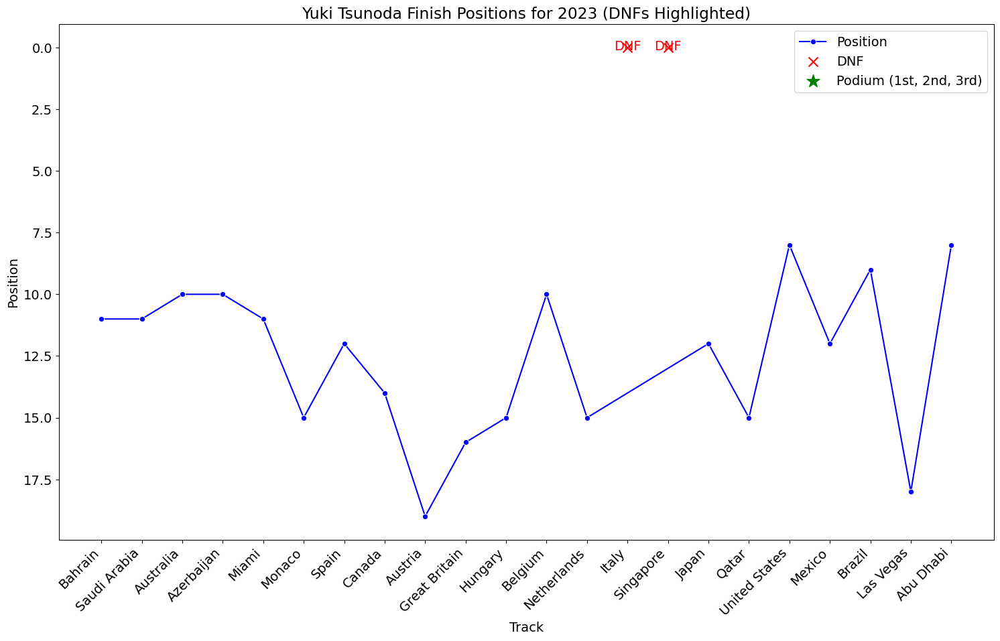

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


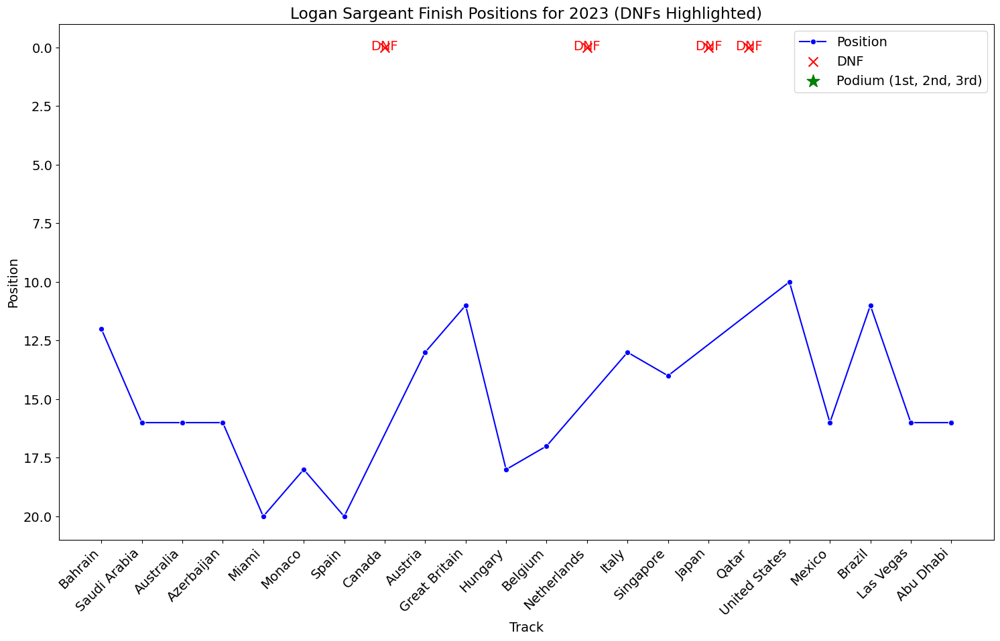

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


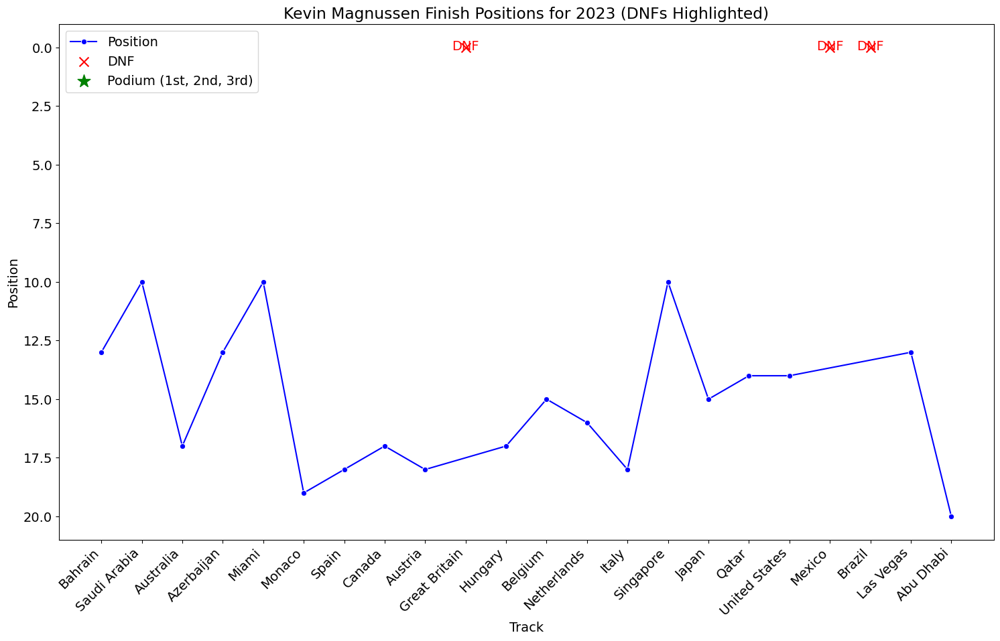

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


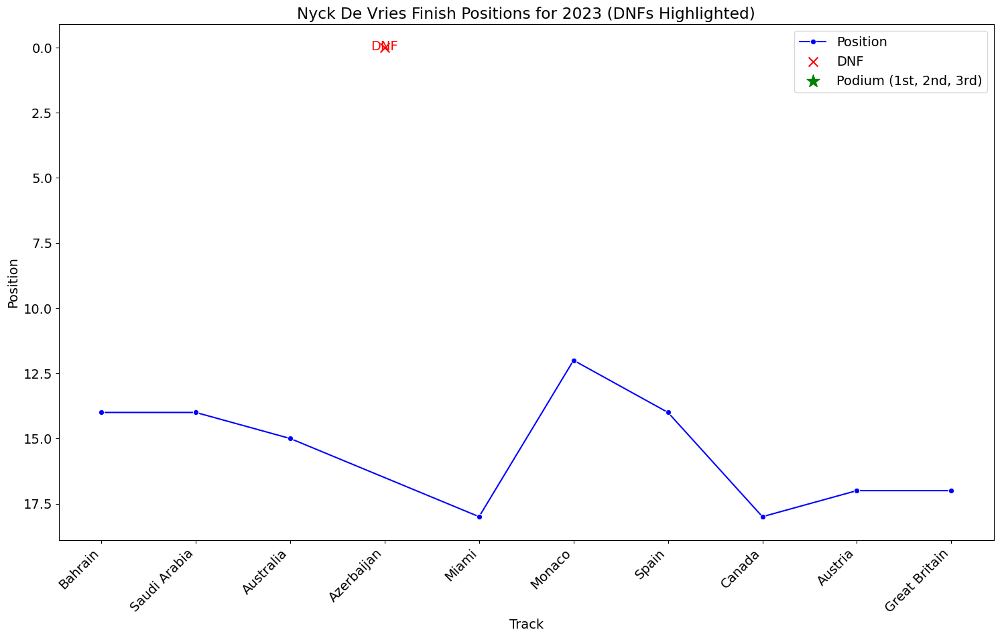

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


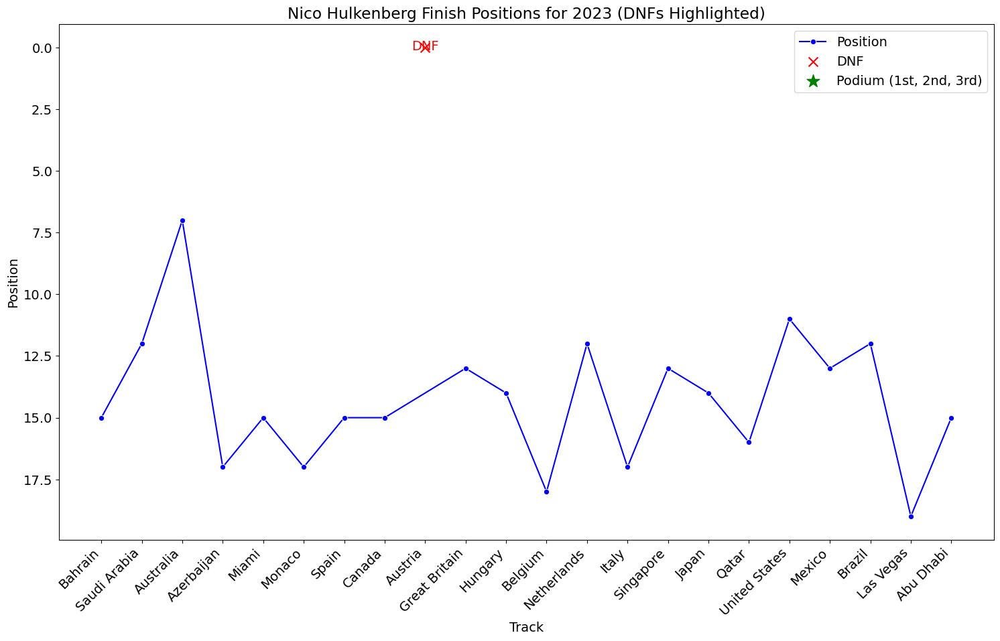

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


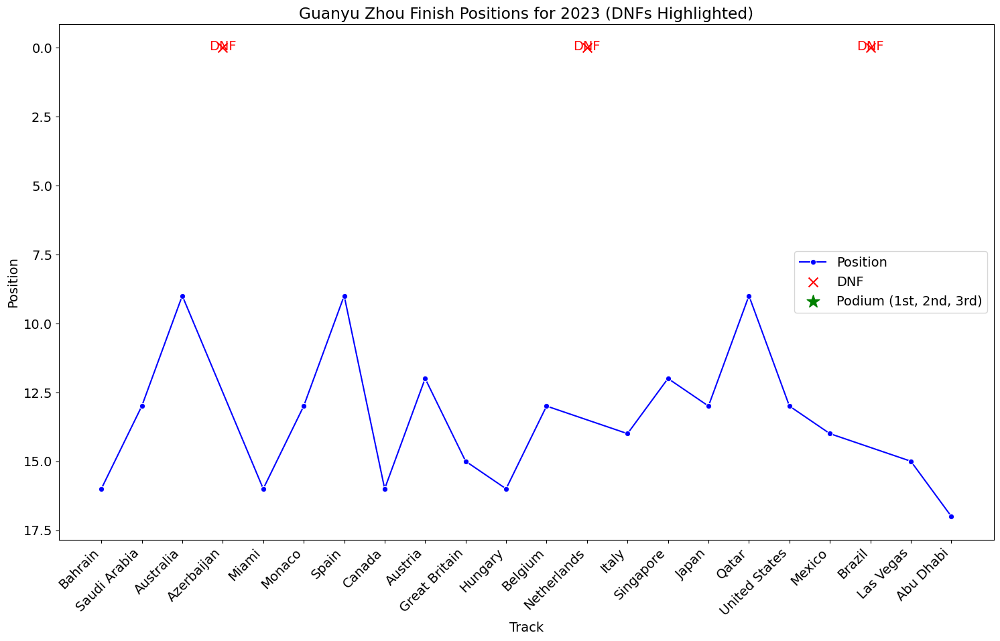

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


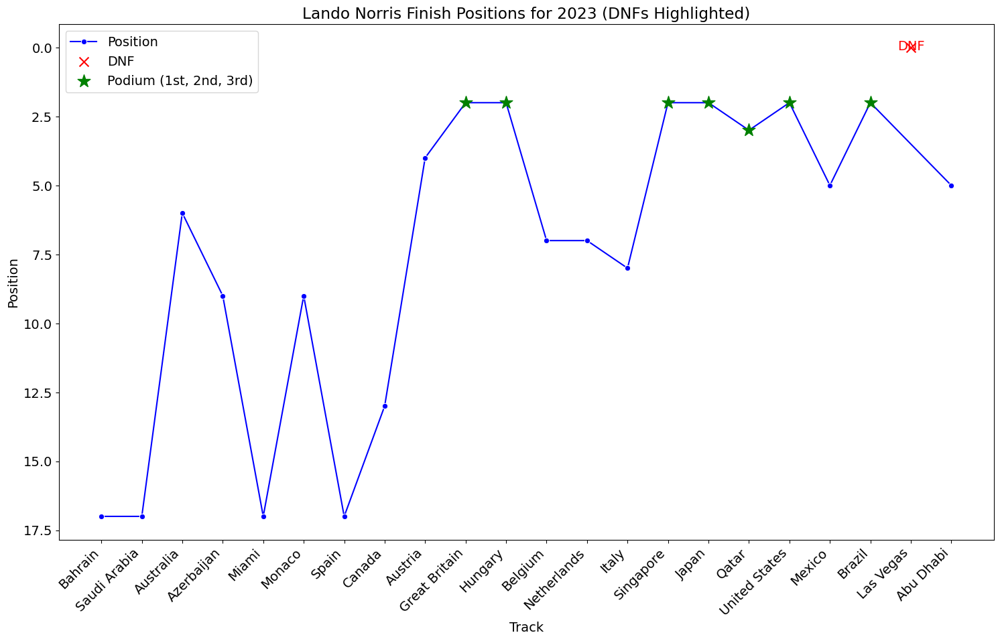

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


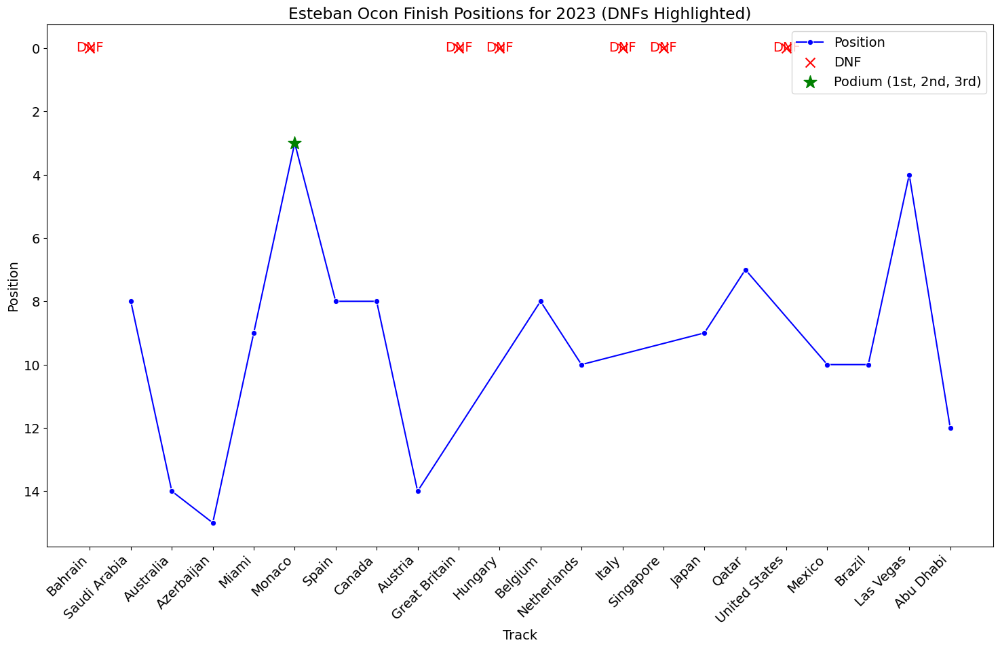

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


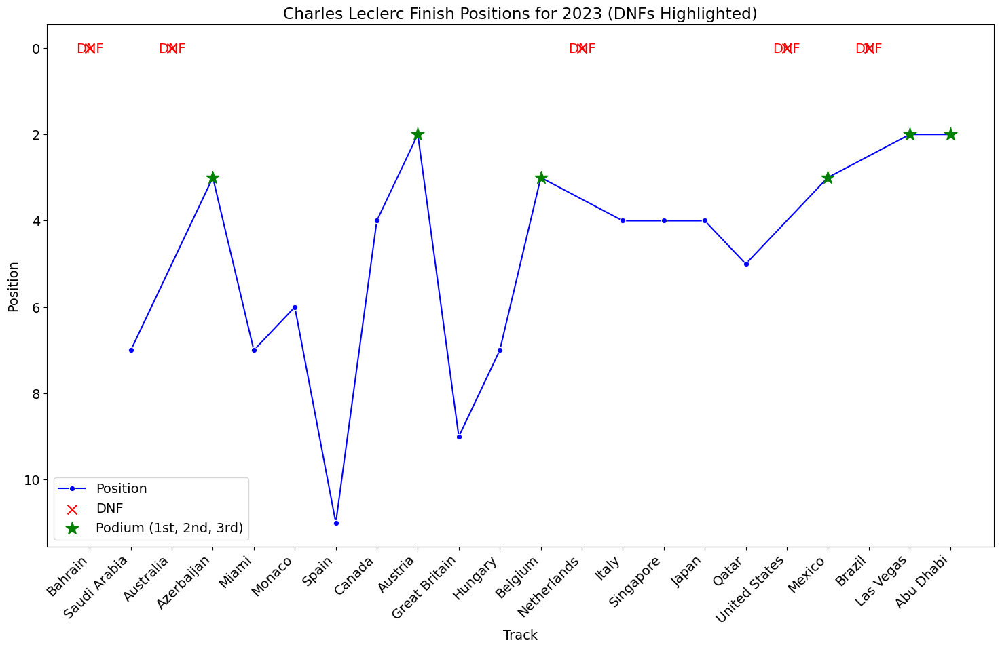

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


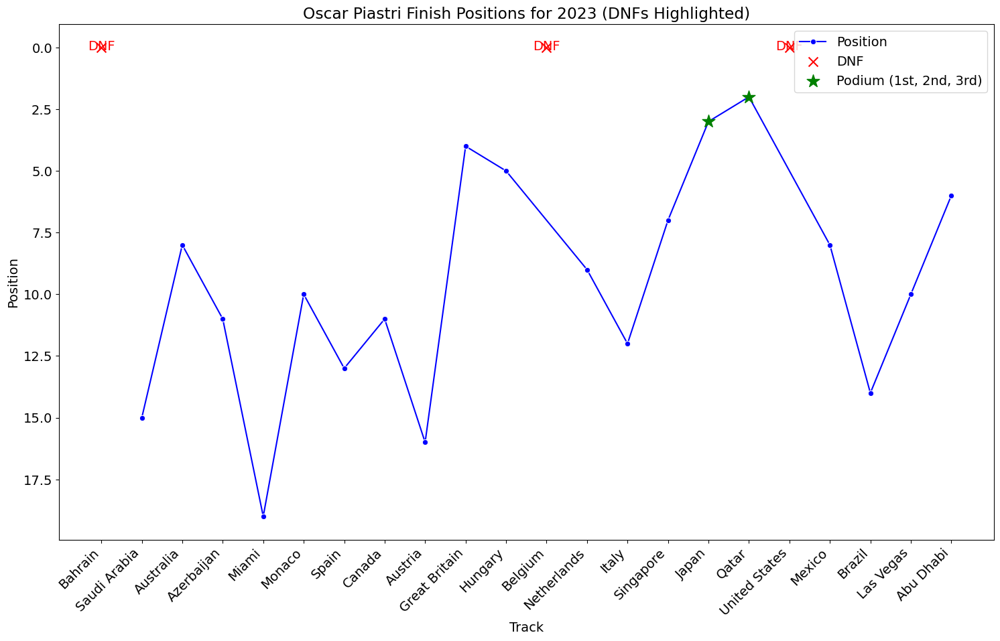

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


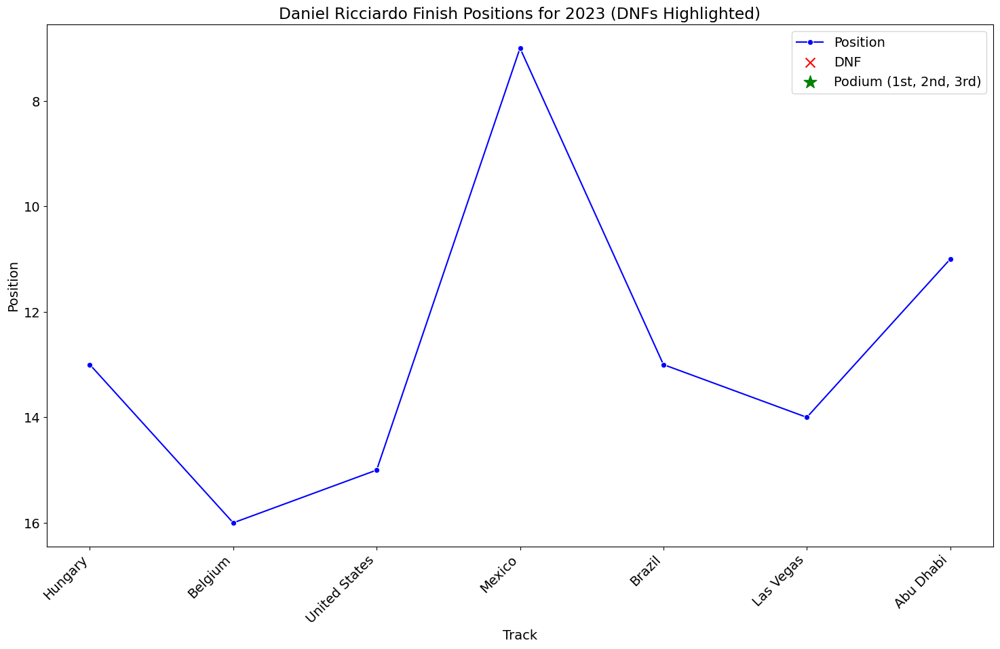

/tmp/ipykernel_36/1063274914.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
/tmp/ipykernel_36/1063274914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)


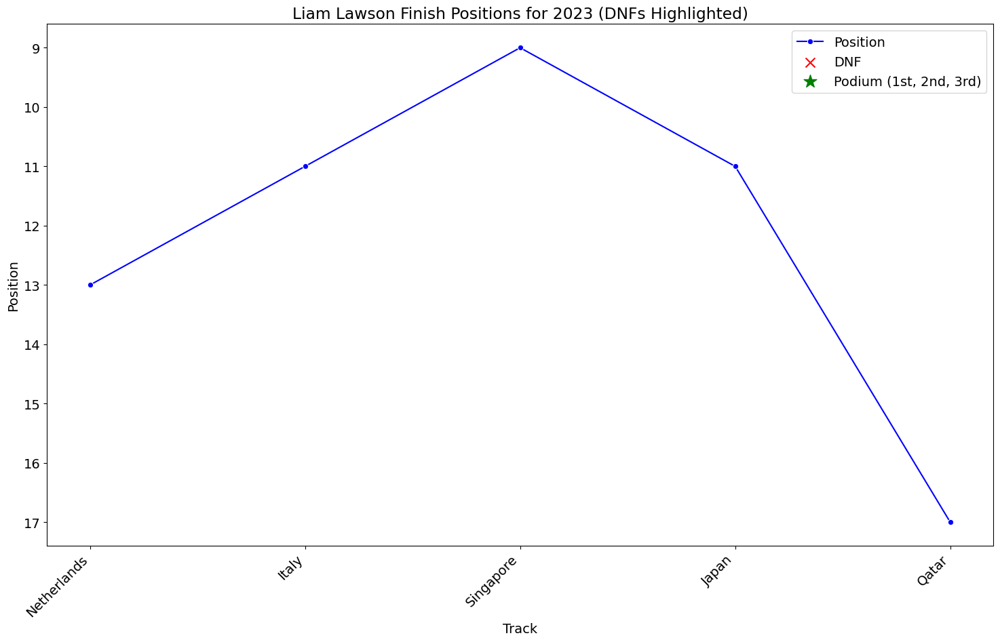

In [46]:

import warnings

warnings.filterwarnings("ignore", category=FutureWarning)

drivers = results['Driver'].unique()

for driver in drivers:

    driver_data = results[results['Driver'] == driver]
    
    driver_data['Position'] = driver_data['Position'].replace('DNF', np.nan).astype(float)
    
    # replacing any potential inf/-inf values with np.nan
    driver_data['Position'].replace([np.inf, -np.inf], np.nan, inplace=True)
    
    driver_dnf = driver_data[driver_data['Position'].isna()]
    
    podium_data = driver_data[driver_data['Position'].isin([1, 2, 3])]
    
    plt.figure(figsize=(18, 10))
    
    sns.lineplot(data=driver_data, x='Track', y='Position', marker='o', label='Position', color='blue')
    
    plt.scatter(driver_dnf['Track'], [0] * len(driver_dnf), color='red', label='DNF', zorder=5, marker='x', s=100)

    for index, row in driver_dnf.iterrows():
        plt.text(row['Track'], 0.1, 'DNF', color='red', ha='center')
    
    plt.scatter(podium_data['Track'], podium_data['Position'], color='green', label='Podium (1st, 2nd, 3rd)', zorder=6, marker='*', s=200)

    plt.title(f'{driver} Finish Positions for 2023 (DNFs Highlighted)')
    plt.xlabel('Track')
    plt.ylabel('Position')
    plt.xticks(rotation=45, ha='right')
    plt.gca().invert_yaxis() 
    

    plt.legend()
    
    plt.show()


# Qualifying Pace Analysis

In [47]:
quali_data = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_qualifyingResults.csv')

In [48]:
quali_data

,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
...,...,...,...,...,...,...,...,...,...
435,Abu Dhabi,16,55,Carlos Sainz,Ferrari,1:24.738,NaN,NaN,6
436,Abu Dhabi,17,20,Kevin Magnussen,Haas Ferrari,1:24.764,NaN,NaN,6
437,Abu Dhabi,18,77,Valtteri Bottas,Alfa Romeo Ferrari,1:24.788,NaN,NaN,6
438,Abu Dhabi,19,24,Guanyu Zhou,Alfa Romeo Ferrari,1:25.159,NaN,NaN,6


In [49]:
tracks = quali_data['Track'].unique()

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

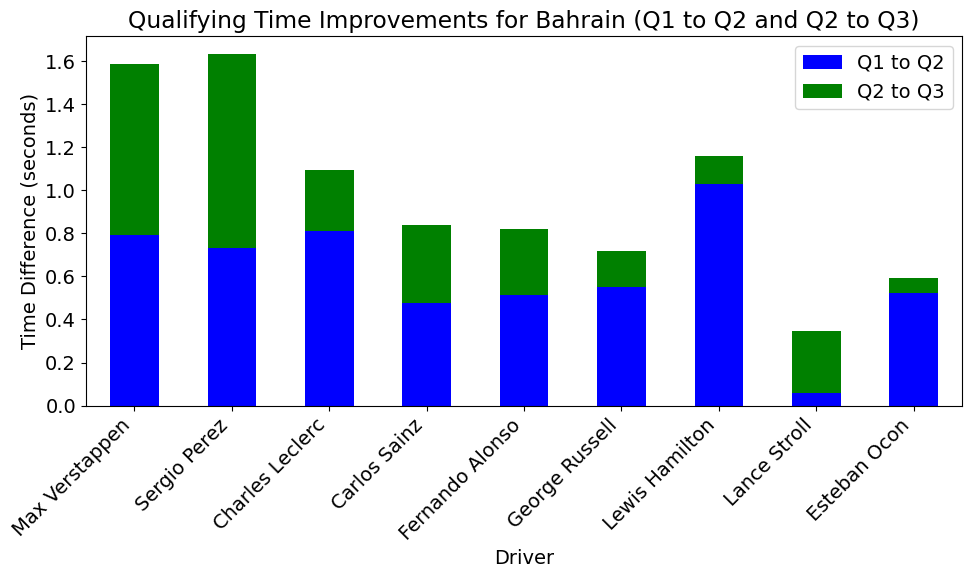

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

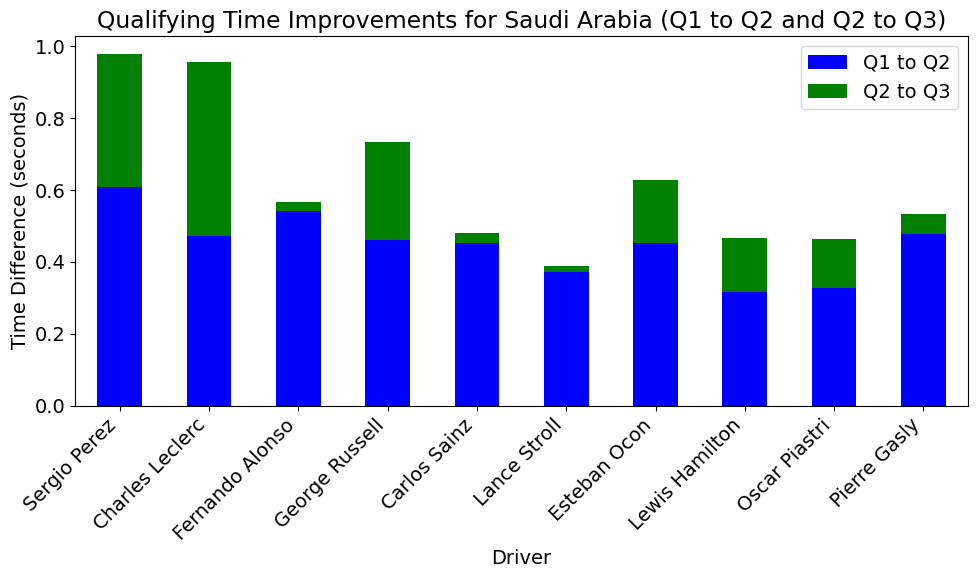

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

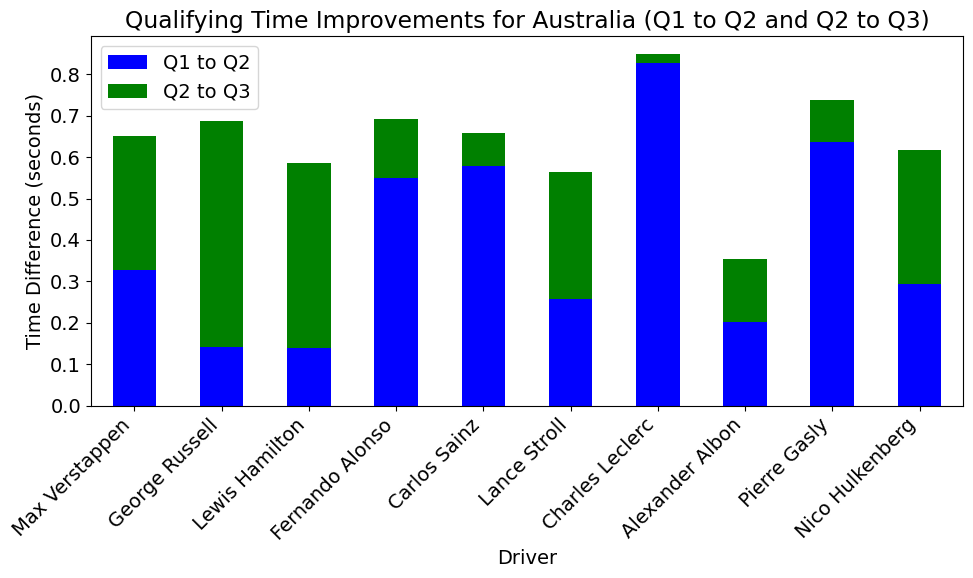

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

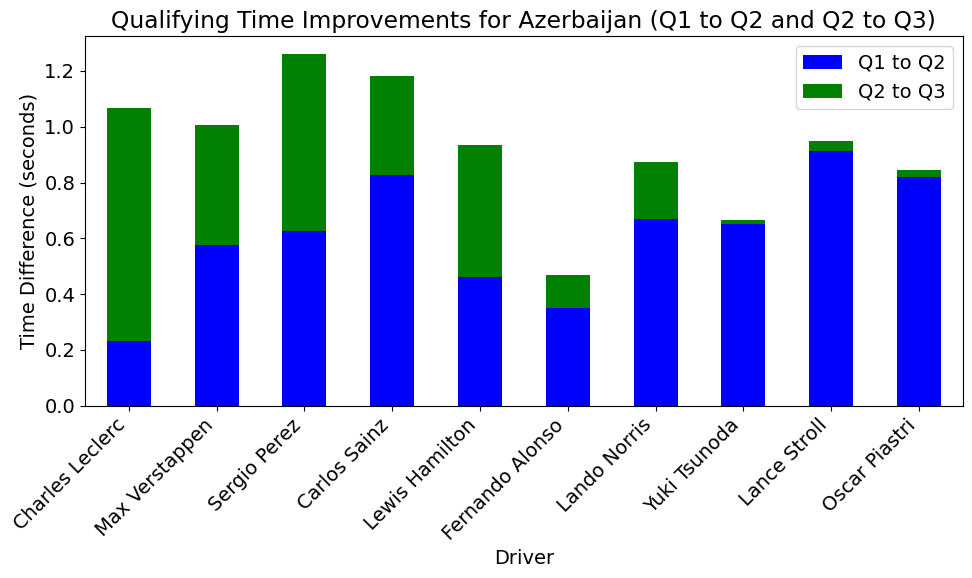

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

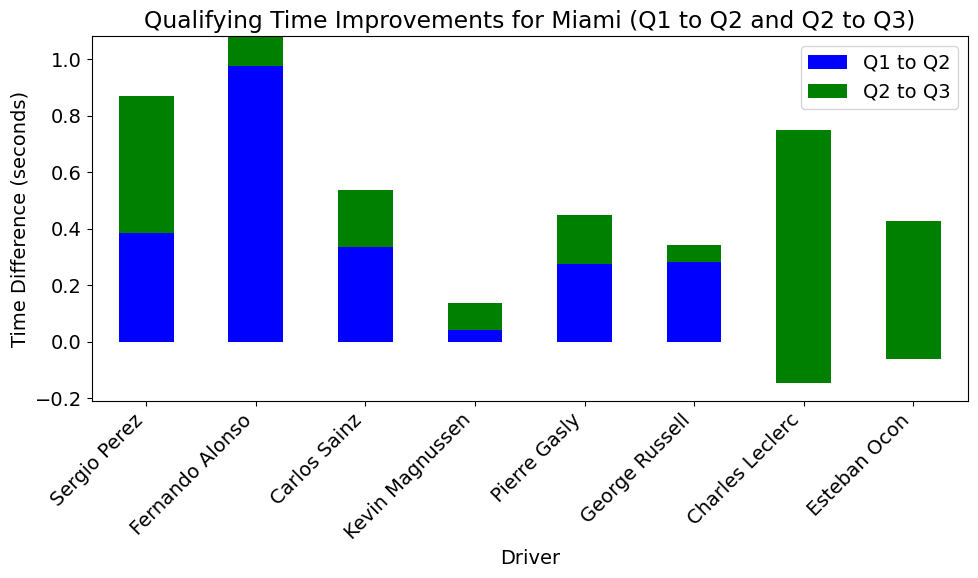

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

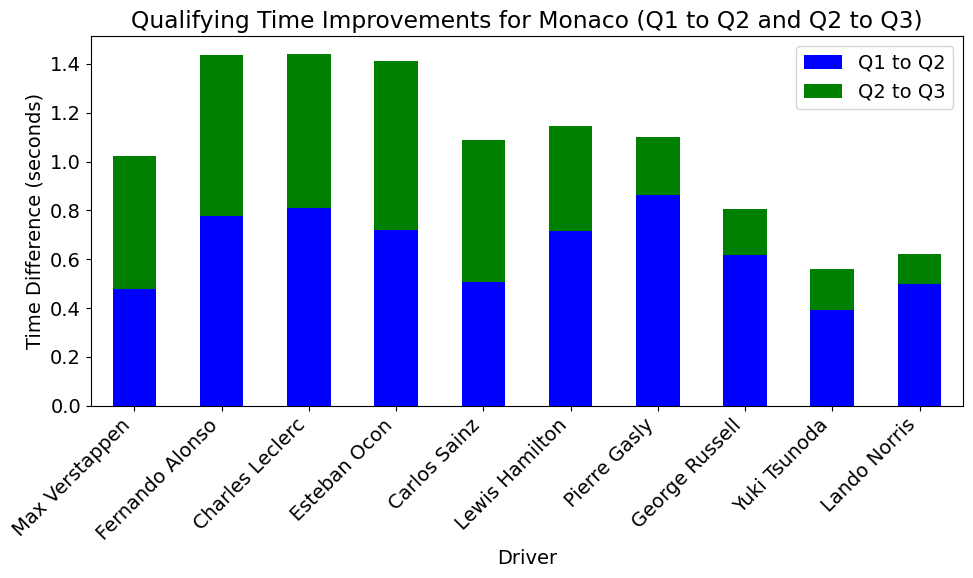

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

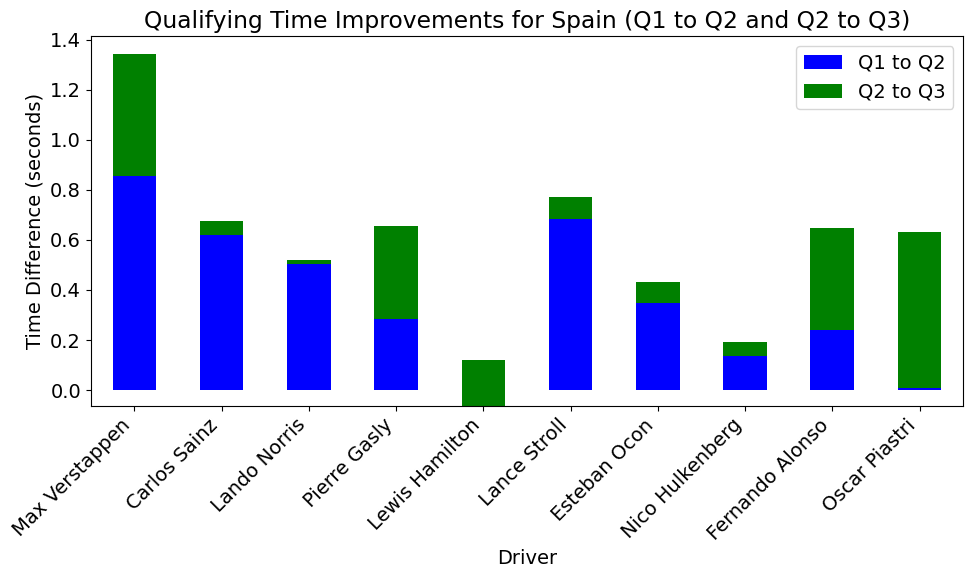

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

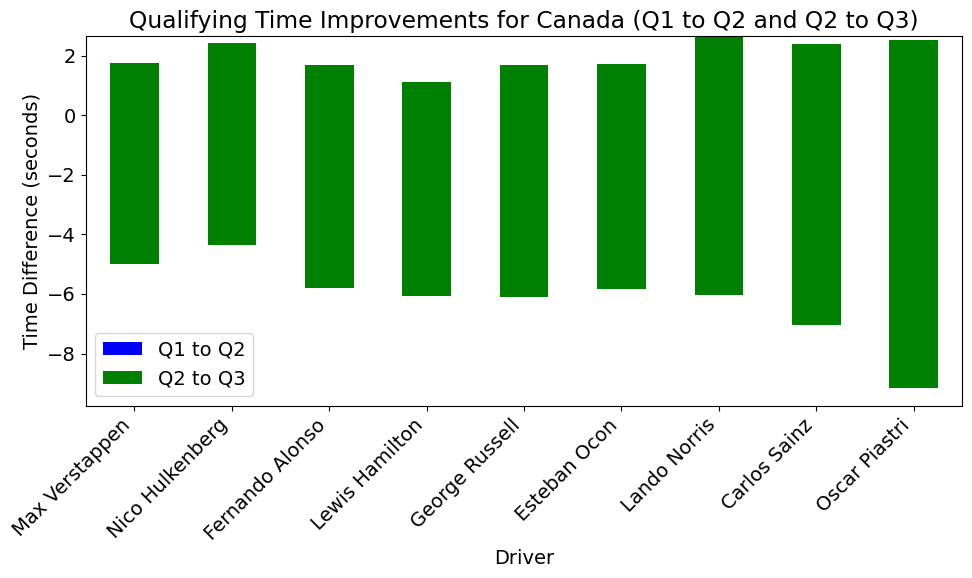

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

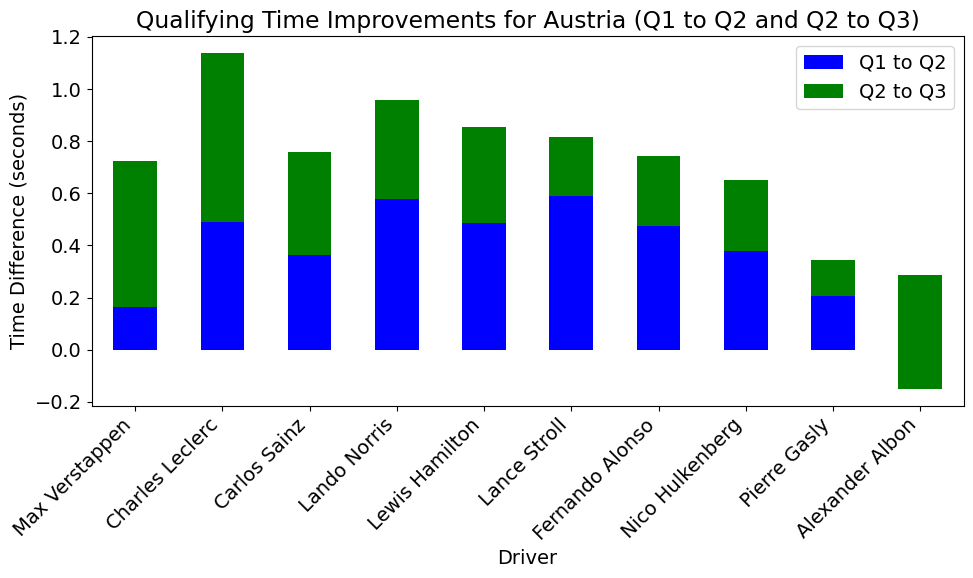

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

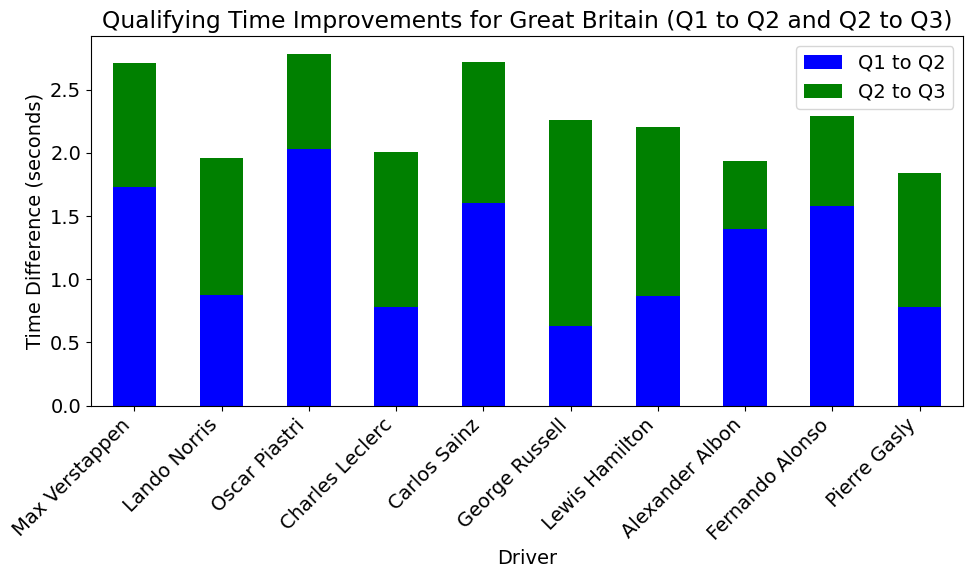

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

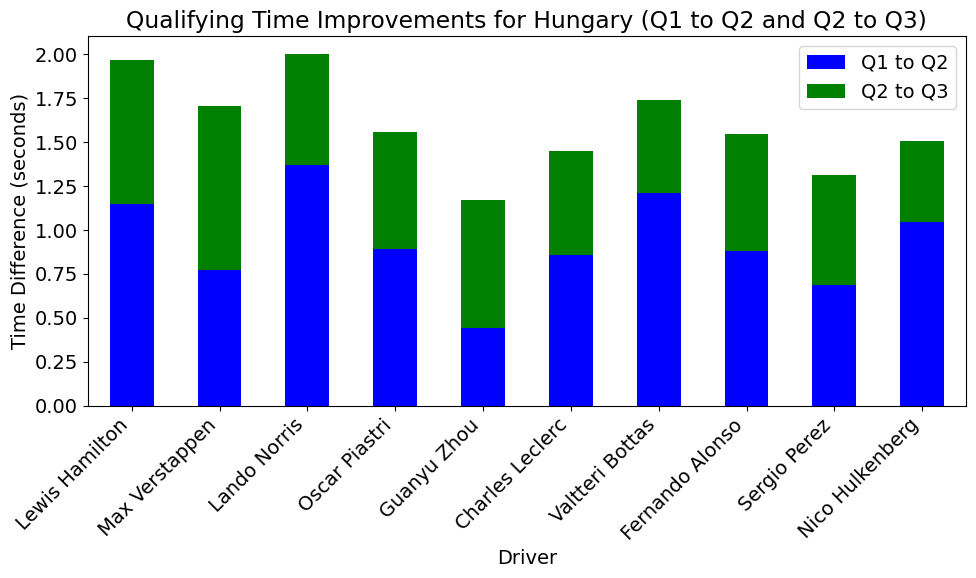

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

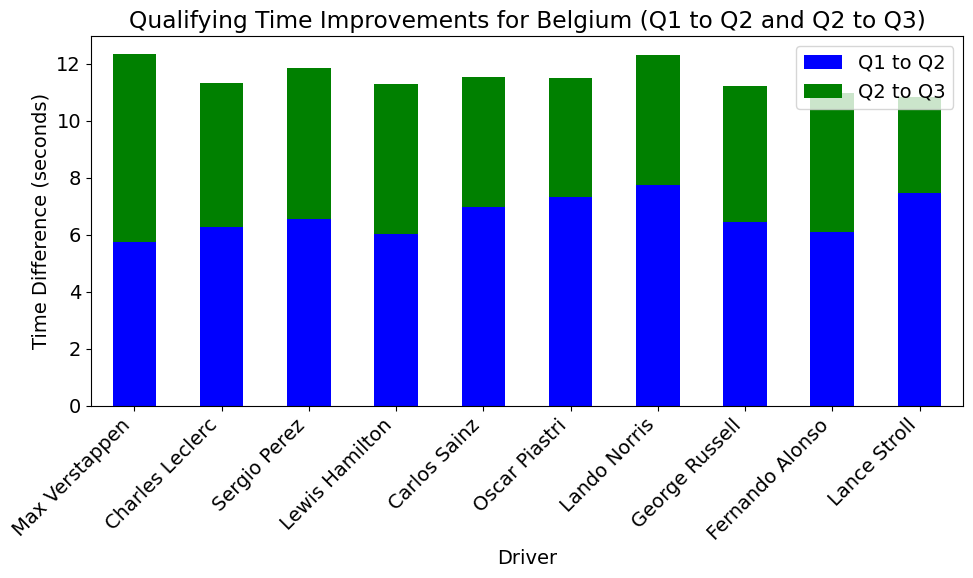

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

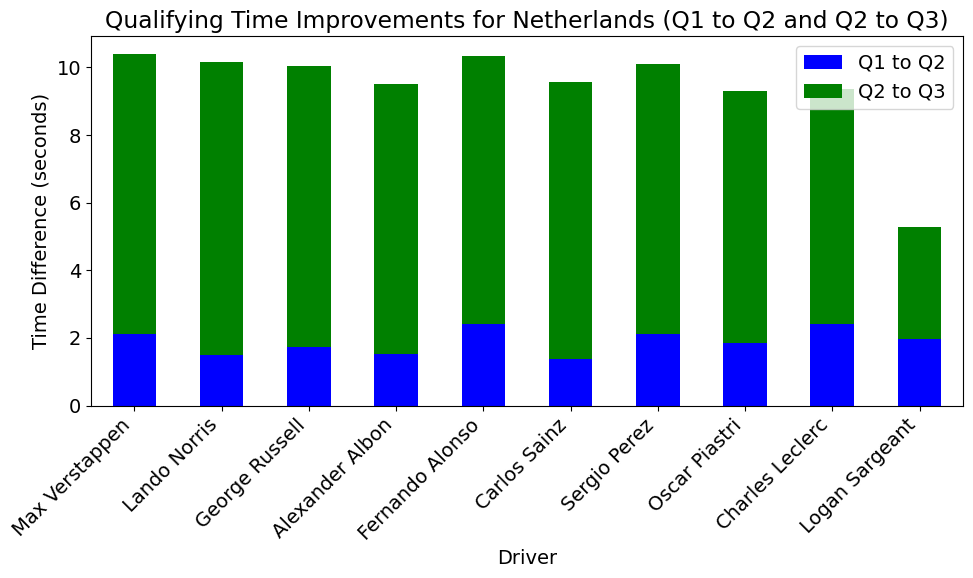

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

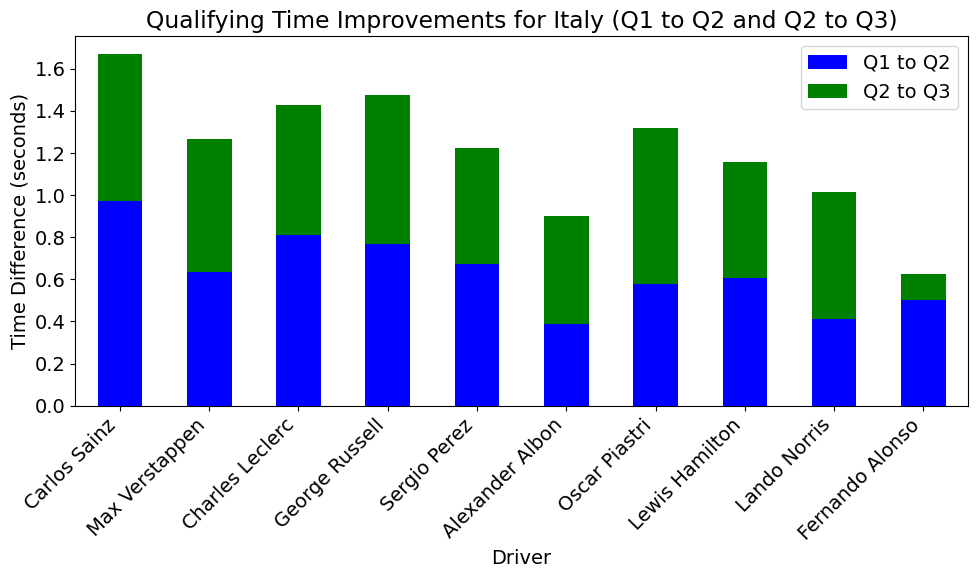

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

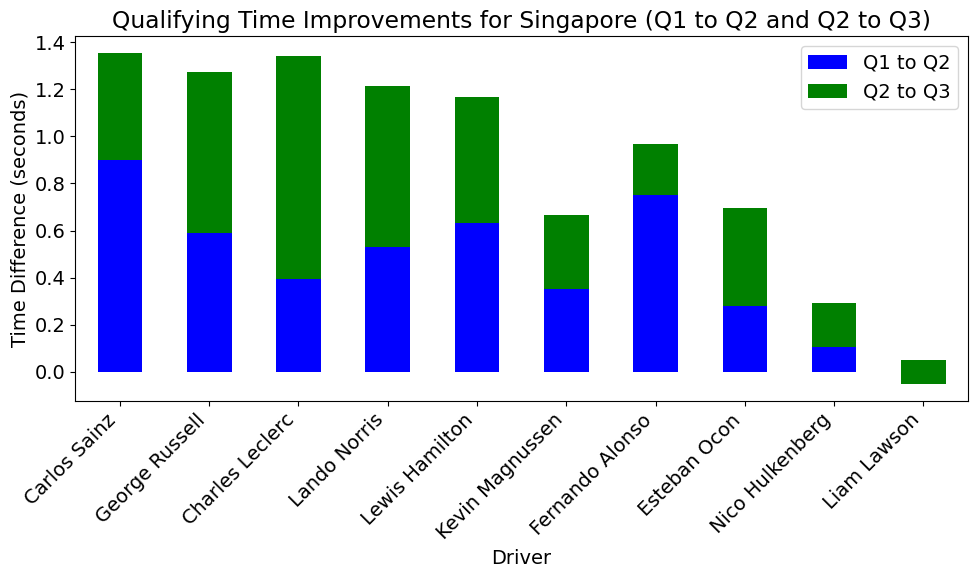

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

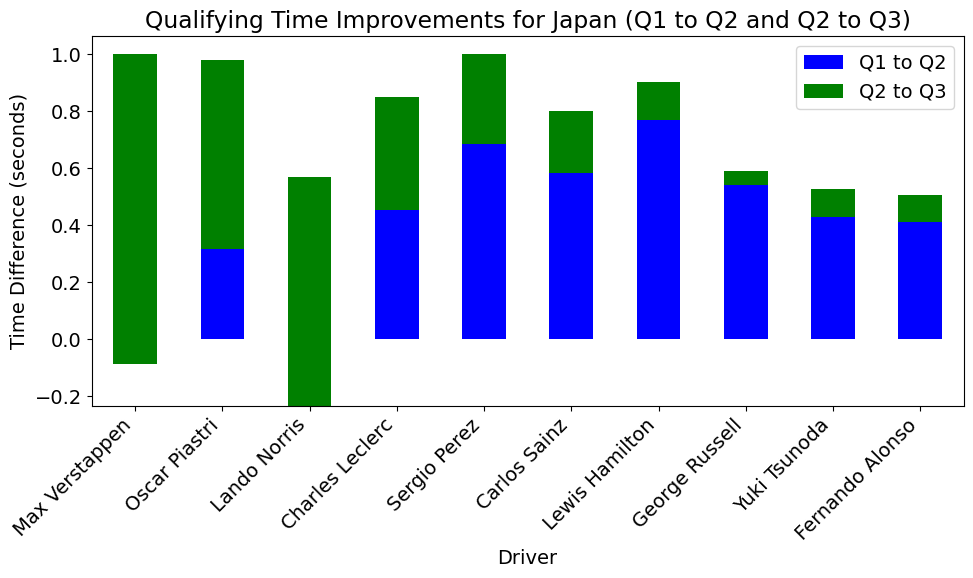

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

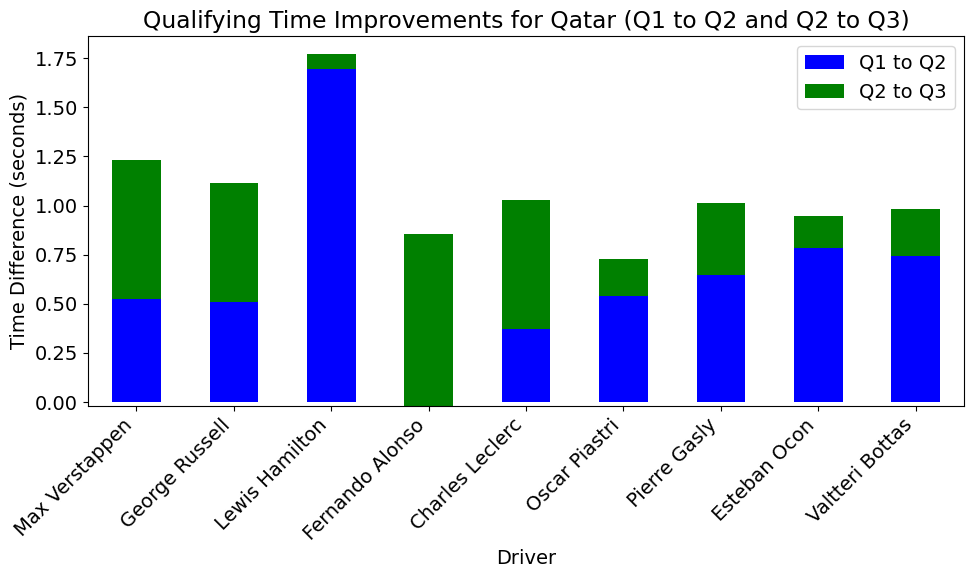

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

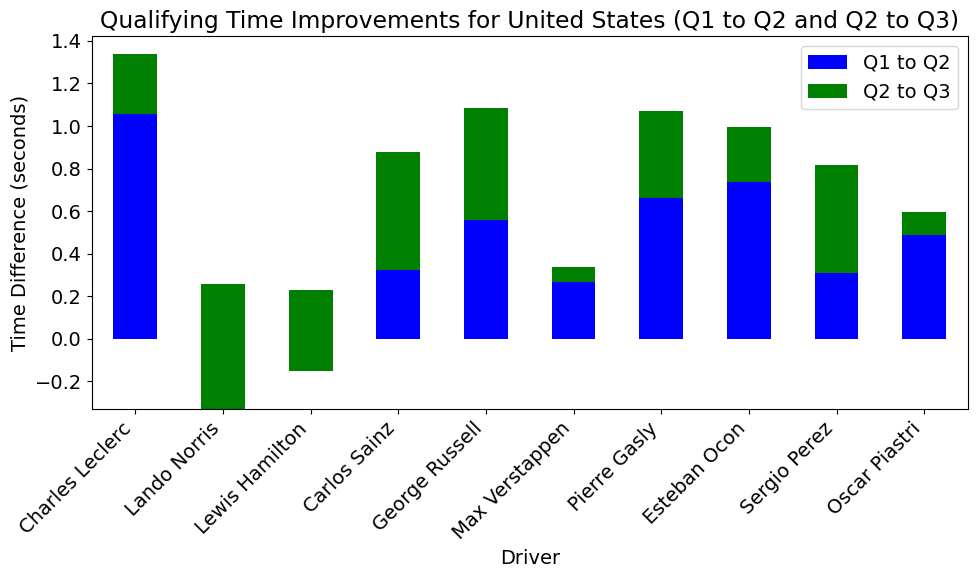

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

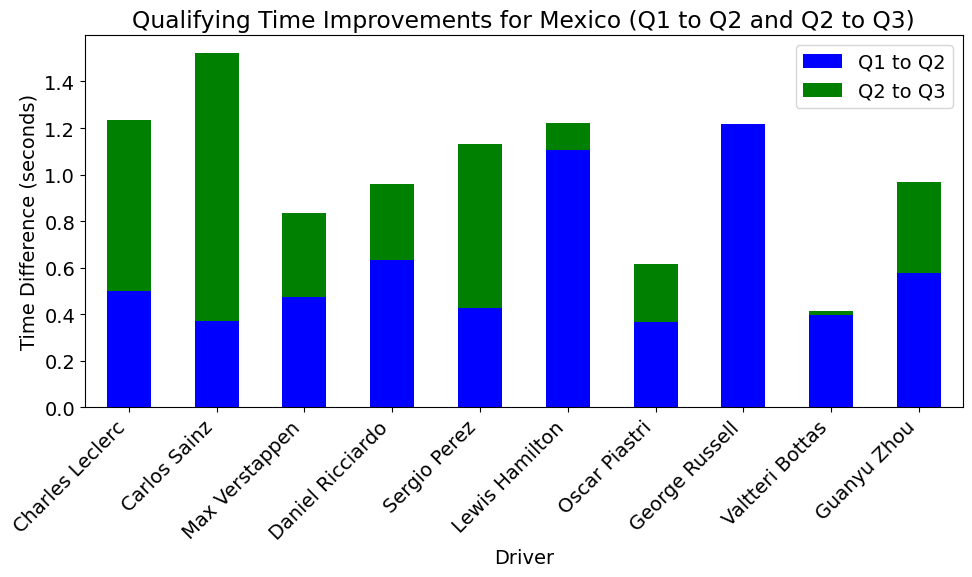

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

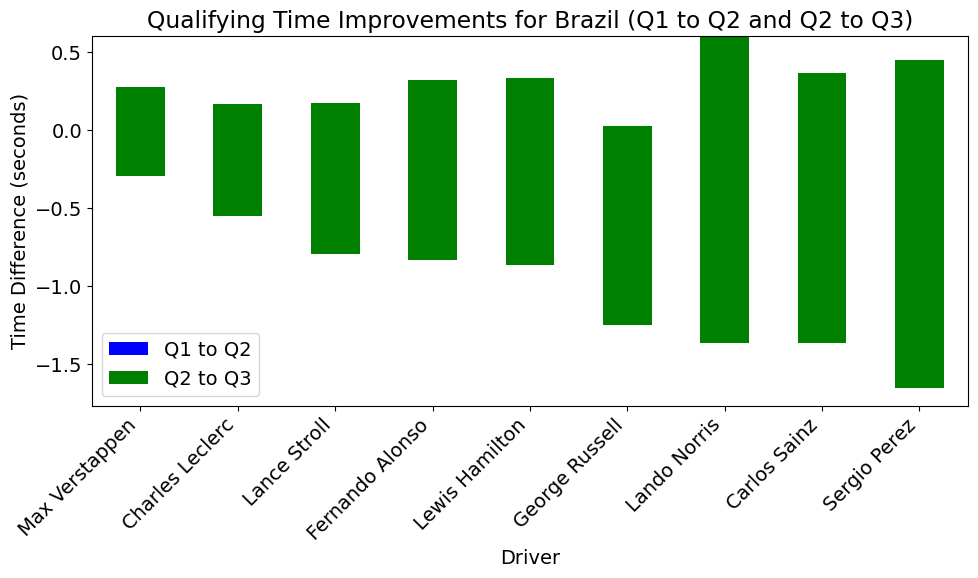

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

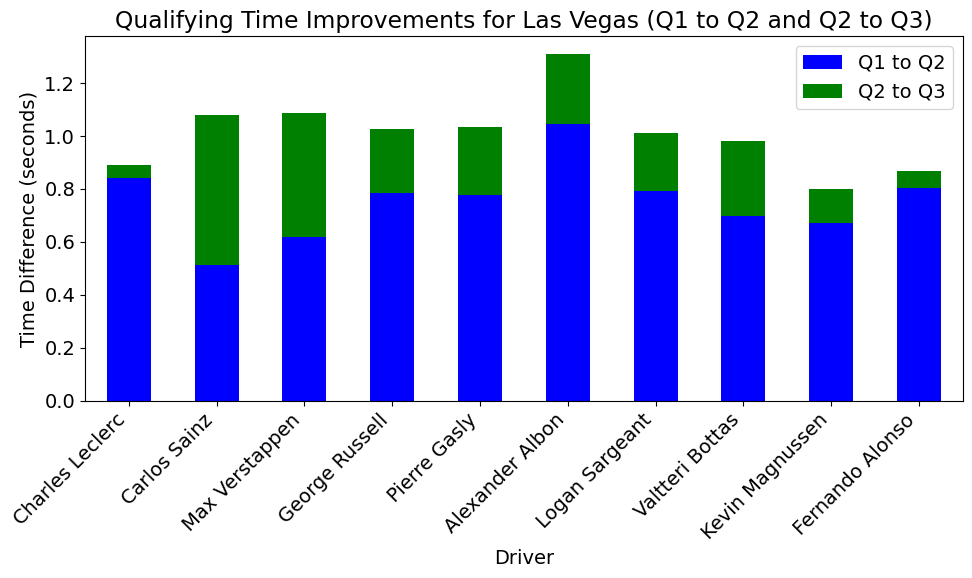

/tmp/ipykernel_36/2323695998.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
/tmp/ipykernel_36/2323695998.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

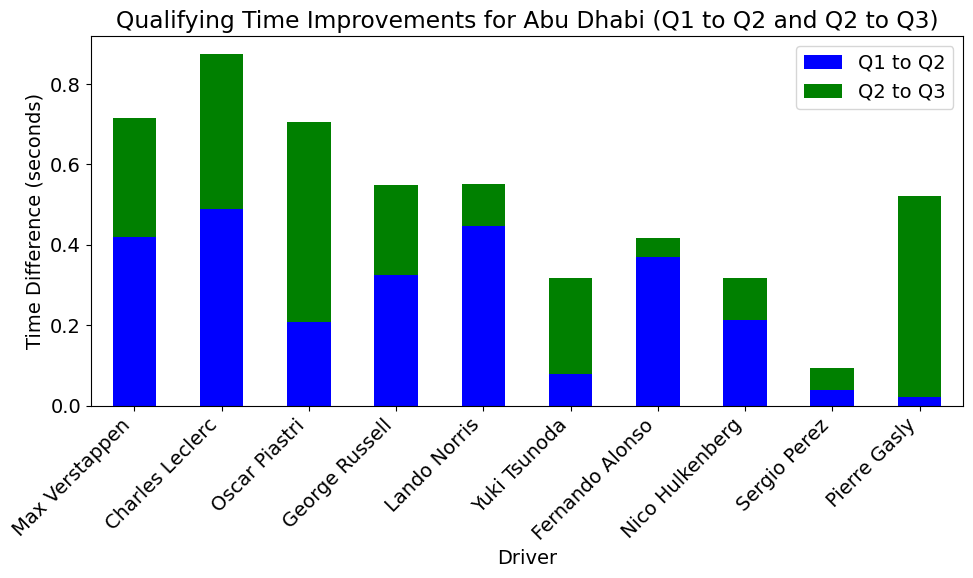

In [50]:
# Function to convert 'm:ss.xxx' format to 'hh:mm:ss.xxx' format, handling existing Timedelta objects
def convert_time_format(time_str):
    if pd.isna(time_str):  # Handle NaN values
        return time_str
    if isinstance(time_str, pd.Timedelta):  # If already a Timedelta, return as is
        return time_str
    return '00:' + time_str  # Add '00:' at the start for string values


for track in tracks:
    track_quali_data = quali_data[quali_data['Track'] == track]
    

    track_quali_data['Q1'] = track_quali_data['Q1'].apply(convert_time_format)
    track_quali_data['Q2'] = track_quali_data['Q2'].apply(convert_time_format)
    track_quali_data['Q3'] = track_quali_data['Q3'].apply(convert_time_format)

    
    track_quali_data['Q1'] = pd.to_timedelta(track_quali_data['Q1'], errors='coerce')
    track_quali_data['Q2'] = pd.to_timedelta(track_quali_data['Q2'], errors='coerce')
    track_quali_data['Q3'] = pd.to_timedelta(track_quali_data['Q3'], errors='coerce')

    
    track_quali_data['Q1_Q2_diff'] = (track_quali_data['Q1'] - track_quali_data['Q2']).dt.total_seconds()
    track_quali_data['Q2_Q3_diff'] = (track_quali_data['Q2'] - track_quali_data['Q3']).dt.total_seconds()

    # Filter out drivers who didn’t qualify for Q2 or Q3
    track_quali_filtered = track_quali_data.dropna(subset=['Q1_Q2_diff', 'Q2_Q3_diff'])
    
    
    if not track_quali_filtered.empty:
        fig, ax = plt.subplots(figsize=(10, 6))
        track_quali_filtered.plot(kind='bar', x='Driver', y='Q1_Q2_diff', ax=ax, color='blue', label='Q1 to Q2')
        track_quali_filtered.plot(kind='bar', x='Driver', y='Q2_Q3_diff', ax=ax, color='green', bottom=track_quali_filtered['Q1_Q2_diff'], label='Q2 to Q3')

        plt.xlabel('Driver')
        plt.ylabel('Time Difference (seconds)')
        plt.title(f'Qualifying Time Improvements for {track} (Q1 to Q2 and Q2 to Q3)')
        plt.legend()
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()

In [51]:
quali_data 

,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
...,...,...,...,...,...,...,...,...,...
435,Abu Dhabi,16,55,Carlos Sainz,Ferrari,1:24.738,NaN,NaN,6
436,Abu Dhabi,17,20,Kevin Magnussen,Haas Ferrari,1:24.764,NaN,NaN,6
437,Abu Dhabi,18,77,Valtteri Bottas,Alfa Romeo Ferrari,1:24.788,NaN,NaN,6
438,Abu Dhabi,19,24,Guanyu Zhou,Alfa Romeo Ferrari,1:25.159,NaN,NaN,6


In [52]:
bahrain_quali = quali_data[quali_data['Track']=='Bahrain']

In [53]:
bahrain_quali

,Track,Position,No,Driver,Team,Q1,Q2,Q3,Laps
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1:31.295,1:30.503,1:29.708,15
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,1:31.479,1:30.746,1:29.846,15
2,Bahrain,3,16,Charles Leclerc,Ferrari,1:31.094,1:30.282,1:30.000,17
3,Bahrain,4,55,Carlos Sainz,Ferrari,1:30.993,1:30.515,1:30.154,18
4,Bahrain,5,14,Fernando Alonso,Aston Martin Aramco Mercedes,1:31.158,1:30.645,1:30.336,15
5,Bahrain,6,63,George Russell,Mercedes,1:31.057,1:30.507,1:30.340,15
6,Bahrain,7,44,Lewis Hamilton,Mercedes,1:31.543,1:30.513,1:30.384,15
7,Bahrain,8,18,Lance Stroll,Aston Martin Aramco Mercedes,1:31.184,1:31.127,1:30.836,18
8,Bahrain,9,31,Esteban Ocon,Alpine Renault,1:31.508,1:30.914,1:30.984,15
9,Bahrain,10,27,Nico Hulkenberg,Haas Ferrari,1:31.204,1:30.809,DNF,17


# Analyzing Team Performance 

In [54]:
results = pd.read_csv('/kaggle/input/formula-1-2023/Formula1_2023season_raceResults.csv')

In [55]:
results['Position'].unique()

array(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', 'NC', '18', '19', '20', 'DQ'],
      dtype=object)

In [56]:
results['Position'] = results['Position'].replace(['NC','DQ'],np.nan)


In [57]:
results.Position.unique()

array(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', nan, '18', '19', '20'], dtype=object)

In [58]:
results['Position']= results.Position.fillna(0)

In [59]:
# results.Position = results['Position'].replace('DNF',0)

In [60]:
# results['Position'] = results['Position'].astype('int64')

In [61]:
results['Position'] = results['Position'].astype('int64')
results['Podium'] = results['Position'].apply(lambda x: 'Yes' if (x <= 3 and x > 0) else 'No')


In [62]:
results

,Track,Position,No,Driver,Team,Starting Grid,Laps,Time/Retired,Points,Set Fastest Lap,Fastest Lap Time,Podium
0,Bahrain,1,1,Max Verstappen,Red Bull Racing Honda RBPT,1,57,1:33:56.736,25,No,1:36.236,Yes
1,Bahrain,2,11,Sergio Perez,Red Bull Racing Honda RBPT,2,57,+11.987,18,No,1:36.344,Yes
2,Bahrain,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,5,57,+38.637,15,No,1:36.156,Yes
3,Bahrain,4,55,Carlos Sainz,Ferrari,4,57,+48.052,12,No,1:37.130,No
4,Bahrain,5,44,Lewis Hamilton,Mercedes,7,57,+50.977,10,No,1:36.546,No
...,...,...,...,...,...,...,...,...,...,...,...,...
435,Abu Dhabi,16,2,Logan Sargeant,Williams Mercedes,20,58,+87.791,0,No,1:28.580,No
436,Abu Dhabi,17,24,Guanyu Zhou,Alfa Romeo Ferrari,19,58,+89.422,0,No,1:28.746,No
437,Abu Dhabi,18,55,Carlos Sainz,Ferrari,16,57,DNF,0,No,1:29.452,No
438,Abu Dhabi,19,77,Valtteri Bottas,Alfa Romeo Ferrari,18,57,+1 lap,0,No,1:29.863,No


There were 2 teams that went through major changes after the Summer Break 
* Mclaren became better with the upgrades while Aston had a huge decline in performance
* We will try and Analyze that before and after introducing upgrades

Heres a link to an article that gives us an insight on the upgrades McLaren introduced to their car ahead of the Silverstone GP: 
https://www.formula1.com/en/latest/article/tech-analysis-how-mclaren-have-taken-their-impressive-2023-updates-to.59n4myEjqhTai8yadbAMBs
We will try to analyze their performance before the British GP and then take a look at how these upgrades worked for them during and after the British GP

# McLaren Team Performance in 2023 


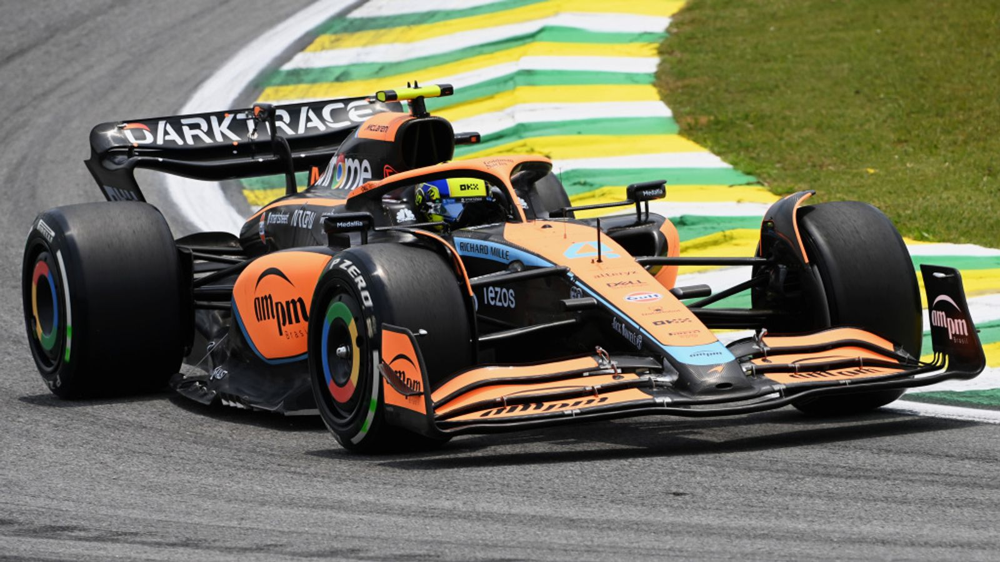








## McLaren's Mid-Season Resurgence

McLaren's 2023 Formula 1 campaign can be divided into two distinct phases, with the British Grand Prix at Silverstone marking a pivotal turning point.

### Pre-Upgrade Struggles

In the first half of the season, McLaren faced significant challenges:

- The team struggled to compete in the midfield
- Points were hard to come by, with only occasional finishes in the top 10
- Both drivers, Lando Norris and Oscar Piastri, found it difficult to extract performance from the MCL60

### The Silverstone Transformation

The introduction of major upgrades at the British Grand Prix led to a dramatic shift in McLaren's fortunes:

- **Immediate Impact**: Lando Norris secured a front-row start and finished 2nd, while Oscar Piastri finished 4th
- **Performance Leap**: The MCL60 suddenly became competitive with top teams like Ferrari and Mercedes
- **High-Speed Prowess**: Lewis Hamilton described the upgraded McLaren as a "rocketship" in fast corners

### Post-Upgrade Success

Following Silverstone, McLaren's performance saw a marked improvement:

- **Consistent Podium Threats**: Both drivers regularly competed for podium positions
- **Points Surge**: A sharp increase in points collected per race
- **Competitive Edge**: The team became a regular challenger to established front-runners

### Key Upgrade Areas

The improvements were attributed to several factors:

1. Revised floor design
2. New sidepod configuration
3. Updated front wing (introduced at Silverstone)
4. Improved aerodynamic efficiency, especially in high-speed corners

This mid-season turnaround underscores the critical importance of development in Formula 1, demonstrating how targeted upgrades can dramatically alter a team's competitiveness within a single season.

Citations:
* [1] https://www.motorsport.com/f1/news/mclaren-unleashes-full-floor-revamp-in-first-f1-2023-upgrade-push/10489299/
* [2] https://www.motorsport.com/f1/news/mclaren-miami-f1-upgrades-not-as-big-as-major-2023-packages/10604580/
* [3] https://www.motorsport.com/f1/results/2023/british-gp-625312/
* [4] https://www.formula1.com/en/racing/2023/great-britain
* [5] https://www.mclaren.com/racing/formula-1/2023/british-grand-prix/2023-british-grand-prix/
* [6] https://www.mclaren.com/racing/formula-1/2023/british-grand-prix/strategy-debrief/
* [7] https://www.motorsport.com/f1/news/the-11-changes-that-have-helped-turn-the-mclaren-into-an-f1-rocketship/10494587/
* [8] https://www.formula1.com/en/latest/article/tech-analysis-how-mclaren-have-taken-their-impressive-2023-updates-to.59n4myEjqhTai8yadbAMBs

In [63]:
results.Team.unique()

array(['Red Bull Racing Honda RBPT', 'Aston Martin Aramco Mercedes',
       'Ferrari', 'Mercedes', 'Alfa Romeo Ferrari', 'Alpine Renault',
       'Williams Mercedes', 'AlphaTauri Honda RBPT', 'Haas Ferrari',
       'McLaren Mercedes'], dtype=object)

In [64]:
mclaren_data = results[results['Team']=='McLaren Mercedes']

In [65]:
mclaren_data

,Track,Position,No,Driver,Team,Starting Grid,Laps,Time/Retired,Points,Set Fastest Lap,Fastest Lap Time,Podium
16,Bahrain,17,4,Lando Norris,McLaren Mercedes,11,55,+2 laps,0,No,1:35.822,No
19,Bahrain,0,81,Oscar Piastri,McLaren Mercedes,18,13,DNF,0,No,1:40.691,No
34,Saudi Arabia,15,81,Oscar Piastri,McLaren Mercedes,8,50,+85.021,0,No,1:34.287,No
36,Saudi Arabia,17,4,Lando Norris,McLaren Mercedes,19,50,+86.445,0,No,1:34.122,No
45,Australia,6,4,Lando Norris,McLaren Mercedes,13,58,+3.701,8,No,1:21.173,No
47,Australia,8,81,Oscar Piastri,McLaren Mercedes,16,58,+5.382,4,No,1:21.335,No
68,Azerbaijan,9,4,Lando Norris,McLaren Mercedes,7,51,+80.376,2,No,1:45.738,No
70,Azerbaijan,11,81,Oscar Piastri,McLaren Mercedes,10,51,+86.501,0,No,1:45.631,No
96,Miami,17,4,Lando Norris,McLaren Mercedes,16,57,+87.717,0,No,1:32.401,No
98,Miami,19,81,Oscar Piastri,McLaren Mercedes,19,56,+1 lap,0,No,1:32.006,No


In [66]:
mclaren_total_points = mclaren_data.groupby('Track',as_index=False,sort=False)['Points'].sum()

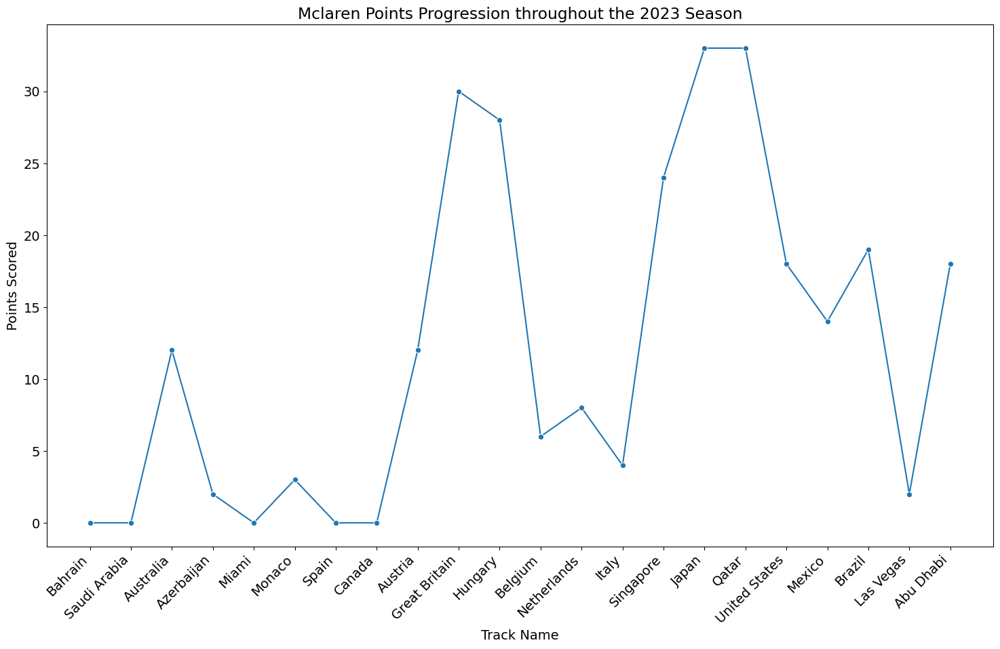

In [67]:
plt.figure(figsize=(18,10))

sns.lineplot(data = mclaren_total_points,x='Track',y='Points',marker='o')

plt.title('Mclaren Points Progression throughout the 2023 Season')
plt.xlabel('Track Name')
plt.ylabel('Points Scored')
plt.xticks(rotation=45,ha='right')
plt.show()

# Lando Norris Vs Oscar Piastri in 2023

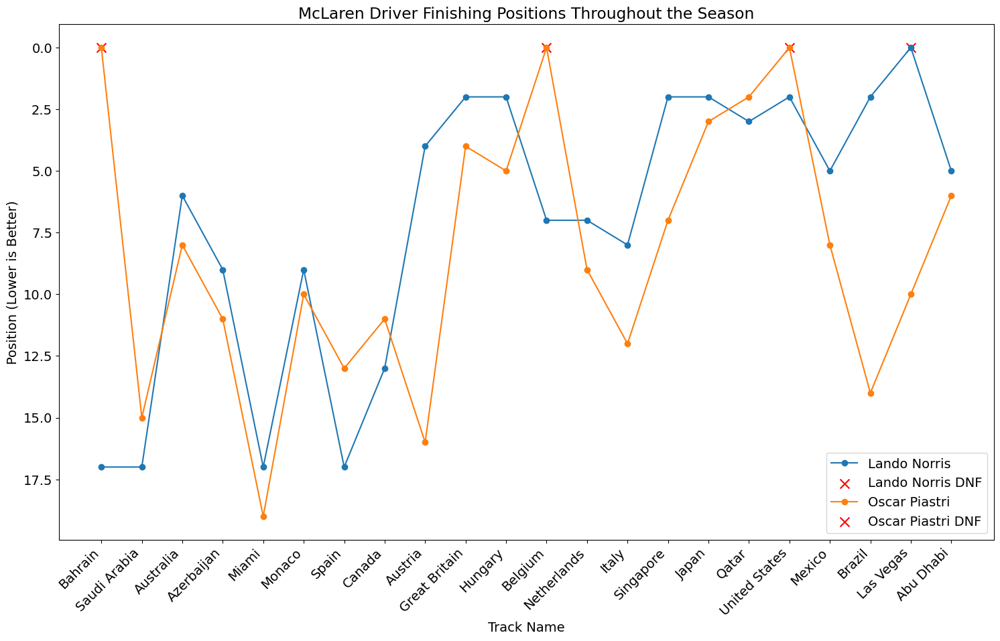

In [68]:
plt.figure(figsize=(18,10))

for driver in mclaren_data['Driver'].unique():
    driver_data = mclaren_data[mclaren_data['Driver'] == driver]
    
    plt.plot(driver_data['Track'], driver_data['Position'], marker='o', label=driver)
    
    # Highlight DNFs separately
    dnf_data = driver_data[driver_data['Position'] == 0]
    plt.scatter(dnf_data['Track'], [0] * len(dnf_data), color='red', marker='x', s=100, label=f'{driver} DNF')

plt.xticks(rotation=45, ha='right')
plt.gca().invert_yaxis()  
plt.xlabel('Track Name')
plt.ylabel('Position (Lower is Better)')
plt.title('McLaren Driver Finishing Positions Throughout the Season')

plt.legend()
plt.show()


<Figure size 1000x600 with 0 Axes>

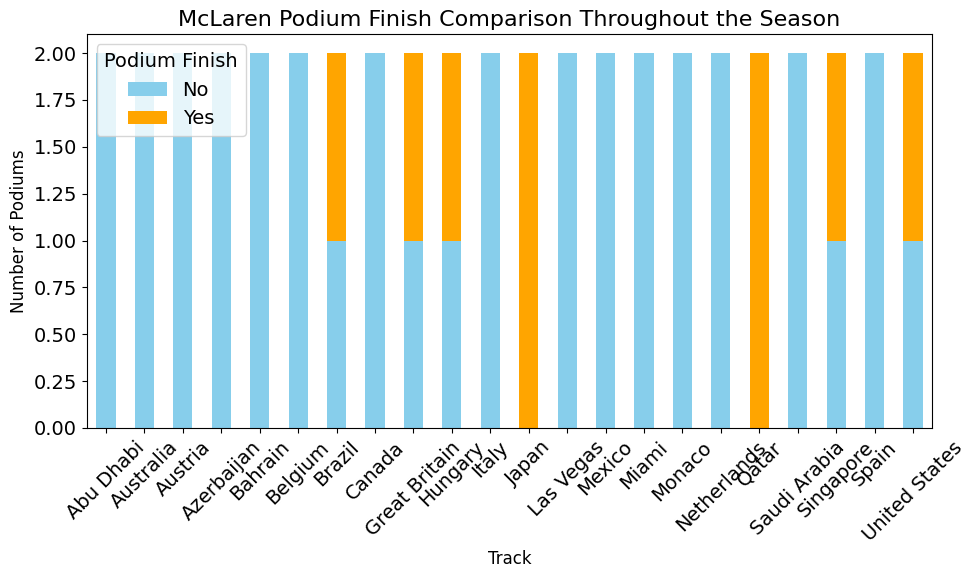

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

# Group by race and count how many times 'Yes' and 'No' appear for podium finishes
podium_count = mclaren_data.groupby(['Track', 'Podium'])['Podium'].count().unstack().fillna(0)

# Plotting the data
plt.figure(figsize=(10, 6))
podium_count.plot(kind='bar', stacked=True, color=['skyblue', 'orange'])

# Adding labels and title
plt.title('McLaren Podium Finish Comparison Throughout the Season', fontsize=16)
plt.xlabel('Track', fontsize=12)
plt.ylabel('Number of Podiums', fontsize=12)
plt.xticks(rotation=45)
plt.legend(title='Podium Finish', labels=['No', 'Yes'], loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()



# Aston Martin Team Performance

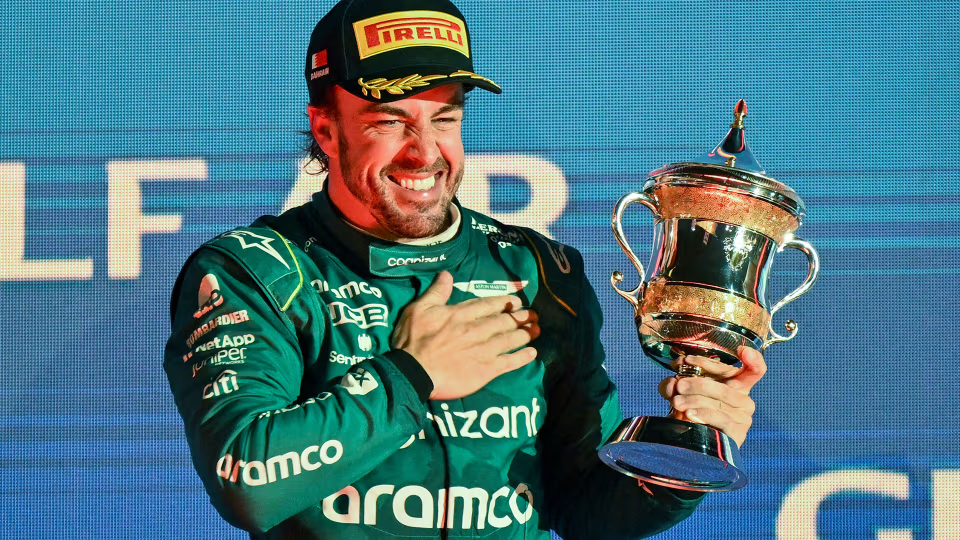



Aston Martin's 2023 Formula 1 campaign was marked by an impressive start followed by a gradual decline in performance. The team's season can be summarized by two key points:

1. **Fernando Alonso's Dominance**: Out of the 266 points scored by Aston Martin, an astounding 198 were accumulated by Fernando Alonso. This highlights the two-time world champion's exceptional contribution to the team's success.

2. **Early Promise, Later Struggles**: The season began brilliantly for Aston Martin, with the team showing remarkable pace and consistently challenging for podium positions. However, this strong form proved to be short-lived. As the season progressed, other teams caught up and even surpassed Aston Martin in terms of development and performance.

The team's trajectory in the Constructors' Championship reflected this shift. After a promising start that saw them competing near the top of the standings, Aston Martin gradually fell behind as their rivals made significant strides in car development.

Despite the challenges faced in the latter part of the season, Fernando Alonso's performances remained a bright spot for the team. His experience and skill allowed him to extract the maximum from the car, even as its relative competitiveness declined.

This season served as a reminder of both Alonso's enduring class and the relentless pace of development in Formula 1. While Aston Martin couldn't maintain their early-season form, their overall performance marked a significant step forward from previous years, providing a foundation to build upon for future seasons.

In [70]:
results.Team.unique()

array(['Red Bull Racing Honda RBPT', 'Aston Martin Aramco Mercedes',
       'Ferrari', 'Mercedes', 'Alfa Romeo Ferrari', 'Alpine Renault',
       'Williams Mercedes', 'AlphaTauri Honda RBPT', 'Haas Ferrari',
       'McLaren Mercedes'], dtype=object)

In [71]:
aston_data = results[results['Team']=='Aston Martin Aramco Mercedes']

In [72]:
aston_data 

,Track,Position,No,Driver,Team,Starting Grid,Laps,Time/Retired,Points,Set Fastest Lap,Fastest Lap Time,Podium
2,Bahrain,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,5,57,+38.637,15,No,1:36.156,Yes
5,Bahrain,6,18,Lance Stroll,Aston Martin Aramco Mercedes,8,57,+54.502,8,No,1:36.546,No
22,Saudi Arabia,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,2,50,+20.728,15,No,1:32.240,Yes
39,Saudi Arabia,0,18,Lance Stroll,Aston Martin Aramco Mercedes,5,16,DNF,0,No,1:35.140,No
42,Australia,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,4,58,+0.769,15,No,1:20.476,Yes
43,Australia,4,18,Lance Stroll,Aston Martin Aramco Mercedes,6,58,+3.082,12,No,1:20.934,No
63,Azerbaijan,4,14,Fernando Alonso,Aston Martin Aramco Mercedes,6,51,+22.024,12,No,1:44.241,No
66,Azerbaijan,7,18,Lance Stroll,Aston Martin Aramco Mercedes,9,51,+51.617,6,No,1:45.627,No
82,Miami,3,14,Fernando Alonso,Aston Martin Aramco Mercedes,2,57,+26.305,15,No,1:30.519,Yes
91,Miami,12,18,Lance Stroll,Aston Martin Aramco Mercedes,18,57,+64.754,0,No,1:30.862,No


In [73]:
aston_total_points

,Track,Points
0,Bahrain,23
1,Saudi Arabia,15
2,Australia,27
3,Azerbaijan,18
4,Miami,15
5,Monaco,18
6,Spain,14
7,Canada,20
8,Austria,12
9,Great Britain,6


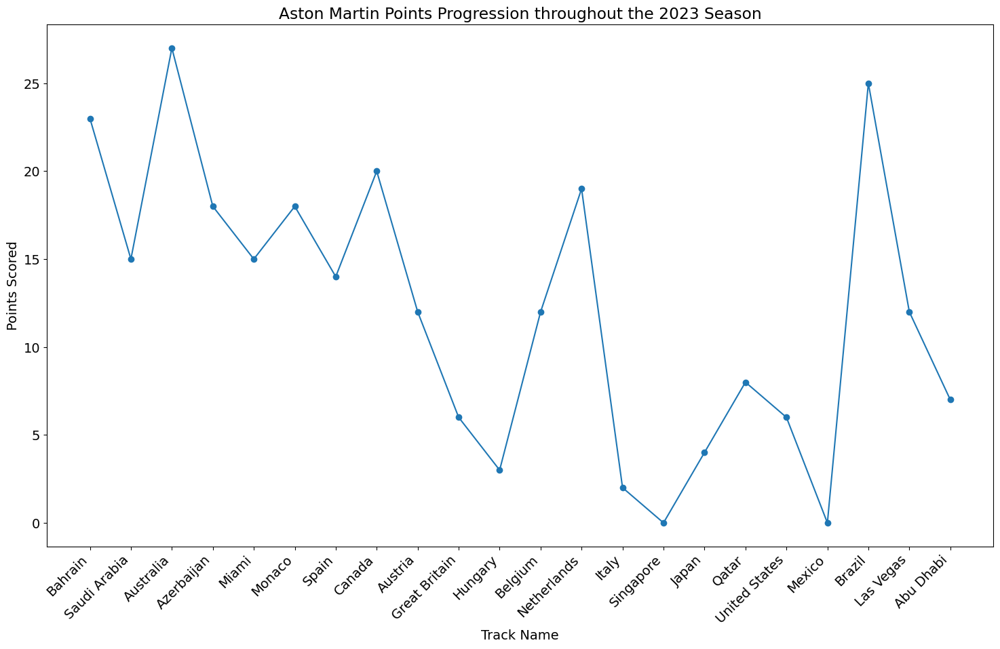

In [74]:
plt.figure(figsize=(18,10))

plt.plot(aston_total_points['Track'],
         aston_total_points['Points'],marker = 'o')

plt.title('Aston Martin Points Progression throughout the 2023 Season')
plt.xlabel('Track Name')
plt.ylabel('Points Scored')
plt.xticks(rotation=45,ha='right')
plt.show()

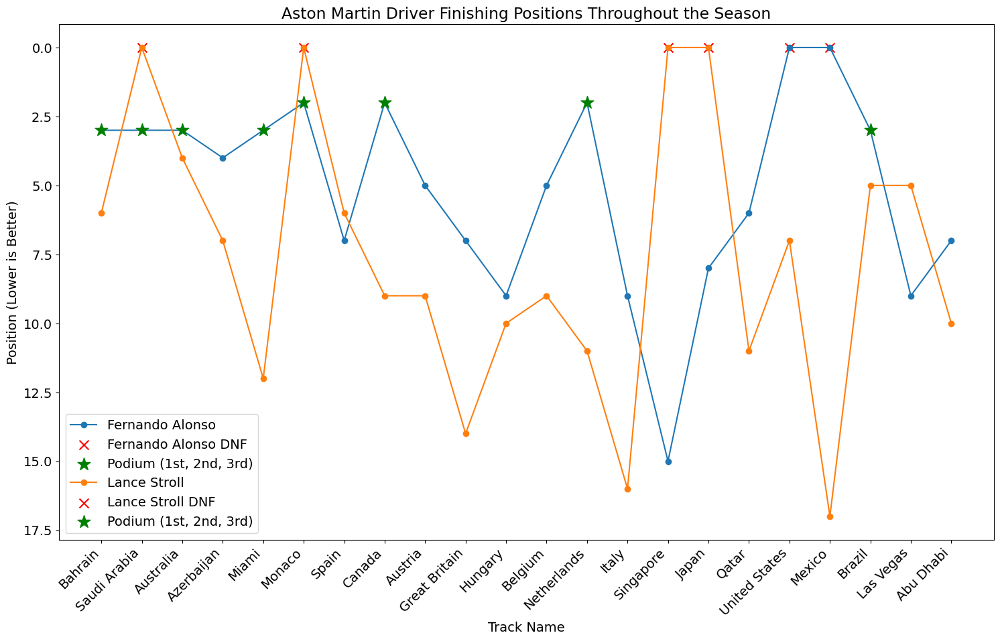

In [75]:
plt.figure(figsize=(18,10))

for driver in aston_data['Driver'].unique():
    driver_data = aston_data[aston_data['Driver'] == driver]
    
    plt.plot(driver_data['Track'], driver_data['Position'], marker='o', label=driver)
    
    # Highlight DNFs separately
    dnf_data = driver_data[driver_data['Position'] == 0]
    plt.scatter(dnf_data['Track'], [0] * len(dnf_data), color='red', marker='x', s=100, label=f'{driver} DNF')
    
    podium_data = driver_data[driver_data['Position'].isin([1, 2, 3])]
    plt.scatter(podium_data['Track'], podium_data['Position'], color='green', label='Podium (1st, 2nd, 3rd)', zorder=6, marker='*', s=200)
    

plt.xticks(rotation=45, ha='right')
plt.gca().invert_yaxis()  
plt.xlabel('Track Name')
plt.ylabel('Position (Lower is Better)')
plt.title('Aston Martin Driver Finishing Positions Throughout the Season')

plt.legend()
plt.show()


In [76]:
alonso_data = aston_data[aston_data['Driver']=='Fernando Alonso']

In [77]:
stroll_data = aston_data[aston_data['Driver']=='Lance Stroll']

In [78]:
alonso_data['Points'].sum()

198

In [79]:
stroll_data['Points'].sum()

68

# Team Performance across Circuits

In [80]:
team_names = results.Team.unique()

In [81]:
team_names

array(['Red Bull Racing Honda RBPT', 'Aston Martin Aramco Mercedes',
       'Ferrari', 'Mercedes', 'Alfa Romeo Ferrari', 'Alpine Renault',
       'Williams Mercedes', 'AlphaTauri Honda RBPT', 'Haas Ferrari',
       'McLaren Mercedes'], dtype=object)

In [82]:
for team in team_names:
    team_data = results[results['Team']==team]
    
    team_performance = team_data.groupby(['Team','Track'])['Position'].mean().reset_index()
    
    print(f'Team Performance for {team} is as follows:')
    display(team_performance)

Team Performance for Red Bull Racing Honda RBPT is as follows:


,Team,Track,Position
0,Red Bull Racing Honda RBPT,Abu Dhabi,2.5
1,Red Bull Racing Honda RBPT,Australia,3.0
2,Red Bull Racing Honda RBPT,Austria,2.0
3,Red Bull Racing Honda RBPT,Azerbaijan,1.5
4,Red Bull Racing Honda RBPT,Bahrain,1.5
5,Red Bull Racing Honda RBPT,Belgium,1.5
6,Red Bull Racing Honda RBPT,Brazil,2.5
7,Red Bull Racing Honda RBPT,Canada,3.5
8,Red Bull Racing Honda RBPT,Great Britain,3.5
9,Red Bull Racing Honda RBPT,Hungary,2.0


Team Performance for Aston Martin Aramco Mercedes is as follows:


,Team,Track,Position
0,Aston Martin Aramco Mercedes,Abu Dhabi,8.5
1,Aston Martin Aramco Mercedes,Australia,3.5
2,Aston Martin Aramco Mercedes,Austria,7.0
3,Aston Martin Aramco Mercedes,Azerbaijan,5.5
4,Aston Martin Aramco Mercedes,Bahrain,4.5
5,Aston Martin Aramco Mercedes,Belgium,7.0
6,Aston Martin Aramco Mercedes,Brazil,4.0
7,Aston Martin Aramco Mercedes,Canada,5.5
8,Aston Martin Aramco Mercedes,Great Britain,10.5
9,Aston Martin Aramco Mercedes,Hungary,9.5


Team Performance for Ferrari is as follows:


,Team,Track,Position
0,Ferrari,Abu Dhabi,10.0
1,Ferrari,Australia,6.0
2,Ferrari,Austria,4.0
3,Ferrari,Azerbaijan,4.0
4,Ferrari,Bahrain,2.0
5,Ferrari,Belgium,1.5
6,Ferrari,Brazil,3.0
7,Ferrari,Canada,4.5
8,Ferrari,Great Britain,9.5
9,Ferrari,Hungary,7.5


Team Performance for Mercedes is as follows:


,Team,Track,Position
0,Mercedes,Abu Dhabi,6.0
1,Mercedes,Australia,1.0
2,Mercedes,Austria,7.5
3,Mercedes,Azerbaijan,7.0
4,Mercedes,Bahrain,6.0
5,Mercedes,Belgium,5.0
6,Mercedes,Brazil,4.0
7,Mercedes,Canada,1.5
8,Mercedes,Great Britain,4.0
9,Mercedes,Hungary,5.0


Team Performance for Alfa Romeo Ferrari is as follows:


,Team,Track,Position
0,Alfa Romeo Ferrari,Abu Dhabi,18.0
1,Alfa Romeo Ferrari,Australia,10.0
2,Alfa Romeo Ferrari,Austria,13.5
3,Alfa Romeo Ferrari,Azerbaijan,9.0
4,Alfa Romeo Ferrari,Bahrain,12.0
5,Alfa Romeo Ferrari,Belgium,12.5
6,Alfa Romeo Ferrari,Brazil,0.0
7,Alfa Romeo Ferrari,Canada,13.0
8,Alfa Romeo Ferrari,Great Britain,13.5
9,Alfa Romeo Ferrari,Hungary,14.0


Team Performance for Alpine Renault is as follows:


,Team,Track,Position
0,Alpine Renault,Abu Dhabi,12.5
1,Alpine Renault,Australia,13.5
2,Alpine Renault,Austria,12.0
3,Alpine Renault,Azerbaijan,14.5
4,Alpine Renault,Bahrain,4.5
5,Alpine Renault,Belgium,9.5
6,Alpine Renault,Brazil,8.5
7,Alpine Renault,Canada,10.0
8,Alpine Renault,Great Britain,9.0
9,Alpine Renault,Hungary,0.0


Team Performance for Williams Mercedes is as follows:


,Team,Track,Position
0,Williams Mercedes,Abu Dhabi,15.0
1,Williams Mercedes,Australia,8.0
2,Williams Mercedes,Austria,12.0
3,Williams Mercedes,Azerbaijan,14.0
4,Williams Mercedes,Bahrain,11.0
5,Williams Mercedes,Belgium,15.5
6,Williams Mercedes,Brazil,5.5
7,Williams Mercedes,Canada,3.5
8,Williams Mercedes,Great Britain,9.5
9,Williams Mercedes,Hungary,14.5


Team Performance for AlphaTauri Honda RBPT is as follows:


,Team,Track,Position
0,AlphaTauri Honda RBPT,Abu Dhabi,9.5
1,AlphaTauri Honda RBPT,Australia,12.5
2,AlphaTauri Honda RBPT,Austria,18.0
3,AlphaTauri Honda RBPT,Azerbaijan,5.0
4,AlphaTauri Honda RBPT,Bahrain,12.5
5,AlphaTauri Honda RBPT,Belgium,13.0
6,AlphaTauri Honda RBPT,Brazil,11.0
7,AlphaTauri Honda RBPT,Canada,16.0
8,AlphaTauri Honda RBPT,Great Britain,16.5
9,AlphaTauri Honda RBPT,Hungary,14.0


Team Performance for Haas Ferrari is as follows:


,Team,Track,Position
0,Haas Ferrari,Abu Dhabi,17.5
1,Haas Ferrari,Australia,12.0
2,Haas Ferrari,Austria,9.0
3,Haas Ferrari,Azerbaijan,15.0
4,Haas Ferrari,Bahrain,14.0
5,Haas Ferrari,Belgium,16.5
6,Haas Ferrari,Brazil,6.0
7,Haas Ferrari,Canada,16.0
8,Haas Ferrari,Great Britain,6.5
9,Haas Ferrari,Hungary,15.5


Team Performance for McLaren Mercedes is as follows:


,Team,Track,Position
0,McLaren Mercedes,Abu Dhabi,5.5
1,McLaren Mercedes,Australia,7.0
2,McLaren Mercedes,Austria,10.0
3,McLaren Mercedes,Azerbaijan,10.0
4,McLaren Mercedes,Bahrain,8.5
5,McLaren Mercedes,Belgium,3.5
6,McLaren Mercedes,Brazil,8.0
7,McLaren Mercedes,Canada,12.0
8,McLaren Mercedes,Great Britain,3.0
9,McLaren Mercedes,Hungary,3.5


Visualising this data

Team Performance for Red Bull Racing Honda RBPT is as follows:


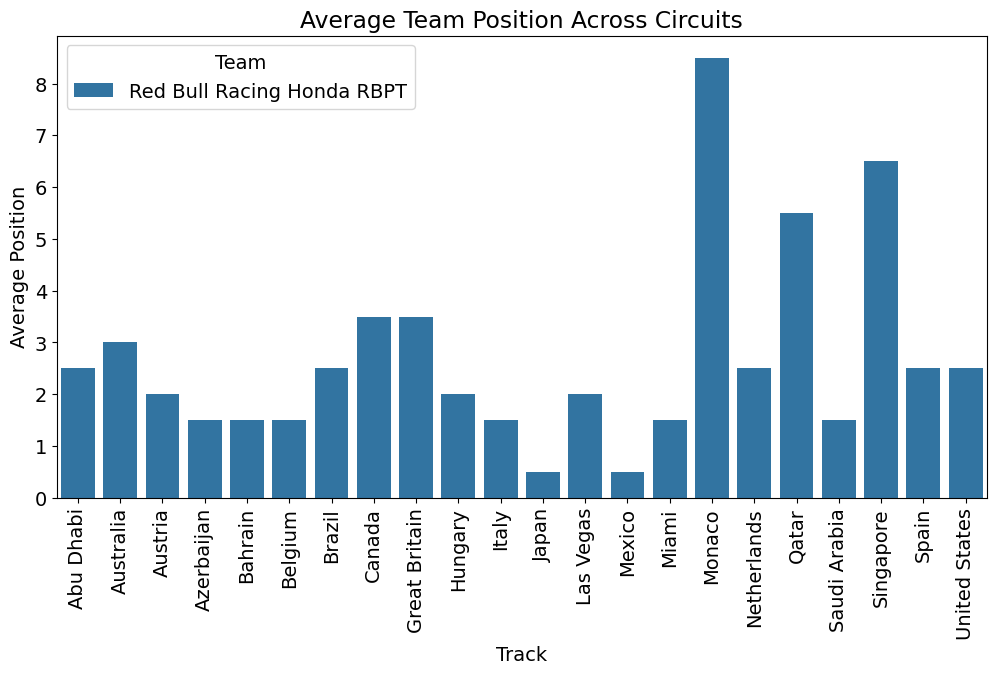

Team Performance for Aston Martin Aramco Mercedes is as follows:


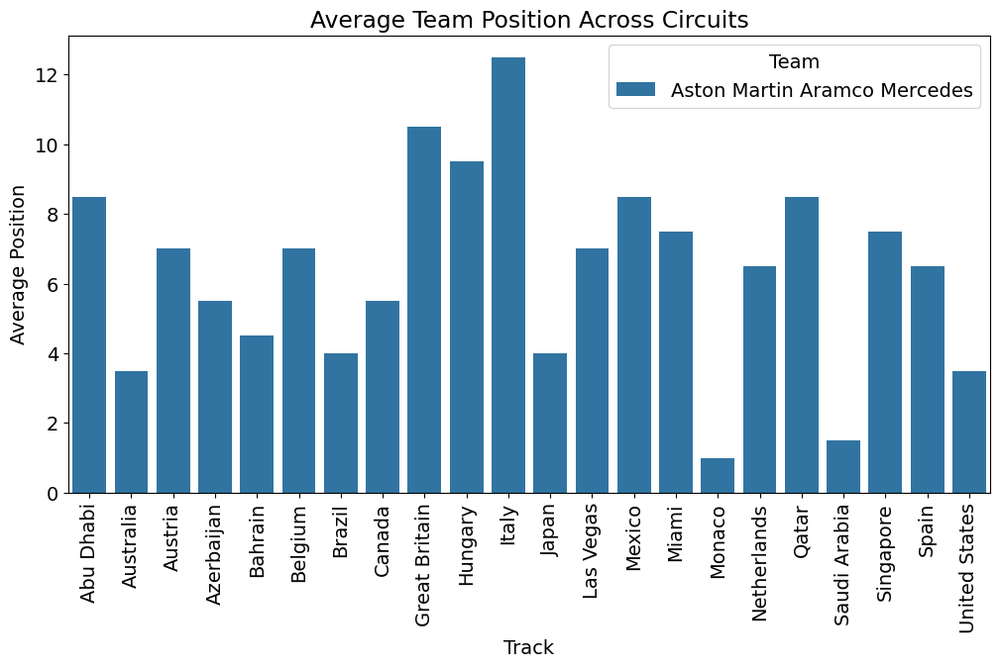

Team Performance for Ferrari is as follows:


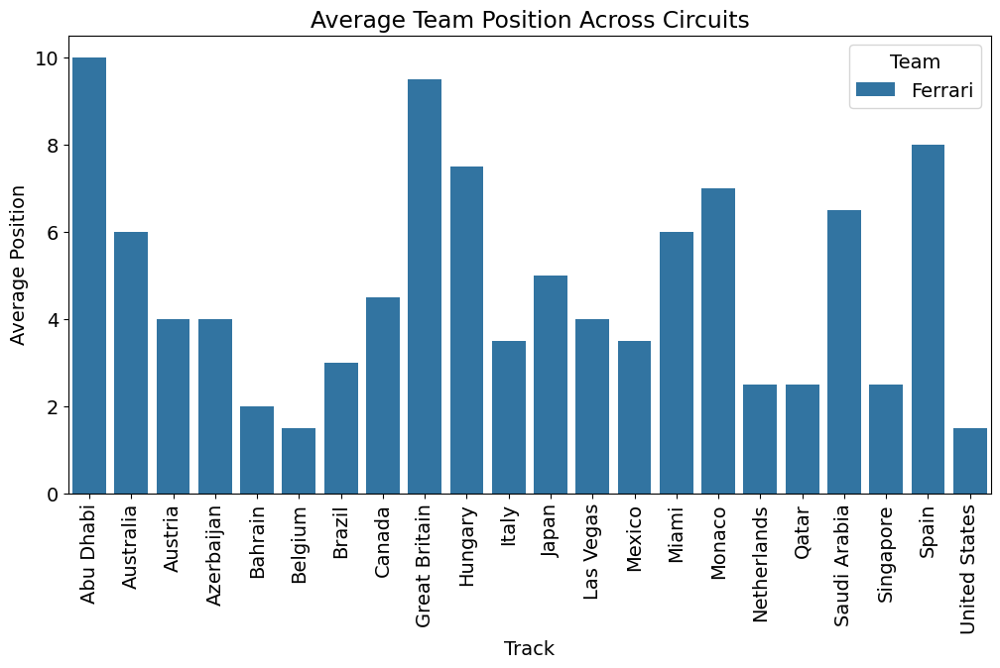

Team Performance for Mercedes is as follows:


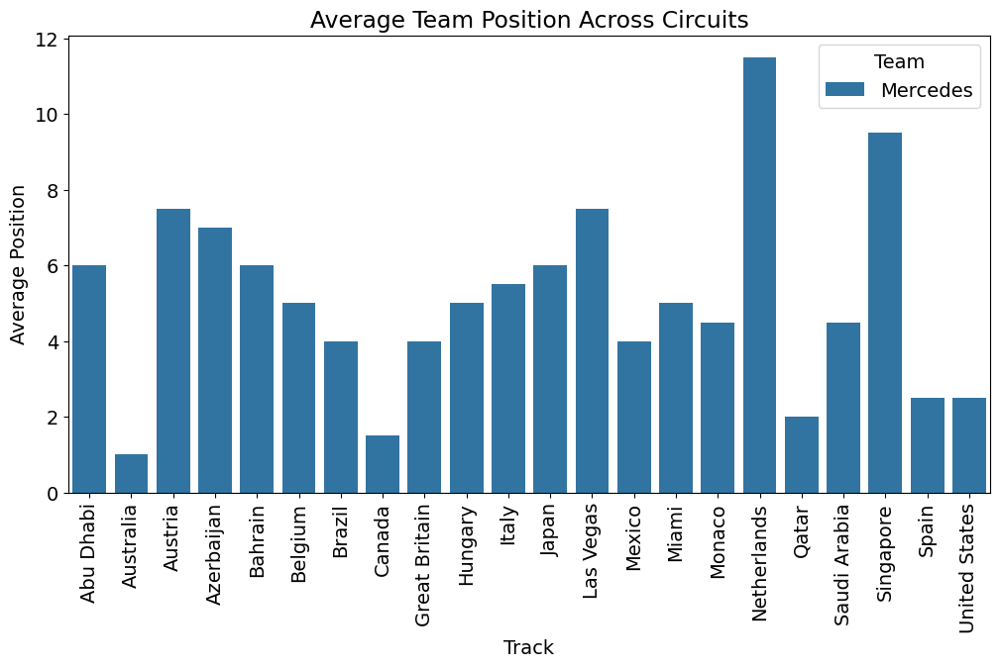

Team Performance for Alfa Romeo Ferrari is as follows:


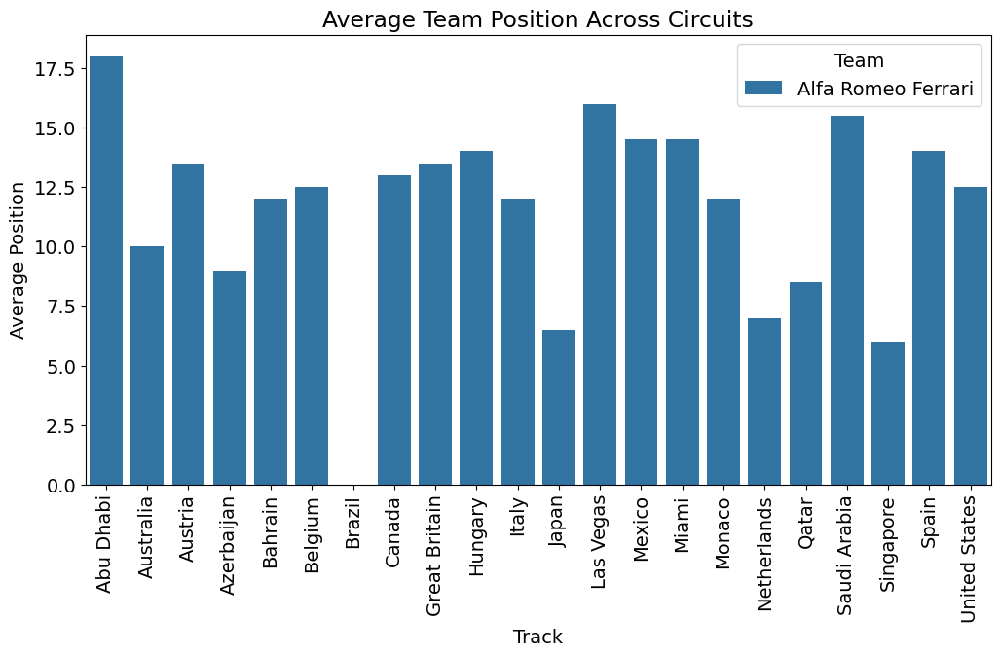

Team Performance for Alpine Renault is as follows:


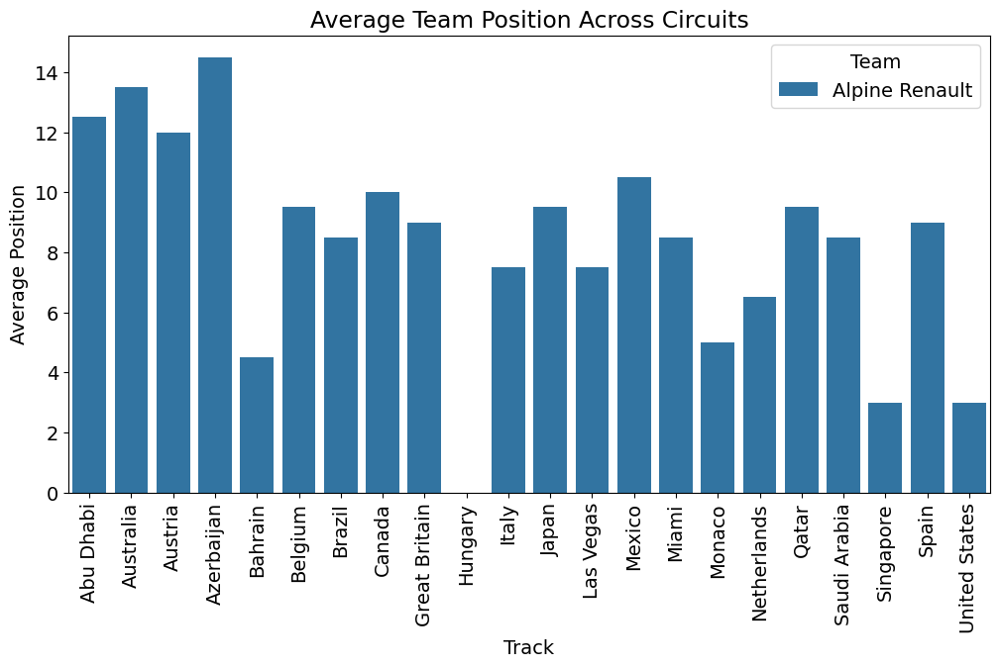

Team Performance for Williams Mercedes is as follows:


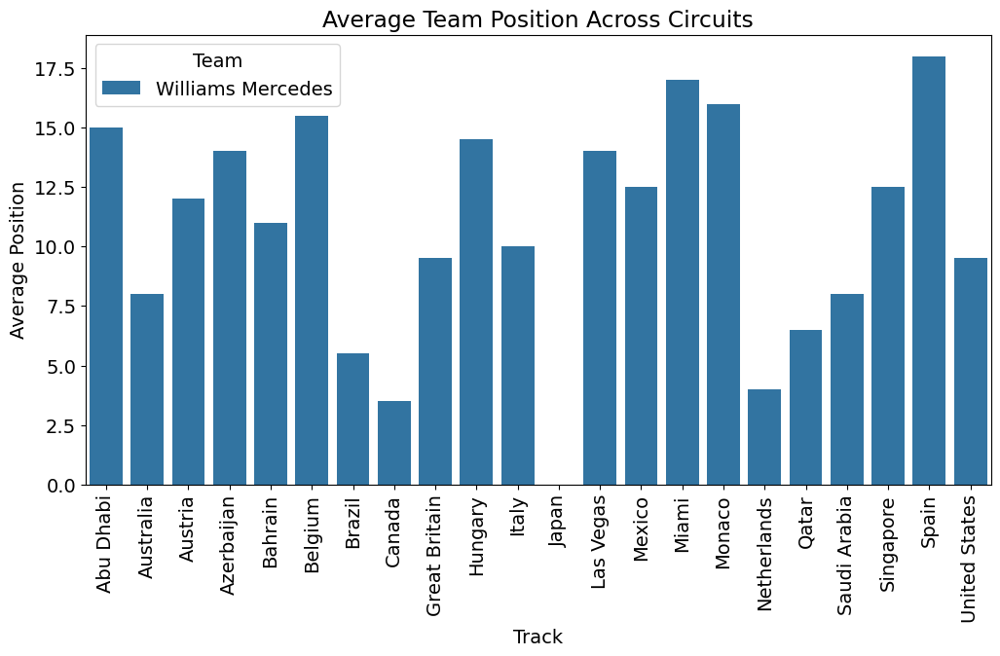

Team Performance for AlphaTauri Honda RBPT is as follows:


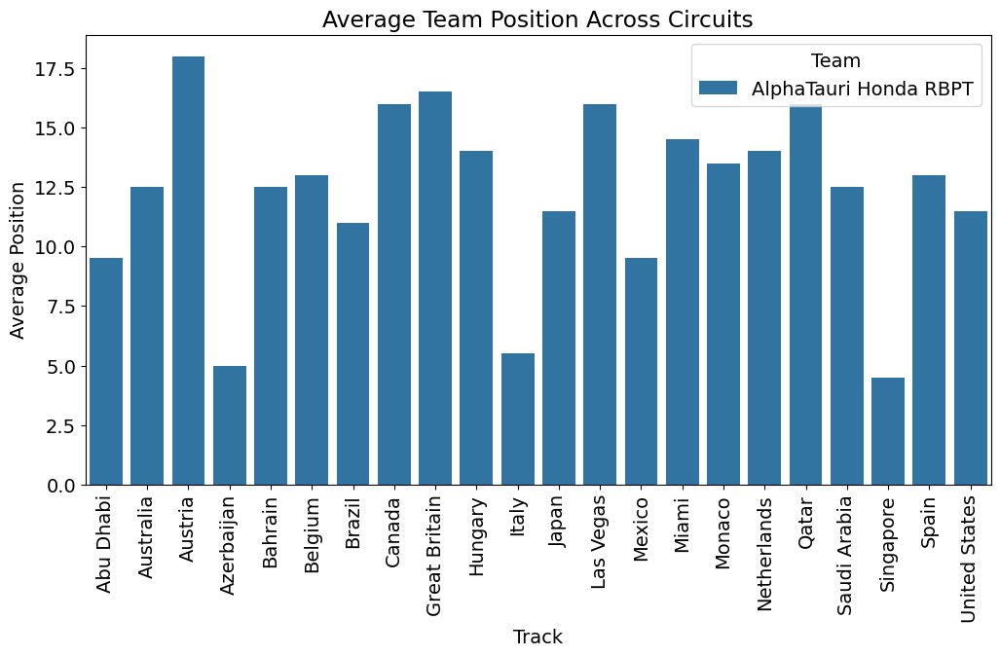

Team Performance for Haas Ferrari is as follows:


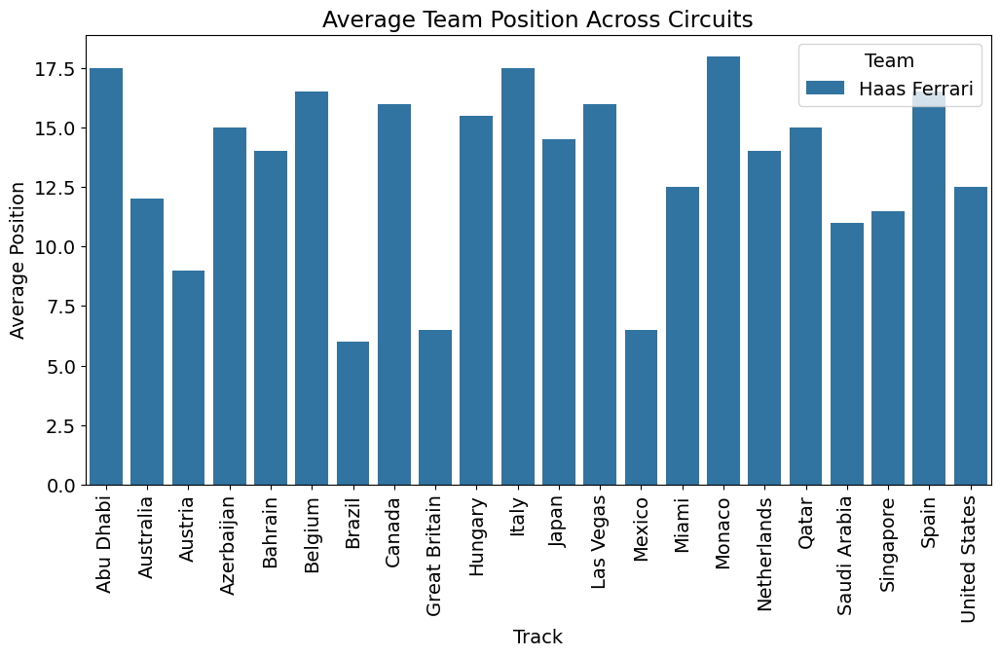

Team Performance for McLaren Mercedes is as follows:


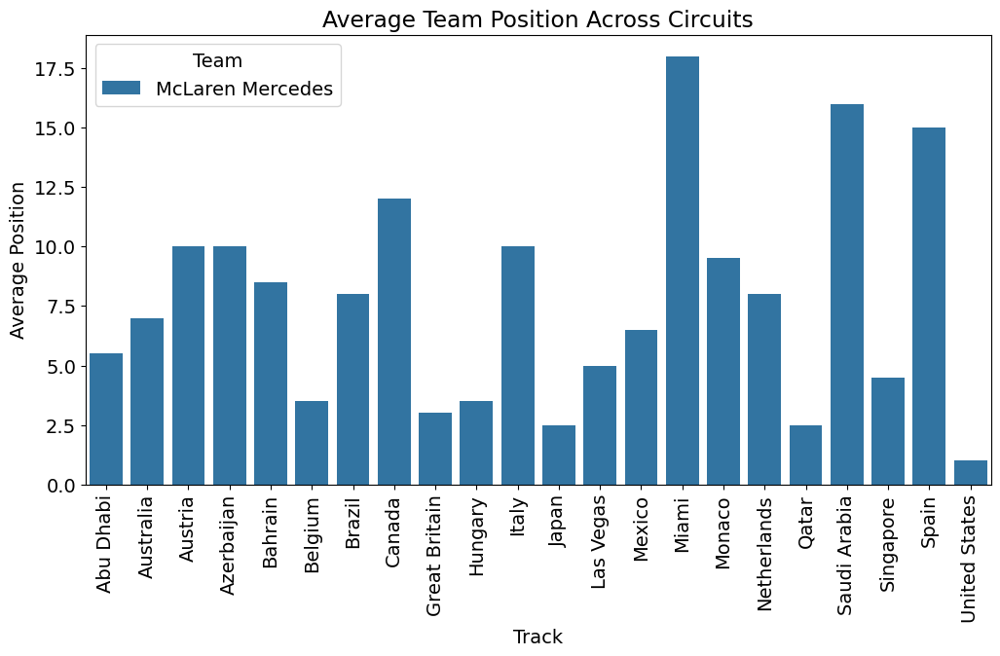

In [83]:
for team in team_names:
    team_data = results[results['Team']==team]
    
    team_performance = team_data.groupby(['Team','Track'])['Position'].mean().reset_index()
    
    print(f'Team Performance for {team} is as follows:')
    
    plt.figure(figsize=(12, 6))
    sns.barplot(x='Track', y='Position', hue='Team', data=team_performance)
    plt.title('Average Team Position Across Circuits')
    plt.xticks(rotation=90)
    plt.ylabel('Average Position')
#     plt.gca().invert_yaxis()
    plt.show()

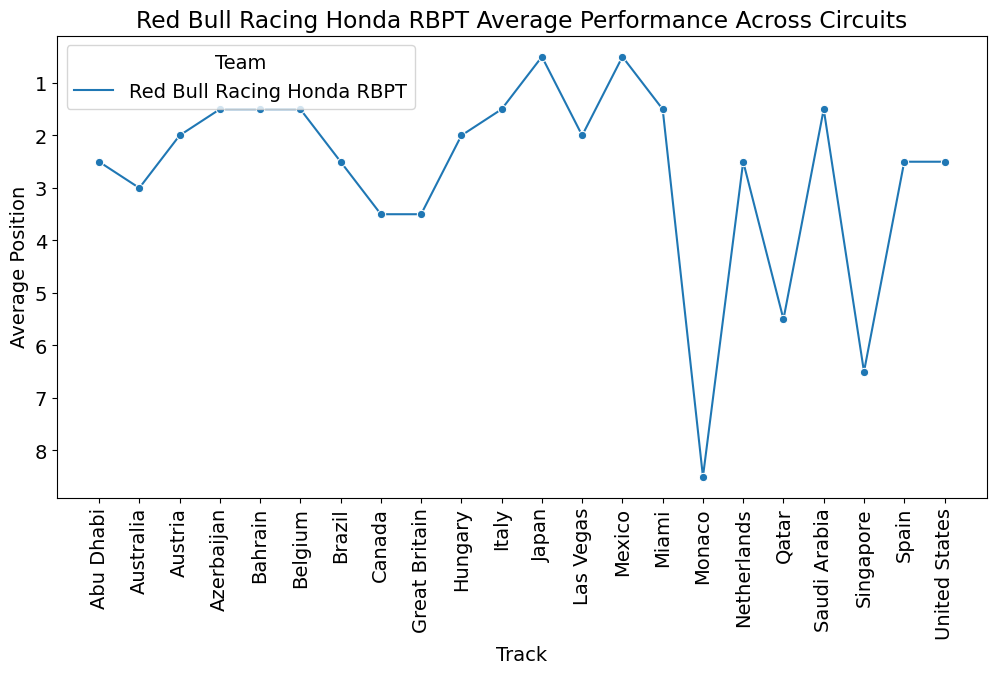

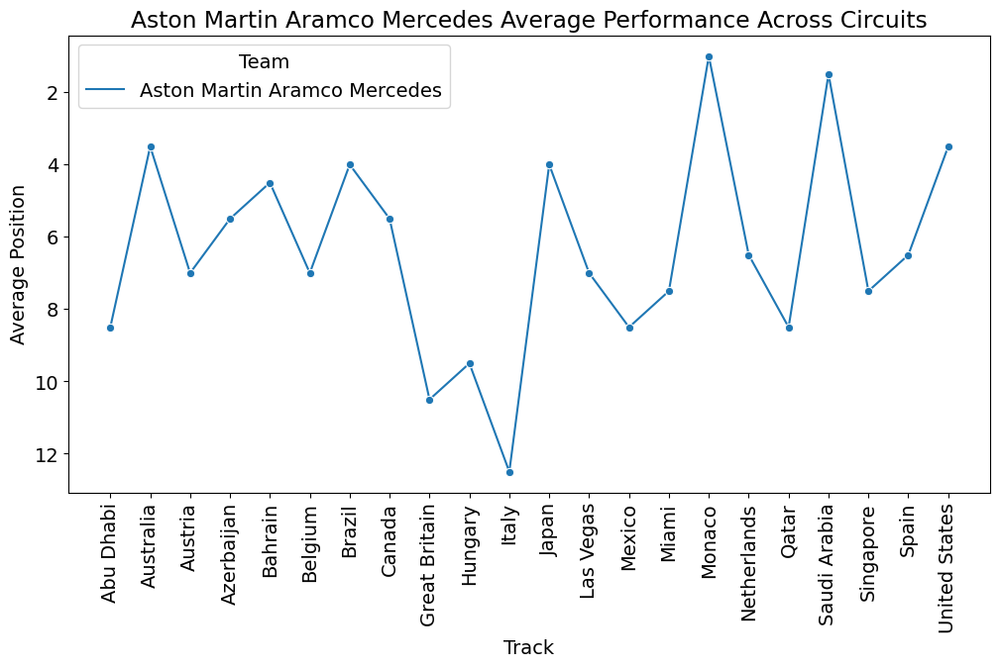

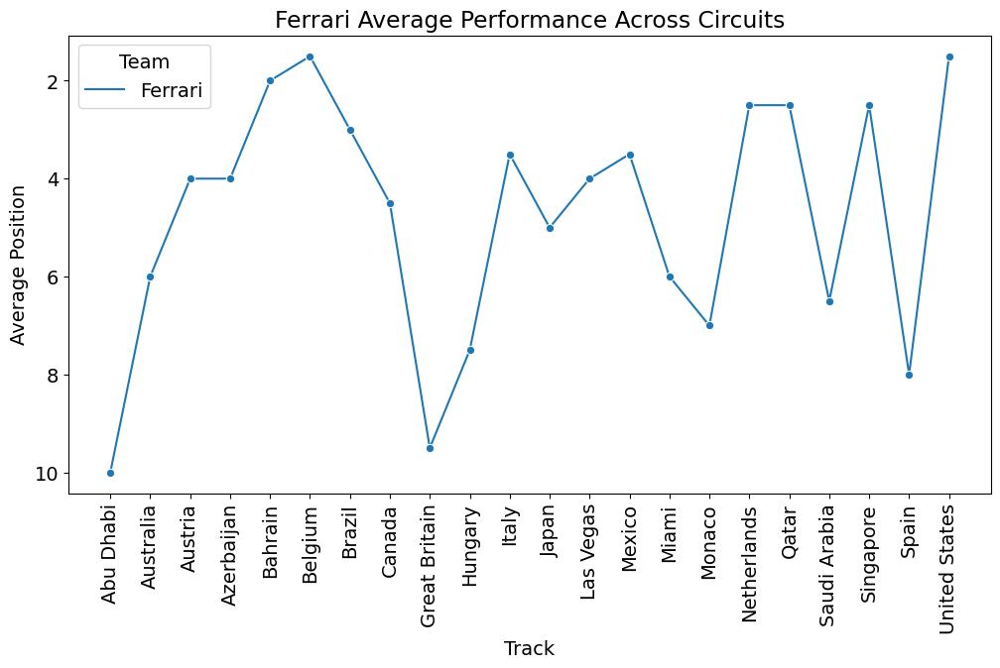

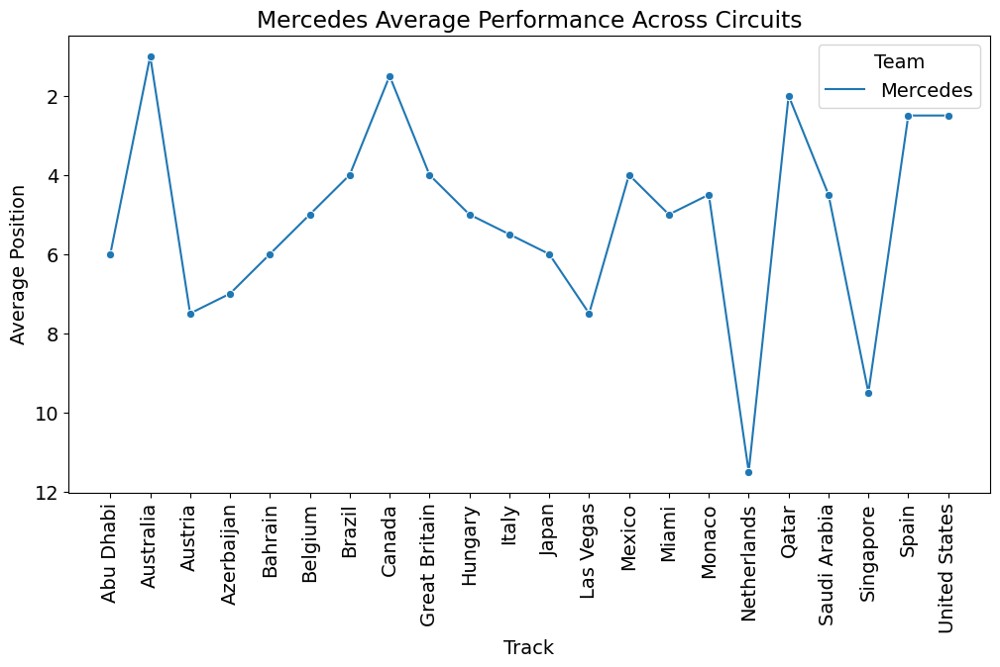

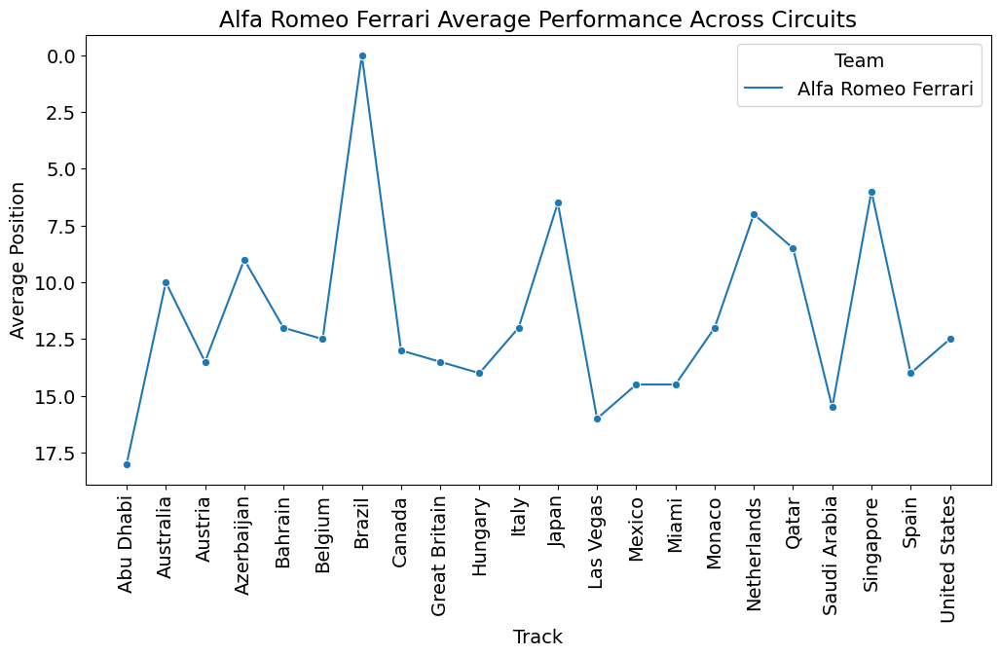

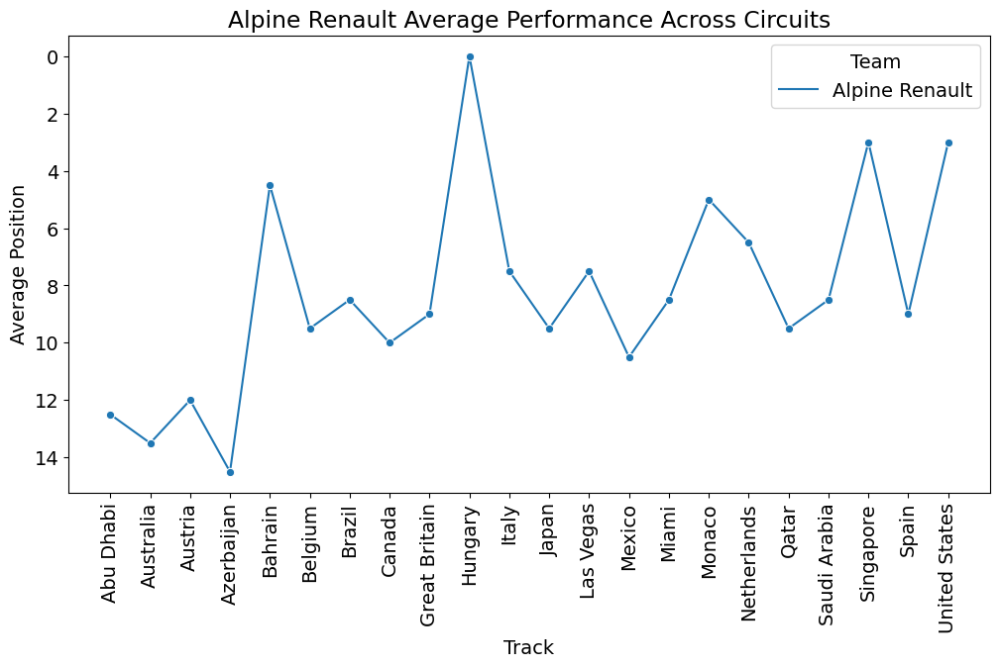

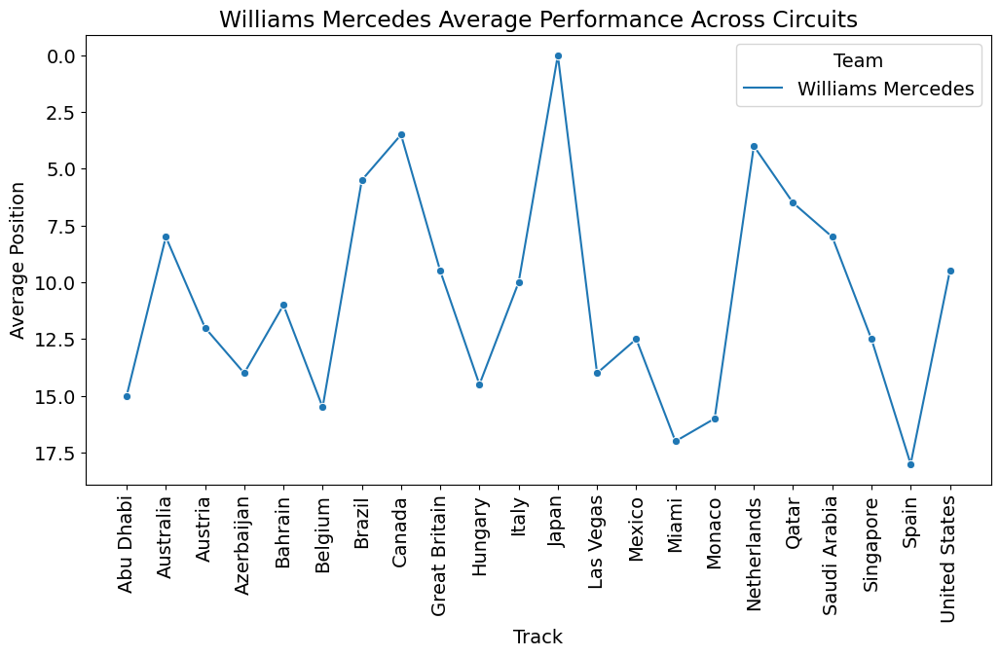

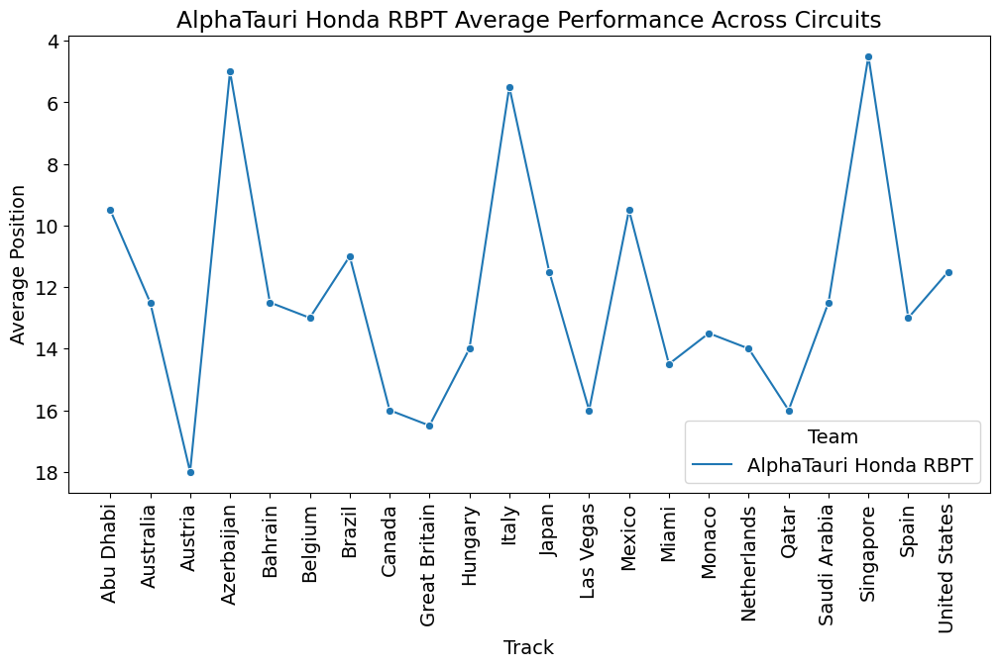

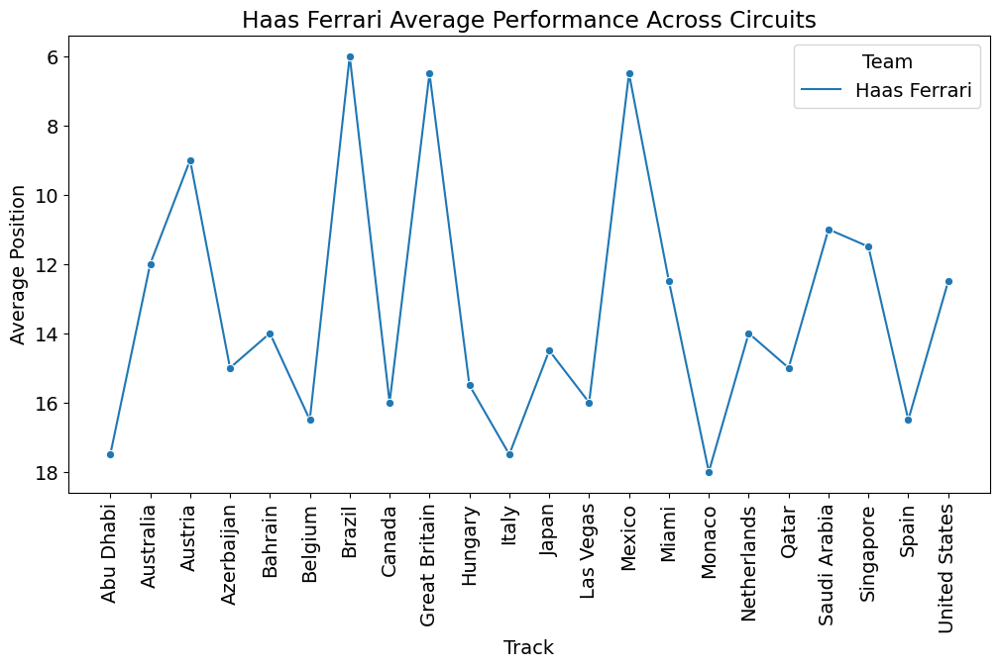

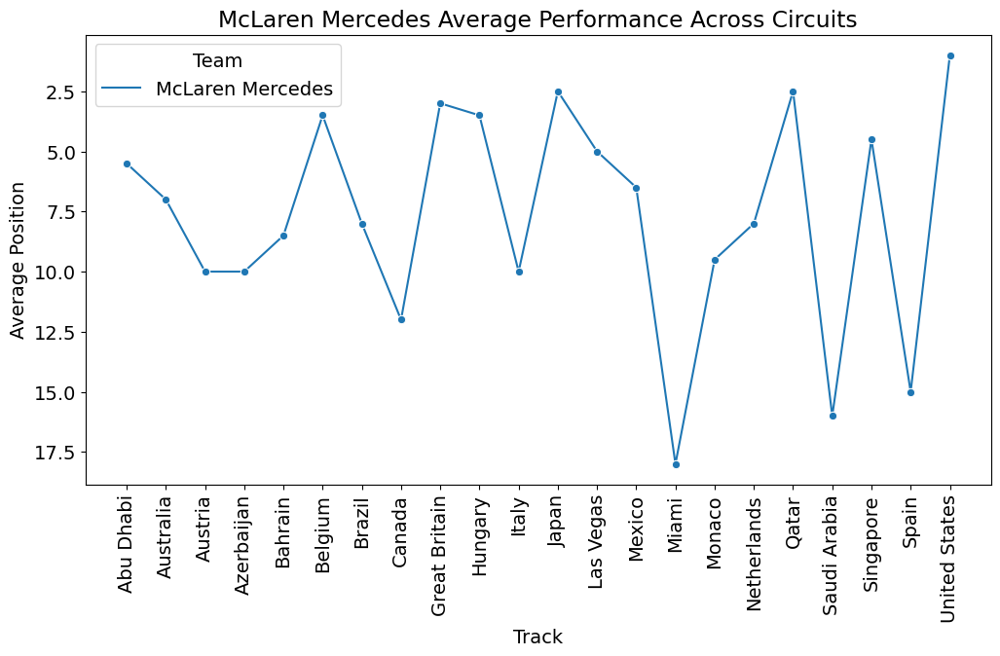

In [84]:
for team in team_names:
    team_data = results[results['Team']==team]
    
    team_performance = team_data.groupby(['Team','Track'])['Position'].mean().reset_index()
    
    plt.figure(figsize=(12, 6))
    sns.lineplot(x='Track', y='Position', hue='Team', data=team_performance, marker='o')
    plt.title(f'{team} Average Performance Across Circuits')
    plt.xticks(rotation=90)
    plt.ylabel('Average Position')
    plt.gca().invert_yaxis()
    plt.show()

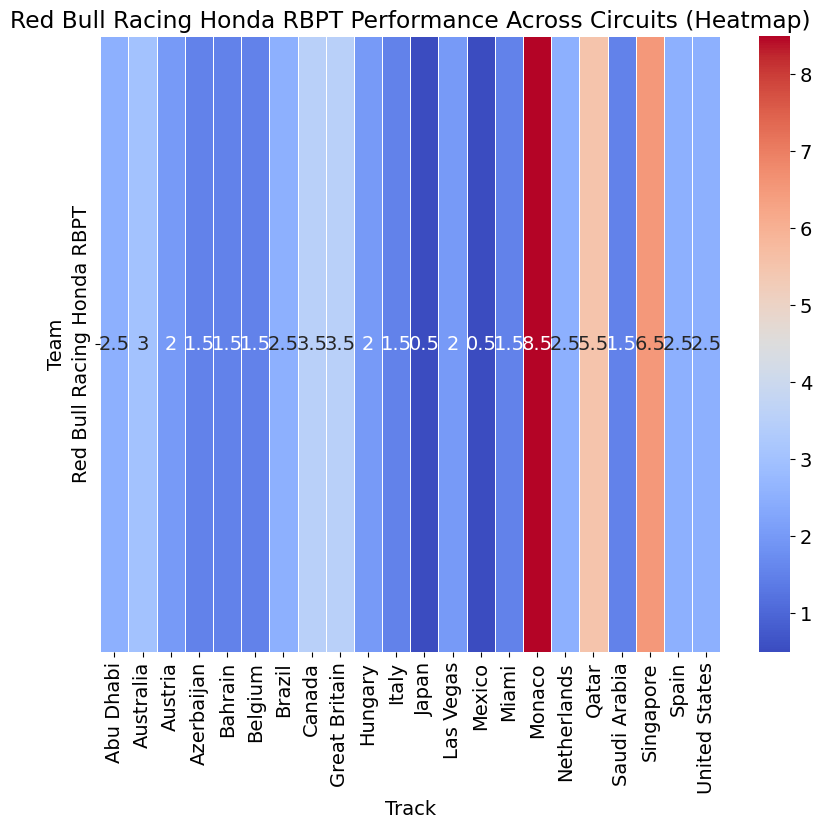

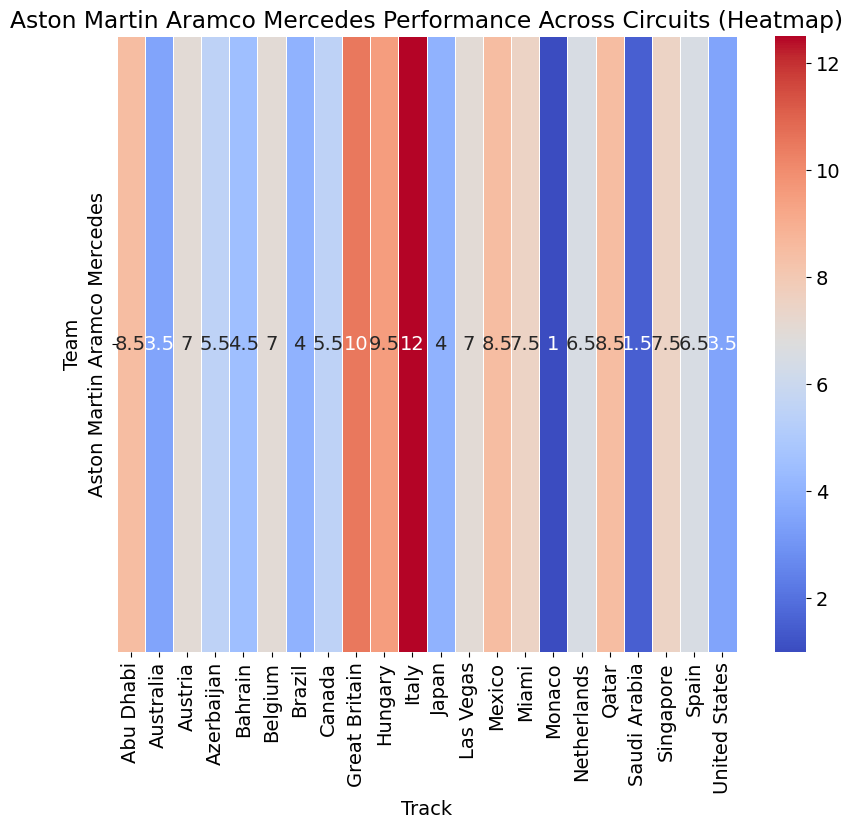

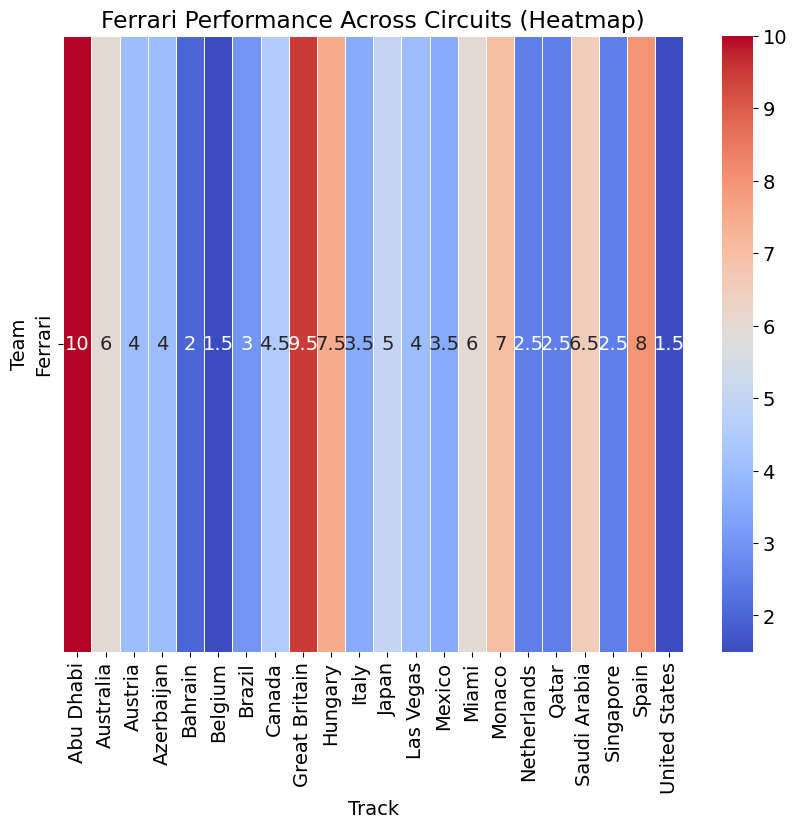

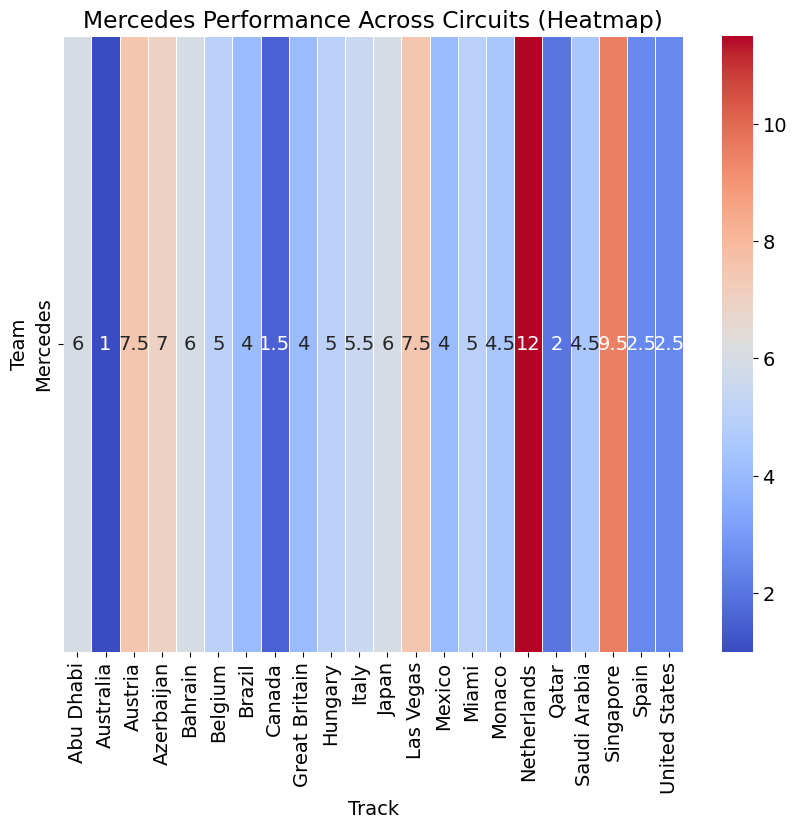

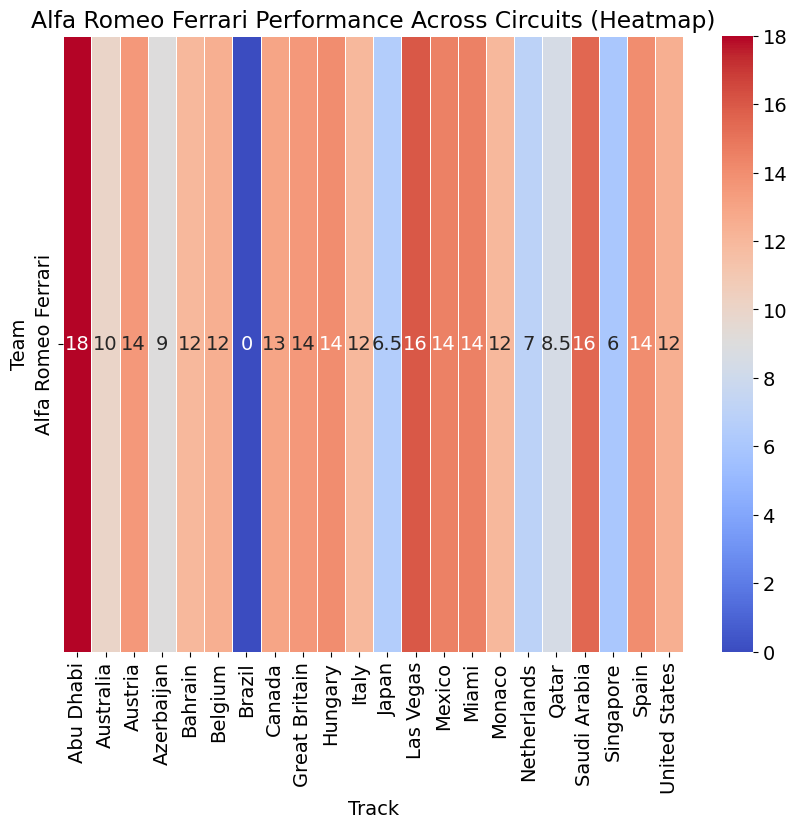

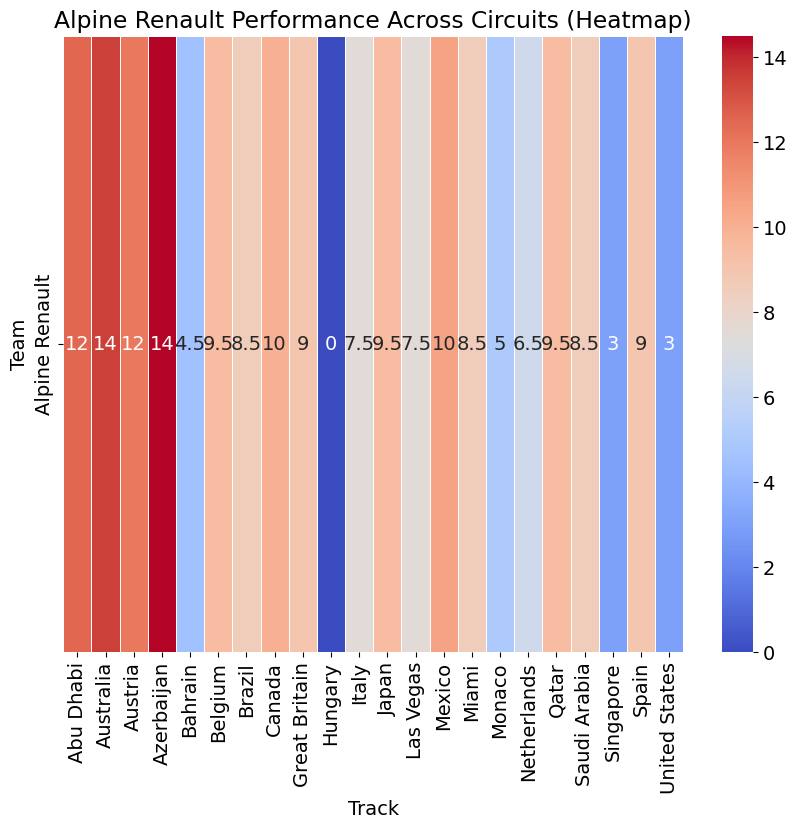

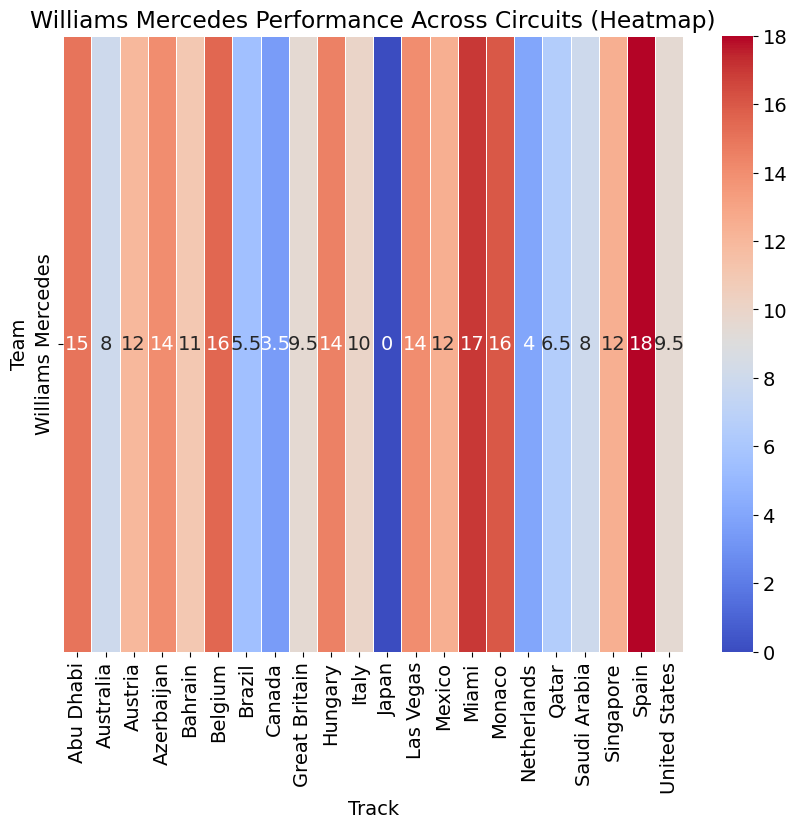

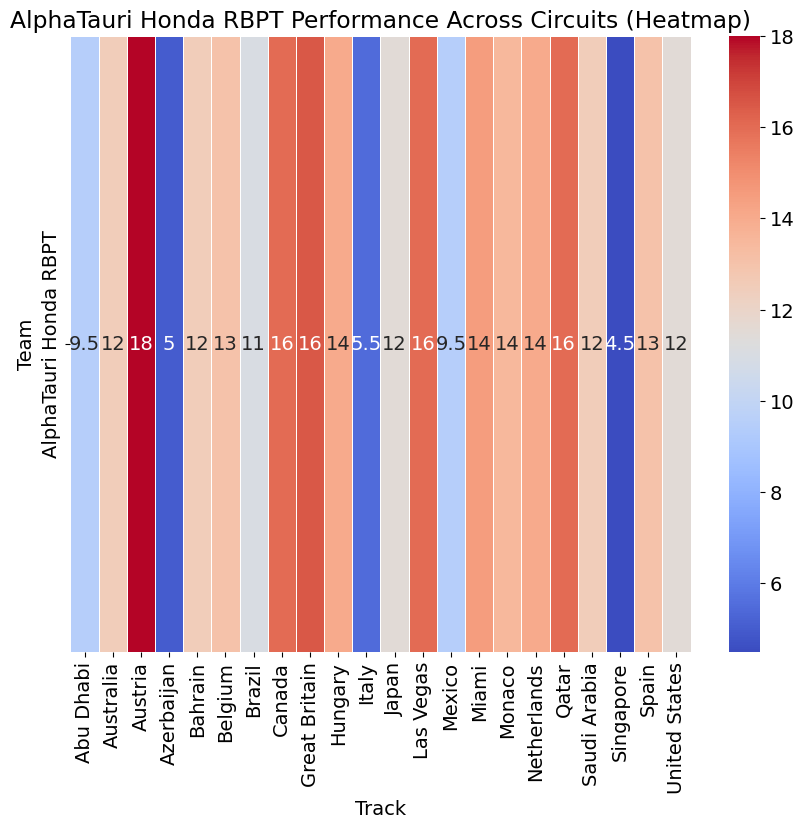

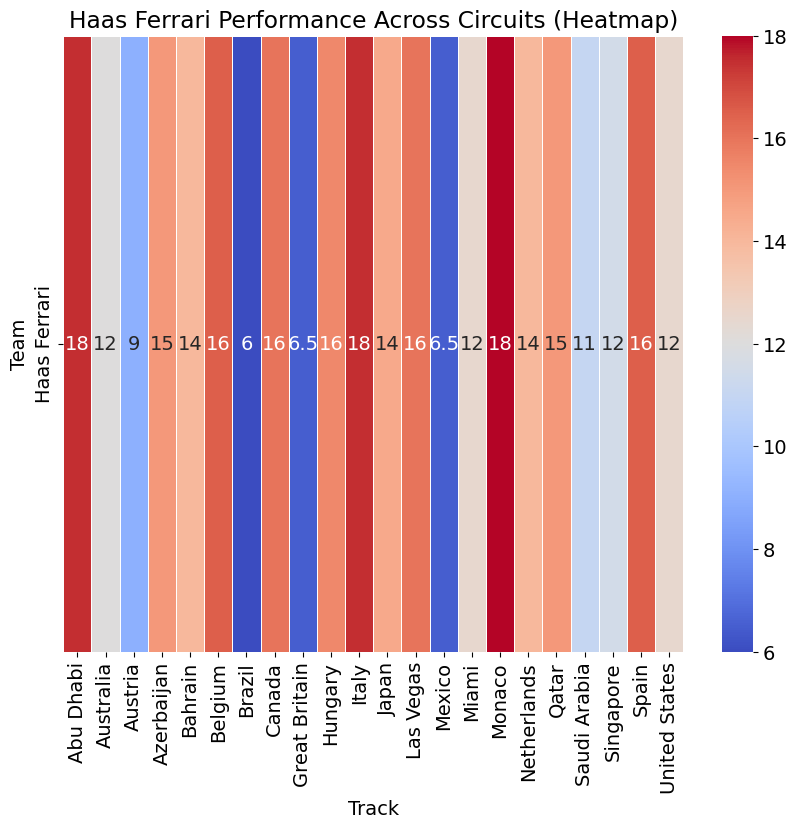

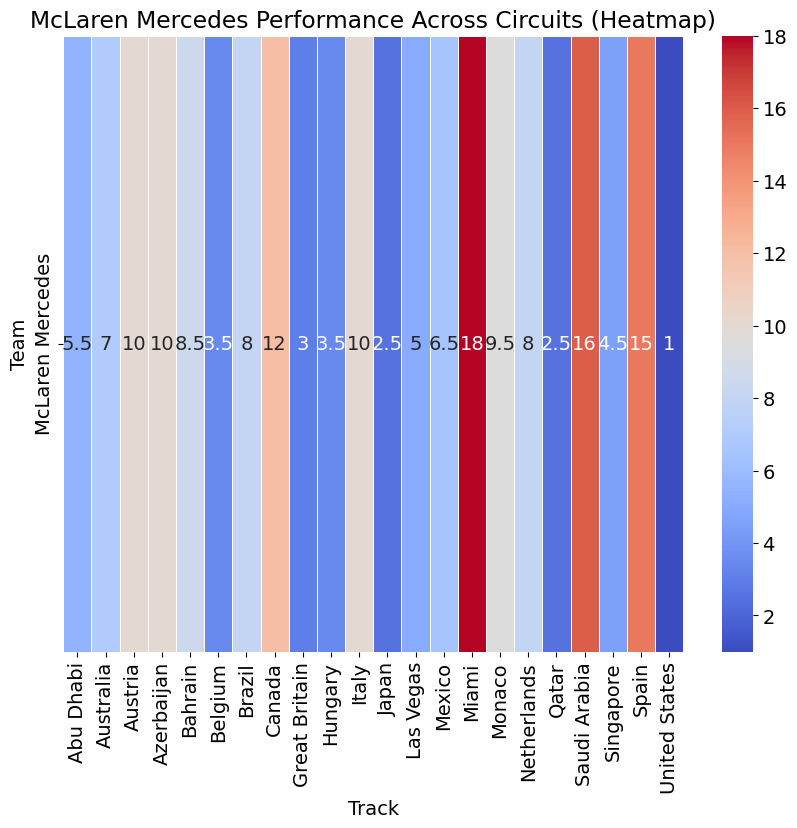

In [85]:
for team in team_names:
    team_data = results[results['Team']==team]
    
    team_performance = team_data.groupby(['Team','Track'])['Position'].mean().reset_index()
    performance_matrix = team_performance.pivot(index='Team', columns='Track', values='Position')

    plt.figure(figsize=(10, 8))
    sns.heatmap(performance_matrix, annot=True, cmap='coolwarm', linewidths=.5)
    plt.title(f'{team} Performance Across Circuits (Heatmap)')
    plt.show()

In [86]:
for team in team_names:
    team_data = results[results['Team']==team]
    
    team_performance = team_data.groupby(['Team','Track'])['Position'].mean().reset_index()
    team_overall_avg = team_data.groupby('Team')['Position'].mean().reset_index()

    # Merge overall average with circuit-wise performance
    team_performance = team_performance.merge(team_overall_avg, on='Team', suffixes=('_circuit', '_overall'))

    # Calculate performance improvement for each circuit
    team_performance['Improvement'] = team_performance['Position_overall'] - team_performance['Position_circuit']

    # Display improvement data
    print(f'Improvement Data for {team}')
    display(team_performance)

Improvement Data for Red Bull Racing Honda RBPT


,Team,Track,Position_circuit,Position_overall,Improvement
0,Red Bull Racing Honda RBPT,Abu Dhabi,2.5,2.681818,0.181818
1,Red Bull Racing Honda RBPT,Australia,3.0,2.681818,-0.318182
2,Red Bull Racing Honda RBPT,Austria,2.0,2.681818,0.681818
3,Red Bull Racing Honda RBPT,Azerbaijan,1.5,2.681818,1.181818
4,Red Bull Racing Honda RBPT,Bahrain,1.5,2.681818,1.181818
5,Red Bull Racing Honda RBPT,Belgium,1.5,2.681818,1.181818
6,Red Bull Racing Honda RBPT,Brazil,2.5,2.681818,0.181818
7,Red Bull Racing Honda RBPT,Canada,3.5,2.681818,-0.818182
8,Red Bull Racing Honda RBPT,Great Britain,3.5,2.681818,-0.818182
9,Red Bull Racing Honda RBPT,Hungary,2.0,2.681818,0.681818


Improvement Data for Aston Martin Aramco Mercedes


,Team,Track,Position_circuit,Position_overall,Improvement
0,Aston Martin Aramco Mercedes,Abu Dhabi,8.5,6.363636,-2.136364
1,Aston Martin Aramco Mercedes,Australia,3.5,6.363636,2.863636
2,Aston Martin Aramco Mercedes,Austria,7.0,6.363636,-0.636364
3,Aston Martin Aramco Mercedes,Azerbaijan,5.5,6.363636,0.863636
4,Aston Martin Aramco Mercedes,Bahrain,4.5,6.363636,1.863636
5,Aston Martin Aramco Mercedes,Belgium,7.0,6.363636,-0.636364
6,Aston Martin Aramco Mercedes,Brazil,4.0,6.363636,2.363636
7,Aston Martin Aramco Mercedes,Canada,5.5,6.363636,0.863636
8,Aston Martin Aramco Mercedes,Great Britain,10.5,6.363636,-4.136364
9,Aston Martin Aramco Mercedes,Hungary,9.5,6.363636,-3.136364


Improvement Data for Ferrari


,Team,Track,Position_circuit,Position_overall,Improvement
0,Ferrari,Abu Dhabi,10.0,4.75,-5.25
1,Ferrari,Australia,6.0,4.75,-1.25
2,Ferrari,Austria,4.0,4.75,0.75
3,Ferrari,Azerbaijan,4.0,4.75,0.75
4,Ferrari,Bahrain,2.0,4.75,2.75
5,Ferrari,Belgium,1.5,4.75,3.25
6,Ferrari,Brazil,3.0,4.75,1.75
7,Ferrari,Canada,4.5,4.75,0.25
8,Ferrari,Great Britain,9.5,4.75,-4.75
9,Ferrari,Hungary,7.5,4.75,-2.75


Improvement Data for Mercedes


,Team,Track,Position_circuit,Position_overall,Improvement
0,Mercedes,Abu Dhabi,6.0,5.090909,-0.909091
1,Mercedes,Australia,1.0,5.090909,4.090909
2,Mercedes,Austria,7.5,5.090909,-2.409091
3,Mercedes,Azerbaijan,7.0,5.090909,-1.909091
4,Mercedes,Bahrain,6.0,5.090909,-0.909091
5,Mercedes,Belgium,5.0,5.090909,0.090909
6,Mercedes,Brazil,4.0,5.090909,1.090909
7,Mercedes,Canada,1.5,5.090909,3.590909
8,Mercedes,Great Britain,4.0,5.090909,1.090909
9,Mercedes,Hungary,5.0,5.090909,0.090909


Improvement Data for Alfa Romeo Ferrari


,Team,Track,Position_circuit,Position_overall,Improvement
0,Alfa Romeo Ferrari,Abu Dhabi,18.0,11.568182,-6.431818
1,Alfa Romeo Ferrari,Australia,10.0,11.568182,1.568182
2,Alfa Romeo Ferrari,Austria,13.5,11.568182,-1.931818
3,Alfa Romeo Ferrari,Azerbaijan,9.0,11.568182,2.568182
4,Alfa Romeo Ferrari,Bahrain,12.0,11.568182,-0.431818
5,Alfa Romeo Ferrari,Belgium,12.5,11.568182,-0.931818
6,Alfa Romeo Ferrari,Brazil,0.0,11.568182,11.568182
7,Alfa Romeo Ferrari,Canada,13.0,11.568182,-1.431818
8,Alfa Romeo Ferrari,Great Britain,13.5,11.568182,-1.931818
9,Alfa Romeo Ferrari,Hungary,14.0,11.568182,-2.431818


Improvement Data for Alpine Renault


,Team,Track,Position_circuit,Position_overall,Improvement
0,Alpine Renault,Abu Dhabi,12.5,8.272727,-4.227273
1,Alpine Renault,Australia,13.5,8.272727,-5.227273
2,Alpine Renault,Austria,12.0,8.272727,-3.727273
3,Alpine Renault,Azerbaijan,14.5,8.272727,-6.227273
4,Alpine Renault,Bahrain,4.5,8.272727,3.772727
5,Alpine Renault,Belgium,9.5,8.272727,-1.227273
6,Alpine Renault,Brazil,8.5,8.272727,-0.227273
7,Alpine Renault,Canada,10.0,8.272727,-1.727273
8,Alpine Renault,Great Britain,9.0,8.272727,-0.727273
9,Alpine Renault,Hungary,0.0,8.272727,8.272727


Improvement Data for Williams Mercedes


,Team,Track,Position_circuit,Position_overall,Improvement
0,Williams Mercedes,Abu Dhabi,15.0,10.75,-4.25
1,Williams Mercedes,Australia,8.0,10.75,2.75
2,Williams Mercedes,Austria,12.0,10.75,-1.25
3,Williams Mercedes,Azerbaijan,14.0,10.75,-3.25
4,Williams Mercedes,Bahrain,11.0,10.75,-0.25
5,Williams Mercedes,Belgium,15.5,10.75,-4.75
6,Williams Mercedes,Brazil,5.5,10.75,5.25
7,Williams Mercedes,Canada,3.5,10.75,7.25
8,Williams Mercedes,Great Britain,9.5,10.75,1.25
9,Williams Mercedes,Hungary,14.5,10.75,-3.75


Improvement Data for AlphaTauri Honda RBPT


,Team,Track,Position_circuit,Position_overall,Improvement
0,AlphaTauri Honda RBPT,Abu Dhabi,9.5,12.272727,2.772727
1,AlphaTauri Honda RBPT,Australia,12.5,12.272727,-0.227273
2,AlphaTauri Honda RBPT,Austria,18.0,12.272727,-5.727273
3,AlphaTauri Honda RBPT,Azerbaijan,5.0,12.272727,7.272727
4,AlphaTauri Honda RBPT,Bahrain,12.5,12.272727,-0.227273
5,AlphaTauri Honda RBPT,Belgium,13.0,12.272727,-0.727273
6,AlphaTauri Honda RBPT,Brazil,11.0,12.272727,1.272727
7,AlphaTauri Honda RBPT,Canada,16.0,12.272727,-3.727273
8,AlphaTauri Honda RBPT,Great Britain,16.5,12.272727,-4.227273
9,AlphaTauri Honda RBPT,Hungary,14.0,12.272727,-1.727273


Improvement Data for Haas Ferrari


,Team,Track,Position_circuit,Position_overall,Improvement
0,Haas Ferrari,Abu Dhabi,17.5,13.340909,-4.159091
1,Haas Ferrari,Australia,12.0,13.340909,1.340909
2,Haas Ferrari,Austria,9.0,13.340909,4.340909
3,Haas Ferrari,Azerbaijan,15.0,13.340909,-1.659091
4,Haas Ferrari,Bahrain,14.0,13.340909,-0.659091
5,Haas Ferrari,Belgium,16.5,13.340909,-3.159091
6,Haas Ferrari,Brazil,6.0,13.340909,7.340909
7,Haas Ferrari,Canada,16.0,13.340909,-2.659091
8,Haas Ferrari,Great Britain,6.5,13.340909,6.840909
9,Haas Ferrari,Hungary,15.5,13.340909,-2.159091


Improvement Data for McLaren Mercedes


,Team,Track,Position_circuit,Position_overall,Improvement
0,McLaren Mercedes,Abu Dhabi,5.5,7.704545,2.204545
1,McLaren Mercedes,Australia,7.0,7.704545,0.704545
2,McLaren Mercedes,Austria,10.0,7.704545,-2.295455
3,McLaren Mercedes,Azerbaijan,10.0,7.704545,-2.295455
4,McLaren Mercedes,Bahrain,8.5,7.704545,-0.795455
5,McLaren Mercedes,Belgium,3.5,7.704545,4.204545
6,McLaren Mercedes,Brazil,8.0,7.704545,-0.295455
7,McLaren Mercedes,Canada,12.0,7.704545,-4.295455
8,McLaren Mercedes,Great Britain,3.0,7.704545,4.704545
9,McLaren Mercedes,Hungary,3.5,7.704545,4.204545


# Driver Position Changes 


In [87]:
pip install fastf1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.3/148.3 kB 3.7 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.4/61.4 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 28.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 3.4 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [88]:
track_names = results['Track'].unique()

In [89]:
track_names 

array(['Bahrain', 'Saudi Arabia', 'Australia', 'Azerbaijan', 'Miami',
       'Monaco', 'Spain', 'Canada', 'Austria', 'Great Britain', 'Hungary',
       'Belgium', 'Netherlands', 'Italy', 'Singapore', 'Japan', 'Qatar',
       'United States', 'Mexico', 'Brazil', 'Las Vegas', 'Abu Dhabi'],
      dtype=object)

req         WARNING 	DEFAULT CACHE ENABLED! (24.0 KB) /root/.cache/fastf1
core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req

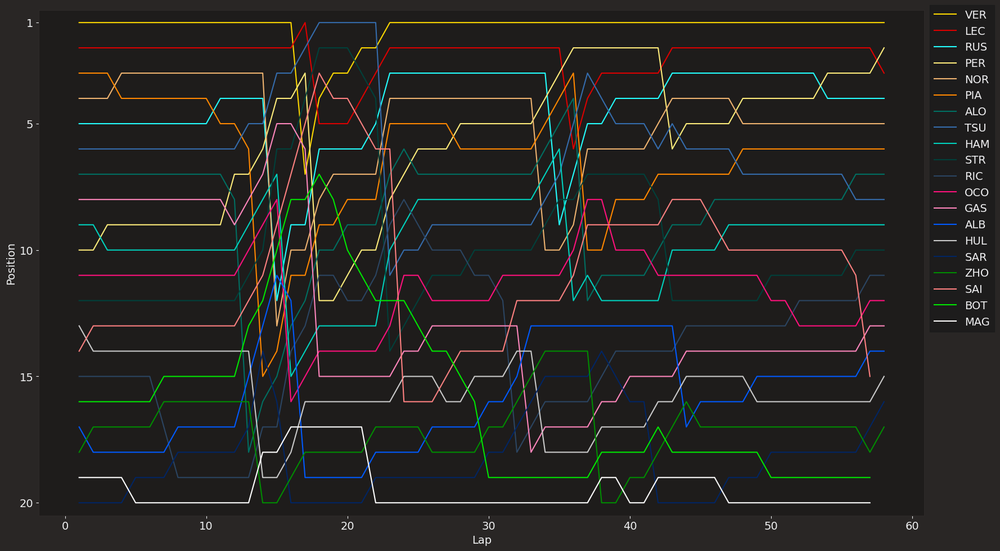

In [90]:
import fastf1.plotting 
import matplotlib.pyplot as plt

# setting up matplotlib plotting modules
fastf1.plotting.setup_mpl(misc_mpl_mods=False)

# Loading the sessions we choose
session = fastf1.get_session(2023,'Abu Dhabi','R')
session.load(telemetry=False,weather=False)

fig,ax = plt.subplots(figsize=(18,10))


# plotting position chnge for each driver 


# for each driver, get their three letter abbreviation (eg: 'HAM') by simply using the value of the first
# lap,get their color and then plot their position over the number of laps 

# looping through each driver 

for drv in session.drivers:
    drv_laps = session.laps.pick_driver(drv)
#     get driver abbreviation and color
    abb = drv_laps['Driver'].iloc[0]
    color = fastf1.plotting.driver_color(abb)
#     plot lap position throughout the race
    ax.plot(drv_laps['LapNumber'],drv_laps['Position'],label=abb,color=color)
    

    
    
# beautifying plot

ax.set_ylim([20.5,0.5])
ax.set_yticks([1,5,10,15,20])
ax.set_xlabel('Lap')
ax.set_ylabel('Position')

# Add legend 
ax.legend(bbox_to_anchor=(1.0,1.02))
plt.tight_layout()
plt.show()

In [91]:
# import fastf1.plotting
# import matplotlib.pyplot as plt

# # Setup matplotlib plotting
# fastf1.plotting.setup_mpl(misc_mpl_mods=False)

# # Your unique list of track names
# track_names = ['Bahrain', 'Saudi Arabia', 'Australia', 'Azerbaijan', 'Miami', 'Monaco', 
#                'Spain', 'Canada', 'Austria', 'Great Britain', 'Hungary', 'Belgium', 
#                'Netherlands', 'Italy', 'Singapore', 'Japan', 'Qatar', 'United States', 
#                'Mexico', 'Brazil', 'Las Vegas', 'Abu Dhabi']

# # Loop through each track in the track_names list
# for track in track_names:
    
#     # Load the race session for each track
#     session = fastf1.get_session(2023, track, 'R')
#     session.load(telemetry=False, weather=False)
    
#     # Create a new figure for each race
#     fig, ax = plt.subplots(figsize=(18, 10))
    
#     # Loop through each driver in the session
#     for drv in session.drivers:
#         drv_laps = session.laps.pick_driver(drv)
        
#         # Get driver abbreviation and color
#         abb = drv_laps['Driver'].iloc[0]
#         color = fastf1.plotting.driver_color(abb)
        
#         # Plot the driver's position over the laps
#         ax.plot(drv_laps['LapNumber'], drv_laps['Position'], label=abb, color=color)
    
#     # Beautify the plot
#     ax.set_ylim([20.5, 0.5])
#     ax.set_yticks([1, 5, 10, 15, 20])
#     ax.set_xlabel('Lap')
#     ax.set_ylabel('Position')
#     ax.set_title(f"Driver Position Changes - {track} Grand Prix 2023")

#     # Add legend
#     ax.legend(bbox_to_anchor=(1.0, 1.02))
#     plt.tight_layout()
    
#     # Show the plot for the current race
#     plt.show()


core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No ca

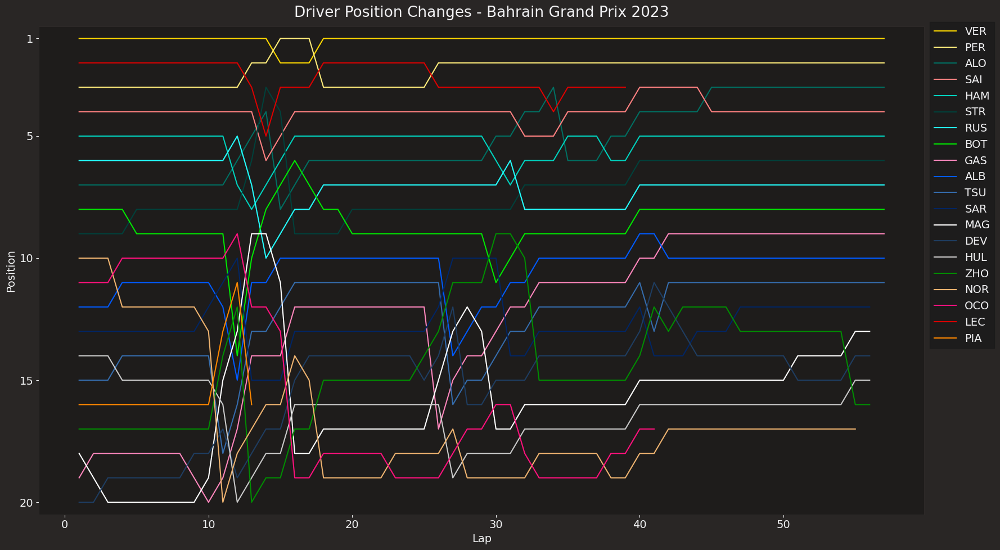

core           INFO 	Loading data for Saudi Arabian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 

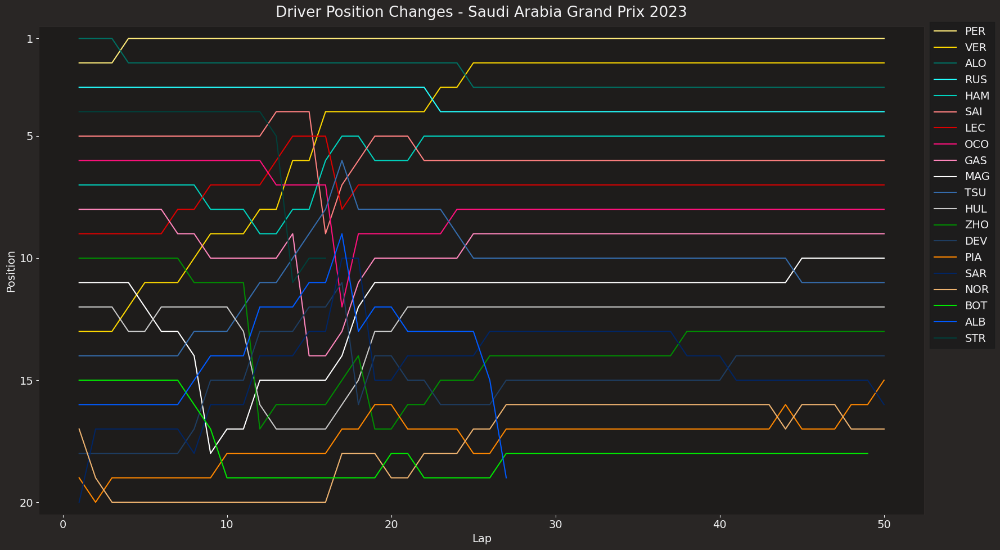

core           INFO 	Loading data for Australian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No

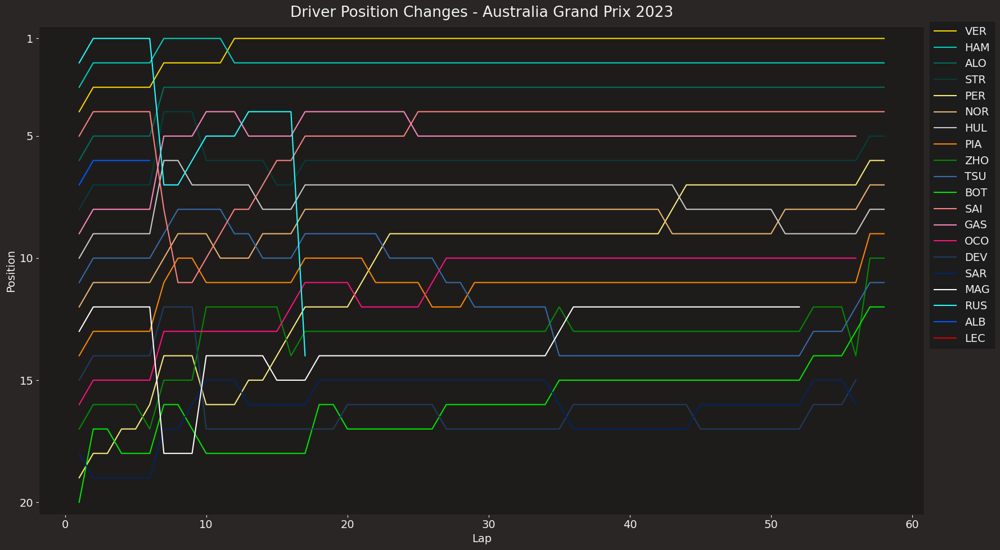

core           INFO 	Loading data for Azerbaijan Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No

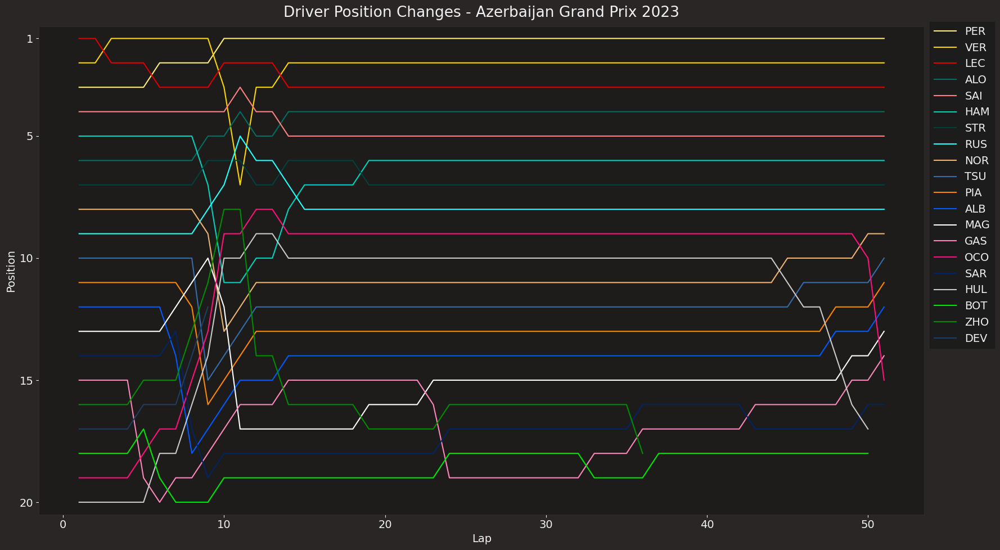

core           INFO 	Loading data for Miami Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cach

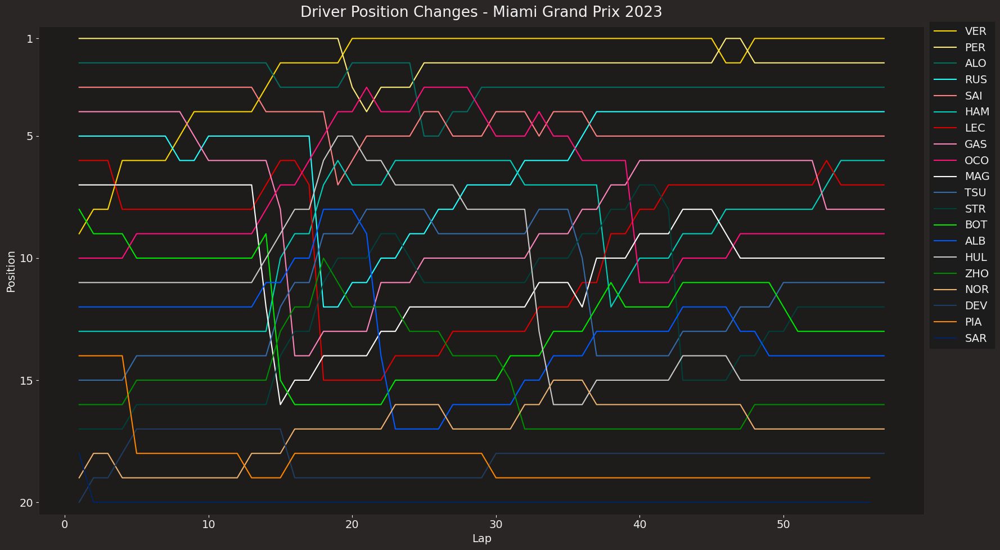

core           INFO 	Loading data for Monaco Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cac

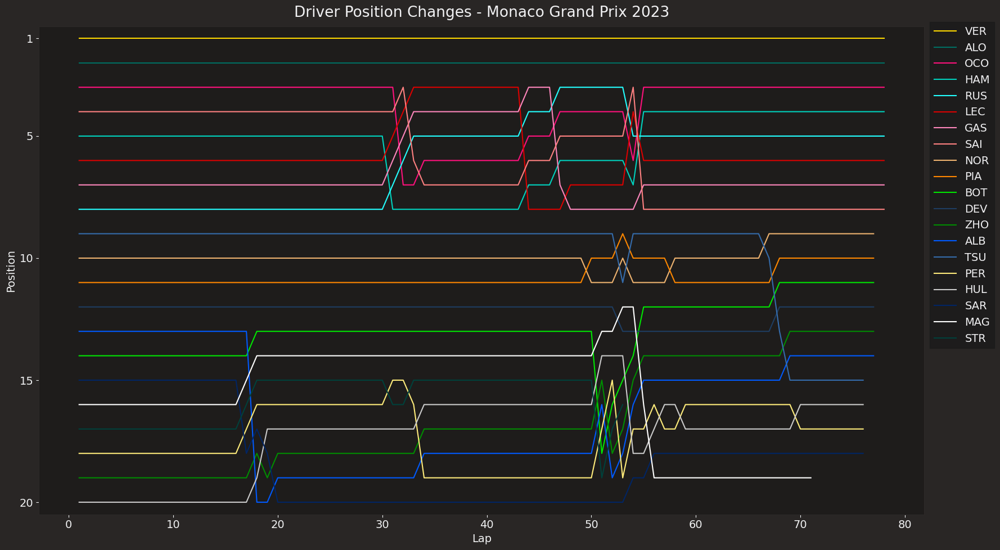

core           INFO 	Loading data for Spanish Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No ca

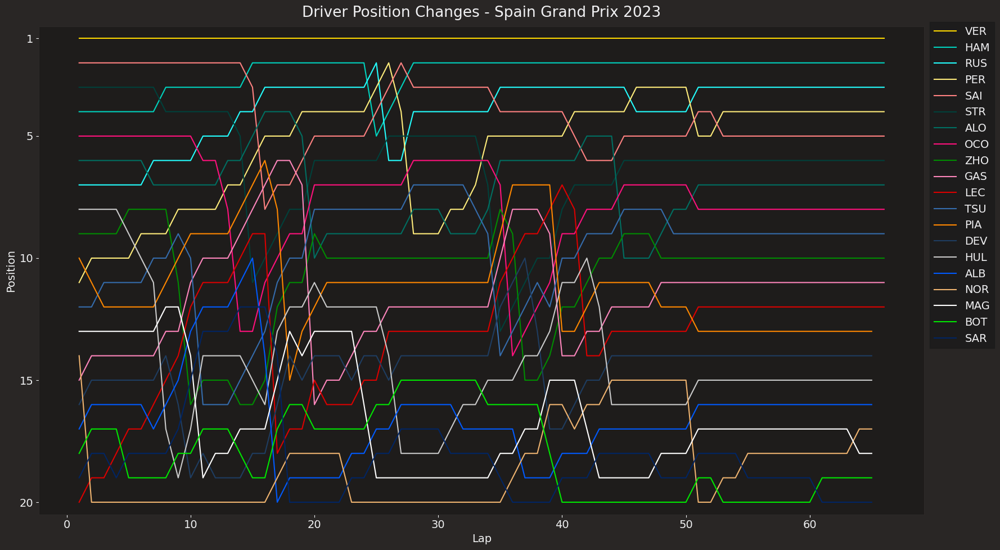

core           INFO 	Loading data for Canadian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No c

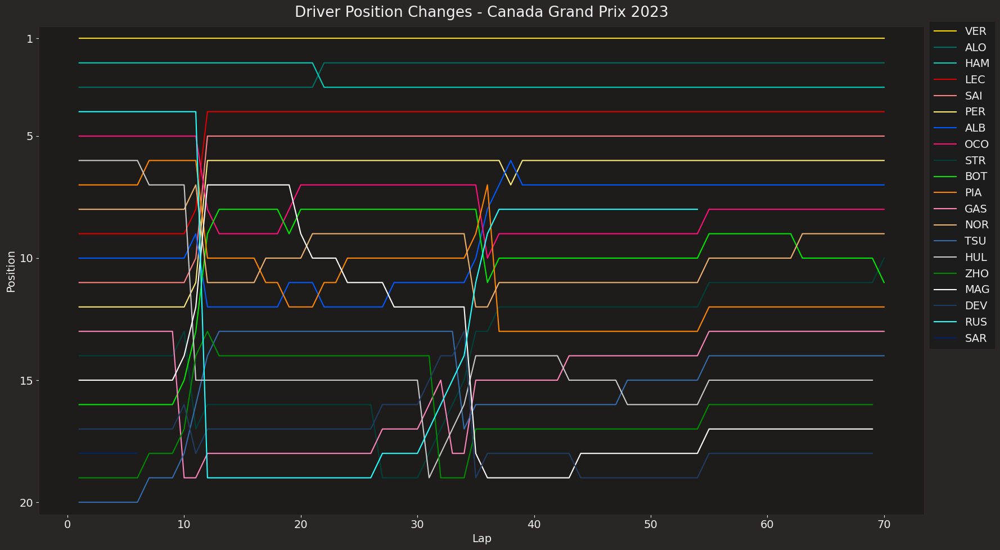

core           INFO 	Loading data for Austrian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
logger      WARNING 	Failed to load result data from Ergast!
core        WARNING 	No result data for this session available on Ergast! (This is expected for recent sessions)
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data 

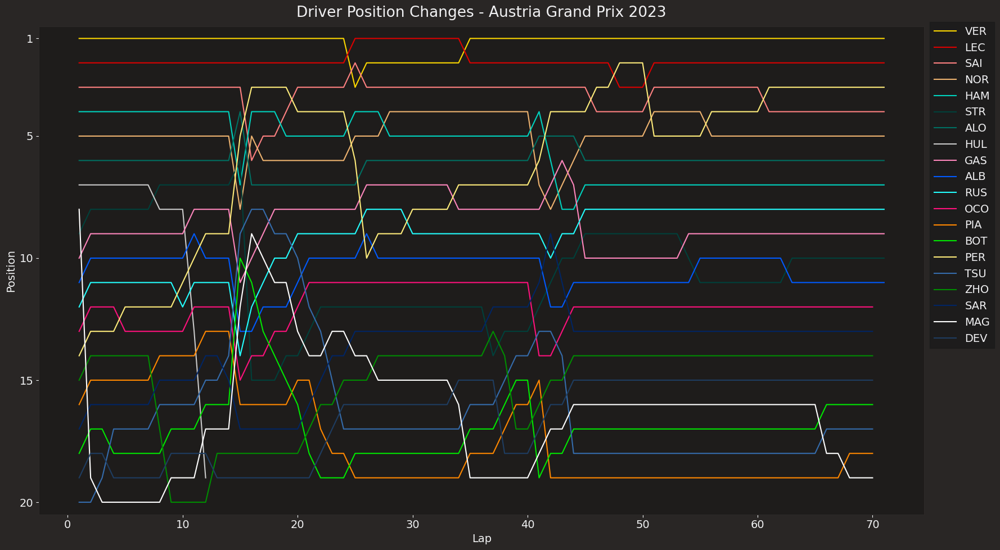

core           INFO 	Loading data for British Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No ca

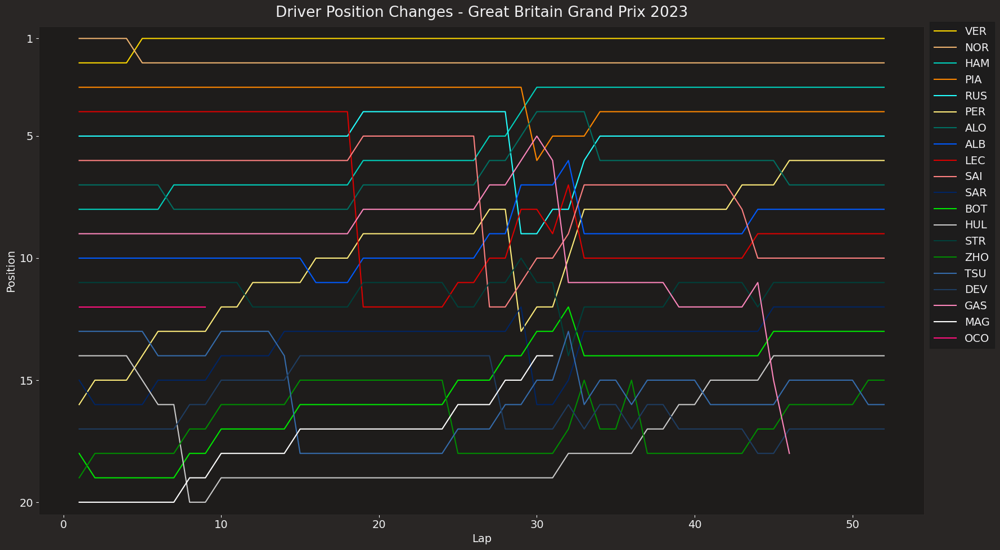

core           INFO 	Loading data for Hungarian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No 

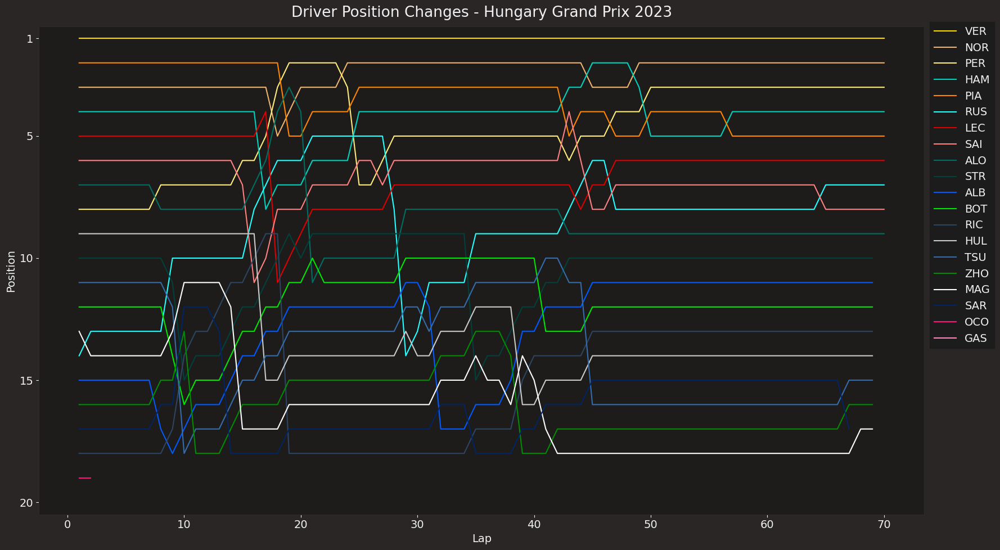

core           INFO 	Loading data for Belgian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No ca

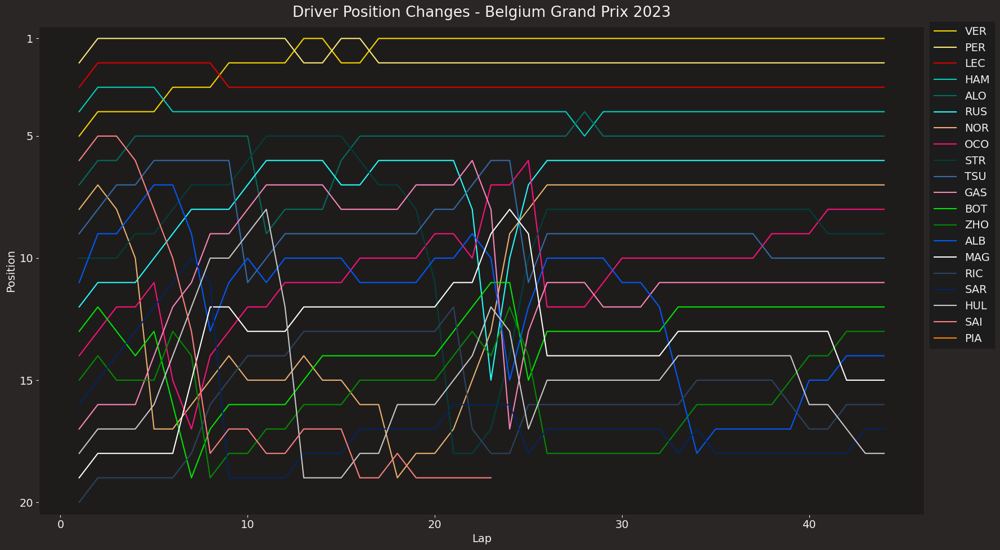

core           INFO 	Loading data for Dutch Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cach

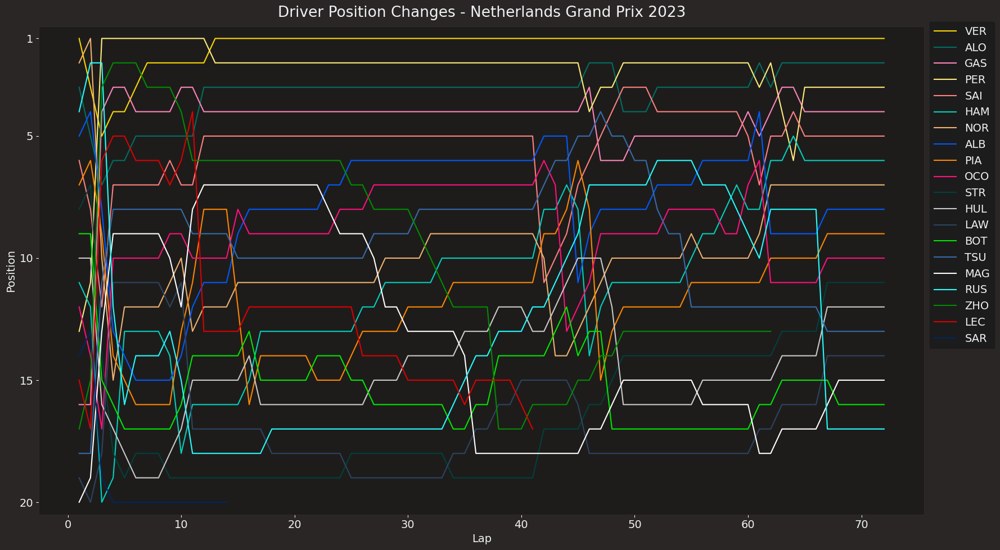

core           INFO 	Loading data for Italian Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No ca

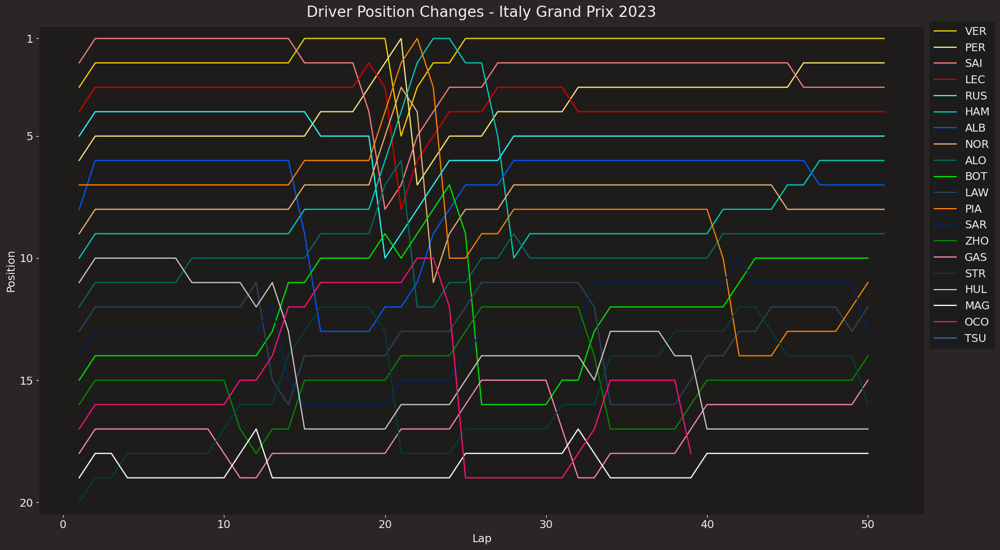

core           INFO 	Loading data for Singapore Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No 

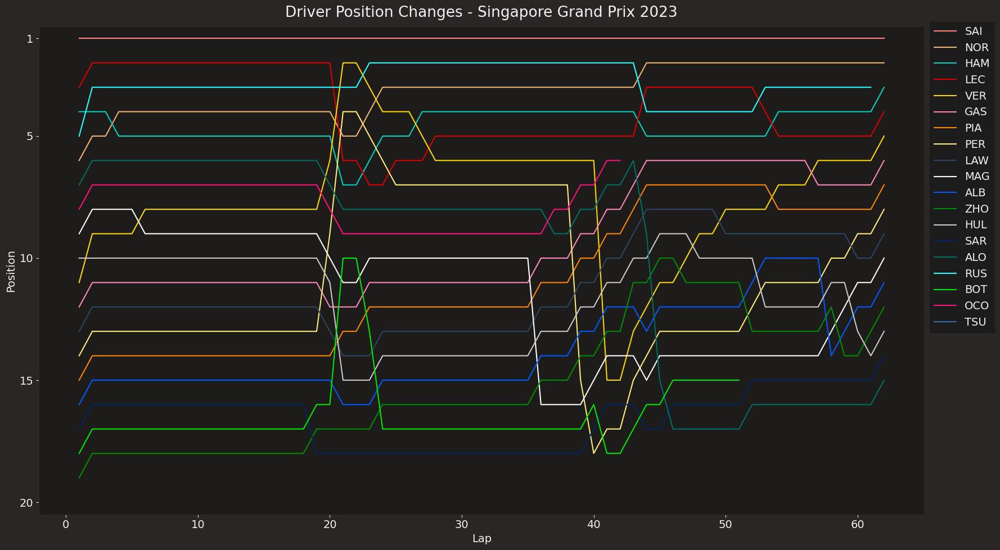

core           INFO 	Loading data for Japanese Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No c

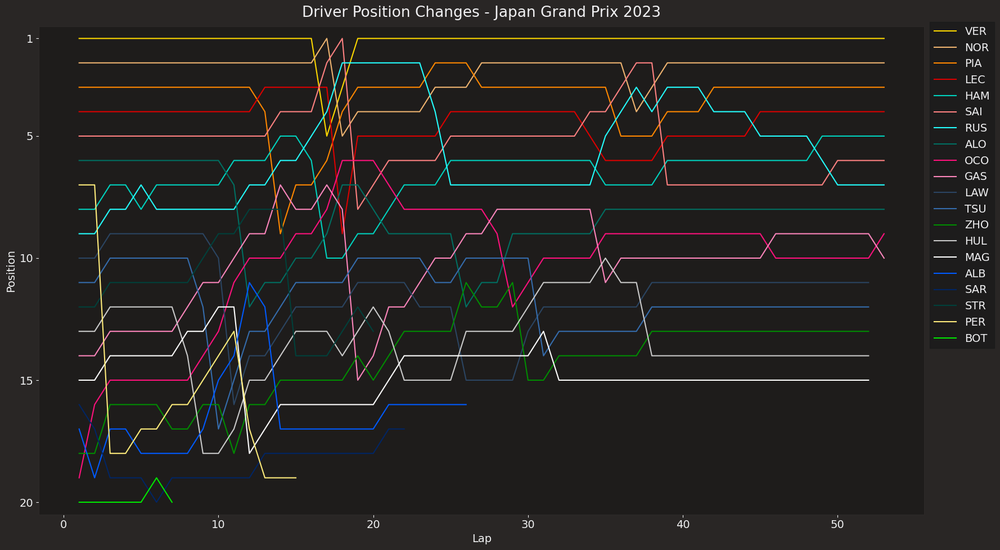

events      WARNING 	Correcting user input 'Qatar' to 'Qatar Grand Prix'
core           INFO 	Loading data for Qatar Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req     

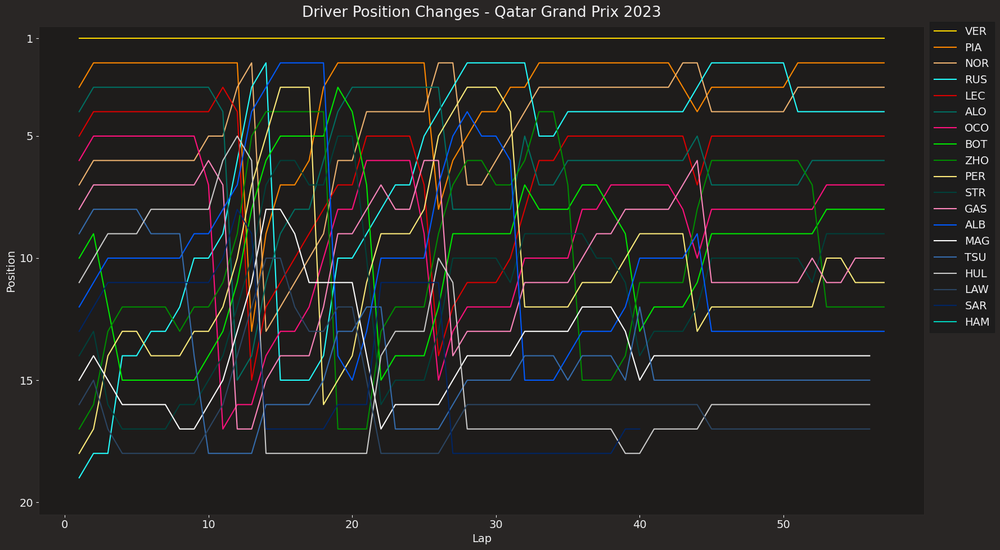

events      WARNING 	Correcting user input 'United States' to 'United States Grand Prix'
core           INFO 	Loading data for United States Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track

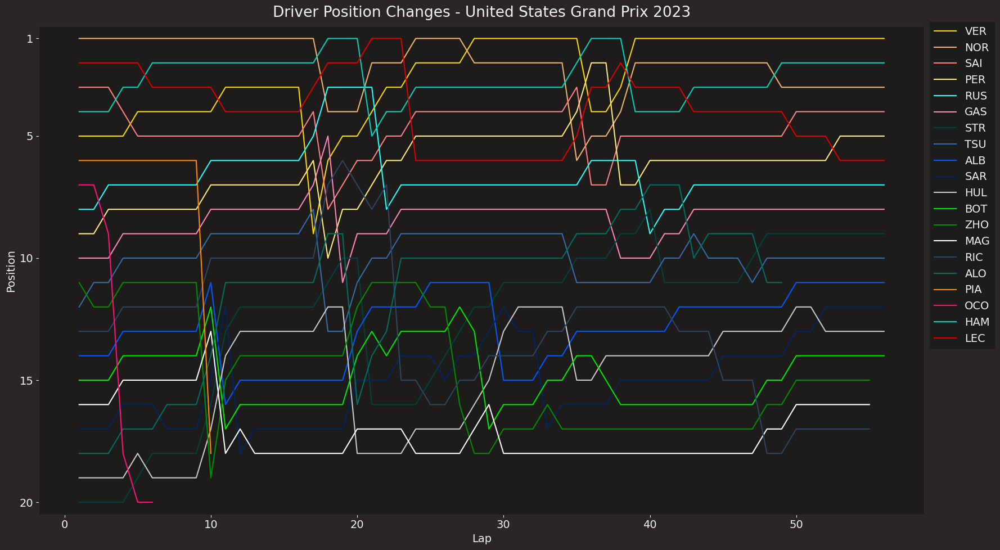

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	N

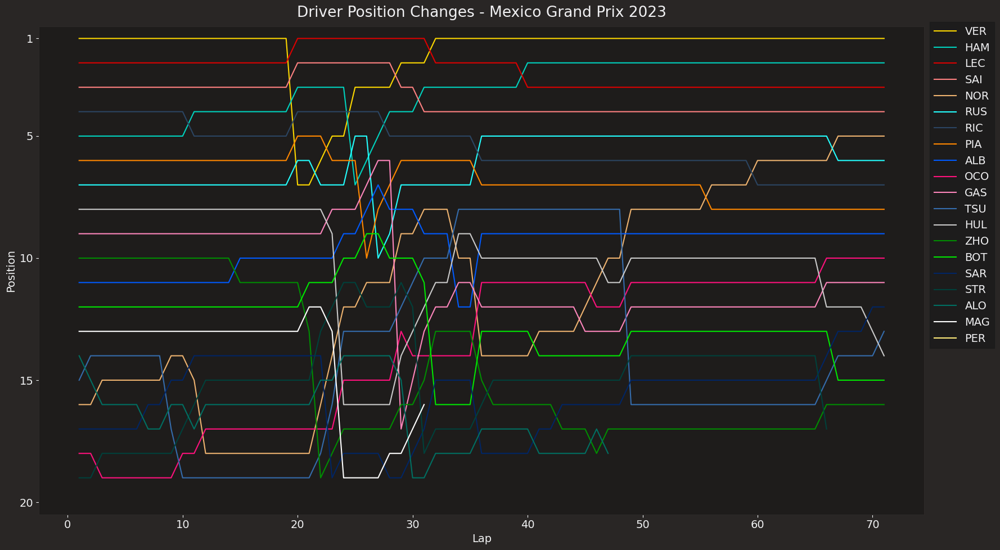

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No 

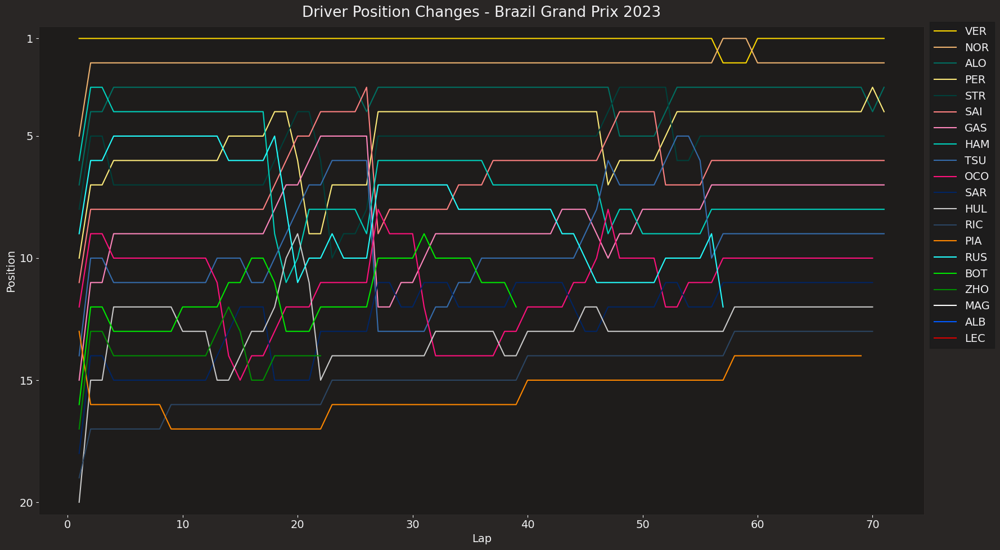

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.4.0]
req            INFO 	No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No 

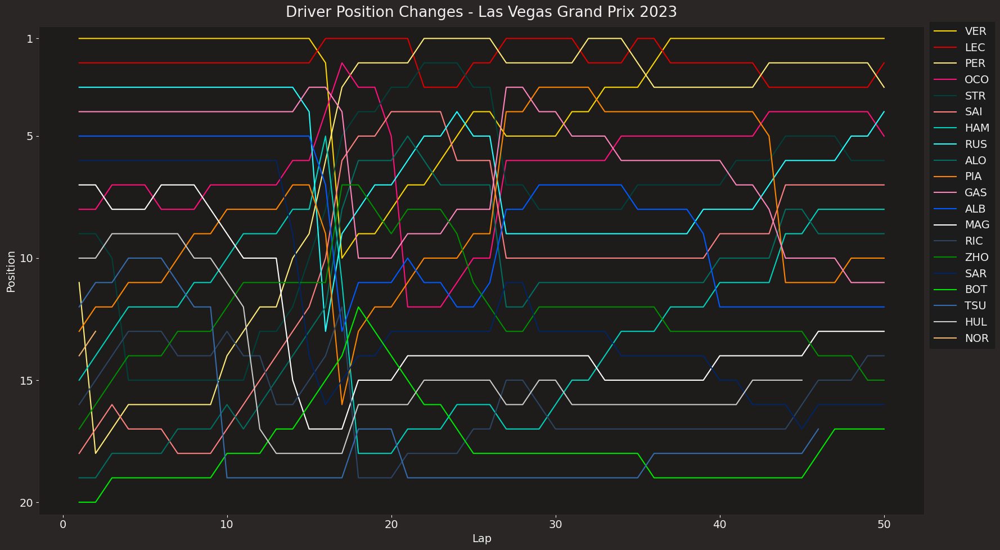

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


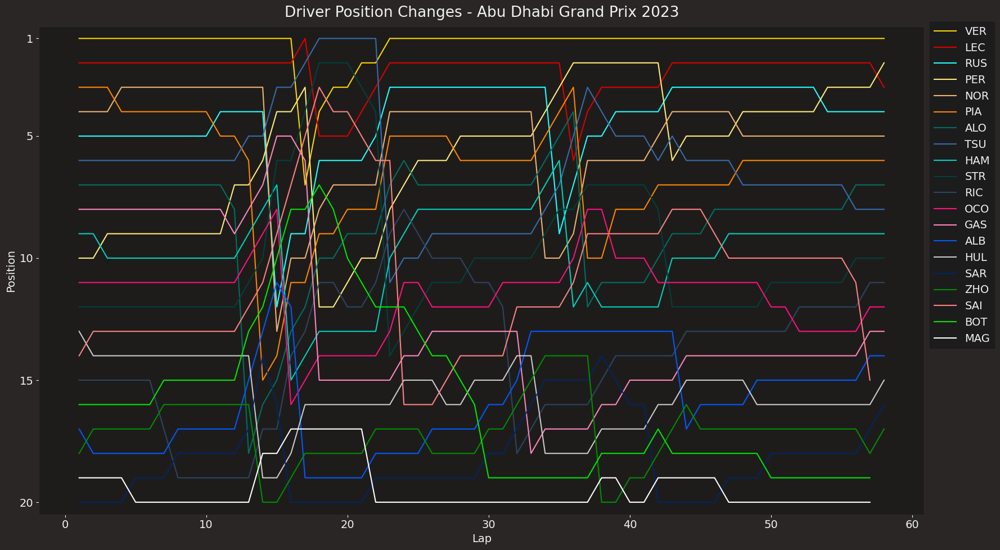

In [92]:
import fastf1.plotting
import matplotlib.pyplot as plt

# Setup matplotlib plotting
fastf1.plotting.setup_mpl(misc_mpl_mods=False)

# Your unique list of track names
track_names = ['Bahrain', 'Saudi Arabia', 'Australia', 'Azerbaijan', 'Miami', 'Monaco', 
               'Spain', 'Canada', 'Austria', 'Great Britain', 'Hungary', 'Belgium', 
               'Netherlands', 'Italy', 'Singapore', 'Japan', 'Qatar', 'United States', 
               'Mexico', 'Brazil', 'Las Vegas', 'Abu Dhabi']

# Loop through each track in the track_names list
for track in track_names:
    
    # Load the race session for each track
    session = fastf1.get_session(2023, track, 'R')
    session.load(telemetry=False, weather=False)
    
    # Create a new figure for each race
    fig, ax = plt.subplots(figsize=(18, 10))
    
    # Loop through each driver in the session
    for drv in session.drivers:
        drv_laps = session.laps.pick_driver(drv)
        
        # Only plot if there is lap data available for the driver
        if not drv_laps.empty:
            # Get driver abbreviation and color
            abb = drv_laps['Driver'].iloc[0]
            color = fastf1.plotting.driver_color(abb)
            
            # Plot the driver's position over the laps
            ax.plot(drv_laps['LapNumber'], drv_laps['Position'], label=abb, color=color)
    
    # Beautify the plot
    ax.set_ylim([20.5, 0.5])
    ax.set_yticks([1, 5, 10, 15, 20])
    ax.set_xlabel('Lap')
    ax.set_ylabel('Position')
    ax.set_title(f"Driver Position Changes - {track} Grand Prix 2023")

    # Add legend
    ax.legend(bbox_to_anchor=(1.0, 1.02))
    plt.tight_layout()
    
    # Show the plot for the current race
    plt.show()


# Driver Race Performance (Speed Analysis)

core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '55', '44', '18', '63', '77', '10', '23', '22', '2', '20', '21', '27', '24', '4', '31', '16', '81']


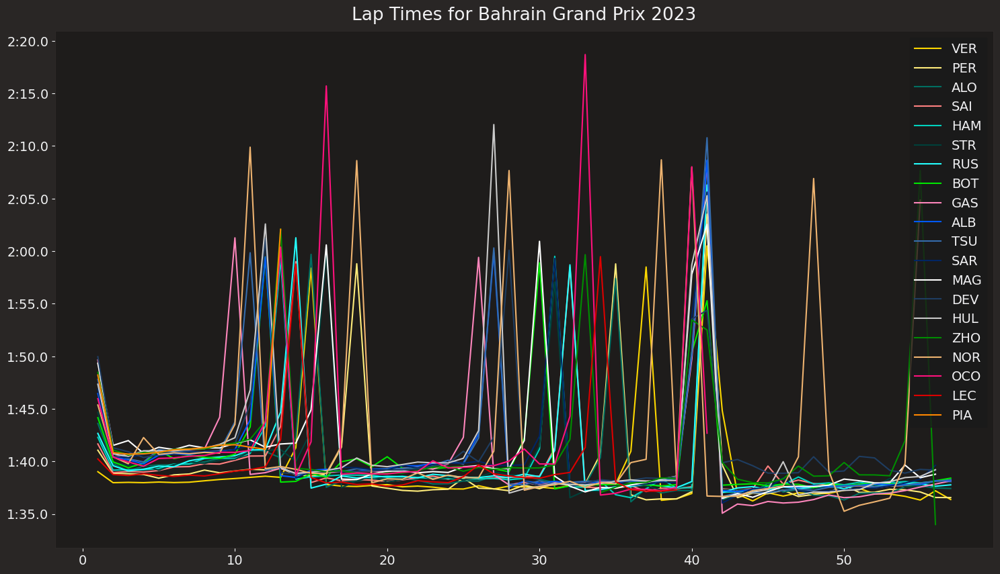

core           INFO 	Loading data for Saudi Arabian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '14', '63', '44', '55', '16', '31', '10', '20', '22', '27', '24', '21', '81', '2', '4', '77', '23', '18']


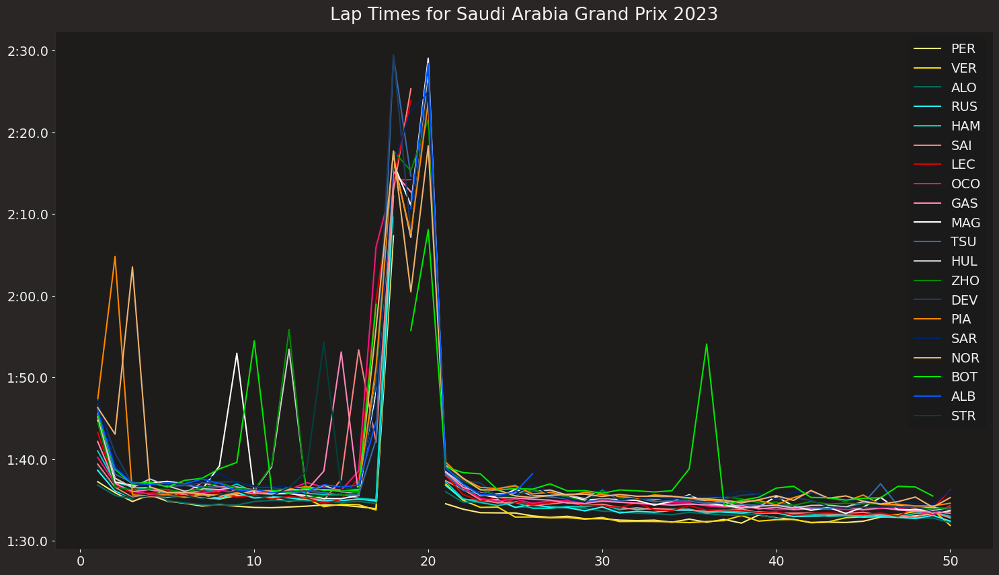

core           INFO 	Loading data for Australian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '14', '18', '11', '4', '27', '81', '24', '22', '77', '55', '10', '31', '21', '2', '20', '63', '23', '16']


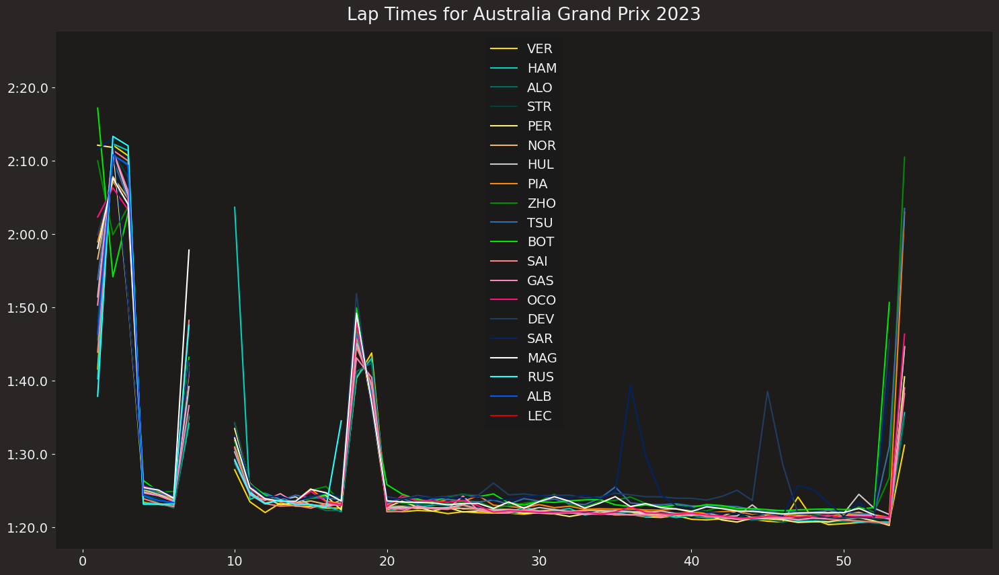

core           INFO 	Loading data for Azerbaijan Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '16', '14', '55', '44', '18', '63', '4', '22', '81', '23', '20', '10', '31', '2', '27', '77', '24', '21']


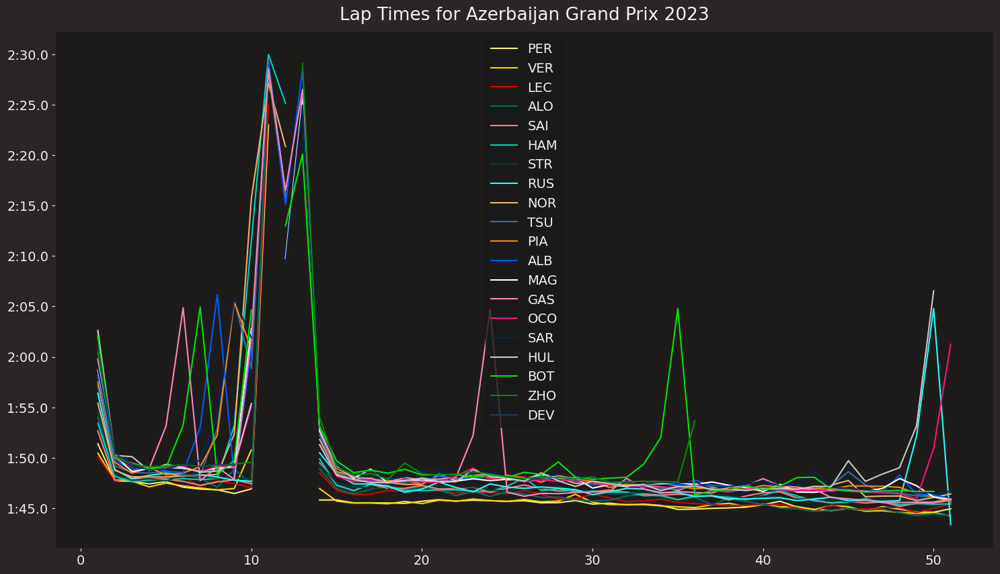

core           INFO 	Loading data for Miami Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '63', '55', '44', '16', '10', '31', '20', '22', '18', '77', '23', '27', '24', '4', '21', '81', '2']


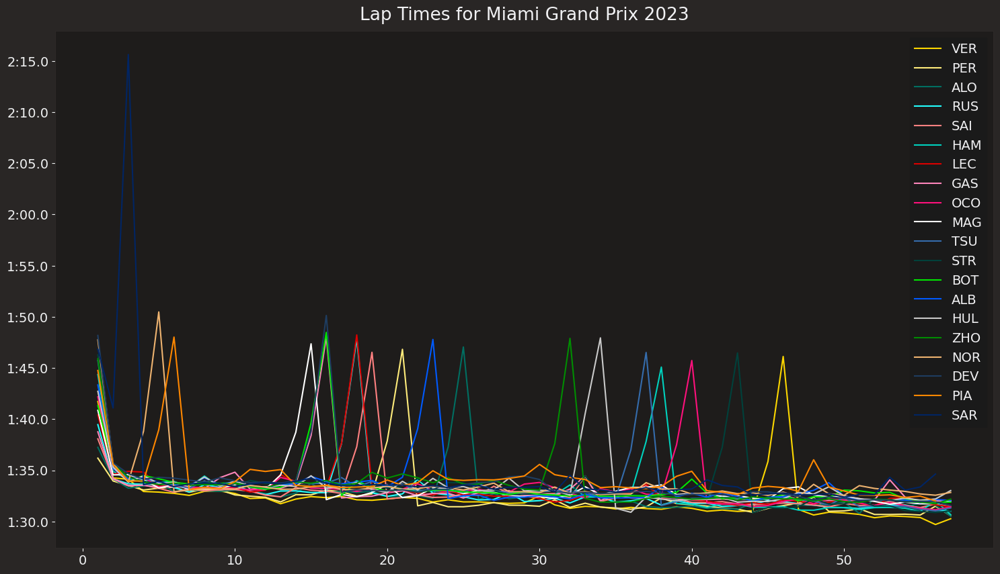

core           INFO 	Loading data for Monaco Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '31', '44', '63', '16', '10', '55', '4', '81', '77', '21', '24', '23', '22', '11', '27', '2', '20', '18']


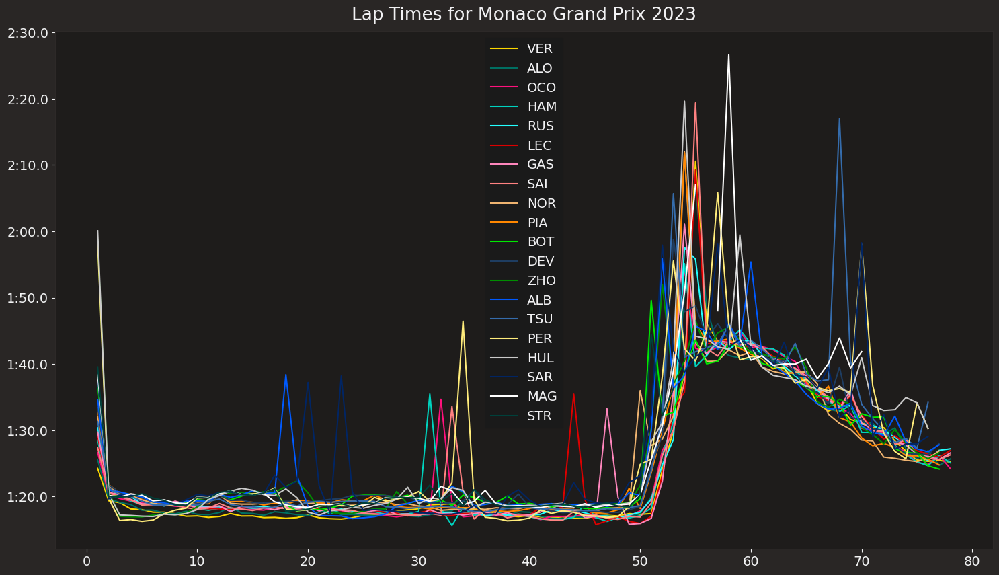

core           INFO 	Loading data for Spanish Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '63', '11', '55', '18', '14', '31', '24', '10', '16', '22', '81', '21', '27', '23', '4', '20', '77', '2']


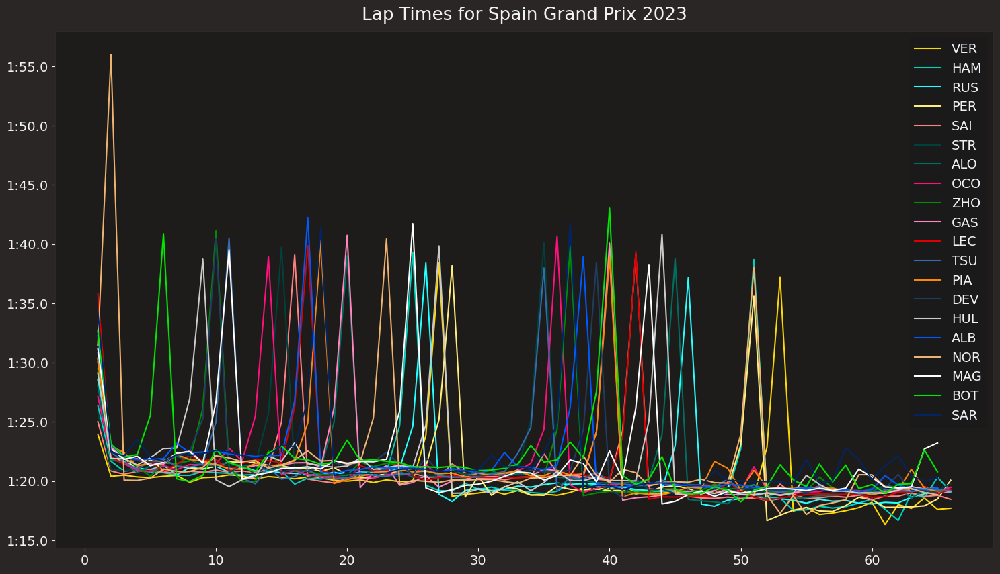

core           INFO 	Loading data for Canadian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '44', '16', '55', '11', '23', '31', '18', '77', '81', '10', '4', '22', '27', '24', '20', '21', '63', '2']


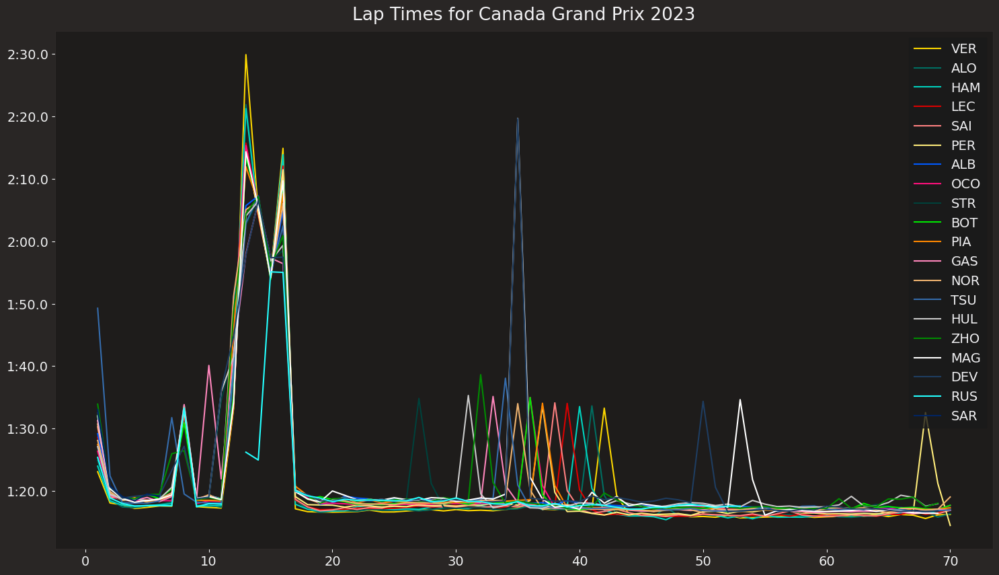

core           INFO 	Loading data for Austrian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '4', '14', '55', '63', '44', '18', '10', '23', '24', '2', '31', '77', '81', '21', '20', '22', '27']


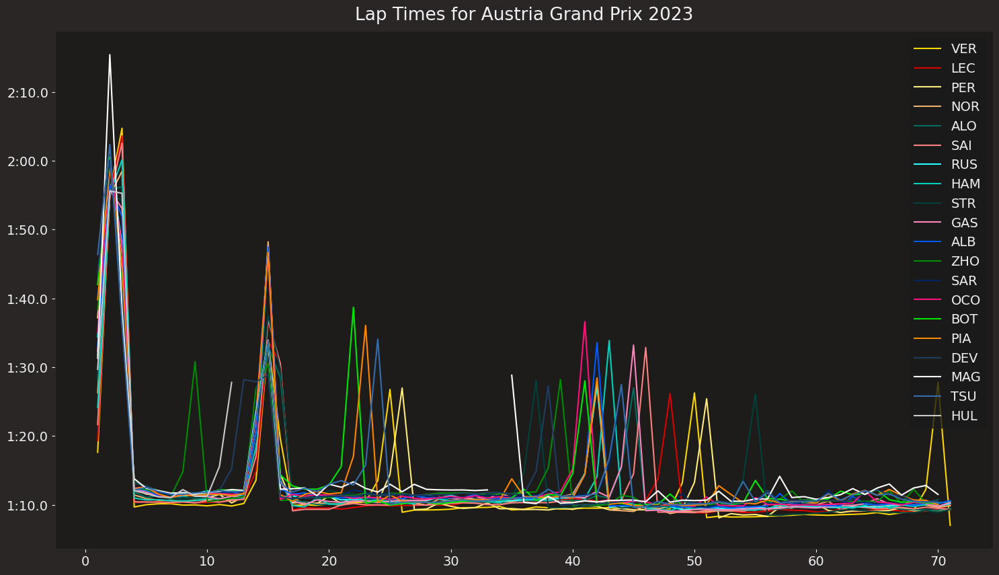

core           INFO 	Loading data for British Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '44', '81', '63', '11', '14', '23', '16', '55', '2', '77', '27', '18', '24', '22', '21', '10', '20', '31']


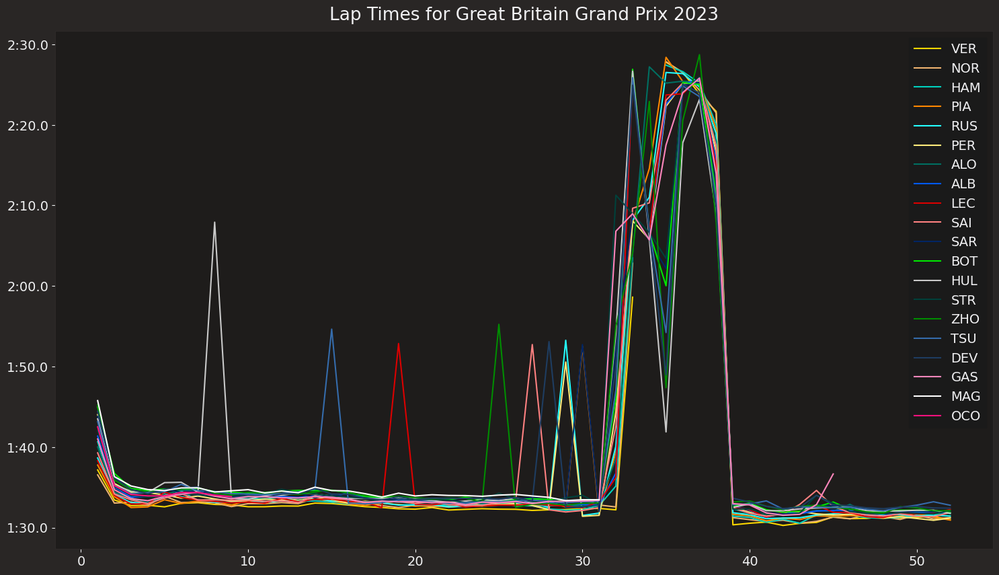

core           INFO 	Loading data for Hungarian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '11', '44', '81', '63', '16', '55', '14', '18', '23', '77', '3', '27', '22', '24', '20', '2', '31', '10']


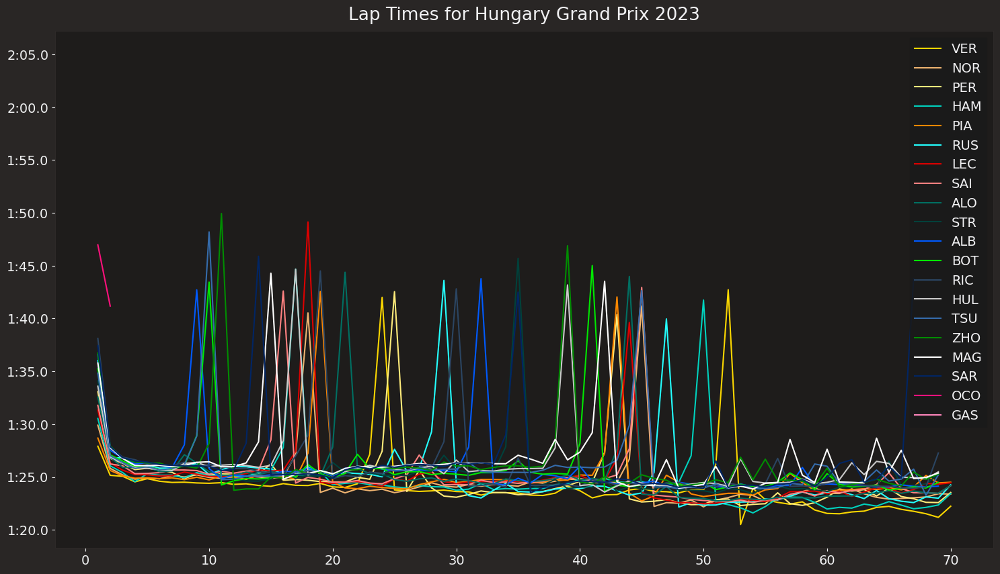

core           INFO 	Loading data for Belgian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '16', '44', '14', '63', '4', '31', '18', '22', '10', '77', '24', '23', '20', '3', '2', '27', '55', '81']


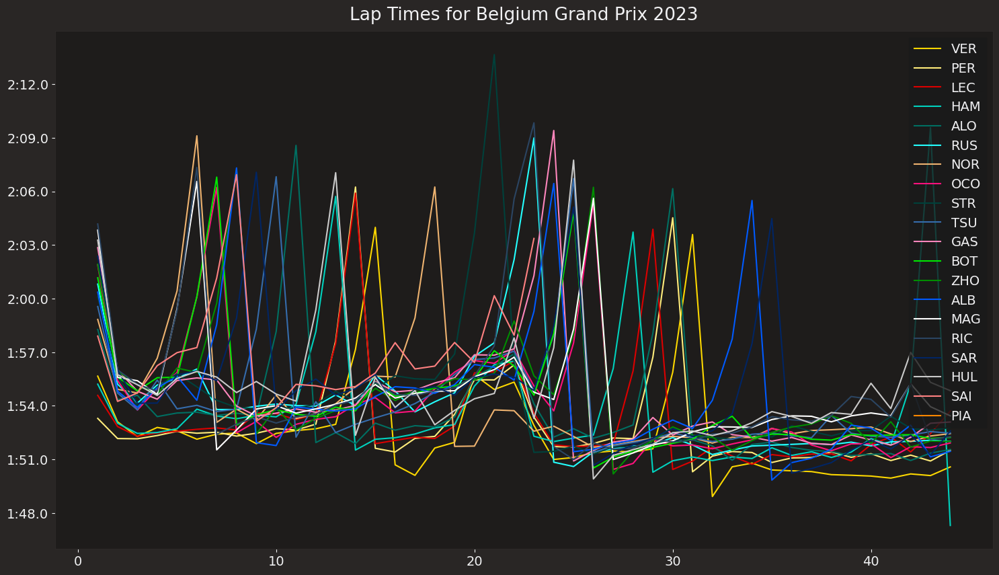

core           INFO 	Loading data for Dutch Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '10', '11', '55', '44', '4', '23', '81', '31', '18', '27', '40', '77', '22', '20', '63', '24', '16', '2']


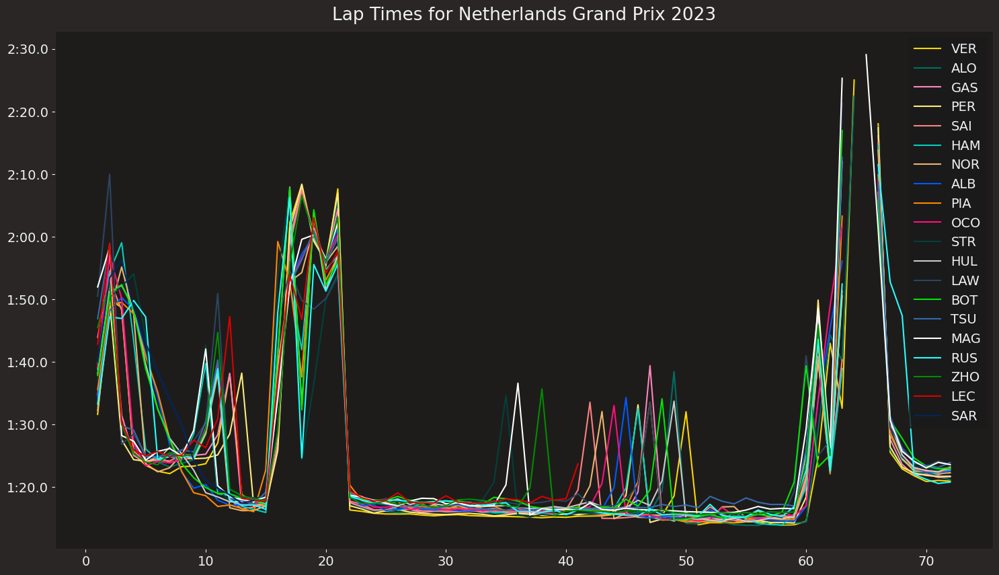

core           INFO 	Loading data for Italian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '55', '16', '63', '44', '23', '4', '14', '77', '40', '81', '2', '24', '10', '18', '27', '20', '31', '22']


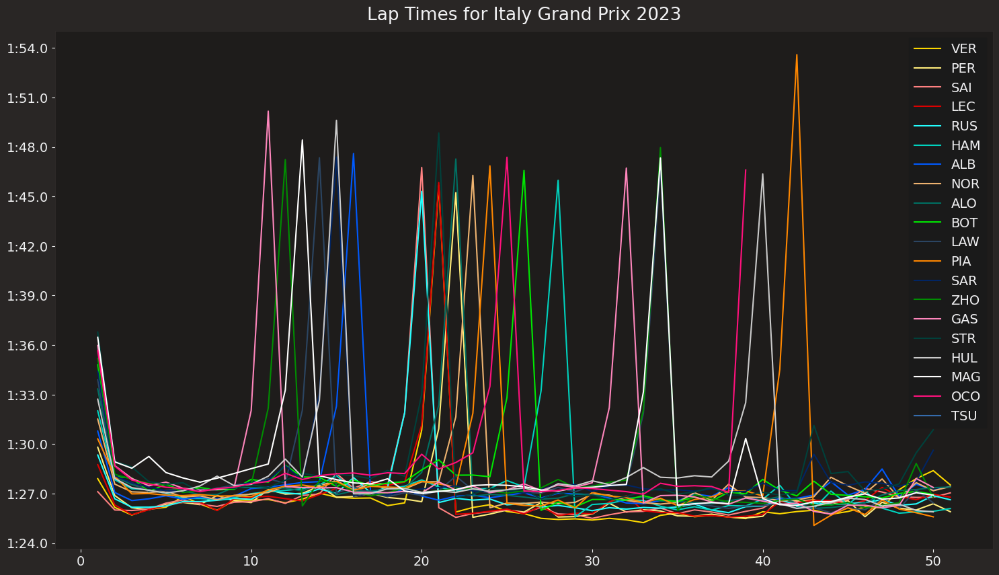

core           INFO 	Loading data for Singapore Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 18
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 18)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['55', '4', '44', '16', '1', '10', '81', '11', '40', '20', '23', '24', '27', '2', '14', '63', '77', '31', '22', '18']


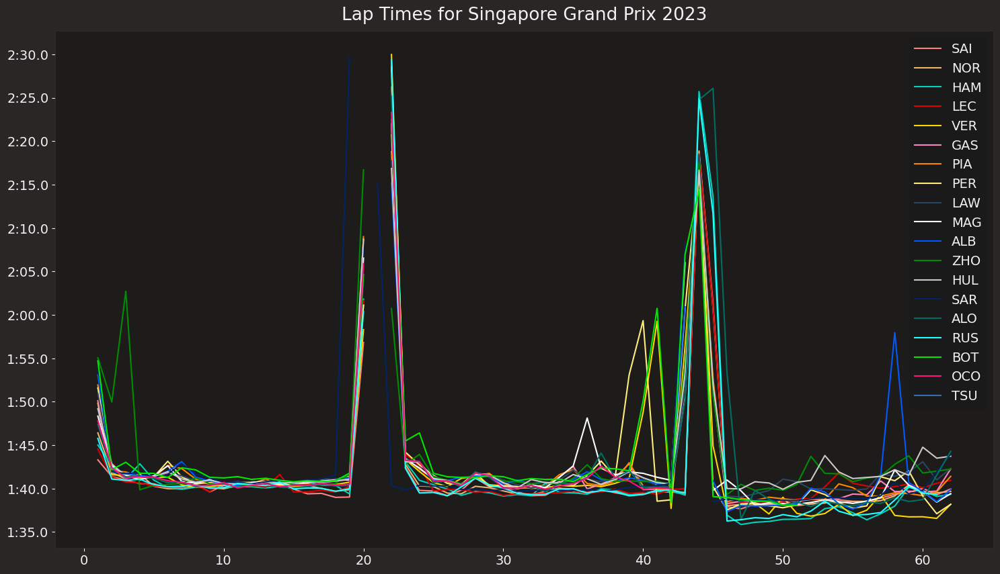

core           INFO 	Loading data for Japanese Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '81', '16', '44', '55', '63', '14', '31', '10', '40', '22', '24', '27', '20', '23', '2', '18', '11', '77']


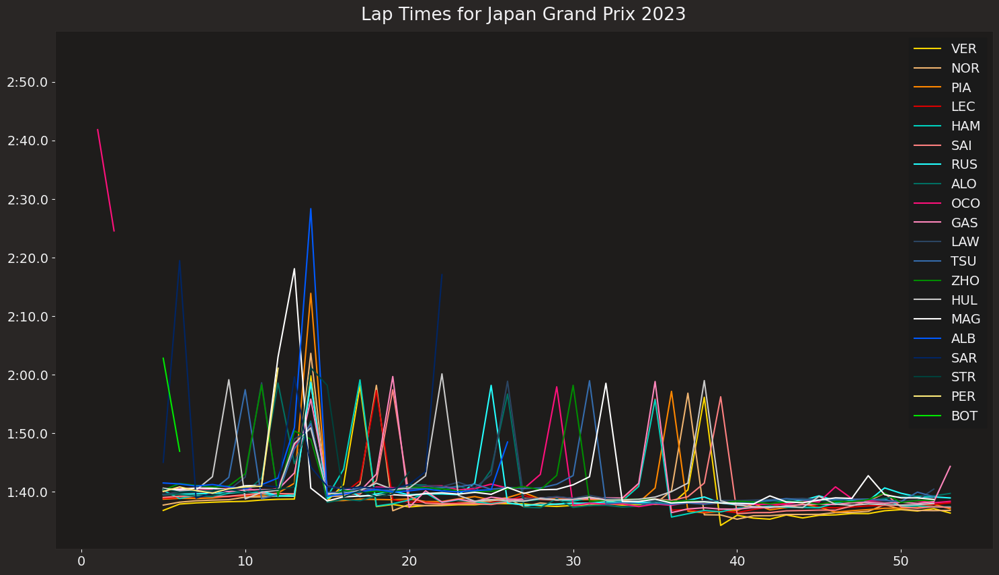

events      WARNING 	Correcting user input 'Qatar' to 'Qatar Grand Prix'
core           INFO 	Loading data for Qatar Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 55
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 55)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '4', '63', '16', '14', '31', '77', '24', '11', '18', '10', '23', '20', '22', '27', '40', '2', '44', '55']


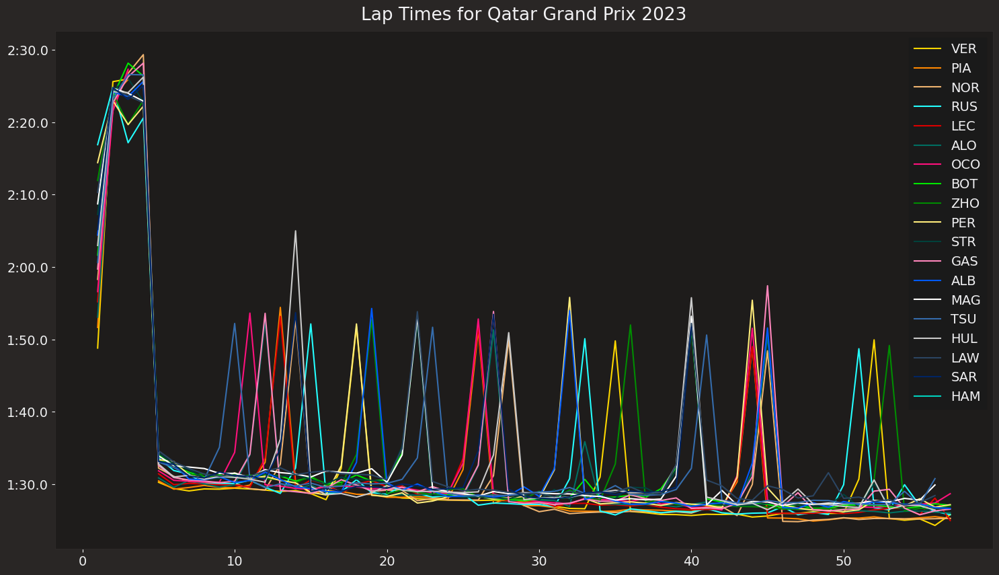

events      WARNING 	Correcting user input 'United States' to 'United States Grand Prix'
core           INFO 	Loading data for United States Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '55', '11', '63', '10', '18', '22', '23', '2', '27', '77', '24', '20', '3', '14', '81', '31', '44', '16']


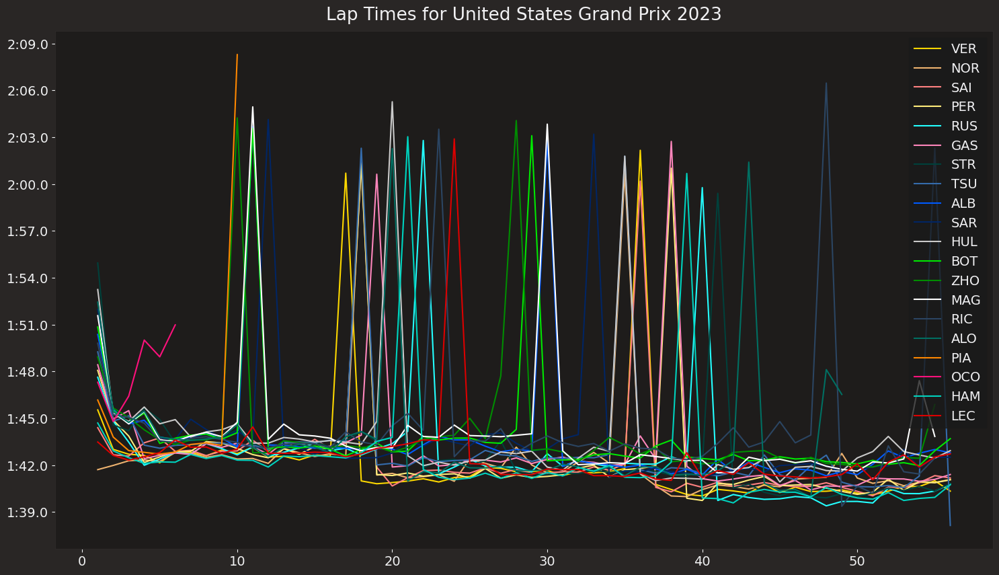

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '16', '55', '4', '63', '3', '81', '23', '31', '10', '22', '27', '24', '77', '2', '18', '14', '20', '11']


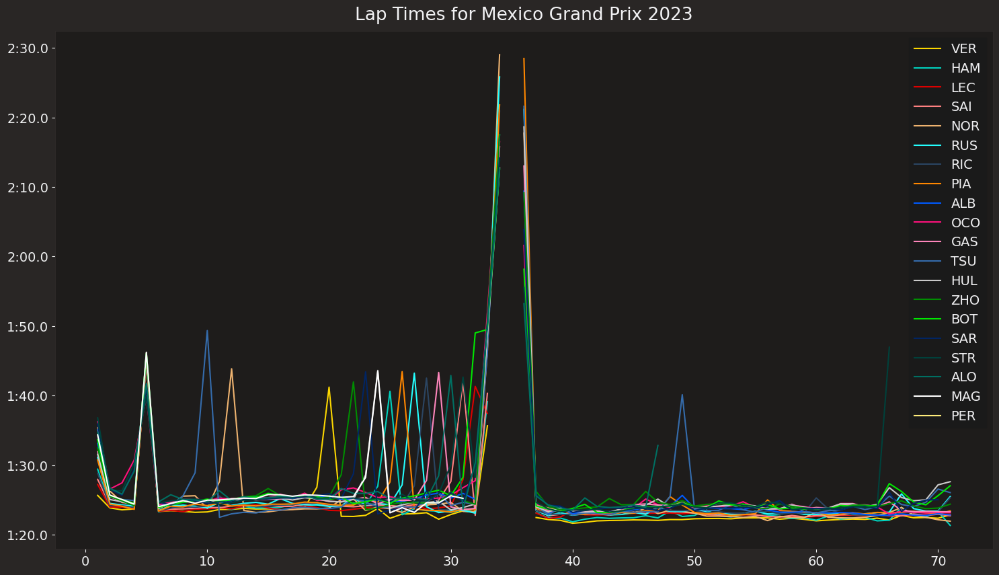

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '14', '11', '18', '55', '10', '44', '22', '31', '2', '27', '3', '81', '63', '77', '24', '20', '23', '16']


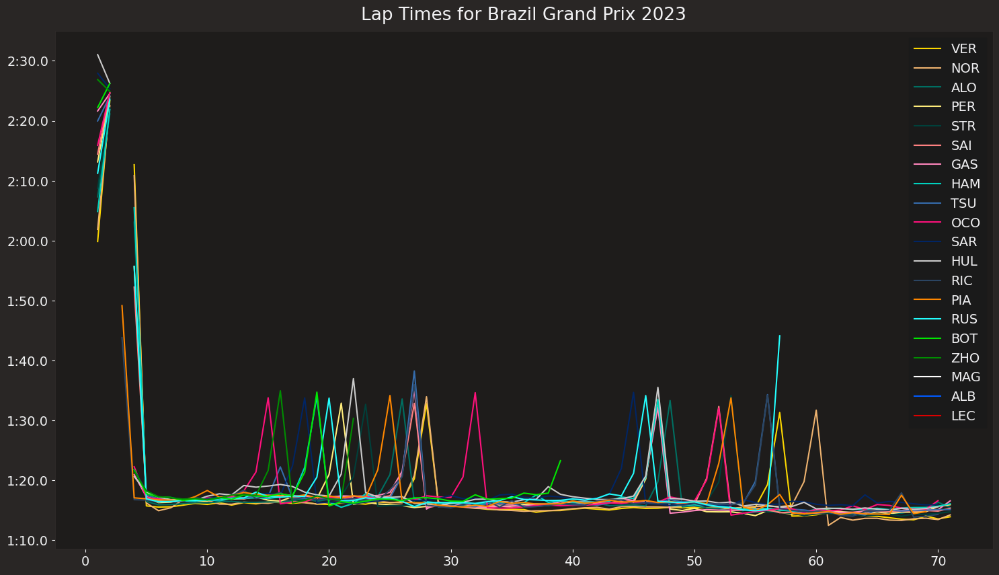

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '31', '18', '55', '44', '63', '14', '81', '10', '23', '20', '3', '24', '2', '77', '22', '27', '4']


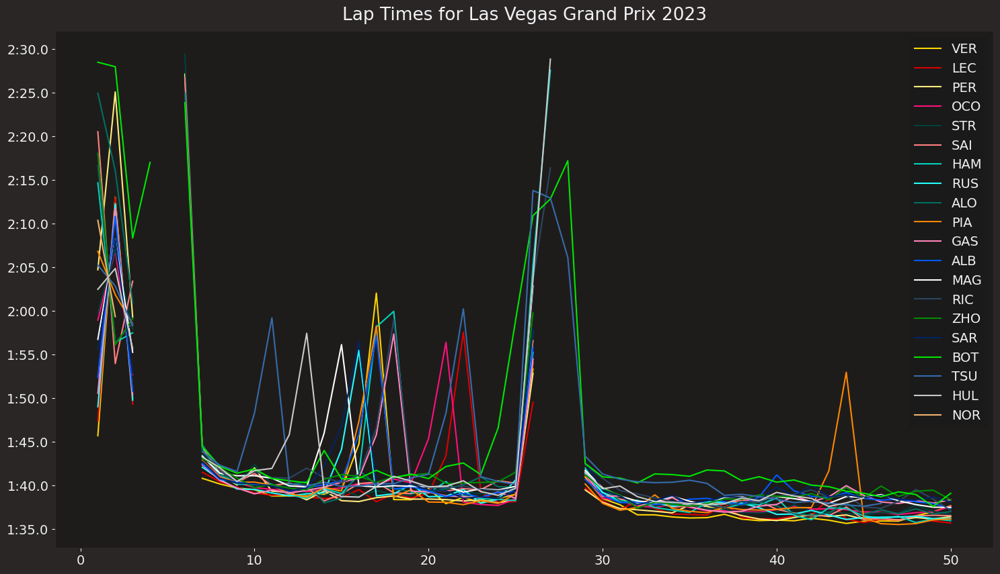

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


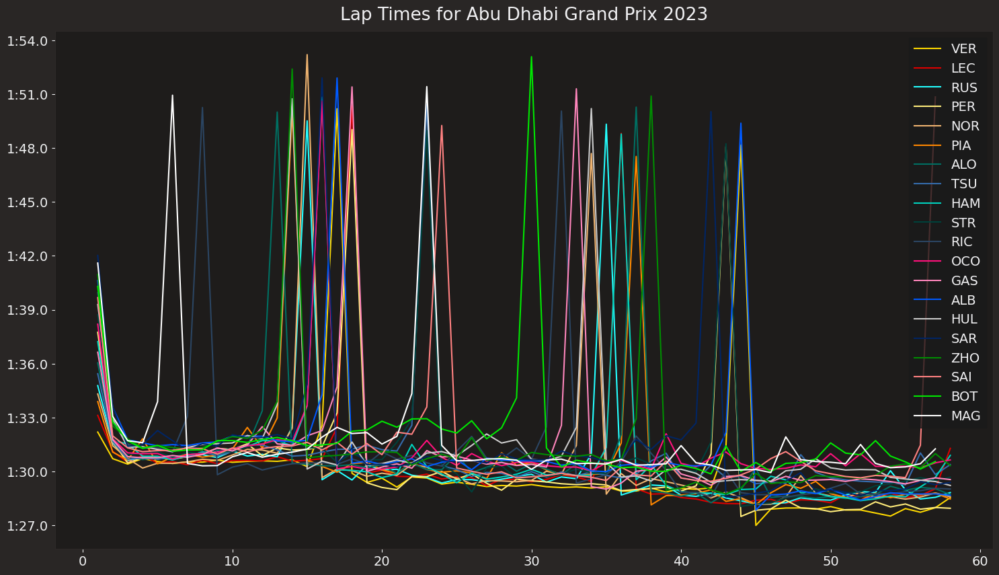

In [93]:
import fastf1.plotting
import matplotlib.pyplot as plt

# Setup matplotlib plotting
fastf1.plotting.setup_mpl(misc_mpl_mods=False)

# Your unique list of track names
track_names = ['Bahrain', 'Saudi Arabia', 'Australia', 'Azerbaijan', 'Miami', 'Monaco', 
               'Spain', 'Canada', 'Austria', 'Great Britain', 'Hungary', 'Belgium', 
               'Netherlands', 'Italy', 'Singapore', 'Japan', 'Qatar', 'United States', 
               'Mexico', 'Brazil', 'Las Vegas', 'Abu Dhabi']

# Loop through each track in the track_names list
for track in track_names:
    
    # Load the race session for each track
    session = fastf1.get_session(2023, track, 'R')
    session.load(telemetry=False, weather=False)
    
    # Create a new figure for each race
    fig, ax = plt.subplots(figsize=(18, 10))
    
    for drv in session.drivers:
        drv_laps = session.laps.pick_driver(drv)
        
        # Check if drv_laps is not empty
        if not drv_laps.empty:
            # Get driver abbreviation and color
            abb = drv_laps['Driver'].iloc[0]
            color = fastf1.plotting.driver_color(abb)
            
            # Plot lap times throughout the race
            ax.plot(drv_laps['LapNumber'], drv_laps['LapTime'], label=abb, color=color)
    
    
    plt.legend()
    plt.title(f'Lap Times for {track} Grand Prix 2023')
    
    # Display the plot
    plt.show()


These lap time plots look very confusing as they are 20 drivers' lap times 
For now, lets just plot the Top 3 Drivers' Laptimes throughout the season to get a better understanding of these drivers' performance 

In [94]:
drivers_points

,Driver,Points
0,Max Verstappen,530
1,Sergio Perez,260
2,Lewis Hamilton,217
3,Fernando Alonso,198
4,Charles Leclerc,185
5,Lando Norris,184
6,Carlos Sainz,178
7,George Russell,157
8,Oscar Piastri,82
9,Lance Stroll,68


core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '55', '44', '18', '63', '77', '10', '23', '22', '2', '20', '21', '27', '24', '4', '31', '16', '81']


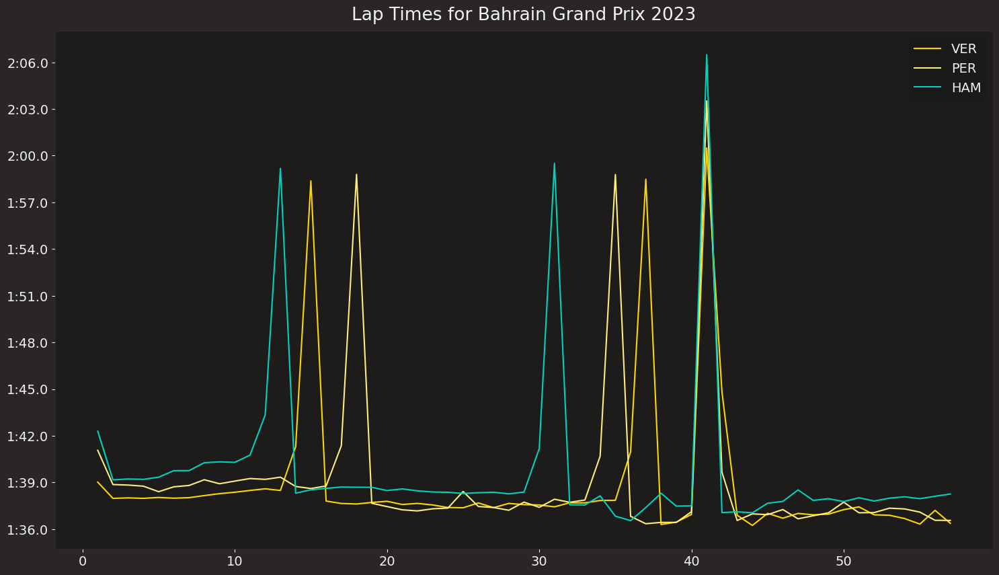

core           INFO 	Loading data for Saudi Arabian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '14', '63', '44', '55', '16', '31', '10', '20', '22', '27', '24', '21', '81', '2', '4', '77', '23', '18']


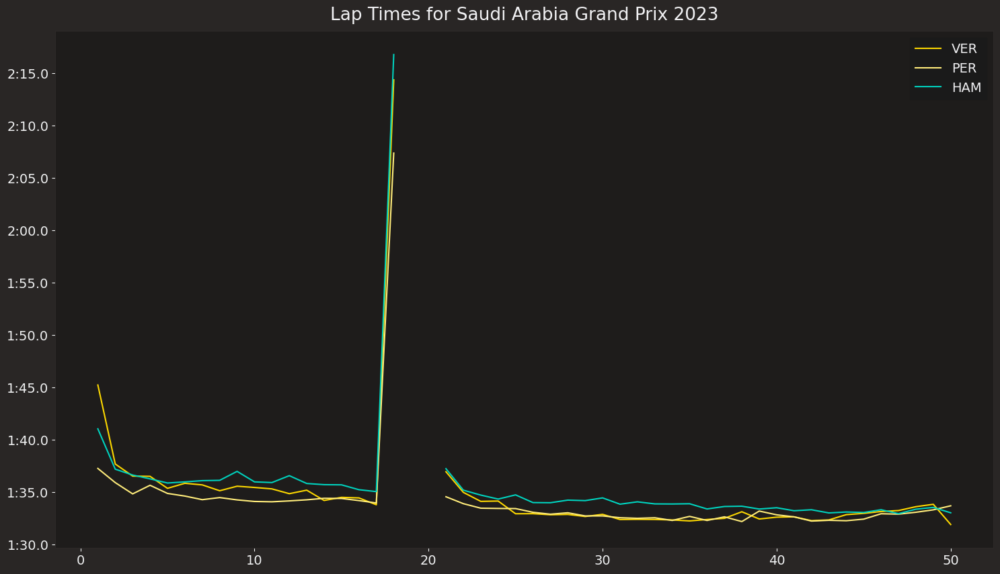

core           INFO 	Loading data for Australian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '14', '18', '11', '4', '27', '81', '24', '22', '77', '55', '10', '31', '21', '2', '20', '63', '23', '16']


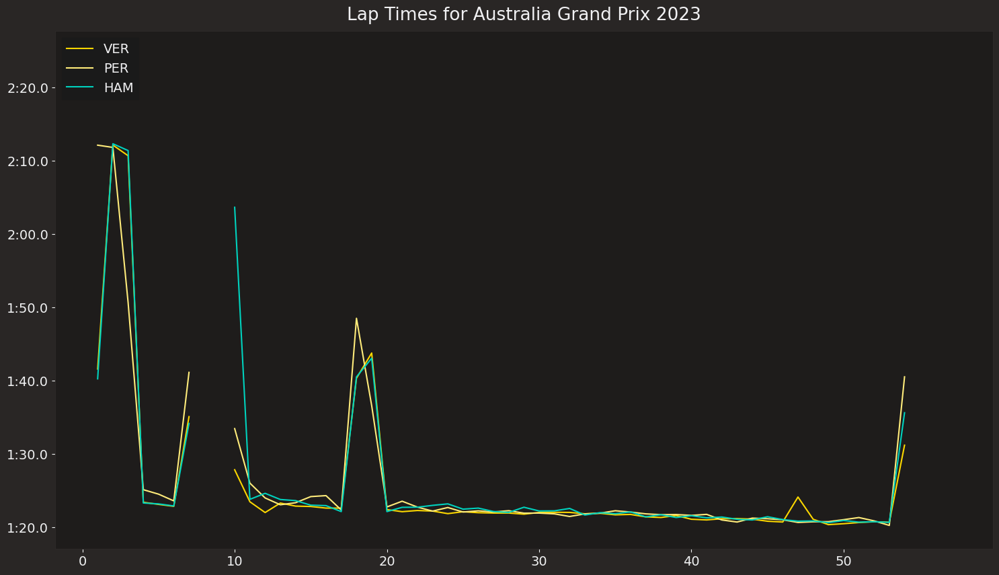

core           INFO 	Loading data for Azerbaijan Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '16', '14', '55', '44', '18', '63', '4', '22', '81', '23', '20', '10', '31', '2', '27', '77', '24', '21']


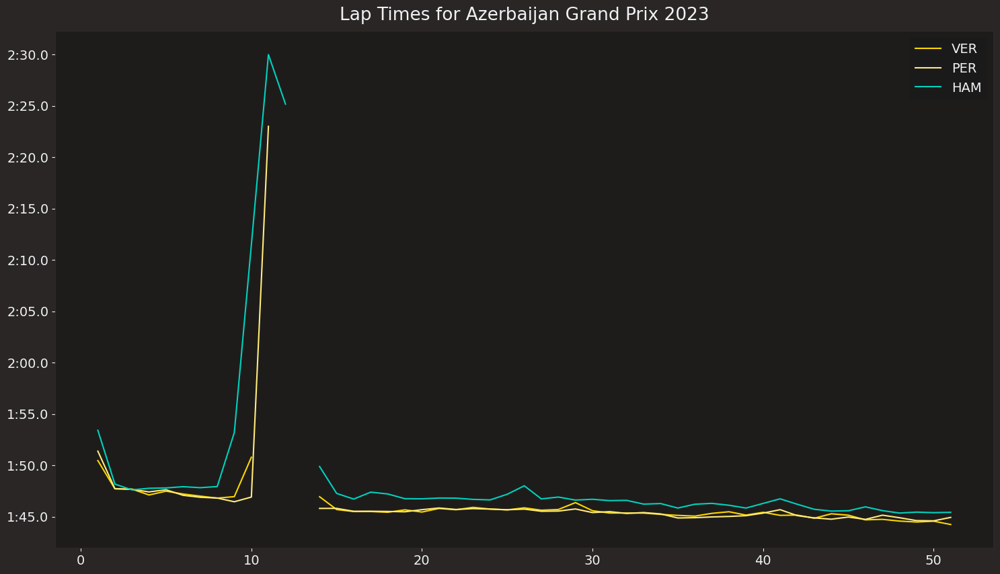

core           INFO 	Loading data for Miami Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '63', '55', '44', '16', '10', '31', '20', '22', '18', '77', '23', '27', '24', '4', '21', '81', '2']


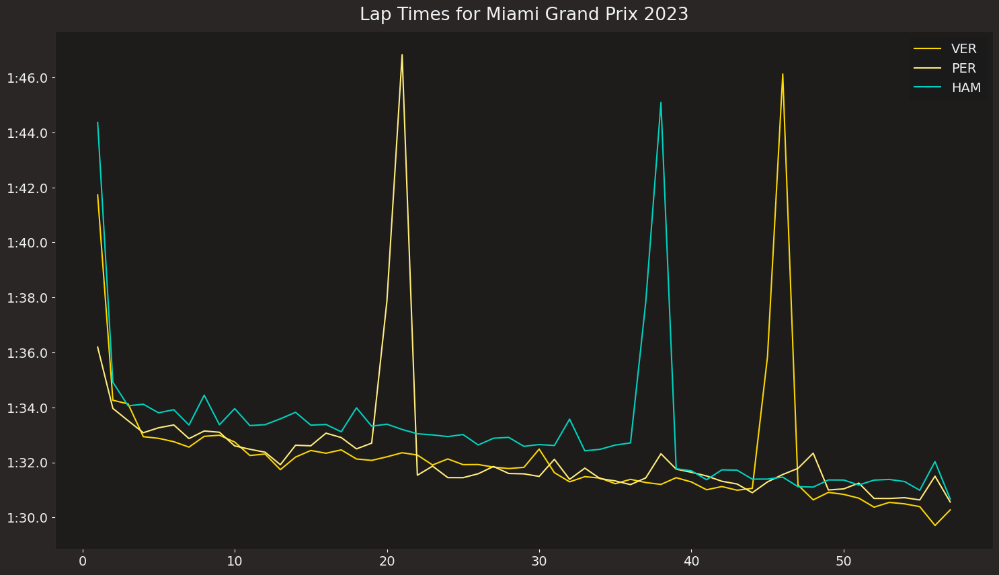

core           INFO 	Loading data for Monaco Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '31', '44', '63', '16', '10', '55', '4', '81', '77', '21', '24', '23', '22', '11', '27', '2', '20', '18']


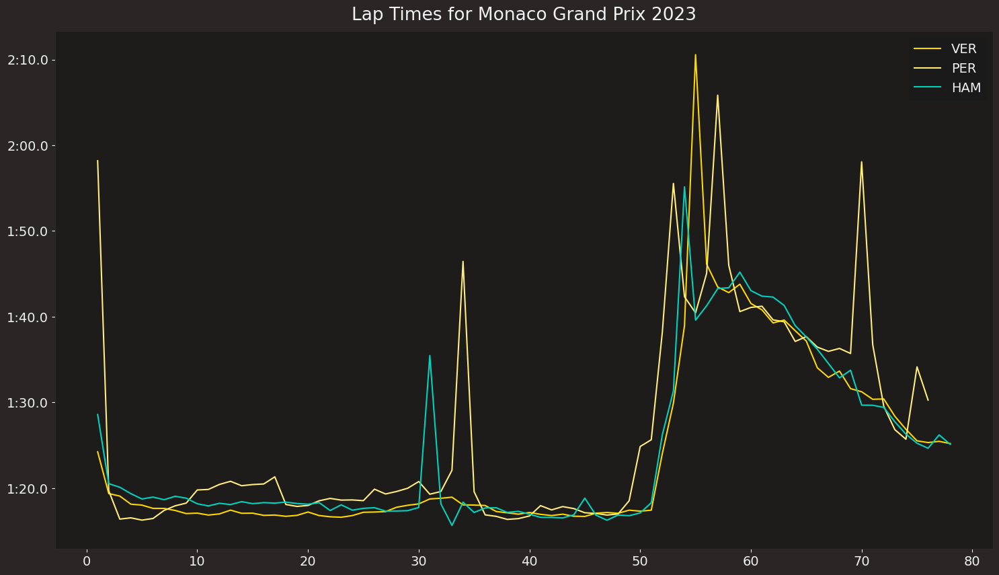

core           INFO 	Loading data for Spanish Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '63', '11', '55', '18', '14', '31', '24', '10', '16', '22', '81', '21', '27', '23', '4', '20', '77', '2']


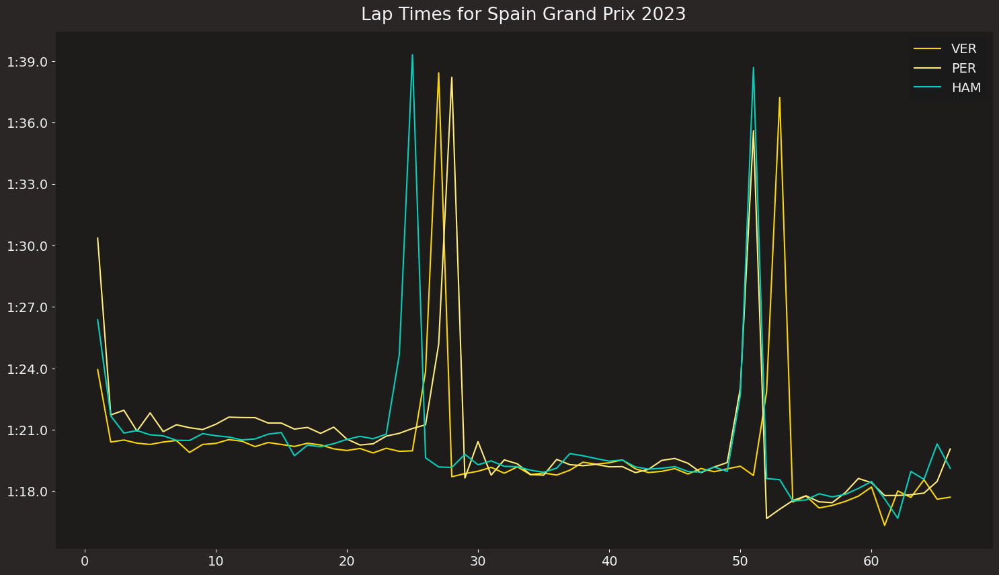

core           INFO 	Loading data for Canadian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '44', '16', '55', '11', '23', '31', '18', '77', '81', '10', '4', '22', '27', '24', '20', '21', '63', '2']


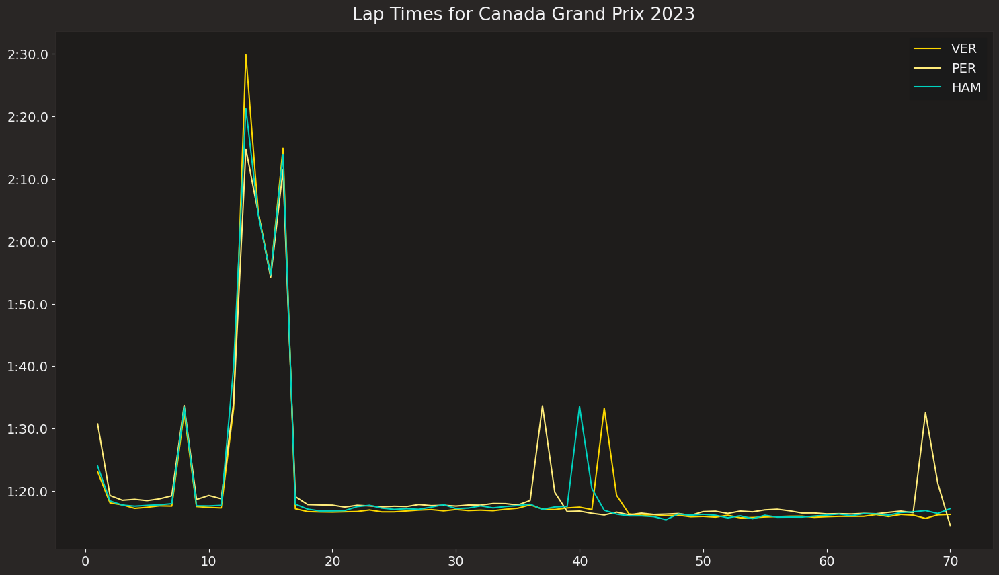

core           INFO 	Loading data for Austrian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '4', '14', '55', '63', '44', '18', '10', '23', '24', '2', '31', '77', '81', '21', '20', '22', '27']


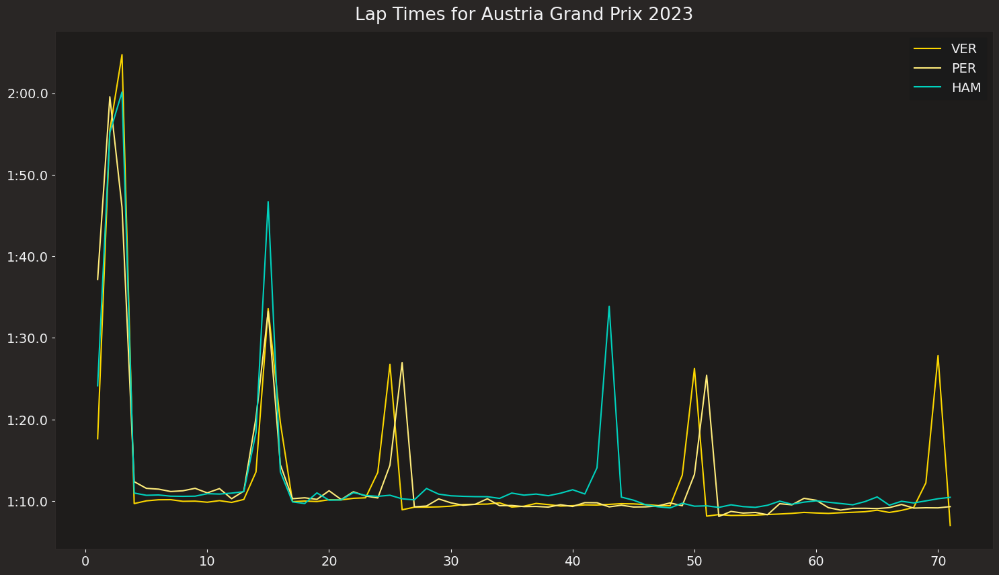

core           INFO 	Loading data for British Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '44', '81', '63', '11', '14', '23', '16', '55', '2', '77', '27', '18', '24', '22', '21', '10', '20', '31']


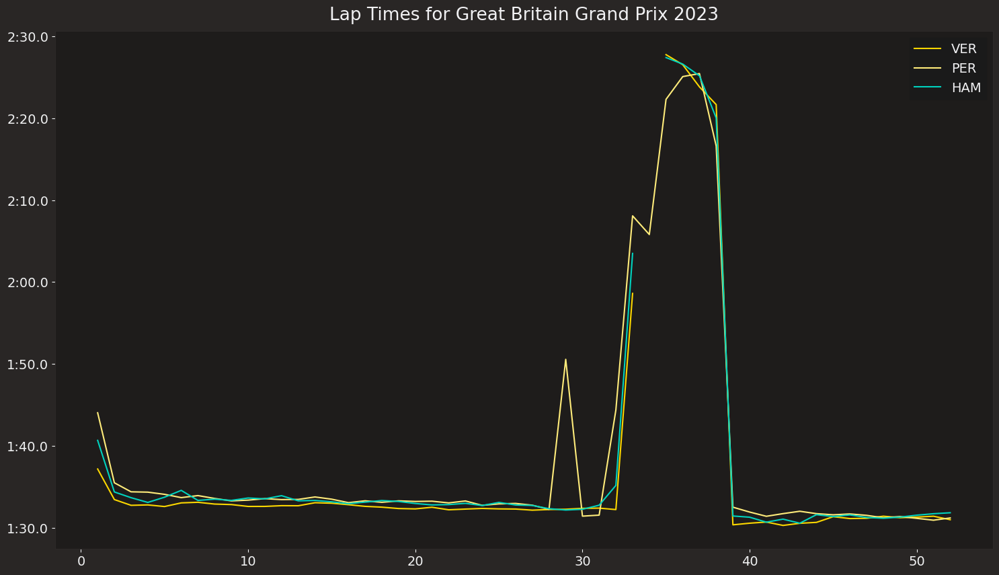

core           INFO 	Loading data for Hungarian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '11', '44', '81', '63', '16', '55', '14', '18', '23', '77', '3', '27', '22', '24', '20', '2', '31', '10']


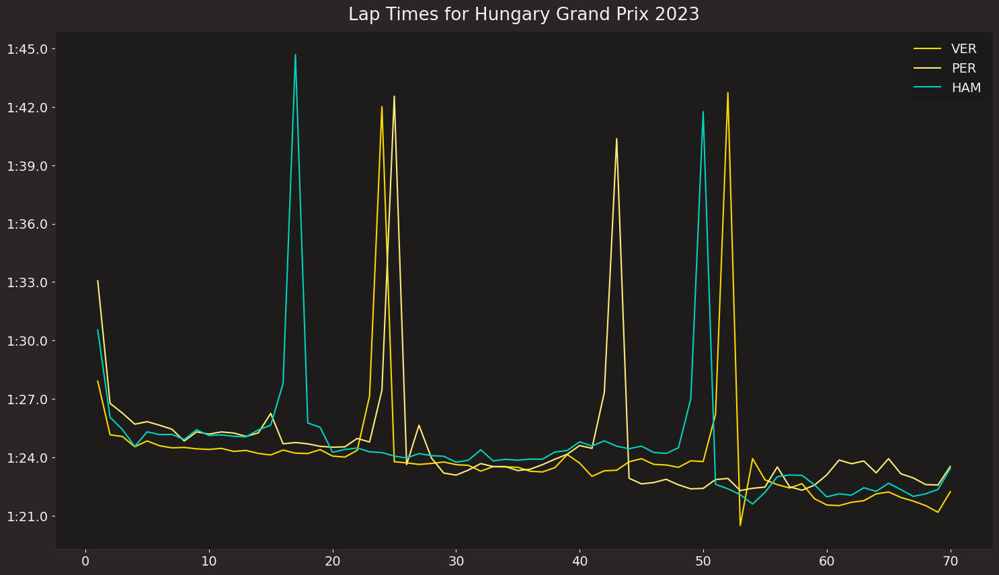

core           INFO 	Loading data for Belgian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '16', '44', '14', '63', '4', '31', '18', '22', '10', '77', '24', '23', '20', '3', '2', '27', '55', '81']


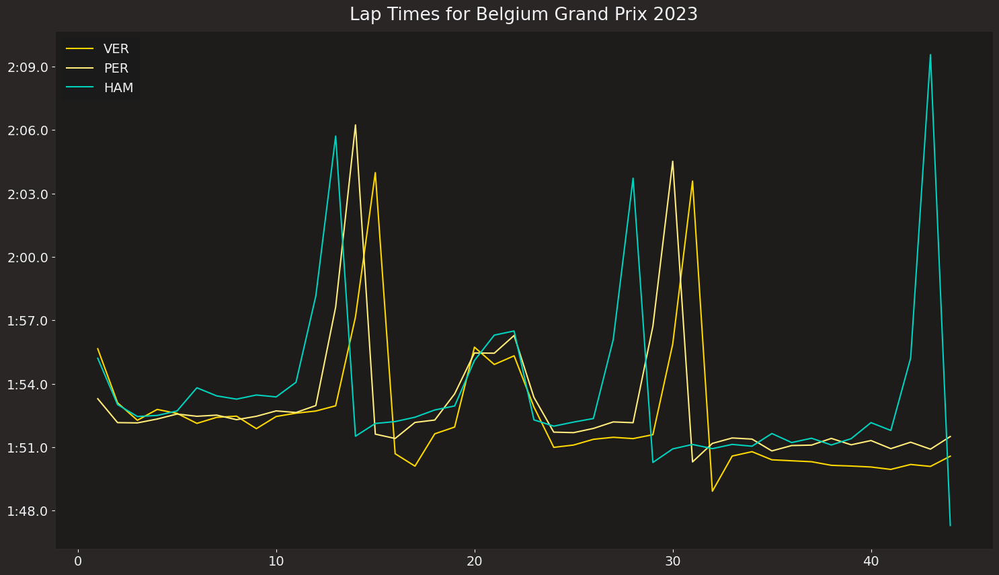

core           INFO 	Loading data for Dutch Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '10', '11', '55', '44', '4', '23', '81', '31', '18', '27', '40', '77', '22', '20', '63', '24', '16', '2']


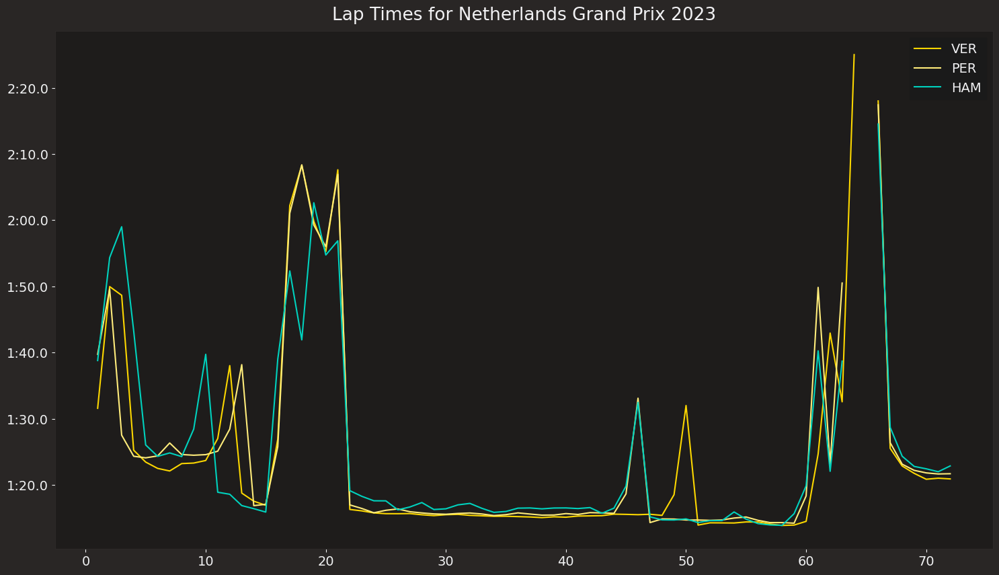

core           INFO 	Loading data for Italian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '55', '16', '63', '44', '23', '4', '14', '77', '40', '81', '2', '24', '10', '18', '27', '20', '31', '22']


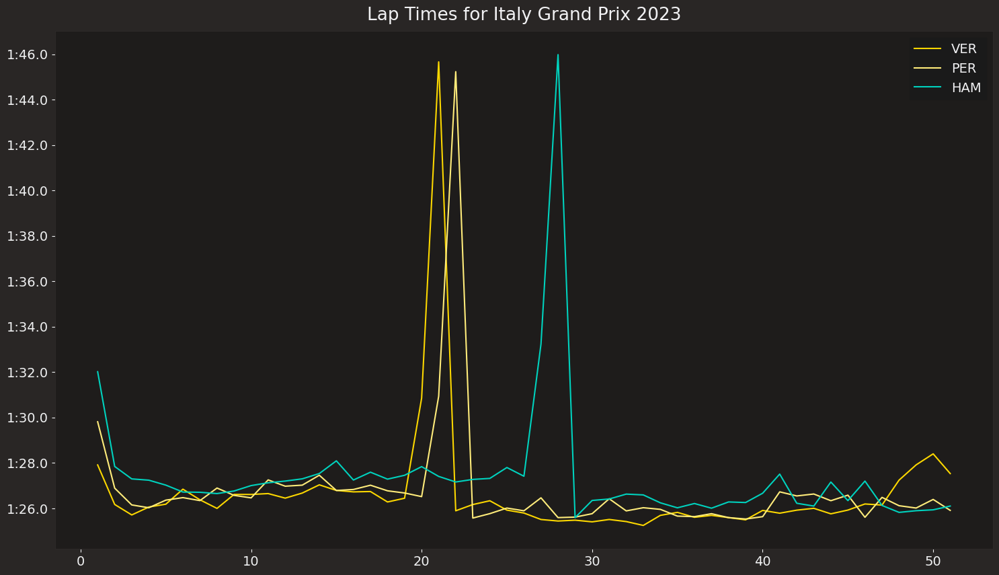

core           INFO 	Loading data for Singapore Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 18
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 18)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['55', '4', '44', '16', '1', '10', '81', '11', '40', '20', '23', '24', '27', '2', '14', '63', '77', '31', '22', '18']


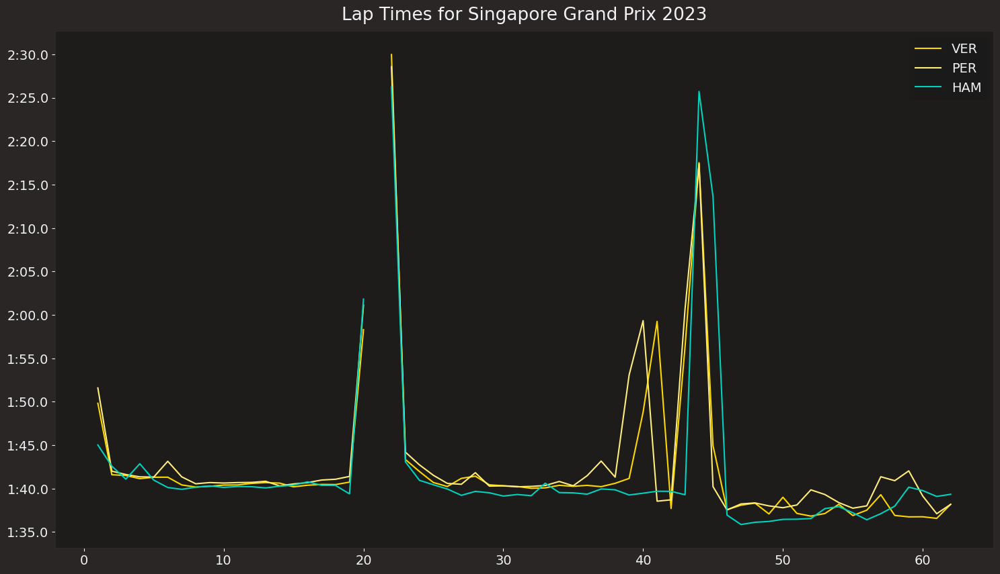

core           INFO 	Loading data for Japanese Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '81', '16', '44', '55', '63', '14', '31', '10', '40', '22', '24', '27', '20', '23', '2', '18', '11', '77']


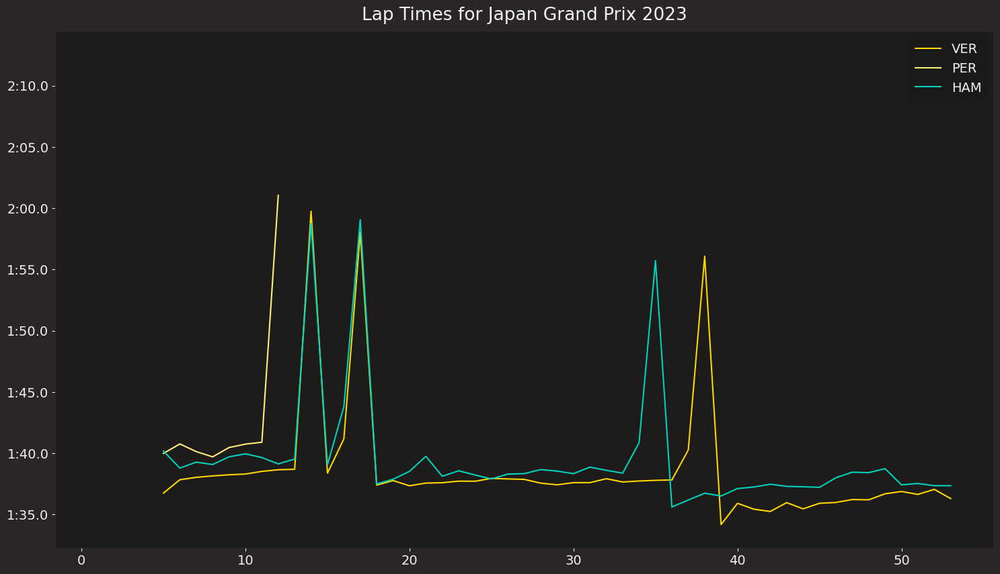

events      WARNING 	Correcting user input 'Qatar' to 'Qatar Grand Prix'
core           INFO 	Loading data for Qatar Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 55
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 55)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '4', '63', '16', '14', '31', '77', '24', '11', '18', '10', '23', '20', '22', '27', '40', '2', '44', '55']


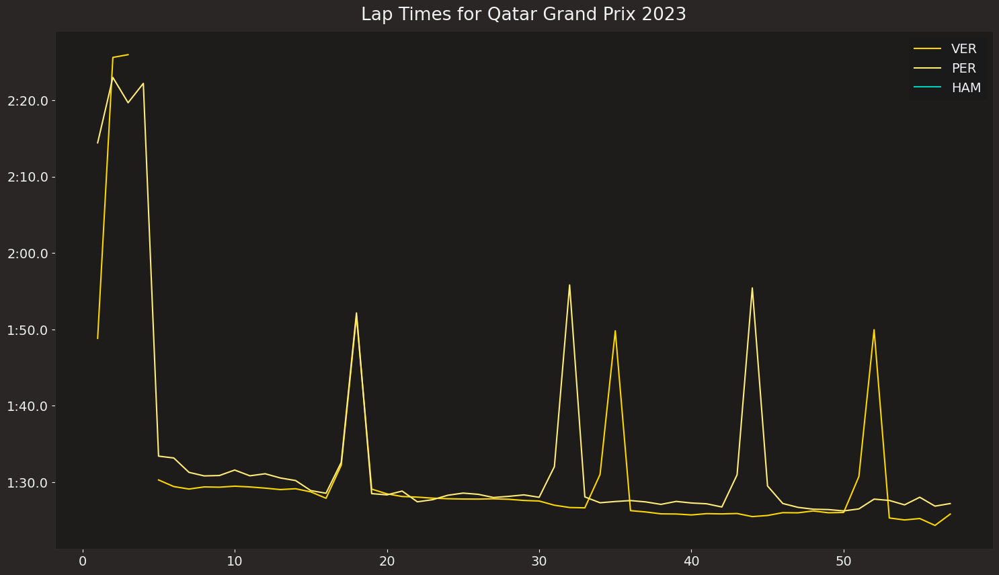

events      WARNING 	Correcting user input 'United States' to 'United States Grand Prix'
core           INFO 	Loading data for United States Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '55', '11', '63', '10', '18', '22', '23', '2', '27', '77', '24', '20', '3', '14', '81', '31', '44', '16']


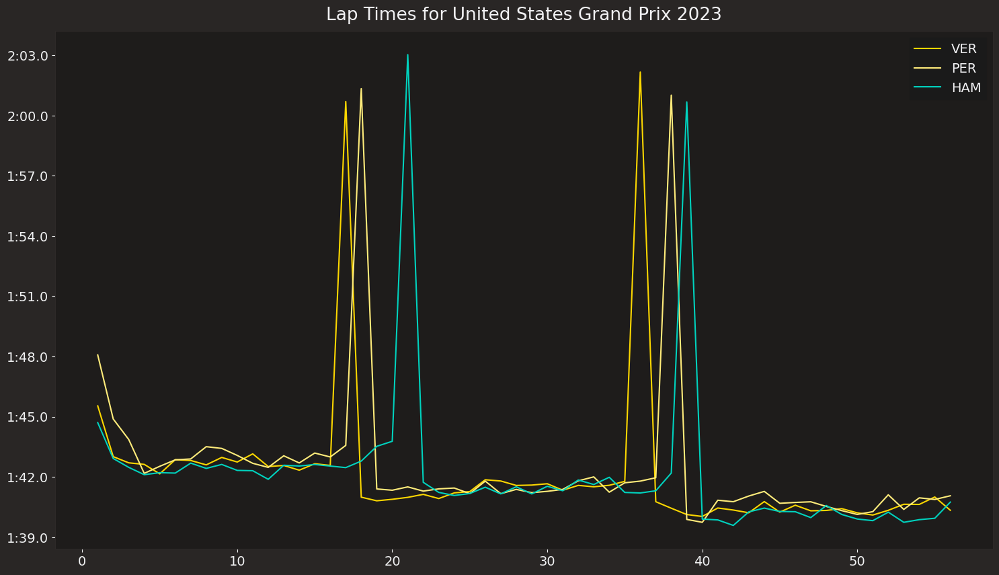

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '16', '55', '4', '63', '3', '81', '23', '31', '10', '22', '27', '24', '77', '2', '18', '14', '20', '11']


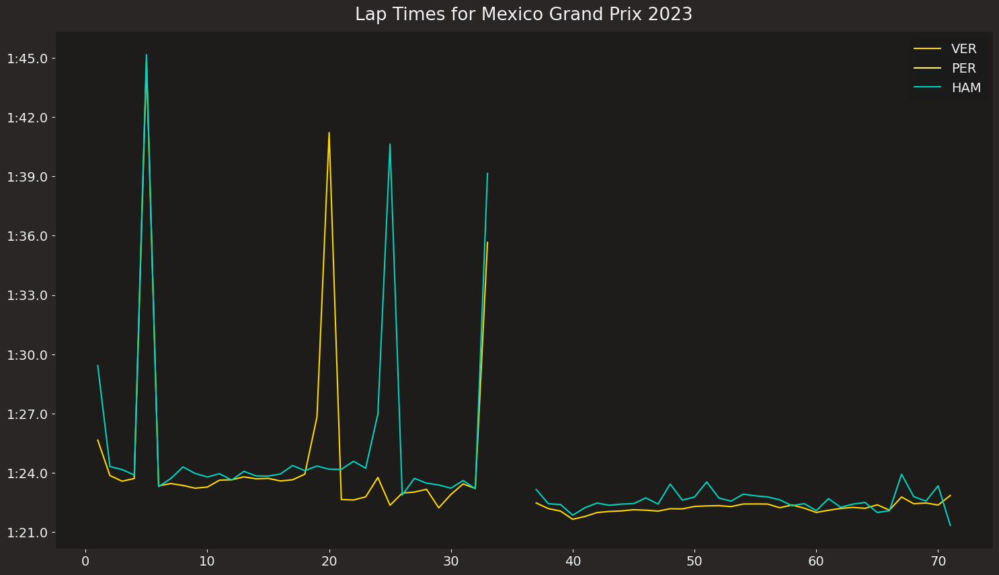

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '14', '11', '18', '55', '10', '44', '22', '31', '2', '27', '3', '81', '63', '77', '24', '20', '23', '16']


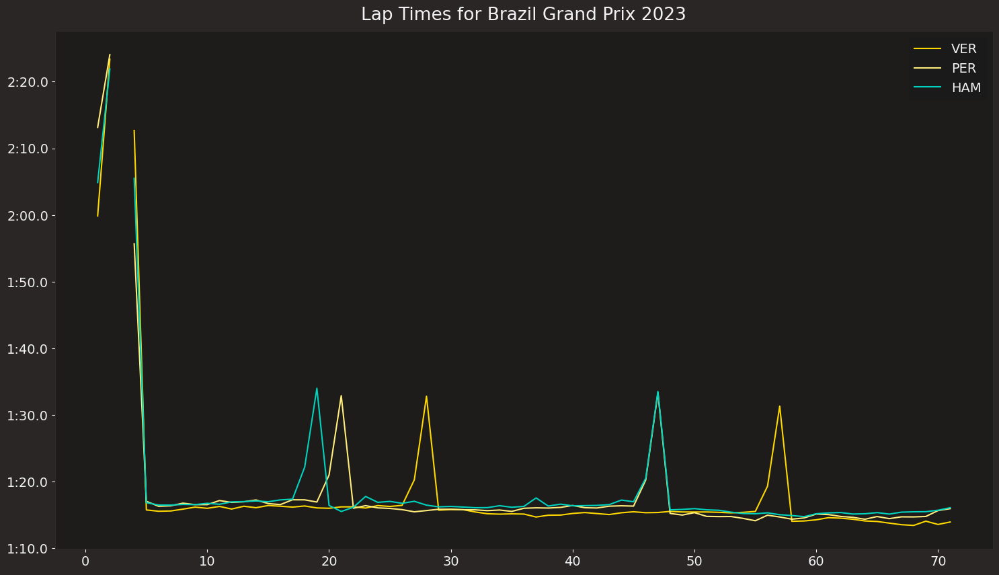

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '31', '18', '55', '44', '63', '14', '81', '10', '23', '20', '3', '24', '2', '77', '22', '27', '4']


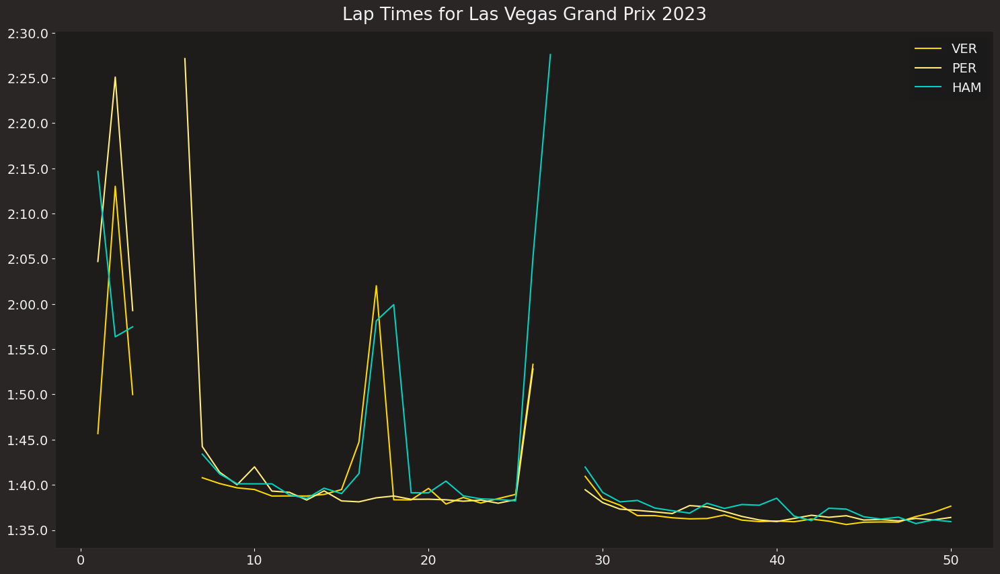

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


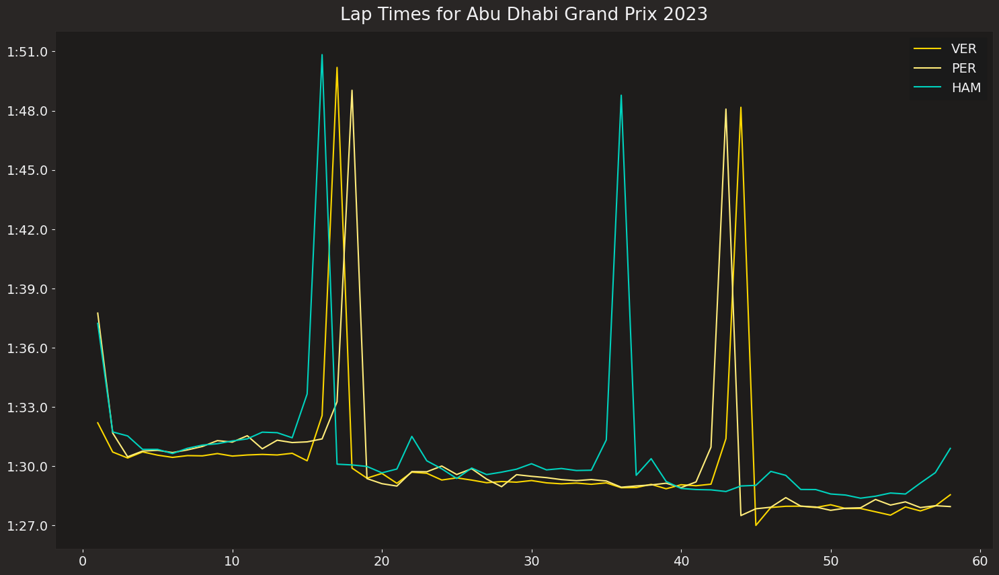

In [95]:
# Speed analysis of VER PER and HAM
# Loop through each track in the track_names list
for track in track_names:
    
    # Load the race session for each track
    session = fastf1.get_session(2023, track, 'R')
    session.load(telemetry=False, weather=False)
    
    # Create a new figure for each race
    fig, ax = plt.subplots(figsize=(18, 10))

    for drv in ['VER','PER','HAM']:
        
        drv_laps = session.laps.pick_driver(drv)
        
        # Check if drv_laps is not empty
        if not drv_laps.empty:
            # Get driver abbreviation and color
            abb = drv_laps['Driver'].iloc[0]
            color = fastf1.plotting.driver_color(abb)
            
            # Plot lap times throughout the race
            ax.plot(drv_laps['LapNumber'], drv_laps['LapTime'], label=abb, color=color)
    
    
    plt.legend()
    plt.title(f'Lap Times for {track} Grand Prix 2023')
    
    # Display the plot
    plt.show()


core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '55', '44', '18', '63', '77', '10', '23', '22', '2', '20', '21', '27', '24', '4', '31', '16', '81']


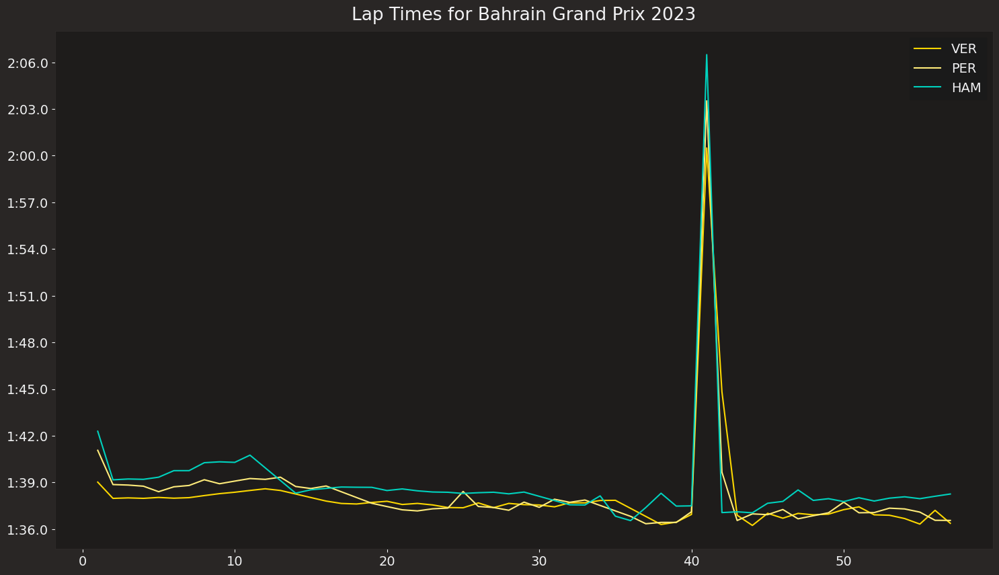

core           INFO 	Loading data for Saudi Arabian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '14', '63', '44', '55', '16', '31', '10', '20', '22', '27', '24', '21', '81', '2', '4', '77', '23', '18']


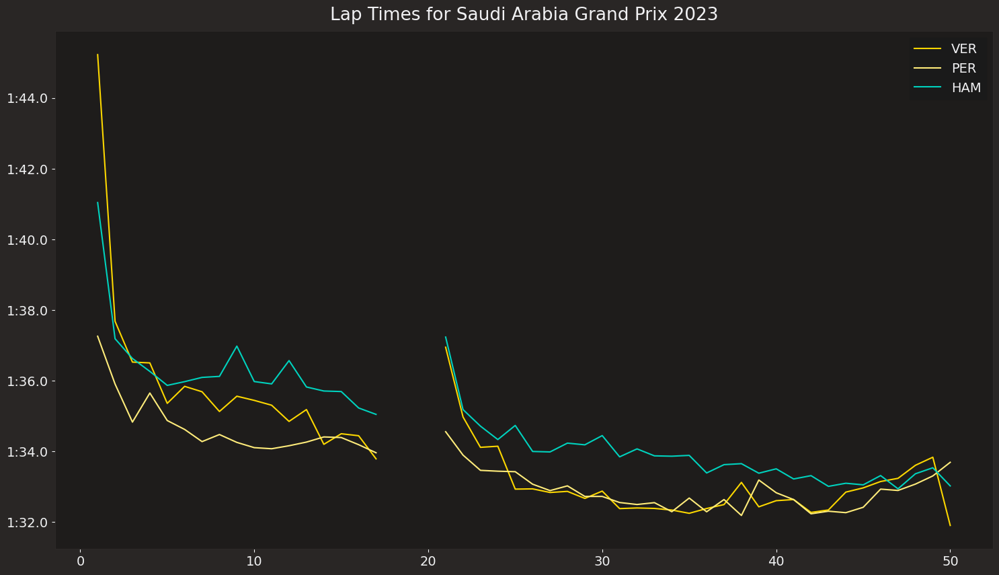

core           INFO 	Loading data for Australian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '14', '18', '11', '4', '27', '81', '24', '22', '77', '55', '10', '31', '21', '2', '20', '63', '23', '16']


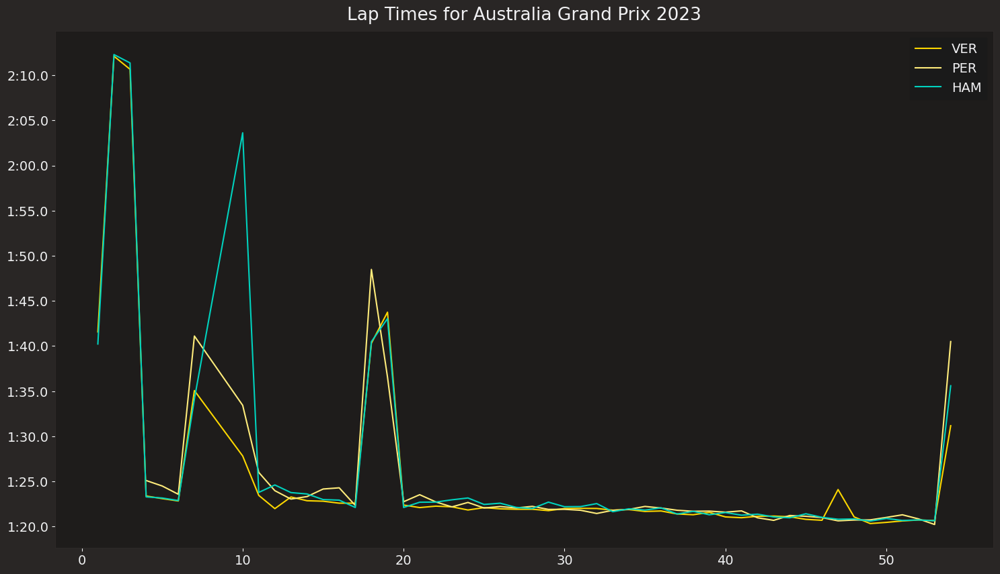

core           INFO 	Loading data for Azerbaijan Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '16', '14', '55', '44', '18', '63', '4', '22', '81', '23', '20', '10', '31', '2', '27', '77', '24', '21']


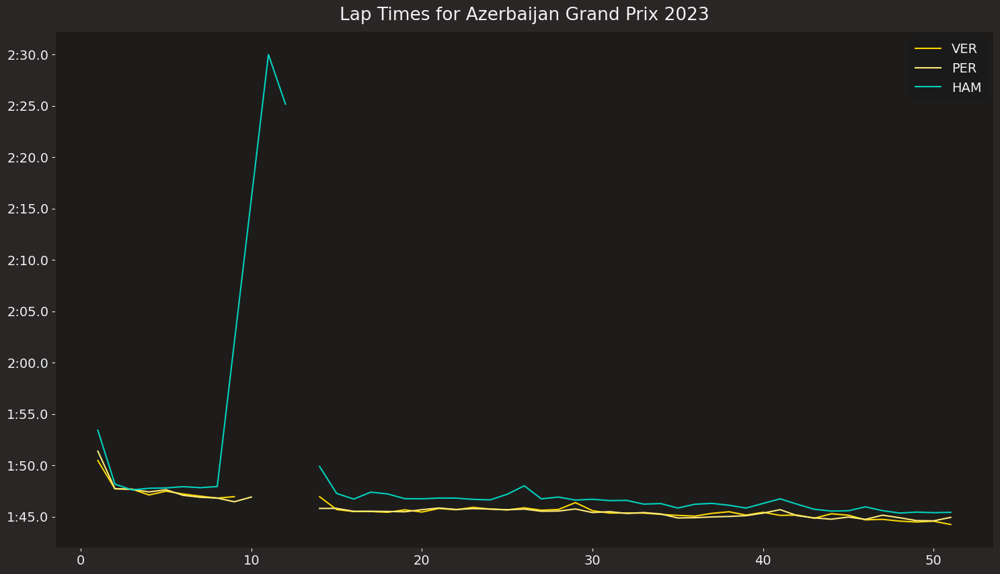

core           INFO 	Loading data for Miami Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '63', '55', '44', '16', '10', '31', '20', '22', '18', '77', '23', '27', '24', '4', '21', '81', '2']


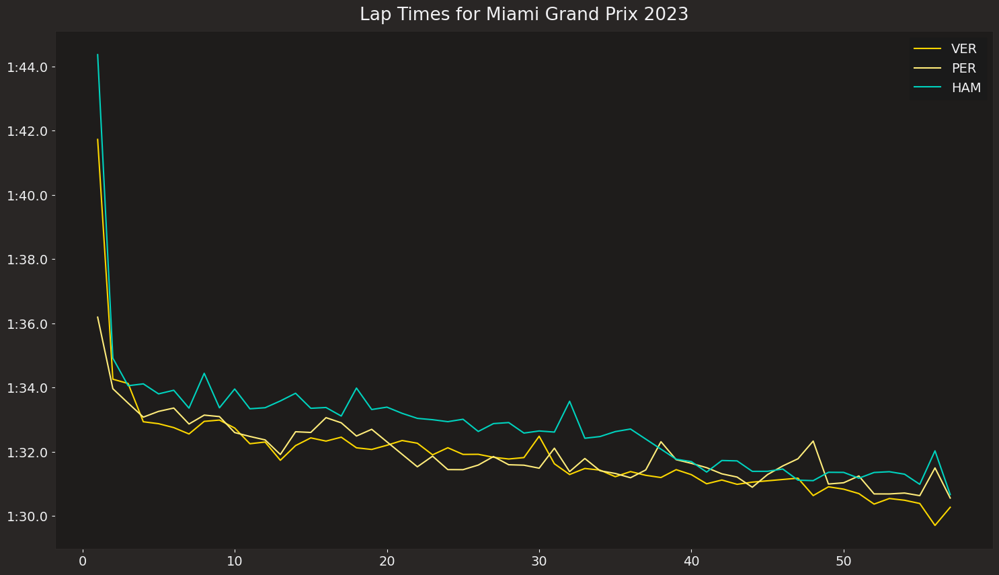

core           INFO 	Loading data for Monaco Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '31', '44', '63', '16', '10', '55', '4', '81', '77', '21', '24', '23', '22', '11', '27', '2', '20', '18']


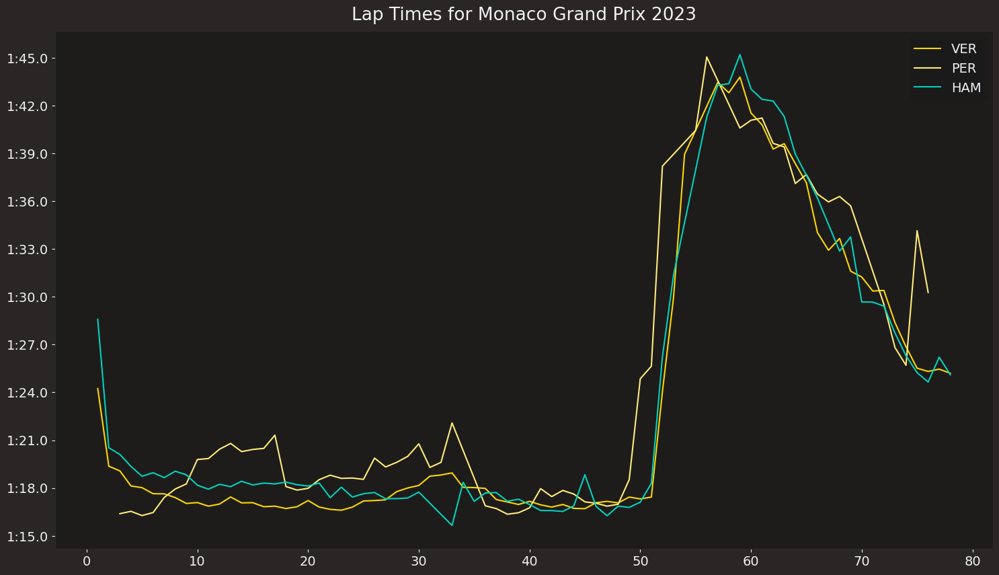

core           INFO 	Loading data for Spanish Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '63', '11', '55', '18', '14', '31', '24', '10', '16', '22', '81', '21', '27', '23', '4', '20', '77', '2']


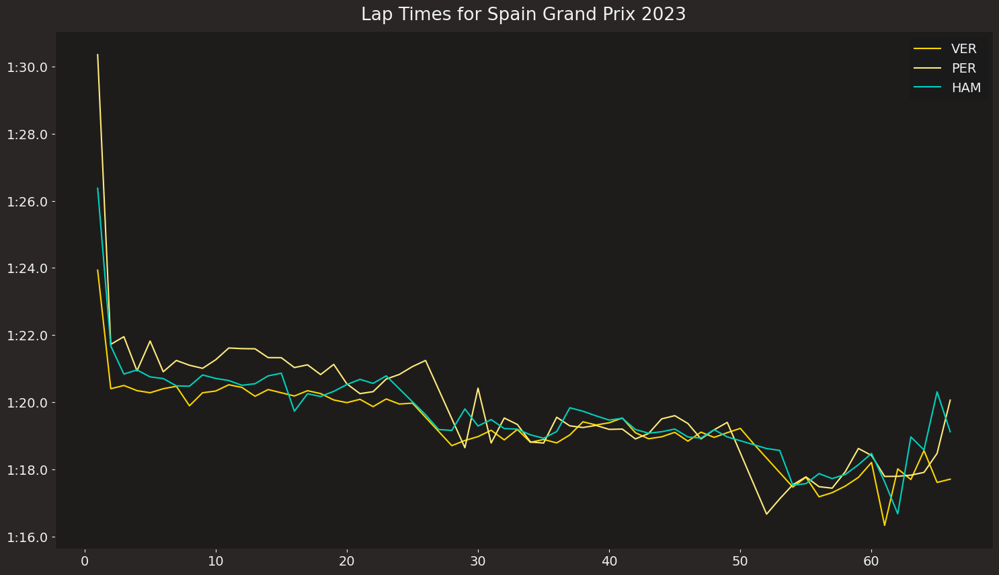

core           INFO 	Loading data for Canadian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '44', '16', '55', '11', '23', '31', '18', '77', '81', '10', '4', '22', '27', '24', '20', '21', '63', '2']


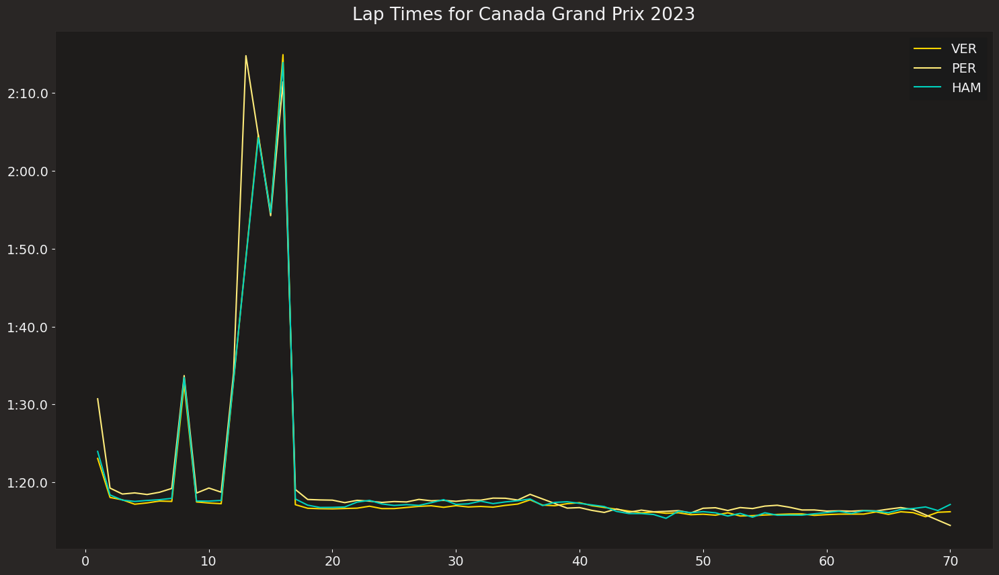

core           INFO 	Loading data for Austrian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '4', '14', '55', '63', '44', '18', '10', '23', '24', '2', '31', '77', '81', '21', '20', '22', '27']


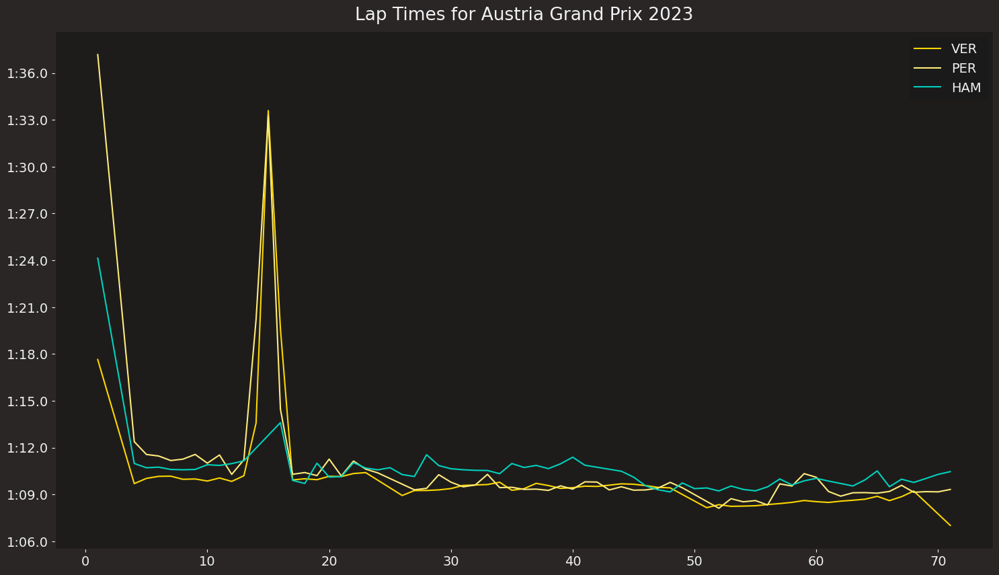

core           INFO 	Loading data for British Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '44', '81', '63', '11', '14', '23', '16', '55', '2', '77', '27', '18', '24', '22', '21', '10', '20', '31']


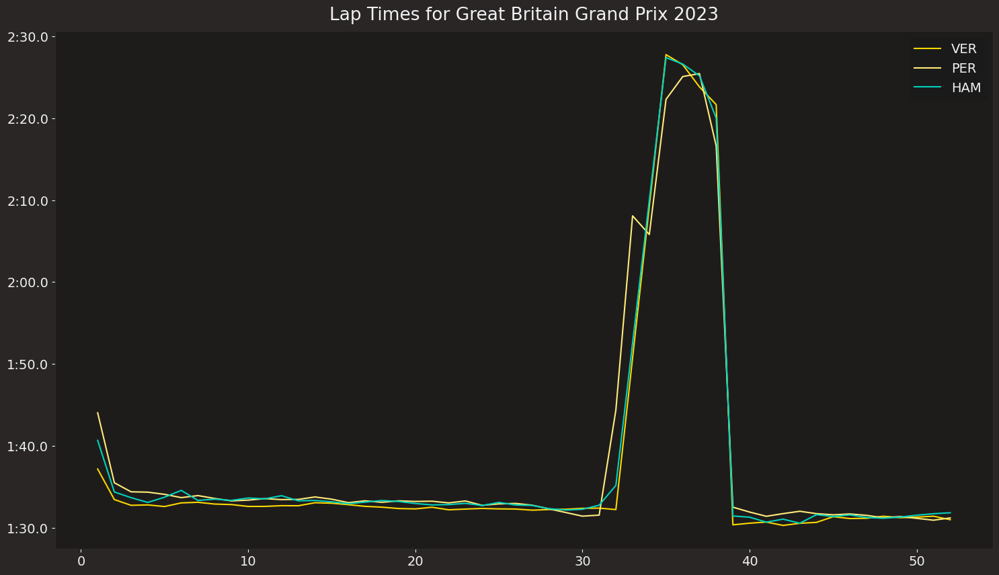

core           INFO 	Loading data for Hungarian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '11', '44', '81', '63', '16', '55', '14', '18', '23', '77', '3', '27', '22', '24', '20', '2', '31', '10']


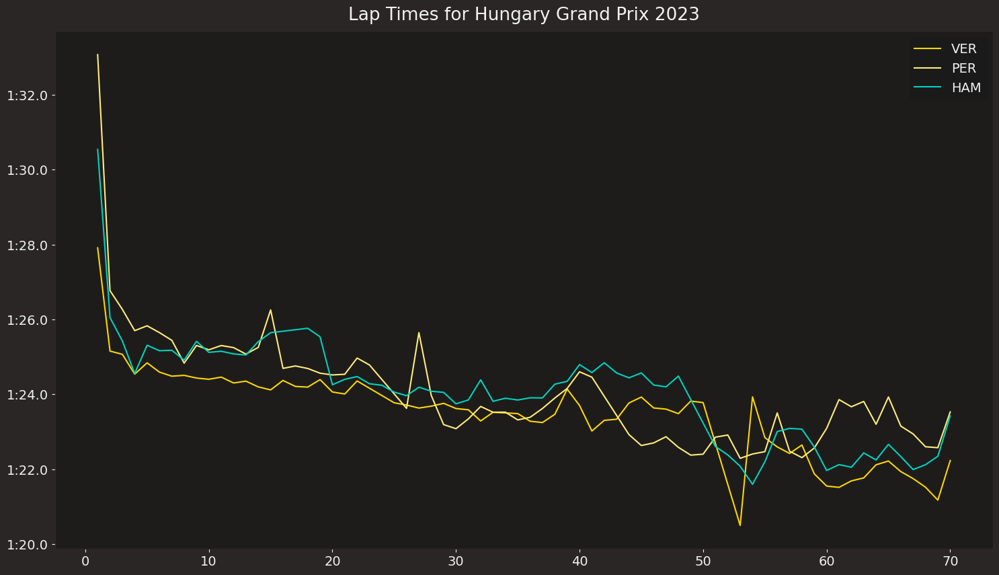

core           INFO 	Loading data for Belgian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '16', '44', '14', '63', '4', '31', '18', '22', '10', '77', '24', '23', '20', '3', '2', '27', '55', '81']


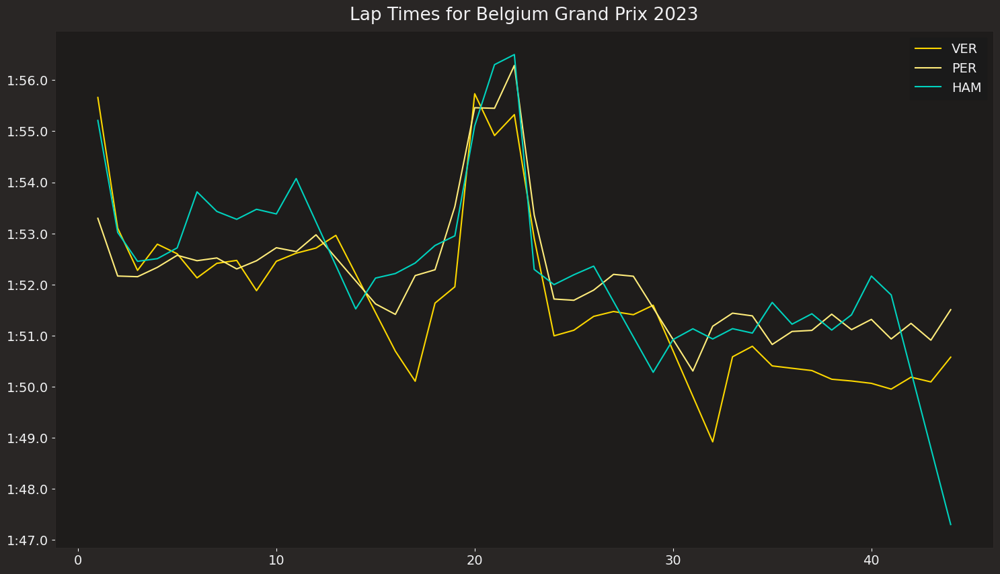

core           INFO 	Loading data for Dutch Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '10', '11', '55', '44', '4', '23', '81', '31', '18', '27', '40', '77', '22', '20', '63', '24', '16', '2']


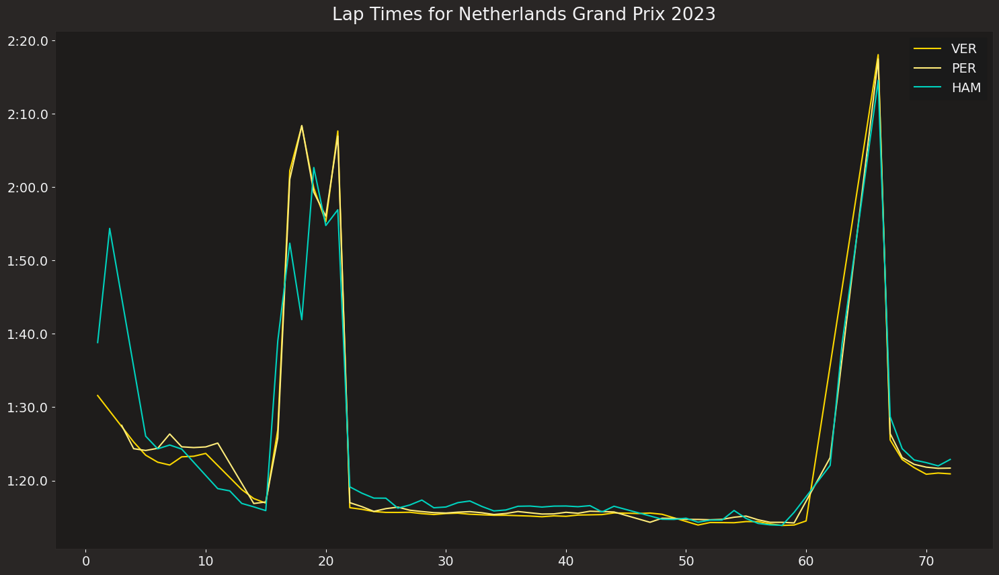

core           INFO 	Loading data for Italian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '55', '16', '63', '44', '23', '4', '14', '77', '40', '81', '2', '24', '10', '18', '27', '20', '31', '22']


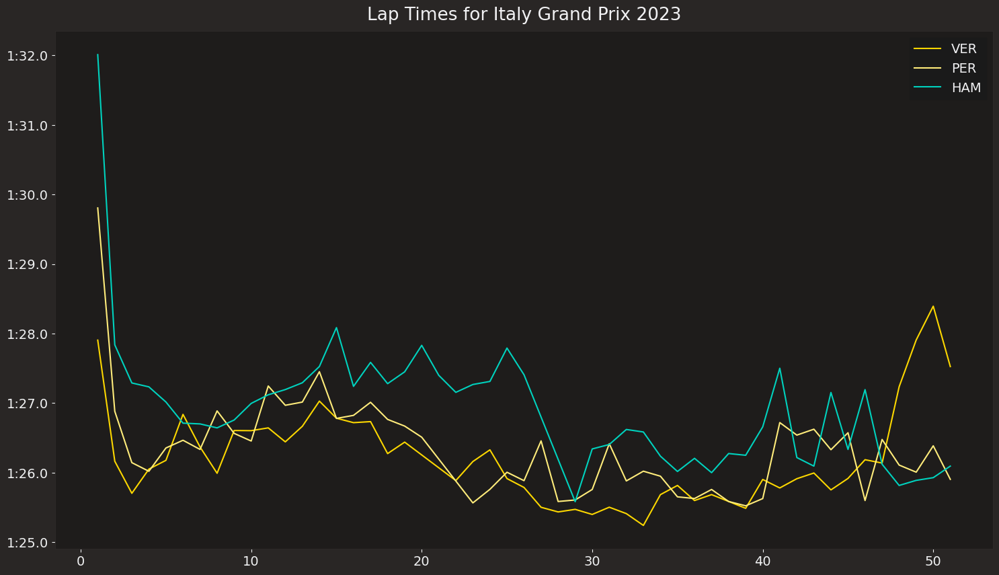

core           INFO 	Loading data for Singapore Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 18
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 18)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['55', '4', '44', '16', '1', '10', '81', '11', '40', '20', '23', '24', '27', '2', '14', '63', '77', '31', '22', '18']


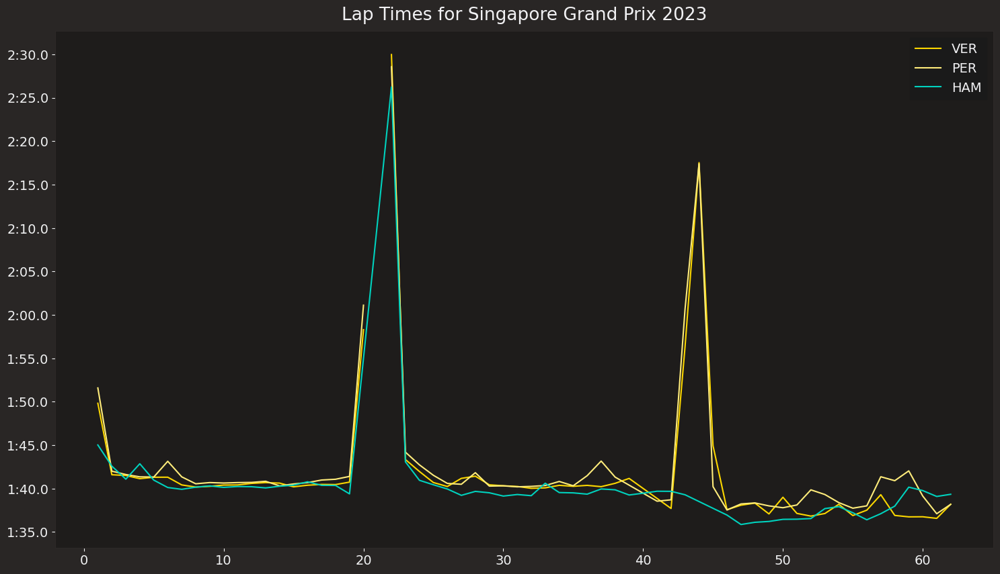

core           INFO 	Loading data for Japanese Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '81', '16', '44', '55', '63', '14', '31', '10', '40', '22', '24', '27', '20', '23', '2', '18', '11', '77']


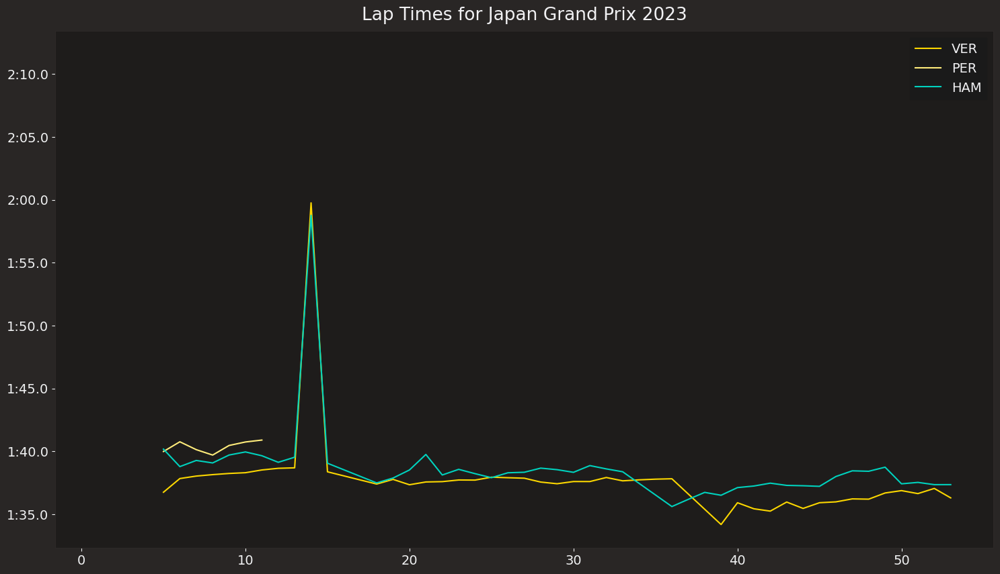

events      WARNING 	Correcting user input 'Qatar' to 'Qatar Grand Prix'
core           INFO 	Loading data for Qatar Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 55
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 55)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '4', '63', '16', '14', '31', '77', '24', '11', '18', '10', '23', '20', '22', '27', '40', '2', '44', '55']


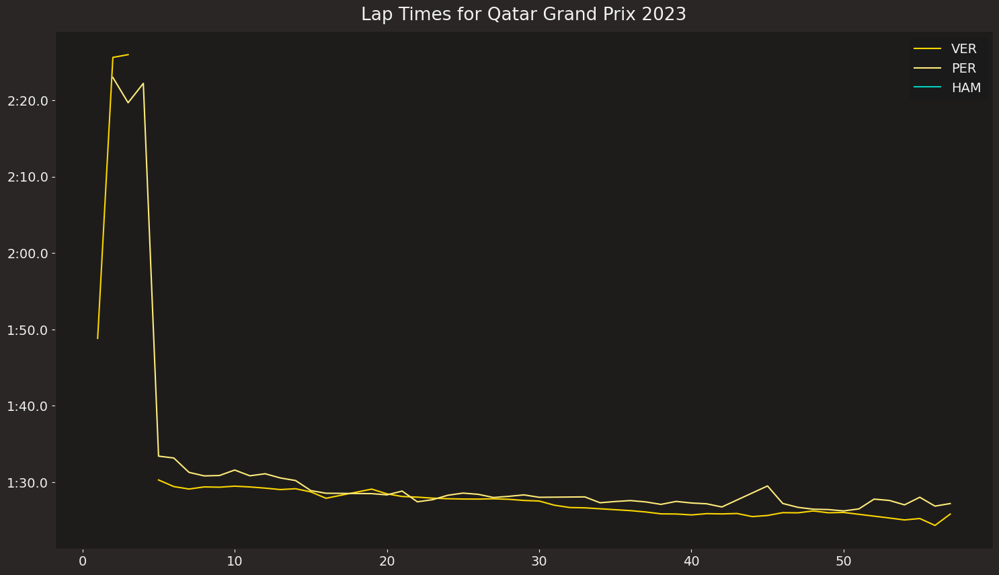

events      WARNING 	Correcting user input 'United States' to 'United States Grand Prix'
core           INFO 	Loading data for United States Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '55', '11', '63', '10', '18', '22', '23', '2', '27', '77', '24', '20', '3', '14', '81', '31', '44', '16']


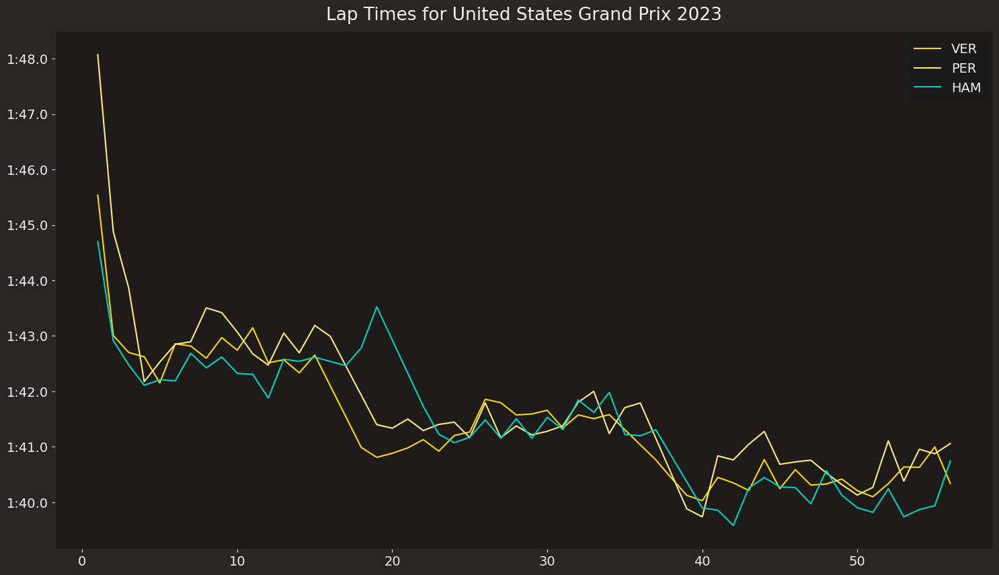

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '16', '55', '4', '63', '3', '81', '23', '31', '10', '22', '27', '24', '77', '2', '18', '14', '20', '11']


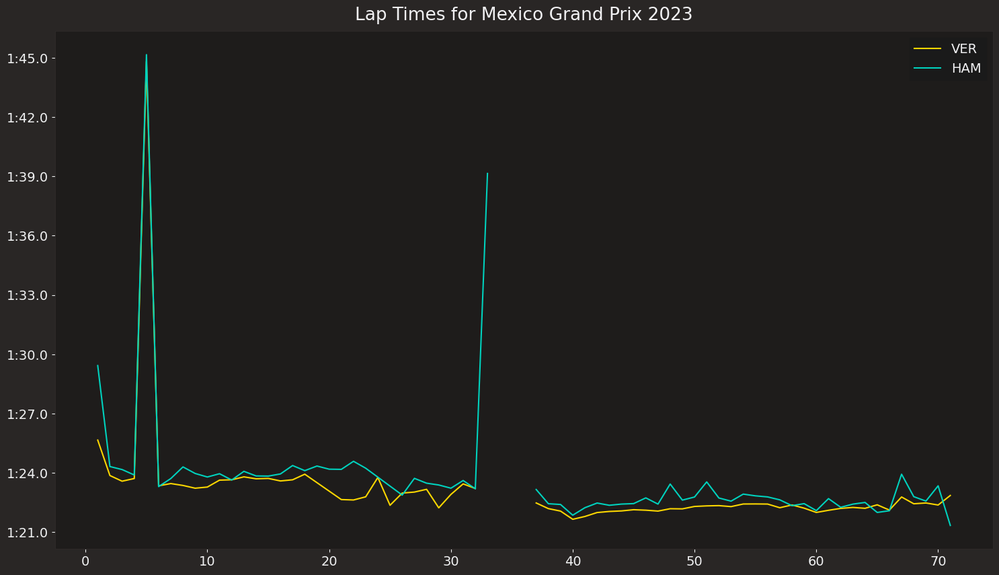

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '14', '11', '18', '55', '10', '44', '22', '31', '2', '27', '3', '81', '63', '77', '24', '20', '23', '16']


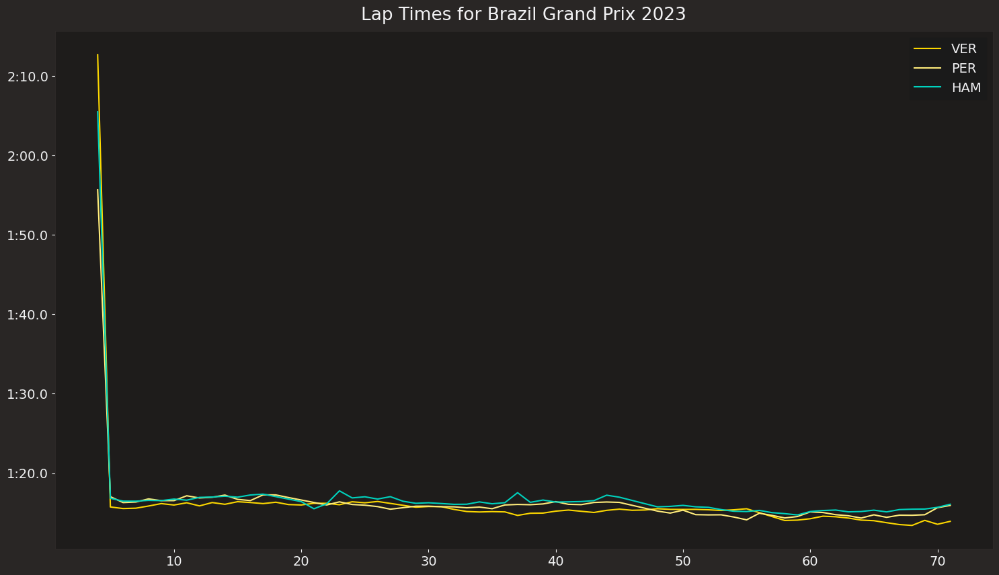

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '31', '18', '55', '44', '63', '14', '81', '10', '23', '20', '3', '24', '2', '77', '22', '27', '4']


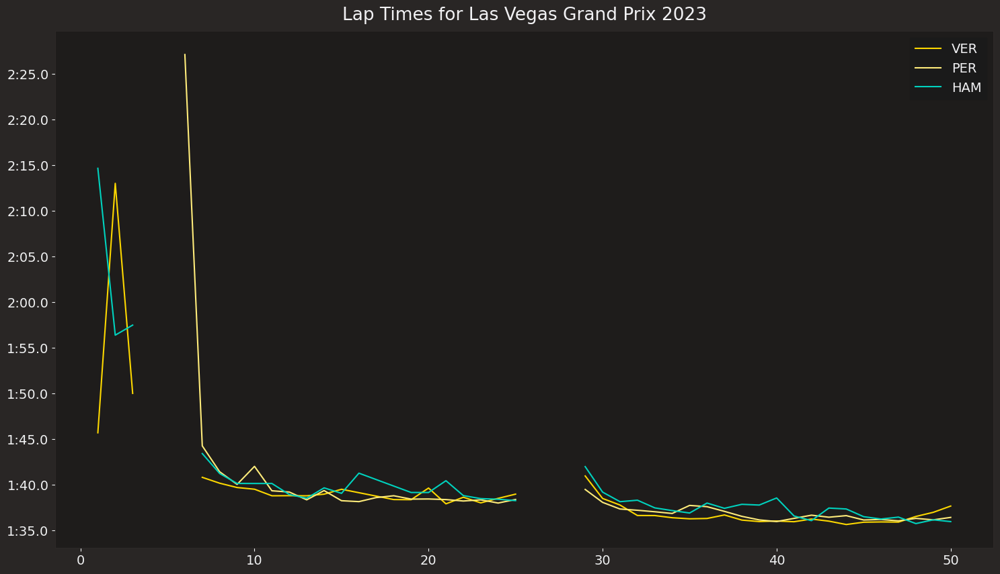

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


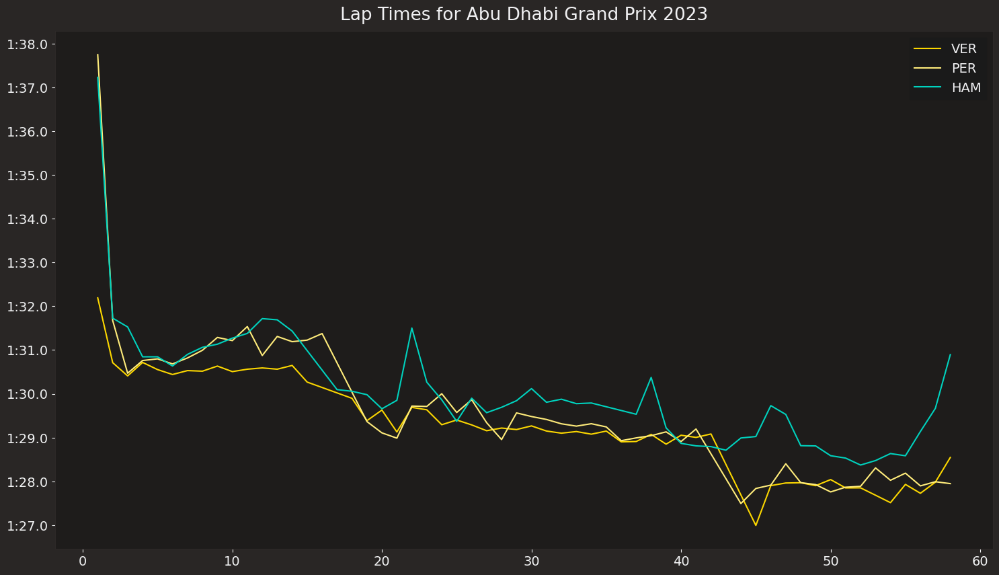

In [96]:
# Loop through each track in the track_names list
for track in track_names:
    
    # Load the race session for each track
    session = fastf1.get_session(2023, track, 'R')
    session.load(telemetry=False, weather=False)
    
    # Create a new figure for each race
    fig, ax = plt.subplots(figsize=(18, 10))

    for drv in ['VER', 'PER', 'HAM']:
        
        drv_laps = session.laps.pick_driver(drv)
        
        # Check if drv_laps is not empty before applying filter
        if not drv_laps.empty:
            # Filter out laps during pit stops
            drv_laps = drv_laps[drv_laps['PitInTime'].isnull() & drv_laps['PitOutTime'].isnull()]
            
            # Check again if drv_laps is empty after filtering
            if not drv_laps.empty:
                # Get driver abbreviation and color
                abb = drv_laps['Driver'].iloc[0]
                color = fastf1.plotting.driver_color(abb)
                
                # Plot lap times throughout the race
                ax.plot(drv_laps['LapNumber'], drv_laps['LapTime'], label=abb, color=color)
    
    # Add plot legend and title
    plt.legend()
    plt.title(f'Lap Times for {track} Grand Prix 2023')
    
    # Display the plot
    plt.show()


# Analysis of Pit Stops and Stint Lengths

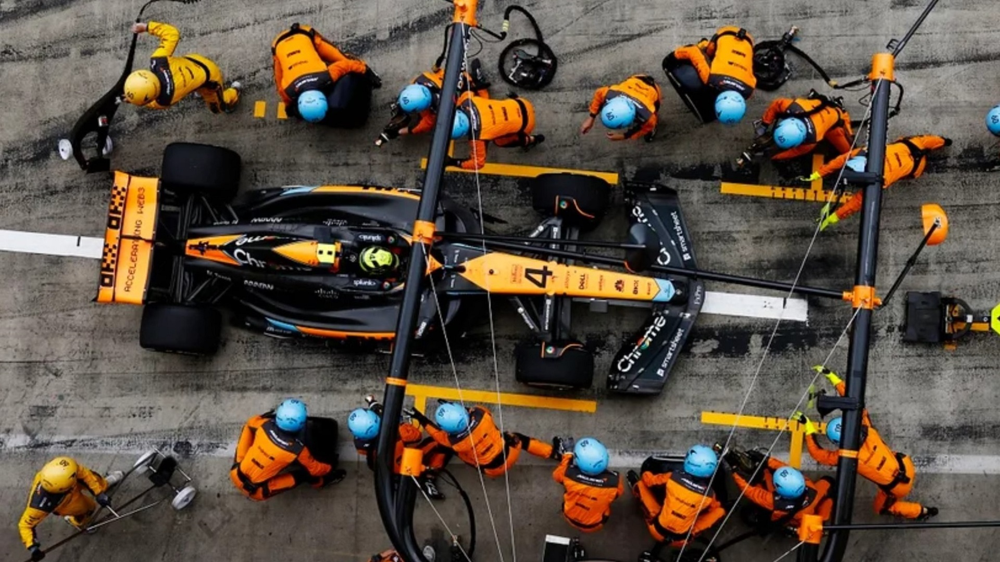

In this section, we analyze the pit stop strategies and stint lengths of the top 3 finishers for each race in the 2023 Formula 1 season. By examining lap times and tire compounds, we gain insights into how strategic decisions impact race outcomes.
Importance of Pit Stop Strategies
Pit stops play a crucial role in Formula 1, as they can significantly influence a team's performance and a driver's finishing position. Effective pit stop strategies involve choosing the optimal time to change tires, selecting the right tire compound, and executing quick and efficient stops.

Notable Races and Examples

Monaco Grand Prix: In this race, Red Bull Racing's strategic decision to pit early allowed Max Verstappen to undercut his rivals, gaining track position and ultimately securing victory.

Hungarian Grand Prix: Mercedes capitalized on a well-timed pit stop for Lewis Hamilton, switching to soft tires under a virtual safety car. This move enabled him to overtake competitors who stayed out on worn tires.

British Grand Prix: Ferrari's decision to double-stack their drivers during a safety car period was pivotal. Charles Leclerc benefited from this strategy, moving up several positions and finishing on the podium.


Visualization

The plots below illustrate the lap times and stint lengths for the top 3 drivers in each race. The upper plot shows lap times, highlighting consistency and pace changes. The lower plot displays stint lengths with color-coded bars representing different tire compounds used throughout the race.

These visualizations provide a comprehensive view of how pit stop strategies are executed and their impact on race results. Feel free to adjust or expand on these points based on your specific analysis and findings.

In [97]:
stints = session.laps[['Driver','Stint','Compound','LapNumber']]
stints = stints.groupby(['Driver','Stint','Compound'])
stints = stints.count().reset_index()

# Renaming the columns 
stints = stints.rename(columns = {'LapNumber':'StintLength'})

print(stints.loc[stints['Driver'].isin(['VER','PER','HAM'])])


   Driver  Stint Compound  StintLength
11    HAM    1.0   MEDIUM           15
12    HAM    2.0     HARD           20
13    HAM    3.0     HARD           23
28    PER    1.0   MEDIUM           17
29    PER    2.0     HARD           25
30    PER    3.0     HARD           16
51    VER    1.0   MEDIUM           16
52    VER    2.0     HARD           27
53    VER    3.0     HARD           15


core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '55', '44', '18', '63', '77', '10', '23', '22', '2', '20', '21', '27', '24', '4', '31', '16', '81']


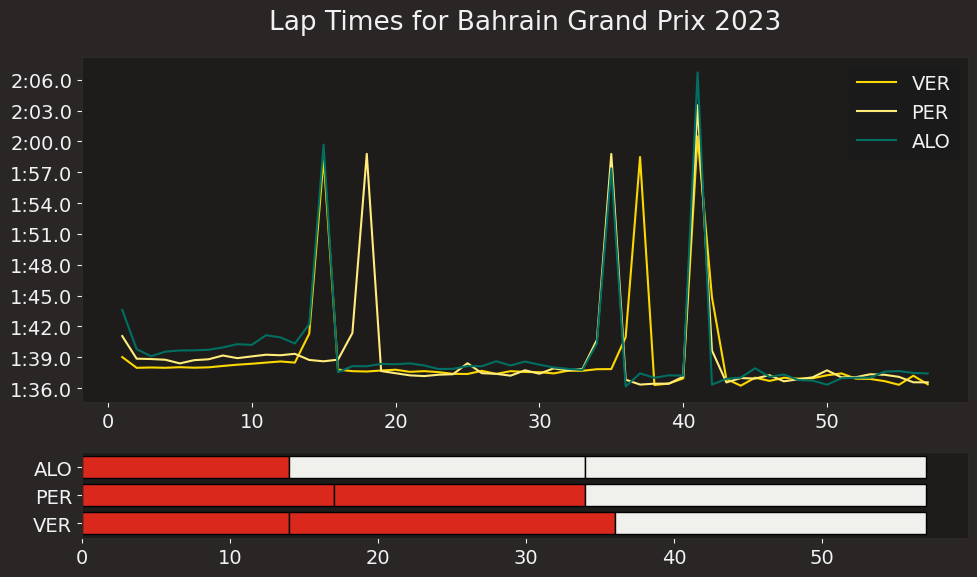

core           INFO 	Loading data for Saudi Arabian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '14', '63', '44', '55', '16', '31', '10', '20', '22', '27', '24', '21', '81', '2', '4', '77', '23', '18']


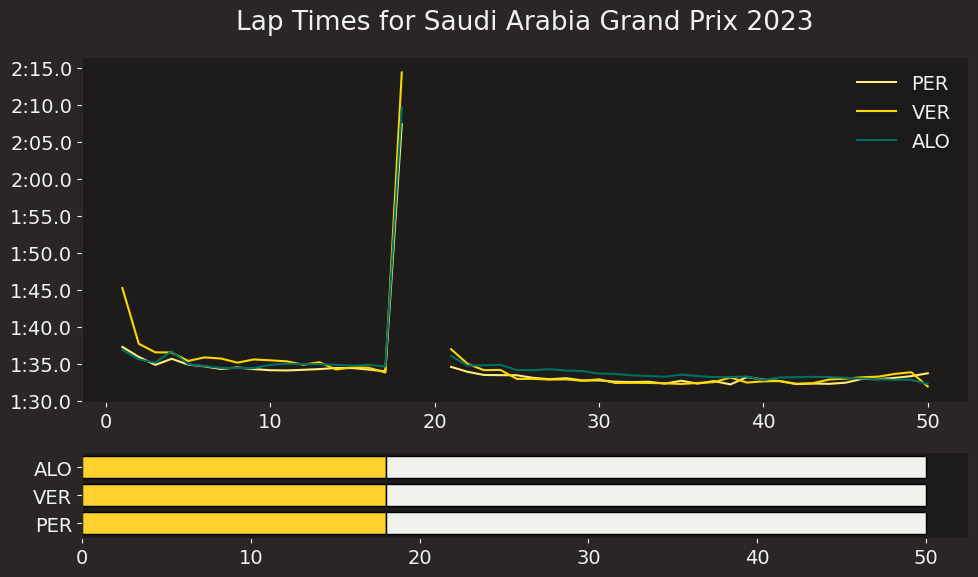

core           INFO 	Loading data for Australian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '14', '18', '11', '4', '27', '81', '24', '22', '77', '55', '10', '31', '21', '2', '20', '63', '23', '16']


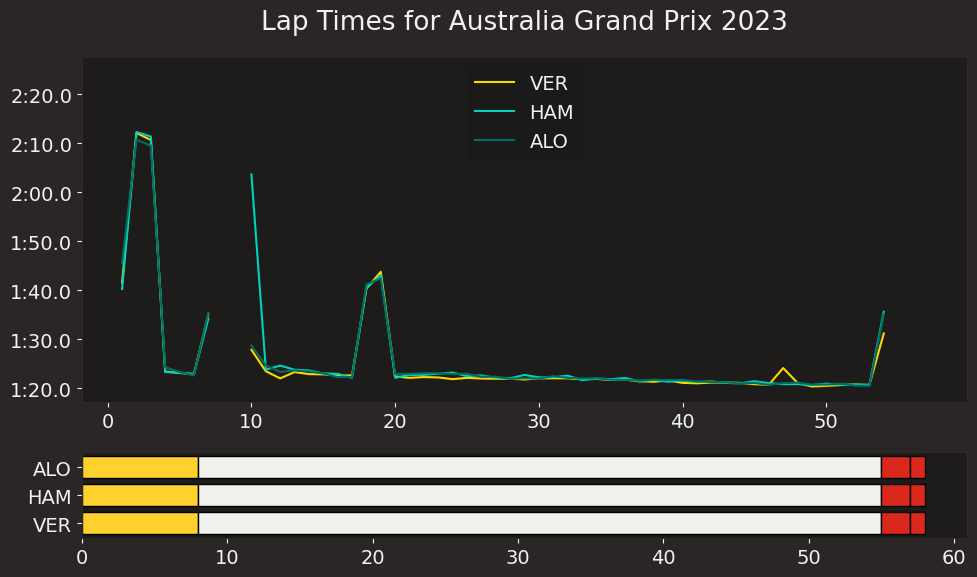

core           INFO 	Loading data for Azerbaijan Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '1', '16', '14', '55', '44', '18', '63', '4', '22', '81', '23', '20', '10', '31', '2', '27', '77', '24', '21']


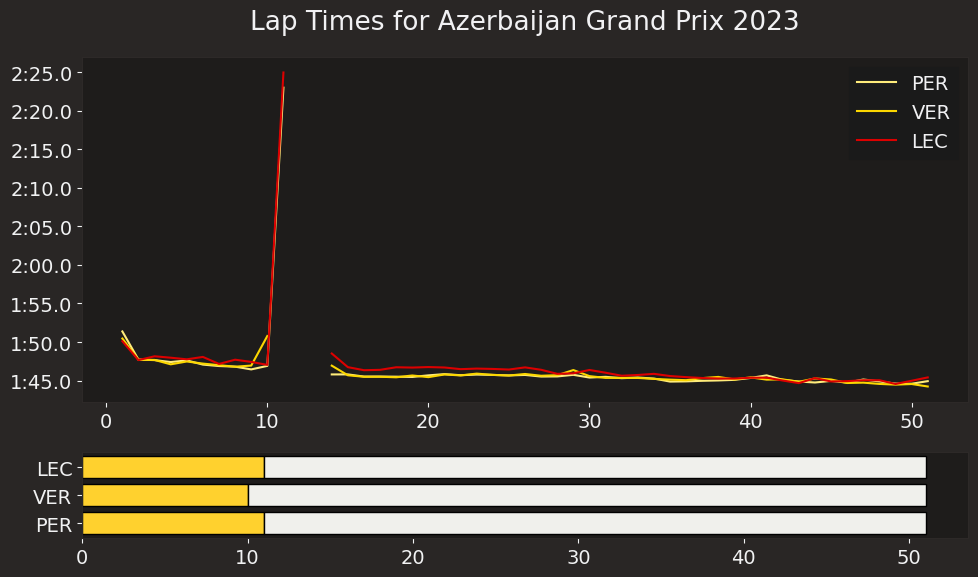

core           INFO 	Loading data for Miami Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '14', '63', '55', '44', '16', '10', '31', '20', '22', '18', '77', '23', '27', '24', '4', '21', '81', '2']


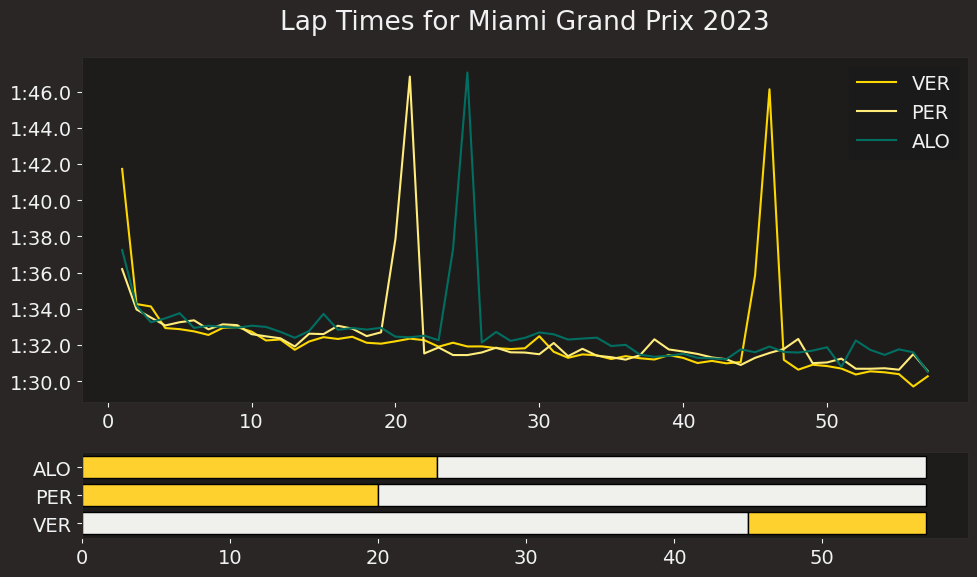

core           INFO 	Loading data for Monaco Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '31', '44', '63', '16', '10', '55', '4', '81', '77', '21', '24', '23', '22', '11', '27', '2', '20', '18']


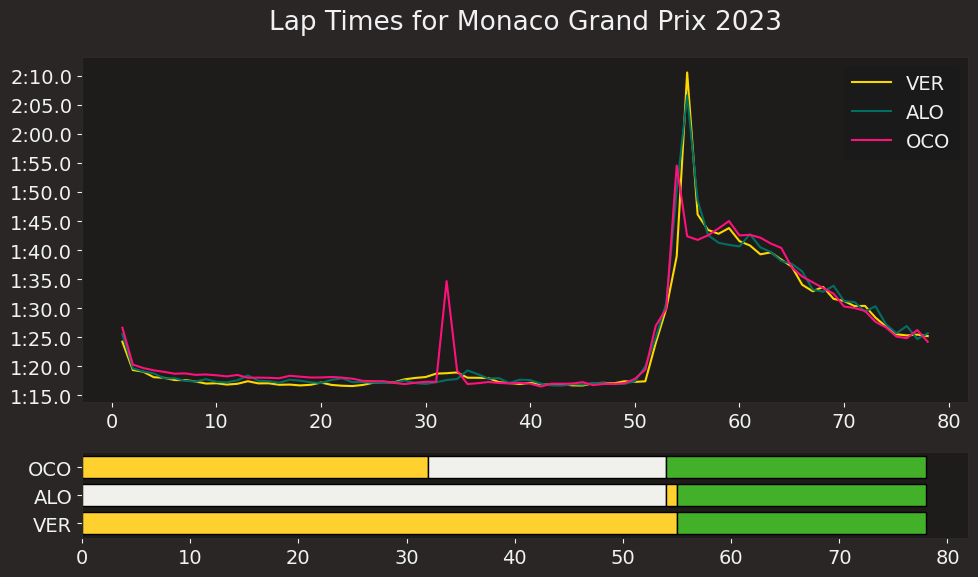

core           INFO 	Loading data for Spanish Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '63', '11', '55', '18', '14', '31', '24', '10', '16', '22', '81', '21', '27', '23', '4', '20', '77', '2']


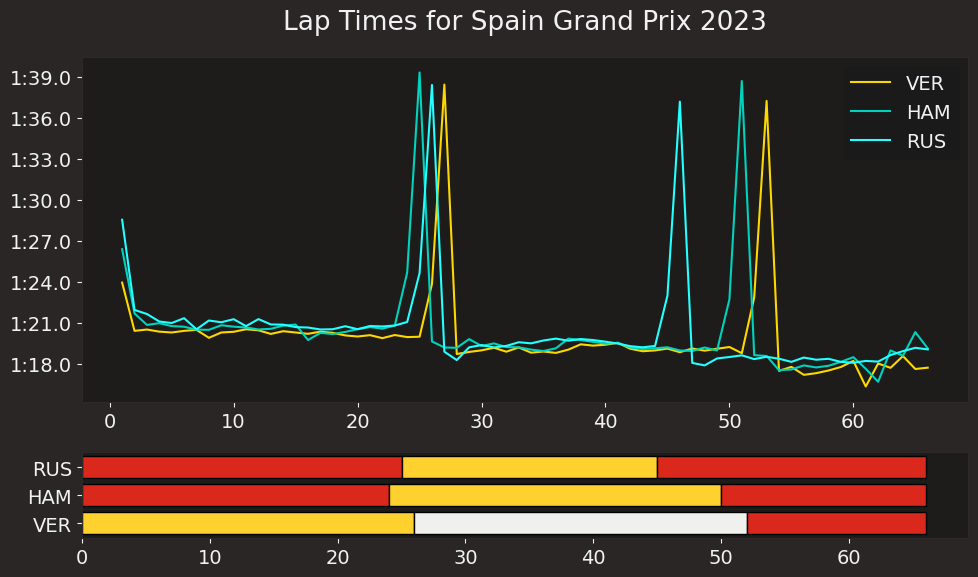

core           INFO 	Loading data for Canadian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '44', '16', '55', '11', '23', '31', '18', '77', '81', '10', '4', '22', '27', '24', '20', '21', '63', '2']


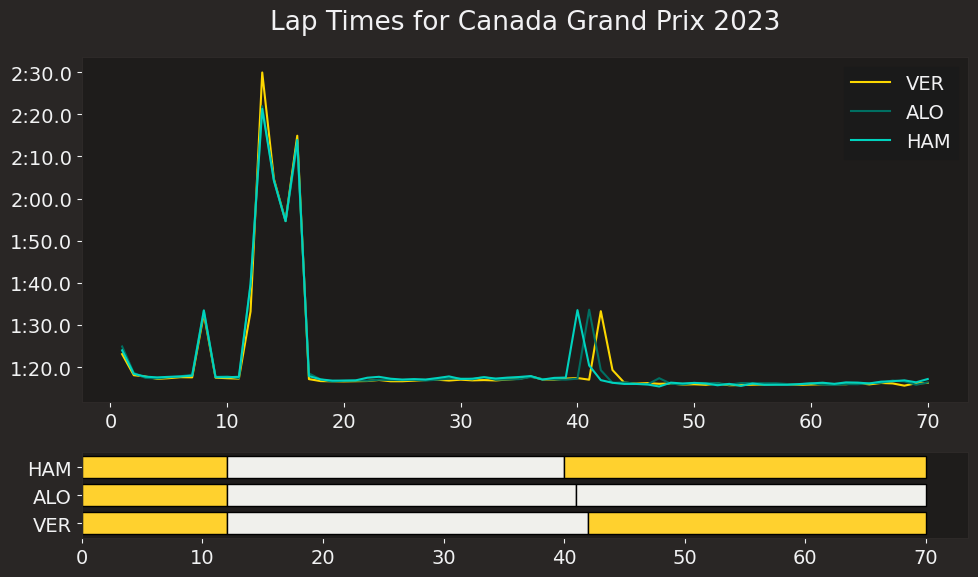

core           INFO 	Loading data for Austrian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '4', '14', '55', '63', '44', '18', '10', '23', '24', '2', '31', '77', '81', '21', '20', '22', '27']


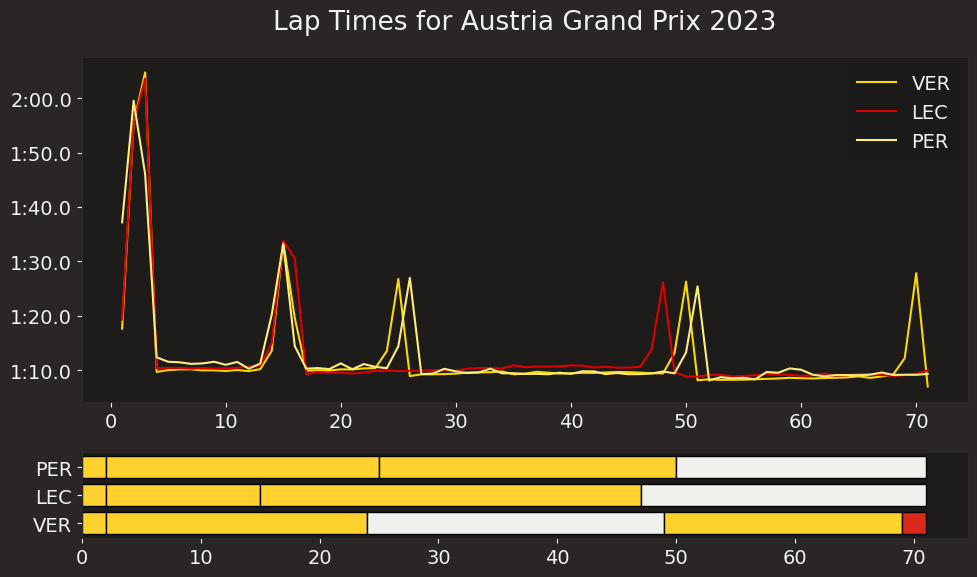

core           INFO 	Loading data for British Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '44', '81', '63', '11', '14', '23', '16', '55', '2', '77', '27', '18', '24', '22', '21', '10', '20', '31']


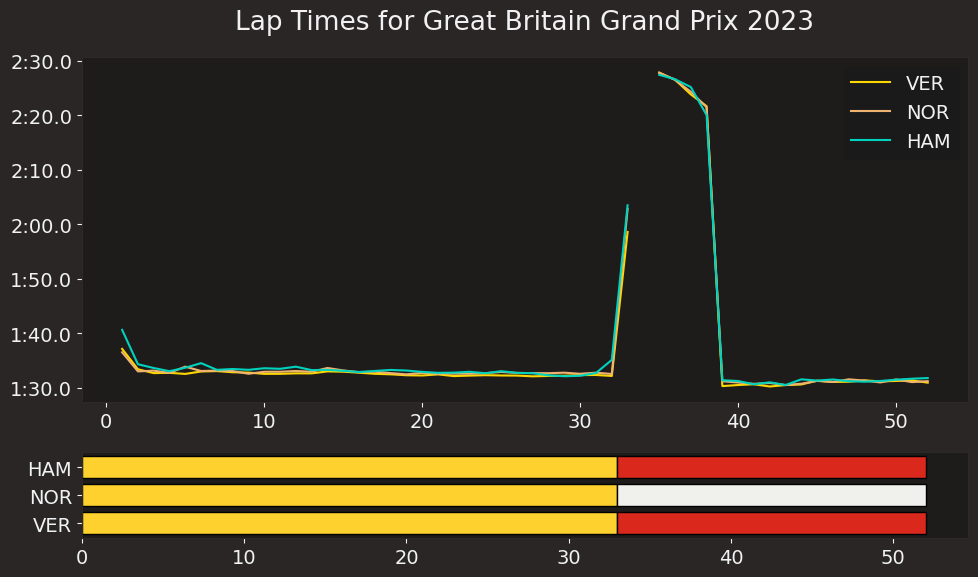

core           INFO 	Loading data for Hungarian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '11', '44', '81', '63', '16', '55', '14', '18', '23', '77', '3', '27', '22', '24', '20', '2', '31', '10']


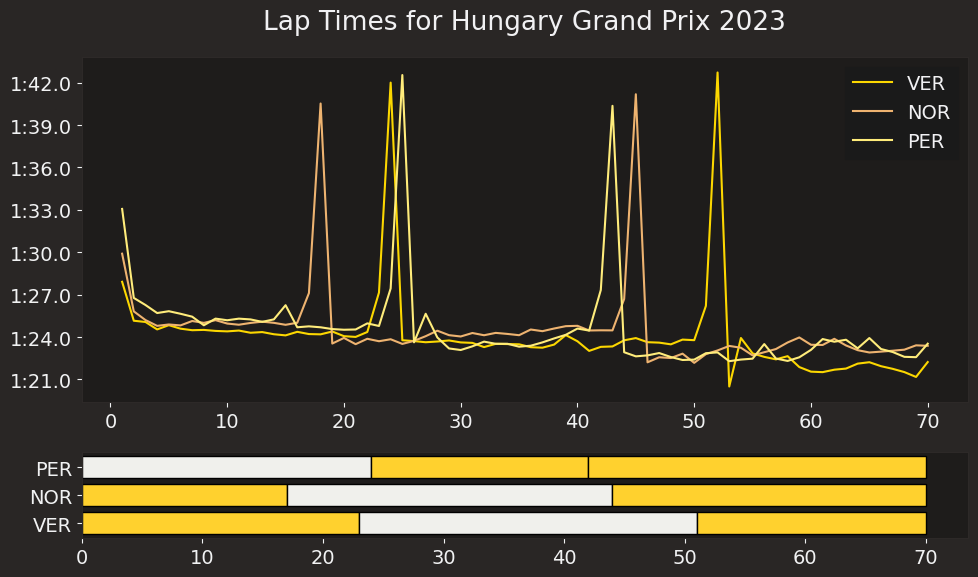

core           INFO 	Loading data for Belgian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '16', '44', '14', '63', '4', '31', '18', '22', '10', '77', '24', '23', '20', '3', '2', '27', '55', '81']


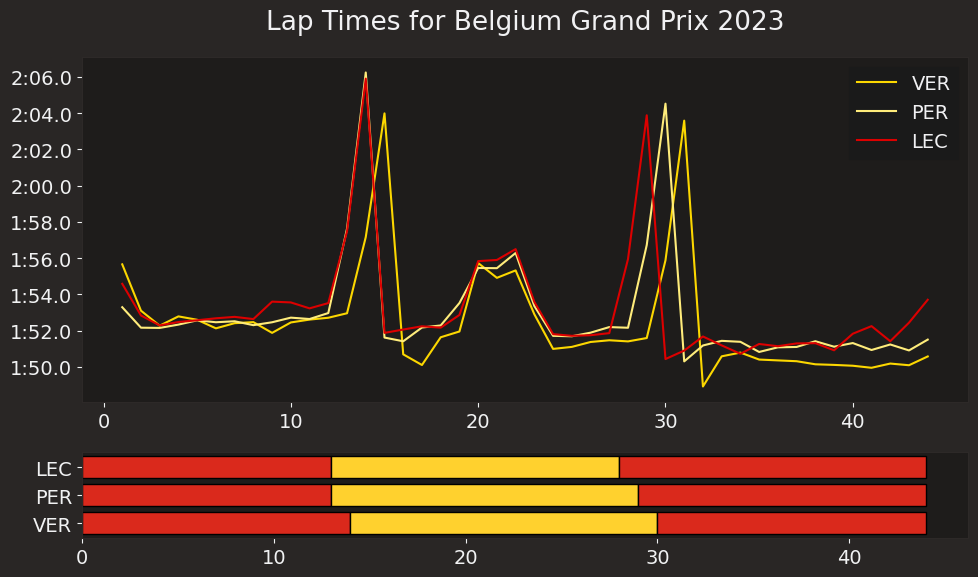

core           INFO 	Loading data for Dutch Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '10', '11', '55', '44', '4', '23', '81', '31', '18', '27', '40', '77', '22', '20', '63', '24', '16', '2']


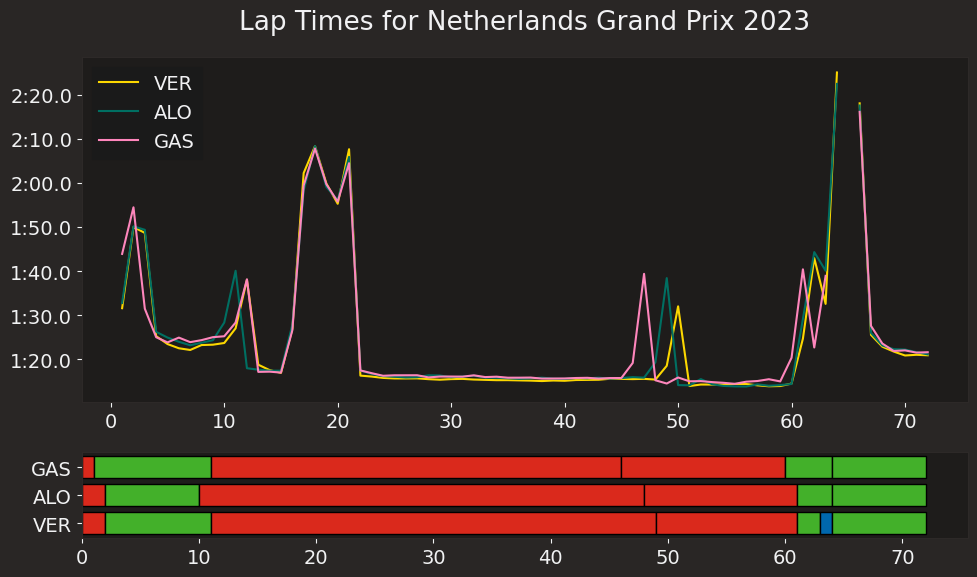

core           INFO 	Loading data for Italian Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '55', '16', '63', '44', '23', '4', '14', '77', '40', '81', '2', '24', '10', '18', '27', '20', '31', '22']


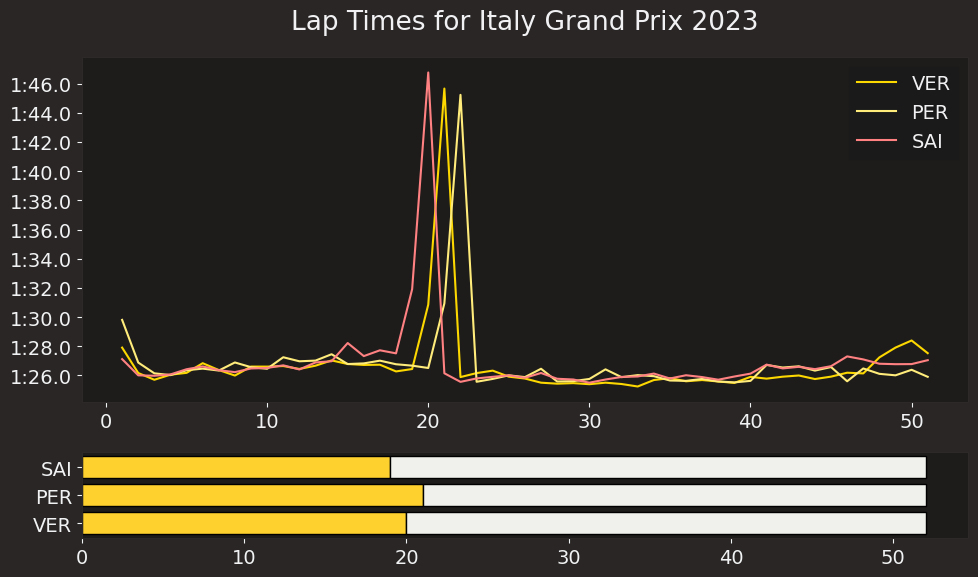

core           INFO 	Loading data for Singapore Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 18
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 18)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['55', '4', '44', '16', '1', '10', '81', '11', '40', '20', '23', '24', '27', '2', '14', '63', '77', '31', '22', '18']


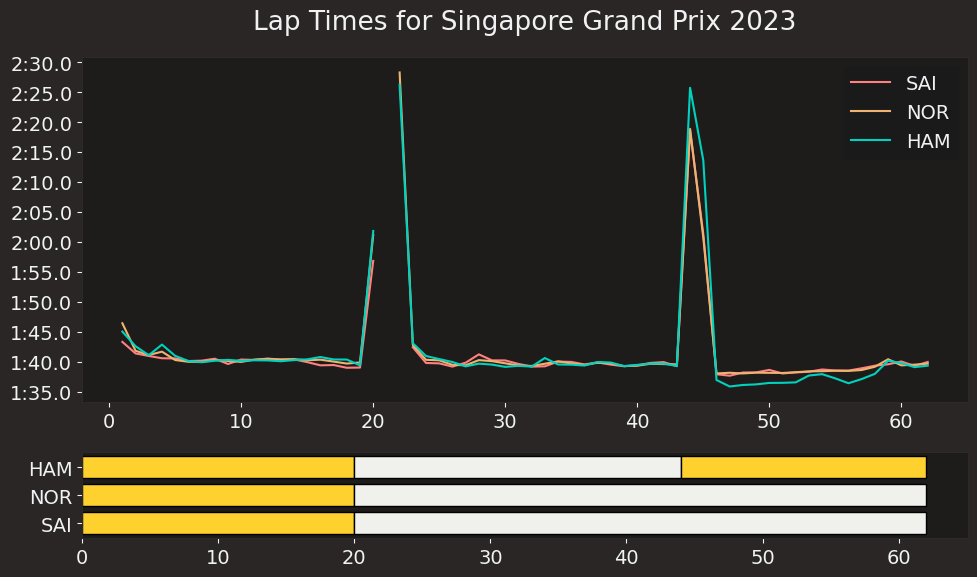

core           INFO 	Loading data for Japanese Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '81', '16', '44', '55', '63', '14', '31', '10', '40', '22', '24', '27', '20', '23', '2', '18', '11', '77']


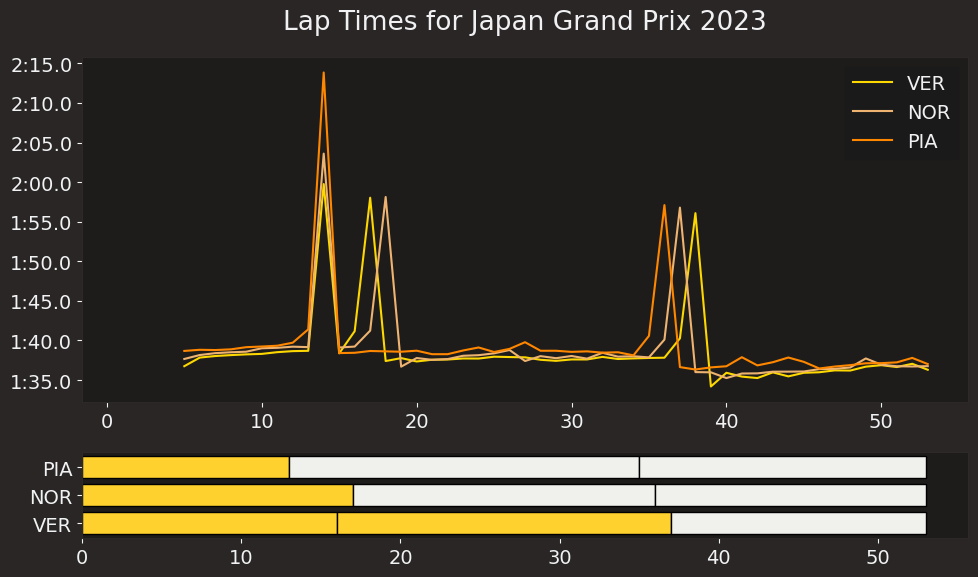

events      WARNING 	Correcting user input 'Qatar' to 'Qatar Grand Prix'
core           INFO 	Loading data for Qatar Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 55
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate (driver 55)
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '4', '63', '16', '14', '31', '77', '24', '11', '18', '10', '23', '20', '22', '27', '40', '2', '44', '55']


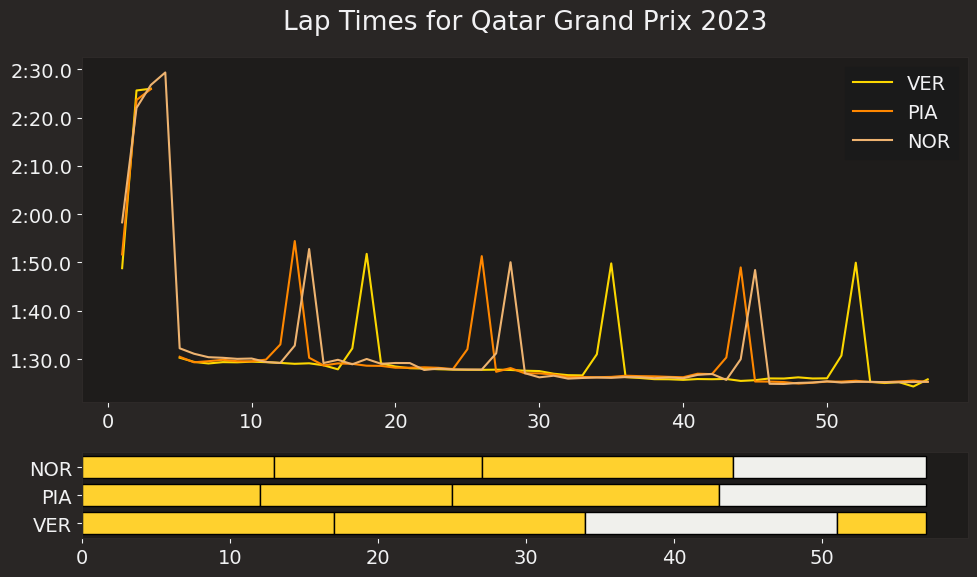

events      WARNING 	Correcting user input 'United States' to 'United States Grand Prix'
core           INFO 	Loading data for United States Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '55', '11', '63', '10', '18', '22', '23', '2', '27', '77', '24', '20', '3', '14', '81', '31', '44', '16']


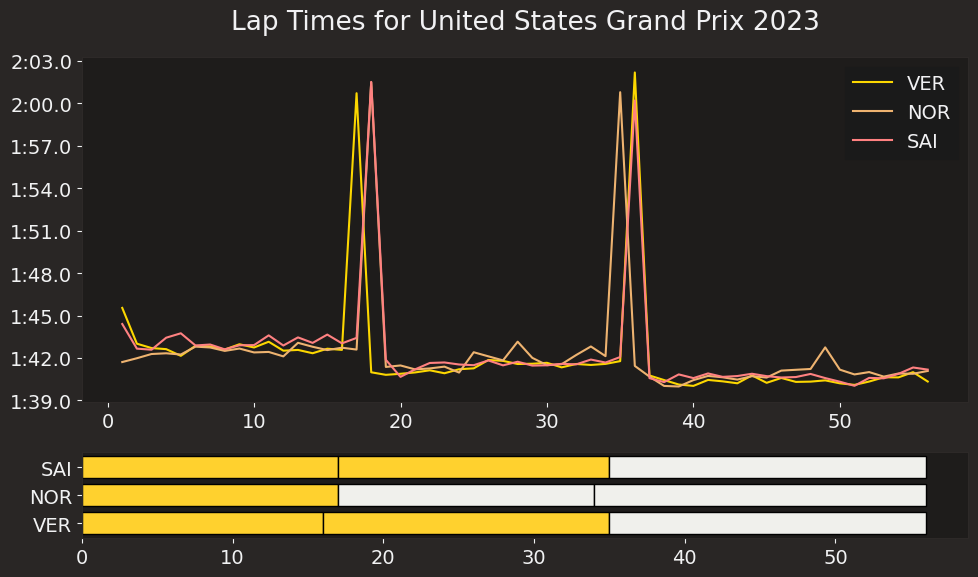

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '16', '55', '4', '63', '3', '81', '23', '31', '10', '22', '27', '24', '77', '2', '18', '14', '20', '11']


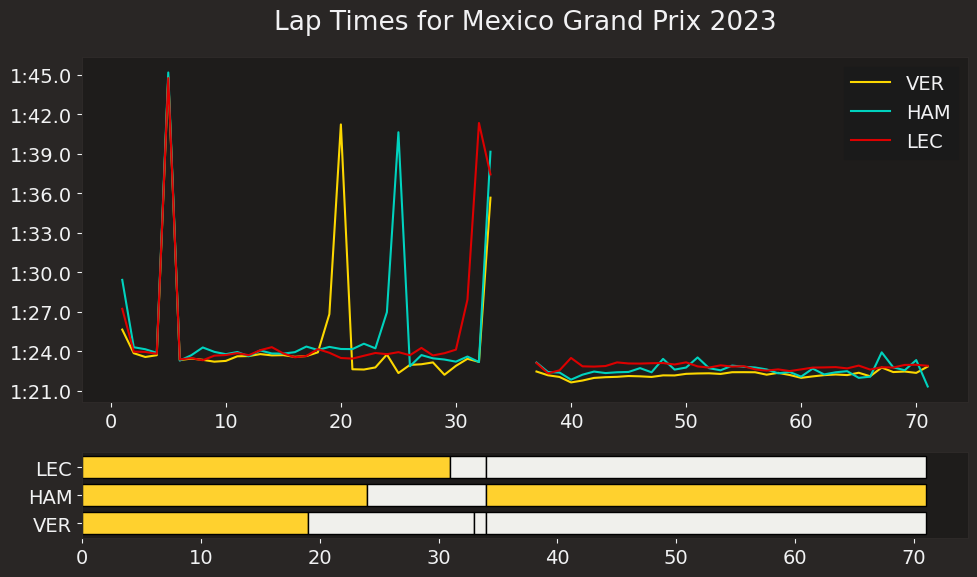

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '14', '11', '18', '55', '10', '44', '22', '31', '2', '27', '3', '81', '63', '77', '24', '20', '23', '16']


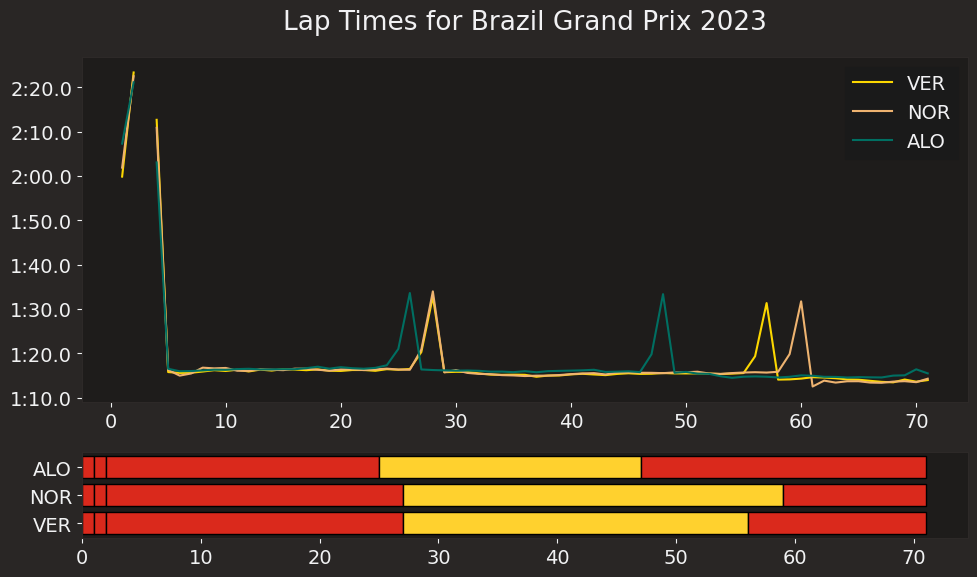

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '11', '31', '18', '55', '44', '63', '14', '81', '10', '23', '20', '3', '24', '2', '77', '22', '27', '4']


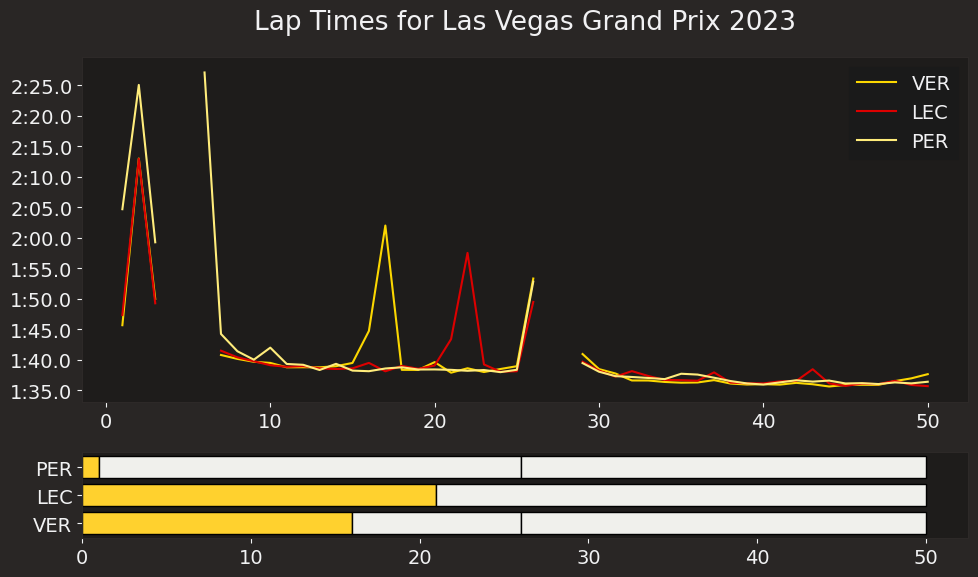

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.4.0]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


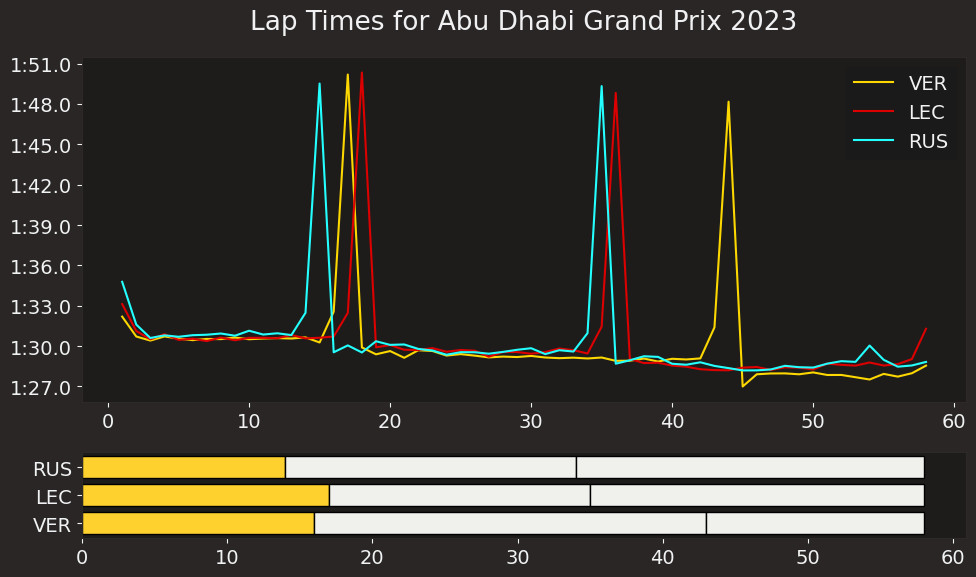

In [106]:
# Loop through each track in the track_names list
for track in track_names:
    
    # Load the race session for each track
    session = fastf1.get_session(2023, track, 'R')
    session.load(telemetry=False, weather=False)

    # Get the top 3 drivers based on race results
    race_results = session.results
    top_3_drivers = race_results.loc[race_results['Position'] <= 3, 'Abbreviation'].values

    # Load the stints for the session
    stints = session.laps[['Driver', 'Stint', 'Compound', 'LapNumber']].groupby(['Driver', 'Stint', 'Compound']).size().reset_index(name='StintLength')

    # Create the figure with 2 subplots
    fig, ax = plt.subplots(2, 1, gridspec_kw={'height_ratios': [4, 1]}, figsize=(10, 6))

    # Loop through the top 3 drivers and plot their lap times
    for drv in top_3_drivers:
        drv_laps = session.laps.pick_driver(drv)
        # Check if drv_laps is not empty to avoid errors
        if not drv_laps.empty:
            # Get driver abbreviation and color
            abb = drv_laps['Driver'].iloc[0]
            color = fastf1.plotting.driver_color(abb)
            # Plot the lap times throughout the race
            ax[0].plot(drv_laps['LapNumber'], drv_laps['LapTime'], label=abb, color=color)

    # Loop through the top 3 drivers' stints and plot the stint bars
    for driver in top_3_drivers:
        driver_stints = stints.loc[stints['Driver'] == driver]

        previous_stint_end = 0
        for idx, row in driver_stints.iterrows():
            # Draw horizontal bars for stint length
            ax[1].barh(y=driver, width=row['StintLength'], left=previous_stint_end,
                       color=fastf1.plotting.COMPOUND_COLORS[row['Compound']],
                       edgecolor='black', fill=True)
            previous_stint_end += row['StintLength']

    # Add plot legend and title
    ax[0].legend()
    ax[0].set_title(f'Lap Times for {track} Grand Prix 2023', pad=20)

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()
